# Libraries, data and installs

In [1]:
import tensorflow as tf
tf.config.list_physical_devices("GPU")


[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [1]:
#!pip3 install visualkeras
!pip3 install -U numpy==1.18.5


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 10.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  error: subprocess-exited-with-error
  
  × Building wheel for numpy (pyproject.toml) did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for numpy
Failed to build numpy
ERROR: Could not build wheels for numpy, which is required to install pyproject.toml-based projects


In [5]:
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam
from keras.layers import Input, Dense, Dropout
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Add, Multiply
from keras.layers import ELU, PReLU, LeakyReLU
from keras.models import Model
from keras.utils.vis_utils import plot_model
from tensorflow.keras import optimizers
from keras.optimizers import SGD
from keras.optimizers import Adagrad
from keras import metrics
from sklearn.metrics import r2_score
from keras.callbacks import EarlyStopping
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.layers.experimental.preprocessing import Normalization
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.mobilenet import MobileNet
from tensorflow.keras.applications.densenet import DenseNet121

from tensorflow.keras.layers import GlobalAveragePooling2D


from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import StandardScaler

%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import math as m
import numpy as np
import seaborn as sns
import os
import json

sns.set_style("darkgrid")
edgecolors=None



In [69]:
'''
Nomenclature:

<DATASET-INITIALS><FRUIT-INITIAL><TEST-INITIAL>.csv|.pkl

DATASET-INITIALS:
CG = Classic Geometry
F = Form
C = Color
A = All
CI = Cropped Images

FRUIT-INITIAL:
B = Blueberry
R = Raspberry
S = Strawberry

TEST-INITIAL:
R = Raw
Y = YOLO
D = Detectron2

---------------------

EXAMPLES

CLASSIC GEOMETRY of RASPBERRIES from RAW test
CGRR.csv

CROPPED IMAGES of BLUEBERRIES from YOLO test
CIBY.pkl

---------------------

Cropped images are the only datasets that are saved in a pickle file


'''

#-----------------Blueberries------------------
###############################################
#Blueberries - RAW
#ClassicGeometry
!wget -O CGBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryBlueberriesRaw.csv
#Form
!wget -O FBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsBlueberriesRaw.csv
#Color
!wget -O CBR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsBlueberriesRaw.csv
#All
!wget -O ABR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesBlueberriesRaw.csv
#Images
!wget -O CIBR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesRaw.pkl
###############################################
#Blueberries - YOLO
#ClassicGeometry
!wget -O CGBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryYOLOBlue.csv
#Form
!wget -O FBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsYOLOBlue.csv
#Color
!wget -O CBY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsYOLOBlue.csv
#All
!wget -O ABY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesYOLOBlue.csv
#Images
!wget -O CIBY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesYOLO.pkl
###############################################
#Blueberries - Detectron2
#ClassicGeometry
!wget -O CGBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2blue.csv
#Form
!wget -O FBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2blue.csv
#Color
!wget -O CBD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2blue.csv
#All
!wget -O ABD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2blue.csv
#Images
!wget -O CIBD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesBlueberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================
#-----------------Raspberries------------------
###############################################
#Raspberries - RAW
#ClassicGeometry
!wget -O CGRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryRaspberriesRaw.csv
#Form
!wget -O FRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsRaspberriesRaw.csv
#Color
!wget -O CRR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsRaspberriesRaw.csv
#All
!wget -O ARR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesRaspberriesRaw.csv
#Images
!wget -O CIRR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesRaw.pkl
###############################################
#Raspberries - YOLO
#ClassicGeometry
!wget -O CGRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryYOLORasp.csv
#Form
!wget -O FRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsYOLORasp.csv
#Color
!wget -O CRY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsYOLORasp.csv
#All
!wget -O ARY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesYOLORasp.csv
#Images
!wget -O CIRY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesYOLO.pkl
###############################################
#Raspberries - Detectron2
#ClassicGeometry
!wget -O CGRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2rasp.csv
#Form
!wget -O FRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2rasp.csv
#Color
!wget -O CRD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2rasp.csv
#All
!wget -O ARD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2rasp.csv
#Images
!wget -O CIRD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesRaspberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================
#-----------------Strawberries------------------
###############################################
#Strawberries - RAW
#ClassicGeometry
!wget -O CGSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryStrawberriesRaw.csv
#Form
!wget -O FSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsStrawberriesRaw.csv
#Color
!wget -O CSR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsStrawberriesRaw.csv
#All
!wget -O ASR.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesStrawberriesRaw.csv
#Images
!wget -O CISR.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesRaw.pkl
###############################################
#Strawberries - YOLO
#ClassicGeometry
!wget -O CGSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryStrawberriesYOLO.csv
#Form
!wget -O FSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsStrawberriesYOLO.csv
#Color
!wget -O CSY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsStrawberriesYOLO.csv
#All
!wget -O ASY.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesStrawberriesYOLO.csv
#Images
!wget -O CISY.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesYOLO.pkl
###############################################
#Strawberries - Detectron2
#ClassicGeometry
!wget -O CGSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryDetectron2straw.csv
#Form
!wget -O FSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsDetectron2straw.csv
#Color
!wget -O CSD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/colorsDetectron2straw.csv
#All
!wget -O ASD.csv https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/allfeaturesDetectron2straw.csv
#Images
!wget -O CISD.pkl https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/croppedimagesStrawberriesDetectron.pkl
###############################################
#----------------------------------------------

#==============================================

%mkdir figures


--2023-05-02 20:25:36--  https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/classicgeometryBlueberriesRaw.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.108.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3594 (3.5K) [text/plain]
Saving to: ‘CGBR.csv’

CGBR.csv            100%[===================>]   3.51K  --.-KB/s    in 0s      

2023-05-02 20:25:36 (24.7 MB/s) - ‘CGBR.csv’ saved [3594/3594]

--2023-05-02 20:25:36--  https://raw.githubusercontent.com/pcruiher08/ImageFeatures/main/humomentsBlueberriesRaw.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 19645 (

# Data analysis

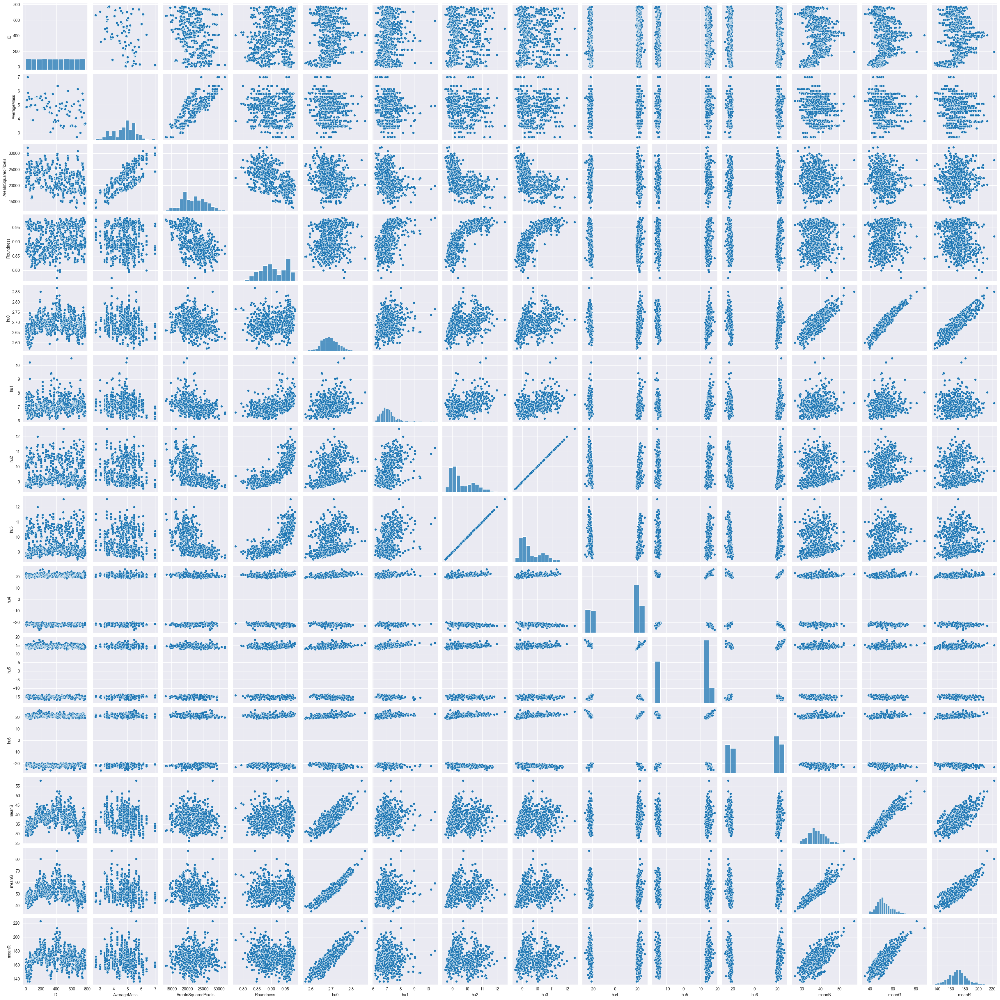

In [5]:
testdf = pd.read_csv("allfeaturesRaspberriesRaw.csv")

sns.pairplot(testdf)


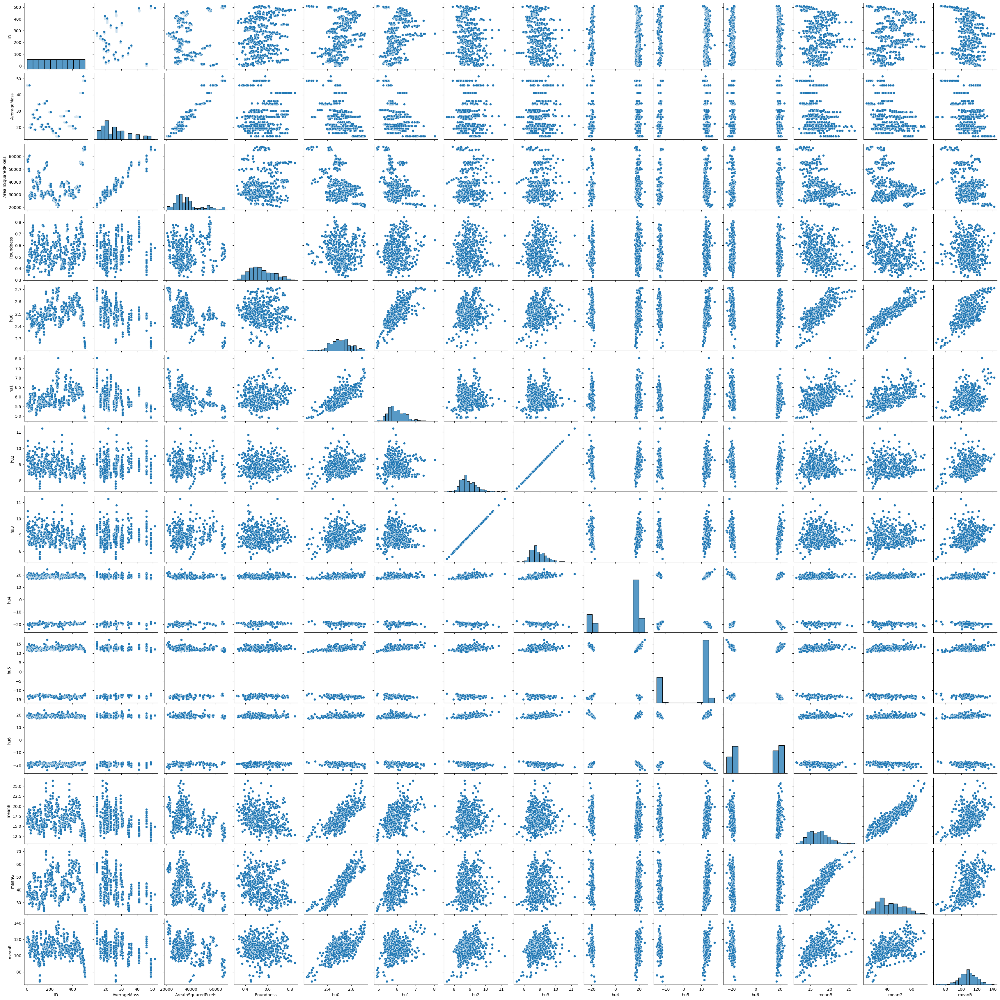

In [ ]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")

sns.pairplot(testdf)


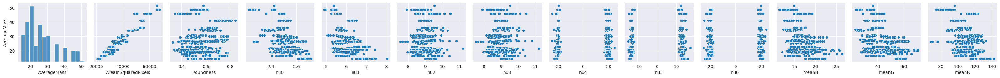

In [ ]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")

testdf = testdf.drop(['ID'], axis=1)

pp = sns.pairplot(data=testdf,
                  y_vars=['AverageMass'])

plt.savefig("./figures/StrawberriesPairplotAverageMass", dpi=300)




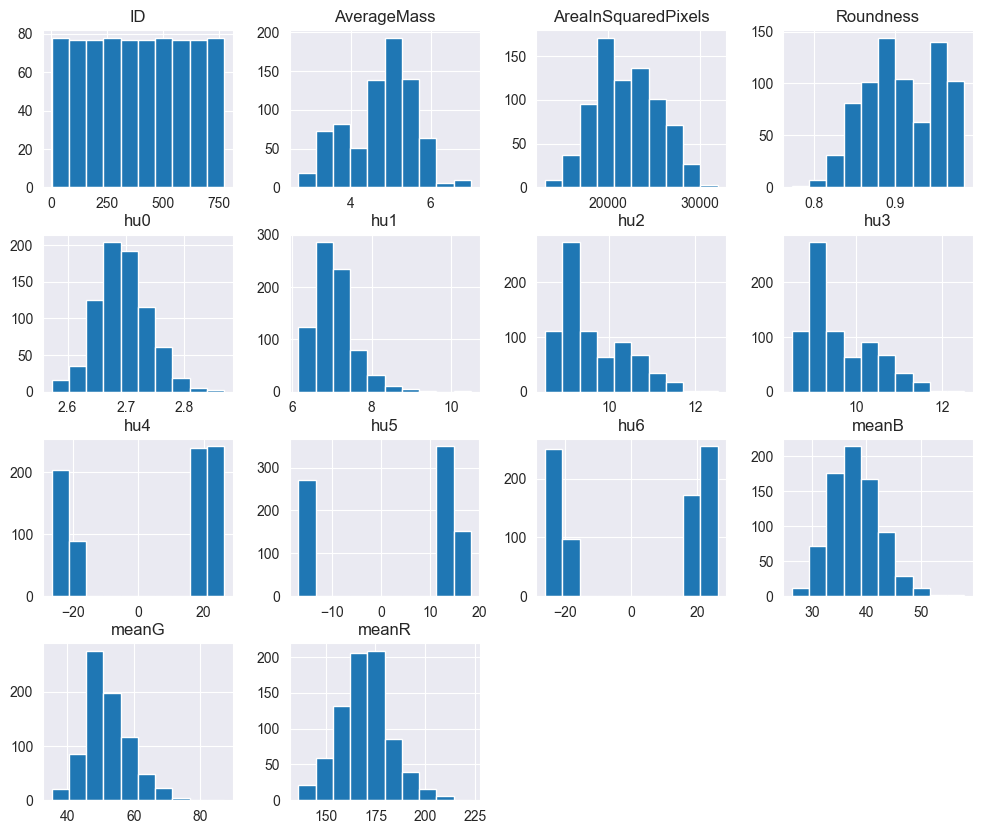

In [6]:
testdf.hist(figsize = (12,10))
plt.show()

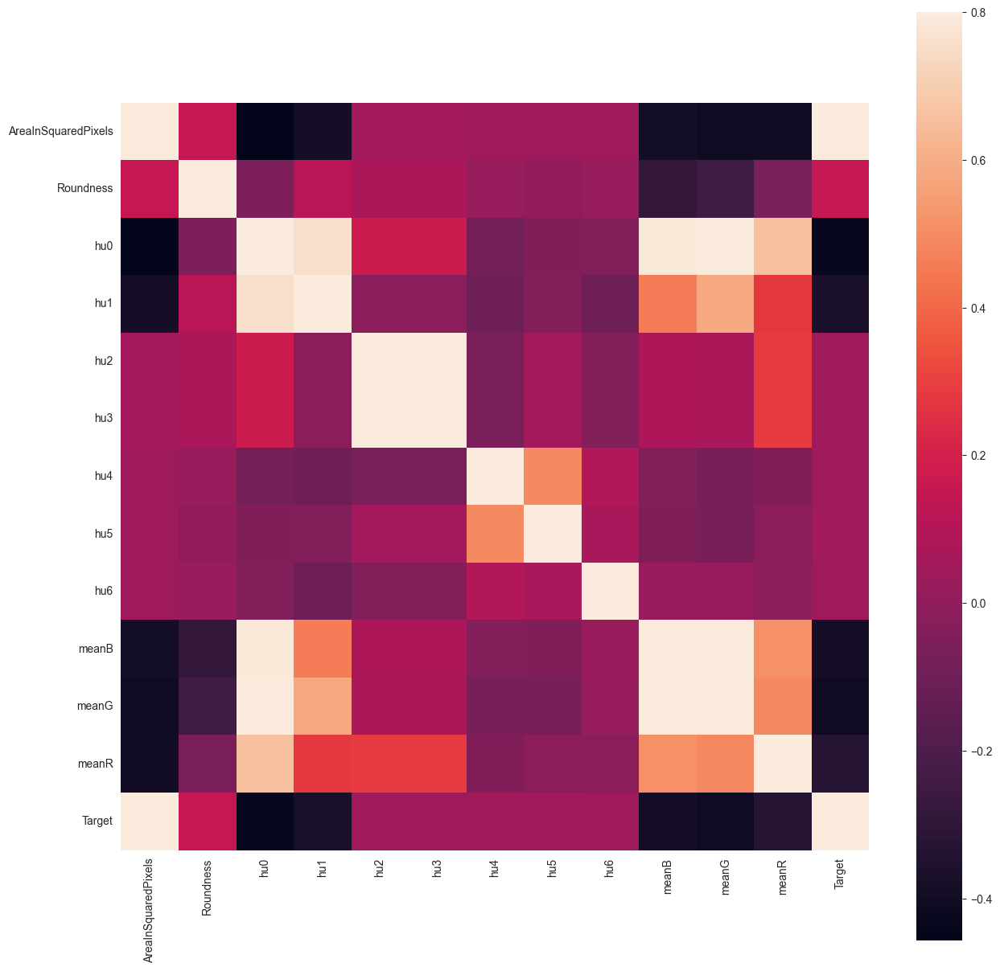

In [7]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)

testdf['Target'] = testdf['AverageMass']
testdf = testdf.drop(["AverageMass"], axis = 1)
C_mat = testdf.corr()
fig = plt.figure(figsize = (15,15))

sns.heatmap(C_mat, vmax = .8, square = True)
plt.show()

<AxesSubplot: >

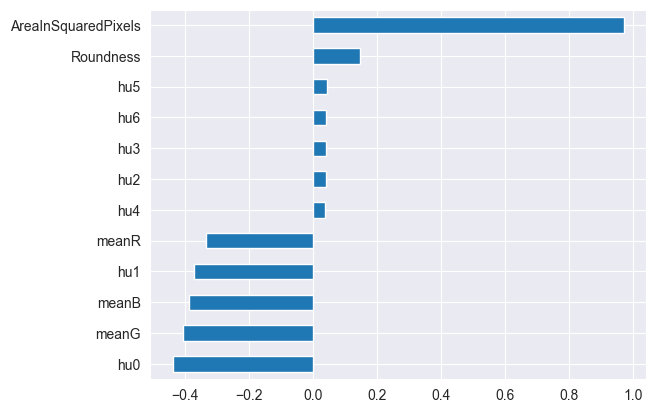

In [8]:
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

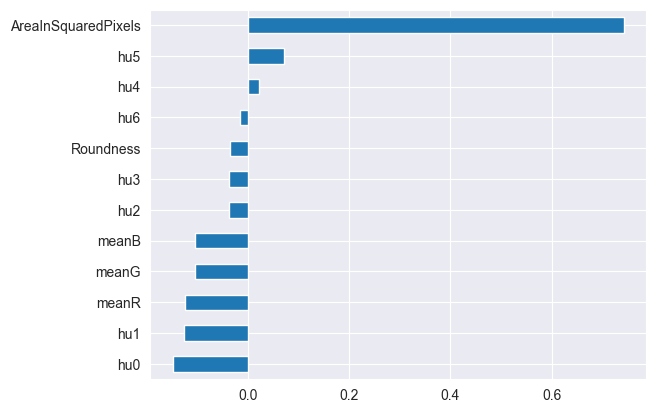

In [9]:
testdf = pd.read_csv("allfeaturesRaspberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

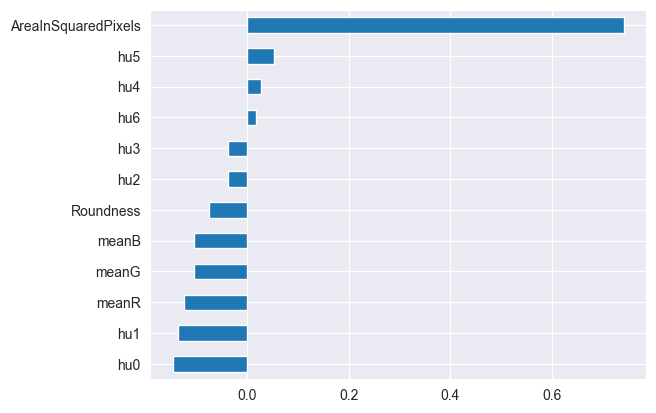

In [10]:
testdf = pd.read_csv("allfeaturesYOLORasp.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()

<AxesSubplot: >

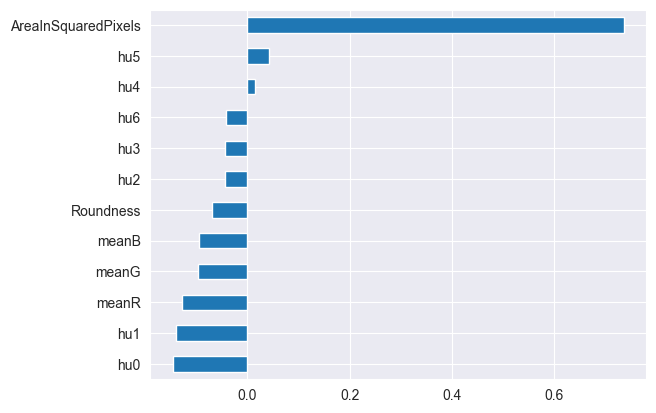

In [11]:
testdf = pd.read_csv("allfeaturesDetectron2rasp.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr()["AverageMass"].sort_values()[:-1].plot.barh()



<AxesSubplot: >

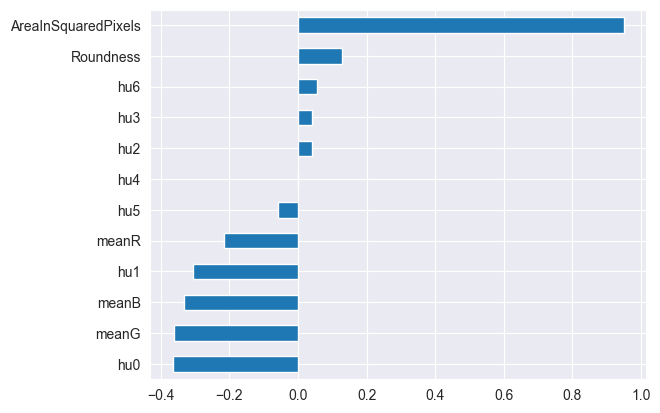

In [12]:
#checando correlacion no lineal con spearman
testdf = pd.read_csv("allfeaturesStrawberriesRaw.csv")
testdf = testdf.drop(['ID'], axis=1)
testdf.corr(method= 'spearman')["AverageMass"].sort_values()[:-1].plot.barh()


In [13]:
testdf.corr().style.background_gradient(cmap='coolwarm')


,AverageMass,AreaInSquaredPixels,Roundness,hu0,hu1,hu2,hu3,hu4,hu5,hu6,meanB,meanG,meanR
AverageMass,1.000000,0.971616,0.147975,-0.436478,-0.372183,0.041011,0.041011,0.037208,0.045287,0.041830,-0.386290,-0.404366,-0.333780
AreaInSquaredPixels,0.971616,1.000000,0.148809,-0.456898,-0.384775,0.054358,0.054358,0.037499,0.042792,0.035218,-0.389722,-0.406470,-0.399383
Roundness,0.147975,0.148809,1.000000,-0.055411,0.117716,0.070617,0.070617,0.016065,0.003740,0.016817,-0.289358,-0.244875,-0.065841
hu0,-0.436478,-0.456898,-0.055411,1.000000,0.756037,0.172867,0.172867,-0.085603,-0.049323,-0.041409,0.788042,0.893985,0.654910
hu1,-0.372183,-0.384775,0.117716,0.756037,1.000000,-0.019207,-0.019207,-0.102314,-0.034972,-0.104948,0.460615,0.580435,0.276126
hu2,0.041011,0.054358,0.070617,0.172867,-0.019207,1.000000,1.000000,-0.067787,0.052346,-0.043903,0.080962,0.074706,0.284754
hu3,0.041011,0.054358,0.070617,0.172867,-0.019207,1.000000,1.000000,-0.067787,0.052346,-0.043903,0.080962,0.074706,0.284754
hu4,0.037208,0.037499,0.016065,-0.085603,-0.102314,-0.067787,-0.067787,1.000000,0.493780,0.096488,-0.040366,-0.072974,-0.049212
hu5,0.045287,0.042792,0.003740,-0.049323,-0.034972,0.052346,0.052346,0.493780,1.000000,0.064254,-0.045144,-0.072504,-0.015929
hu6,0.041830,0.035218,0.016817,-0.041409,-0.104948,-0.043903,-0.043903,0.096488,0.064254,1.000000,0.027822,0.018287,-0.019152


<AxesSubplot: >

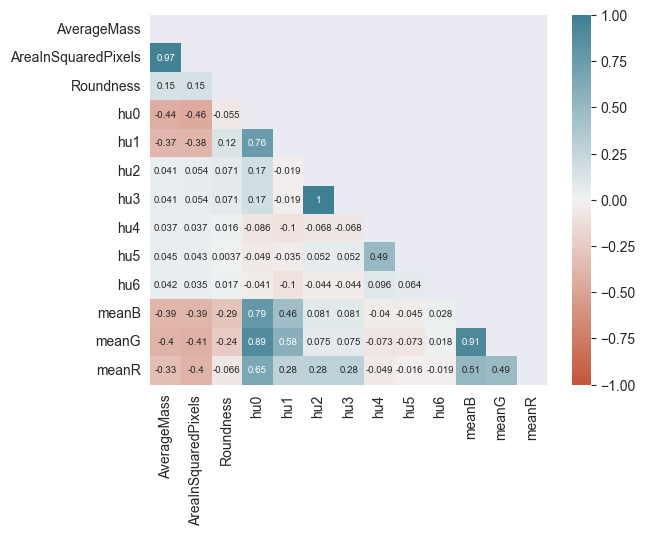

In [14]:

corrmat = testdf.corr()
mask= np.zeros_like(corrmat)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corrmat,
            vmax=1, vmin=-1,
            annot=True, annot_kws={'fontsize':7},
            mask=mask,
            cmap=sns.diverging_palette(20,220,as_cmap=True))

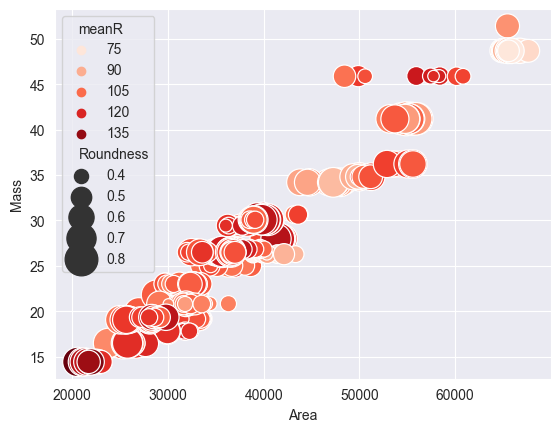

In [15]:
sns.scatterplot(data = testdf, x=testdf['AreaInSquaredPixels'], y=testdf['AverageMass'],
               size=testdf['Roundness'], hue=testdf['meanR'],
               sizes=(20,600),
               palette='Reds')

plt.xlabel('Area')
plt.ylabel('Mass')
plt.savefig("./figures/StrawberriesRawAreaVsMassAndRoundnessAndMeanRed", dpi=300)


# Deep learning

In [3]:
print(tf.__version__)
!pip3 install tensorflow_addons


2.9.0
Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


In [4]:
!pip3 install tensorflow-addons==0.16.1


Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


In [5]:
#%reload_ext tensorboard

#%rm -rf "logs/fit"

import tensorflow_addons as tfa
from tensorflow_addons.metrics import RSquare


/Users/pablo/Library/Python/3.9/lib/python/site-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.6.0 and strictly below 2.9.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.9.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/addons
  warnings.warn(


In [6]:
!pip3 install pydot

Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


# MASTER CLASS

In [36]:
class AutomaticLearning:



  def __init__(self , dataframe, title, model_name):

    print(dataframe.head(2))

    self.df = dataframe
    self.model_name = model_name
    self.input_shape = None
    self.num_classes = None
    self.epochs = None
    self.model = None
    self.X = None
    self.y = None
    self.X_train = None
    self.X_test = None
    self.y_train = None
    self.y_test = None
    self.run_name = "run"
    self.history = None
    self.r2 = None
    self.loss = None
    self.mse = None
    self.mae = None
    self.rmse = None
    self.library = None
    self.title = title
    self.plottittle = ""
    self.save = None
    self.show = None
    return

  def gather_data(self):
    return {'r2': self.r2, 'loss': self.loss, 'mse': self.mse, 'mae': self.mae, 'rmse': self.rmse}

  def plotA(self):
    pd.DataFrame(self.history.history).plot(figsize=(8,5))
    plt.show()
    return

  def plotLinear(self):
    # plot the data and the predictions

    #print(self.X_test)
    predictions = self.model.predict(self.X_test)

    plt.xlabel('Area (pixels^2)')
    plt.ylabel('Mass (g)')

    plt.scatter(self.X_test, self.y_test)
    if(self.model_name == "SVR"):
      plt.scatter(self.X_test, predictions, color='red', marker="x")
    else:
      plt.plot(self.X_test, predictions, color='red')

    plt.title(self.plottittle +'-R2' + str(self.epochs), size = 20)

    if(self.show):
      plt.show()
      print()
    if(self.save):
      plt.savefig(self.folder +'/'+self.plottittle + '-R2' + str(self.epochs), dpi=300)
    print(f'R-squared value: {self.r2:.4f}')
    plt.clf()


    plt.scatter(self.y_test, predictions)
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.text(0.05, 0.95, 'R^2 = {:.4f}'.format(self.r2), ha='left', va='center', transform=plt.gca().transAxes)
    plt.title(self.plottittle + '-Predictions', size = 20)
    if(self.show):
      print()
      plt.show()
    if(self.save):
      plt.savefig(self.folder +'/'+self.plottittle + '-Predictions'+ str(self.epochs), dpi=300)
    plt.clf()


    return

  def plotLoss(self):
    fig, ax = plt.subplots()
    ax.set(title='Loss')
    ax.plot(self.history.history['loss'], label='Loss')
    ax.plot(self.history.history['val_loss'], label='Val loss')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return

  def plotMSE(self):
    fig, ax = plt.subplots()
    ax.set(title='MSE')
    ax.plot(self.history.history['mse'], label='MSE')
    ax.plot(self.history.history['val_mse'], label='Val MSE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return
    

  def plotMAE(self):
    fig, ax = plt.subplots()
    ax.set(title='MAE')
    ax.plot(self.history.history['mae'], label='MAE')
    ax.plot(self.history.history['val_mae'], label='Val MAE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return

  def plotRMSE(self):
    fig, ax = plt.subplots()
    ax.set(title='RMSE')
    ax.plot(self.history.history['root_mean_squared_error'], label='RMSE')
    ax.plot(self.history.history['val_root_mean_squared_error'], label='Val RMSE')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Values')
    ax.legend()
    plt.show()
    return
  
  def plotPredictions(self):
    predictions = self.model(self.X_test)
    self.r2 = r2_score(self.y_test, predictions)
    print(f'R-squared value: {self.r2:.4f}')
    plt.scatter(self.y_test, predictions)
    plt.text(0.05, 0.95, 'R^2 = {:.4f}'.format(self.r2), ha='left', va='center', transform=plt.gca().transAxes)
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.title(self.plottittle + '-Predictions', size = 20)

    if(self.save):
      plt.savefig(self.folder +'/'+self.plottittle + '-Predictions'+ str(self.epochs), dpi=300)


    if(self.show):
      #plt.show()
      print()
    plt.clf()


  def plotAll(self):

    fig, ax = plt.subplots(nrows = 2, ncols = 2, figsize = (15,15))
   
    fig.suptitle(self.plottittle, size = 35)   

    ax[0][0].set(title='Loss')
    ax[0][0].plot(self.history.history['loss'], label='Loss')
    ax[0][0].plot(self.history.history['val_loss'], label='Val loss')
    ax[0][0].set_xlabel('Epoch')
    ax[0][0].set_ylabel('Values')
    ax[0][0].legend()


    ax[0][1].set(title='MSE')
    ax[0][1].plot(self.history.history['mse'], label='MSE')
    ax[0][1].plot(self.history.history['val_mse'], label='Val MSE')
    ax[0][1].set_xlabel('Epoch')
    ax[0][1].set_ylabel('Values')
    ax[0][1].legend()

   

    ax[1][0].set(title='MAE')
    ax[1][0].plot(self.history.history['mae'], label='MAE')
    ax[1][0].plot(self.history.history['val_mae'], label='Val MAE')
    ax[1][0].set_xlabel('Epoch')
    ax[1][0].set_ylabel('Values')
    ax[1][0].legend()

    ax[1][1].set(title='RMSE')
    ax[1][1].plot(self.history.history['root_mean_squared_error'], label='RMSE')
    ax[1][1].plot(self.history.history['val_root_mean_squared_error'], label='Val RMSE')
    ax[1][1].set_xlabel('Epoch')
    ax[1][1].set_ylabel('Values')
    ax[1][1].legend()

    if(self.save):
      print("IM SAVING", self.save)

      plt.savefig(self.folder +'/'+self.plottittle+'-Summary'+ str(self.epochs), dpi=300)

    if(self.show):
      print("IM SHOWING", self.show)

      plt.show()
    plt.clf()


  def plotNonLinear(self):

    self.plotAll()
    self.plotPredictions()
    #self.plotLoss()
    #self.plotMAE()
    #self.plotMSE()
    #self.plotRMSE()
    return

  def plot(self, folder, save, show):
    self.save = save
    self.show = show
    self.folder = folder
    if not os.path.exists(self.folder):
      print("creating folder:", self.folder)
      os.makedirs(self.folder)

    if(self.library == "Tensorflow"):
      if(self.save and self.show): 
        print(self.model.summary())
        #plot_model(self.folder + '/' + self.model, to_file= self.model_name + "-" + self.run_name + "-" + self.title + '.png', show_shapes=True, show_layer_names=False)
        #plot_model(self.model, show_shapes=True, show_layer_names=False)
      if(self.save):
        print("IM SAVING")
        #img = mpimg.imread(self.title +'/'+ self.model_name + "-" + self.run_name + "-" + self.title + '.png')
      if(self.show):
        print("IM SHOWING")
        #imgplot = plt.imshow(img)
        #imgplot = plt.imshow(img2)
        #plt.show()


    if(self.library == "Tensorflow"):
      self.plotNonLinear()
    elif(self.library == "scikit"):
      print("plotting linear")
      self.plotLinear()


  def train(self, epochs = 2):

    self.epochs = epochs
    if(self.library != "scikit"):
      self.plottittle = self.title + "-" + str(self.epochs)
    else:
      self.plottittle = self.title

    print(self.plottittle)
    
    if(self.library == "Tensorflow"):
      opt = optimizers.Adam(learning_rate=0.01)
      sgd = optimizers.SGD(learning_rate=0.01, momentum=0.9, nesterov=True)
      
      self.model.compile(loss=tf.keras.losses.MeanSquaredError(), optimizer = opt, metrics=['mse', 'mae', tf.keras.metrics.RootMeanSquaredError()])
      early_stop = EarlyStopping(monitor='val_loss', patience=250, verbose=1)

      self.history = self.model.fit(self.X_train, self.y_train, batch_size=32, epochs = self.epochs, validation_split=0.2, shuffle = True,callbacks=[early_stop], verbose = 1)
      #['loss', 'mse', 'mae', 'root_mean_squared_error']
      results = self.model.evaluate(self.X_test, self.y_test)
      self.loss = results[0]
      self.mse = results[1]
      self.mae = results[2]
      self.rmse = results[3]
      print("Test loss:", results)
      print(self.model.metrics_names)

    elif(self.library == "scikit"):


      self.model.fit(self.X_train, self.y_train)
      self.y_pred = self.model.predict(self.X_test)
      print(self.model_name, self.y_pred)


      self.predictions = self.model.predict(self.X_test)

      self.r2 = r2_score(self.y_test, self.y_pred)

      #self.r2 = self.model.score(self.X, self.y)
      self.mse = mean_squared_error(self.y_test, self.y_pred)
      self.mae = mean_absolute_error(self.y_test, self.y_pred)
      self.rmse = np.sqrt(self.mse)
      
    return
  def buildData(self):

    normalizer = Normalization()
    if(self.model_name == "linear" or self.model_name == "SVR"):
      self.df = self.df.drop(["Roundness"], axis = 1)

    if(self.model_name == 'CNN' or self.model_name == 'ResNet' or self.model_name == 'MobileNet' or self.model_name == 'DenseNet'):
      print("entrando")
      self.X = np.array(self.df['img'].tolist())
      self.y = np.array(self.df['AverageMass'].tolist())
      self.X = self.X / 255.0

    else:
      self.X = self.df.drop(columns=['AverageMass', 'ID'])
      self.y = self.df['AverageMass']
        
      
    if(self.library == "Tensorflow" and self.model_name != 'CNN'):
      #self.X = scaler.fit_transform(self.X)
      normalizer.adapt(self.X)
      self.X = normalizer(self.X)

    #print(self.X.head(10))
  
    self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(self.X, self.y, test_size=0.2)


    if(self.model_name != 'CNN' or self.model_name != 'ResNet' or self.model_name != 'MobileNet' or self.model_name != 'DenseNet'):
      self.X_train = np.array(self.X_train)
      self.y_train = np.array(self.y_train)
      self.X_test = np.array(self.X_test)
      self.y_test = np.array(self.y_test)

    # Define the input shape and number of classes
    self.input_shape = (self.X_train.shape[1],)
    #print(self.input_shape)
    num_classes = 1
    return

  def buildModel(self):

    if(self.model_name == "FCNN"): 
      # FCNN
      self.library = "Tensorflow"
      self.model = keras.Sequential(
          [
          tf.keras.layers.Dense(64, activation='relu', input_shape = self.input_shape),
          tf.keras.layers.Dense(32, activation='relu'),
          tf.keras.layers.Dense(16, activation='linear'),
          tf.keras.layers.Dense(1)
          ]
      )
    elif(self.model_name == "DeepSVM"):

      self.library = "Tensorflow"
      self.model = tf.keras.Sequential([
          tf.keras.layers.Dense(128, activation='linear', input_shape=self.input_shape, kernel_regularizer=tf.keras.regularizers.l2(0.01)),
          tf.keras.layers.Dense(1)
      ])
    elif(self.model_name == "CNN"):
      # Autoencoder
      self.library = "Tensorflow"
      self.model = tf.keras.Sequential([
          tf.keras.layers.Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(140, 140, 3)),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Conv2D(64, kernel_size=(3, 3), activation='relu'),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Conv2D(128, kernel_size=(3, 3), activation='relu'),
          tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
          tf.keras.layers.Flatten(),
          tf.keras.layers.Dense(1)
      ])
    elif(self.model_name == "ResNet"):
      self.library = "Tensorflow"
      base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False


    elif(self.model_name == "DenseNet"):
      self.library = "Tensorflow"

      base_model = DenseNet121(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False

    elif(self.model_name == "MobileNet"):
      self.library = "Tensorflow"

      base_model = MobileNet(weights='imagenet', include_top=False, input_shape=(140, 140, 3))

      # Add a global spatial average pooling layer
      x = base_model.output
      x = GlobalAveragePooling2D()(x)

      # Add a fully connected layer with 1 neuron for regression
      predictions = Dense(1, activation='linear')(x)

      # Define the complete model
      self.model = Model(inputs=base_model.input, outputs=predictions)

      # Freeze the layers of the pre-trained model to avoid overfitting
      for layer in base_model.layers:
          layer.trainable = False

    elif(self.model_name == "linear"):
      self.library = "scikit"
      self.model = LinearRegression()

    elif(self.model_name == "SVR"):
      self.library = "scikit"
      # Create an SVR object and fit the training data
      self.model = SVR(kernel='rbf', C=100, epsilon=0.01)

    elif(self.model_name == "MLP"):
      # MLP
      self.library = "Tensorflow"
      self.model = Sequential([
          Dense(64, activation='relu', input_shape=self.input_shape),
          Dropout(0.2),
          Dense(32, activation='relu'),
          Dropout(0.2),
          Dense(1, activation='linear')
      ])



    return




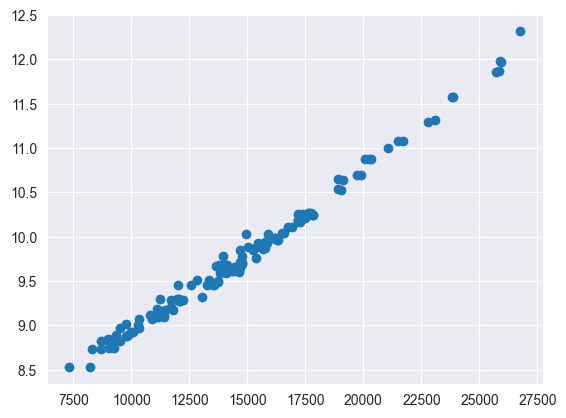

   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21      10.2444              17784.0     0.7531
1  22      10.2427              17844.0     0.7737
2  23      10.2425              17824.5     0.8063
3  24      10.1629              17287.5     0.7483
4  25      10.1636              17164.0     0.7635
5  26       9.7124              14675.5     0.8039
6  27       9.7125              14762.0     0.7448
7  28       9.8781              15341.5     0.8187
8  29       9.8802              15020.5     0.7621
9  30       9.9806              16184.0     0.7584
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21      10.2444              17784.0     0.7531
1  22      10.2427              17844.0     0.7737
no ha tronado
CGBR-linear
linear [10.35284285  9.88431952  9.08096438  8.88158683  9.13978493 10.71318831
  9.0941387   9.79590314  9.12280676  9.51525303  8.77943947 10.34857511
  9.29314514  8.86915472  9.64430569  9.79302706  9.61628707  9.59986556
 10.36035778  8.71876338 10.582465

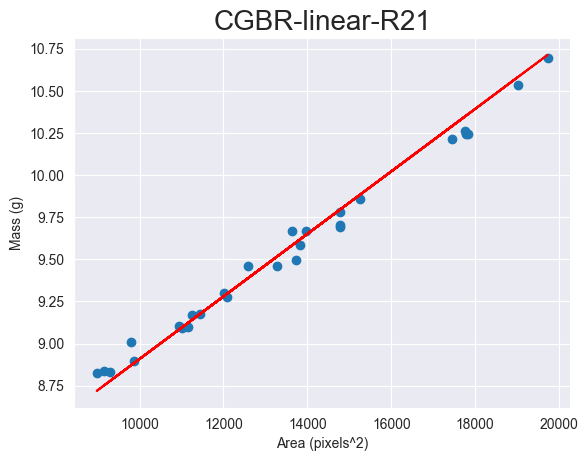


R-squared value: 0.9825



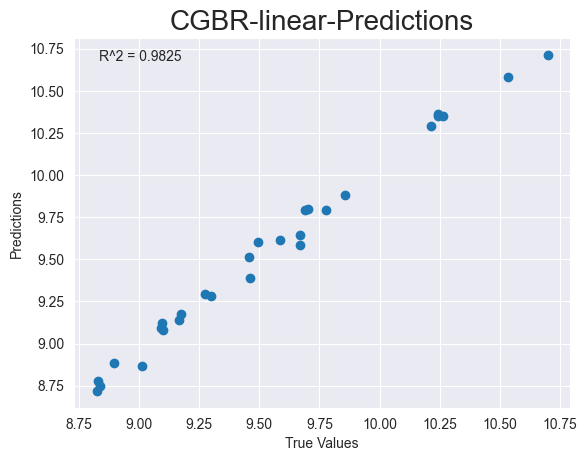

{'r2': 0.9824688869293533, 'loss': None, 'mse': 0.004841208252684513, 'mae': 0.05678845332477873, 'rmse': 0.06957879168744247}


<Figure size 640x480 with 0 Axes>

In [70]:
dataframe = None
data_ext = ".csv"
dataset_name = "CGBR"
model_name = "linear"
epoch = 1   
berry_type = "Blueberry"
experiment_name = "Linear"
if(data_ext == '.pkl'):
    dataframe = pd.read_pickle(dataset_name + data_ext)
else:
    dataframe = pd.read_csv(dataset_name + data_ext)
plt.scatter(dataframe["AreaInSquaredPixels"], dataframe["AverageMass"])
plt.show()
plt.clf()

print(dataframe.head(10))
test = AutomaticLearning(dataframe, dataset_name + "-" + model_name, model_name)
print("no ha tronado")
test.buildData()
test.buildModel()
test.train(epoch)
test.plot(berry_type + '-' + experiment_name, save = True, show = True)
result = test.gather_data()
print(result)

# EXPERIMENTS DICTIONARY

In [88]:


Experiments = {
    "Raw" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBR", "FBR", "CBR", "ABR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [2, 4, 10, 20]
                        },
                        "MachineLearning": {
                                "Datasets" : ["CGBR"],
                                "Extention" : ".csv",
                                "Models" : ["Linear", "SVR"],
                                "Epochs" : [1]
                        },
                        "Images" : {
                                "Datasets" : ["CIBR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3, 4, 5]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRR", "FRR", "CRR", "ARR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [2, 4, 10, 20]
                        },
                        "MachineLearning": {
                                "Datasets" : ["CGRR"],
                                "Extention" : ".csv",
                                "Models" : ["Linear", "SVR"],
                                "Epochs" : [1]
                        },
                        "Images" : {
                                "Datasets" : ["CIRR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3, 4, 5]
                        }
                }
        }
    },
    "YOLO" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBY", "FBY", "CBY", "ABY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [2, 4, 10, 20]
                        },
                        "MachineLearning": {
                                "Datasets" : ["CGBY"],
                                "Extention" : ".csv",
                                "Models" : ["Linear", "SVR"],
                                "Epochs" : [1]
                        },
                        "Images" : {
                                "Datasets" : ["CIBY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3, 4, 5]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRY", "FRY", "CRY", "ARY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [2, 4, 10, 20]
                        },
                        "MachineLearning": {
                                "Datasets" : ["CGRY"],
                                "Extention" : ".csv",
                                "Models" : ["Linear", "SVR"],
                                "Epochs" : [1]
                        },
                        "Images" : {
                                "Datasets" : ["CIRY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3, 4, 5]
                        }
                }
        }
    }
}

experimentsDeepLearning = {
    "Raw" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBR", "FBR", "CBR", "ABR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRR", "FRR", "CRR", "ARR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGSR", "FSR", "CSR", "ASR"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        }
    },
    "YOLO" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBY", "FBY", "CBY", "ABY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRY", "FRY", "CRY", "ARY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBY", "FBY", "CBY", "ABY"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        }
    },
    "Detectron2" : {
        "Blueberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGBD", "FBD", "CBD", "ABD"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGRD", "FRD", "CRD", "ARD"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "DeepLearning": {
                                "Datasets" : ["CGSD", "FSD", "CSD", "ASD"],
                                "Extention" : ".csv",
                                "Models" : ["MLP", "FCNN", "DeepSVM"],
                                "Epochs" : [100, 500]
                        }
                }
        }
    }
}


experimentsMachineLearning = {
    "Raw" : {
        "Blueberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGBR"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGRR"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGSR"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        }
    },
    "YOLO" : {
        "Blueberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGBY"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGRY"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGSY"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        }
    },
    "Detectron2" : {
        "Blueberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGBD"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGRD"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "MachineLearning": {
                                "Datasets" : ["CGSD"],
                                "Extention" : ".csv",
                                "Models" : ["linear", "SVR"],
                                "Epochs" : [1]
                        }
                }
        }
    }
}


experimentsCNN = {
    "Raw" : {
        "Blueberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIBR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIRR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CISR"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        }
    },
    "YOLO" : {
        "Blueberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIBY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIRY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CISY"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        }
    },
    "Detectron2" : {
        "Blueberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIBD"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        },
        "Raspberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CIRD"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        },
        "Strawberries": {
                "Tests" : {
                        "Images" : {
                                "Datasets" : ["CISD"],
                                "Extention" : ".pkl",
                                "Models" : ["CNN", "RestNet", "DenseNet", "MobileNet"],
                                "Epochs" : [2, 3]
                        }
                }
        }
    }
}





Running experiments for Blueberries...
Running DeepLearning tests...
Running tests on CGBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_101"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_296 (Dense)           (None, 64)                192       
                                                                 
 dropout_66 (Dropout)        (None, 64)                0         
                                                                 
 dense_297 (Dense)           (None, 32)                2080      
                                                                 
 dropout_67 (Dropout)        (None, 32)                0         
                                                                 

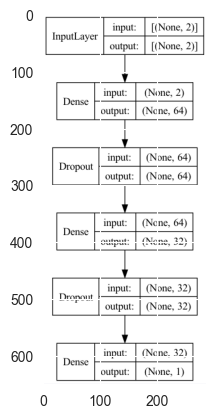

CGBR-MLP-1


2023-05-02 10:13:57.007428: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 300ms/step - loss: 1931104.5000 - mse: 1931104.5000 - mae: 1080.4812 - root_mean_squared_error: 1389.6418 - val_loss: 50933.7109 - val_mse: 50933.7109 - val_mae: 219.9613 - val_root_mean_squared_error: 225.6850


2023-05-02 10:13:58.516810: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 81ms/step - loss: 78186.1719 - mse: 78186.1719 - mae: 270.6571 - root_mean_squared_error: 279.6179
Test loss: [78186.171875, 78186.171875, 270.6570739746094, 279.6178894042969]
['loss', 'mse', 'mae', 'root_mean_squared_error']


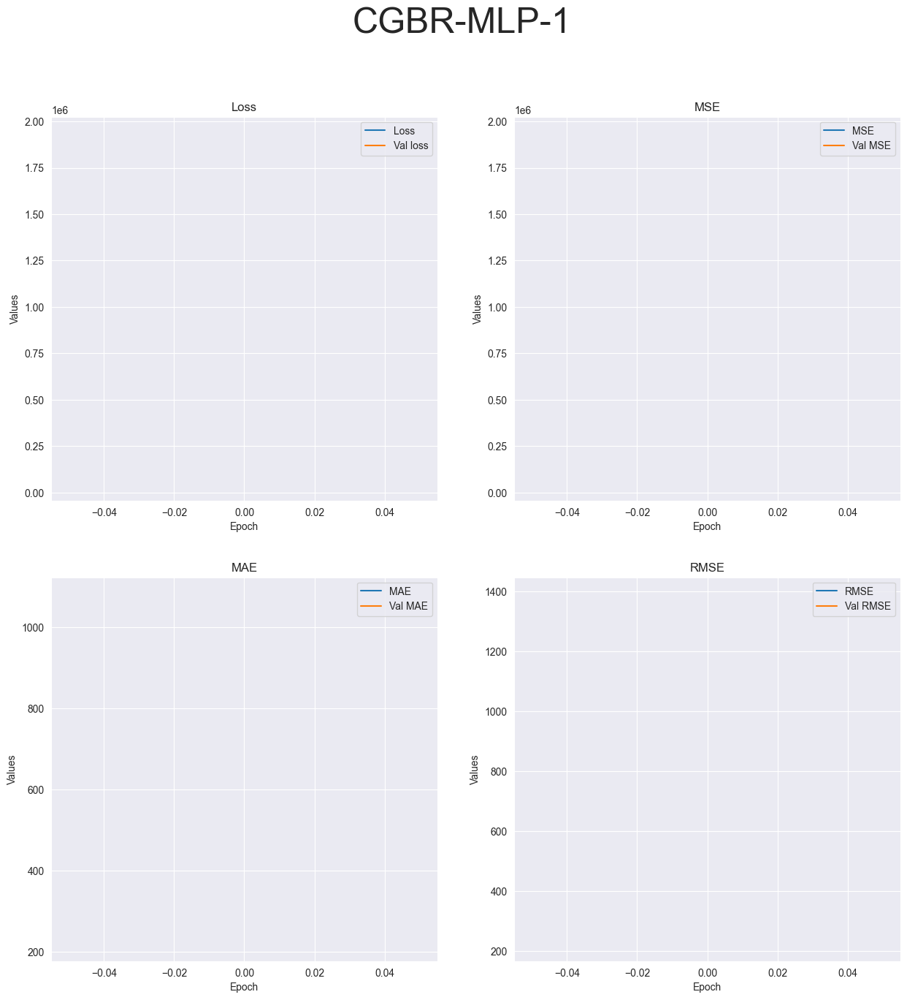

R-squared value: -133489.8933


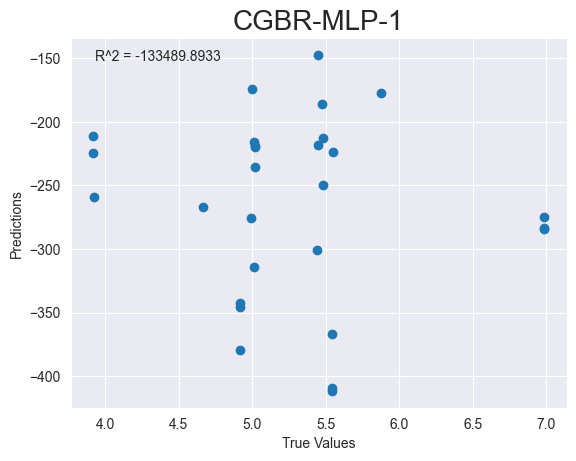

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_102"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_299 (Dense)           (None, 64)                192       
                                                                 
 dropout_68 (Dropout)        (None, 64)                0         
                                                                 
 dense_300 (Dense)           (None, 32)                2080      
                                                                 
 dropout_69 (Dropout)        (None, 32)                0         
                                                                 
 dense_301 (Dense)           (None, 1)                 33        
                                                                 


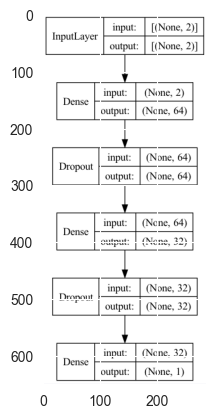

CGBR-MLP-4
Epoch 1/4


2023-05-02 10:14:00.018595: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 264ms/step - loss: 2730065.7500 - mse: 2730065.7500 - mae: 1343.4875 - root_mean_squared_error: 1652.2910 - val_loss: 1249.9309 - val_mse: 1249.9309 - val_mae: 34.1330 - val_root_mean_squared_error: 35.3544
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 541208.7500 - mse: 541208.7500 - mae: 609.3057 - root_mean_squared_error: 735.6689

2023-05-02 10:14:00.991140: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 39ms/step - loss: 493546.1562 - mse: 493546.1562 - mae: 548.7688 - root_mean_squared_error: 702.5284 - val_loss: 141150.8281 - val_mse: 141150.8281 - val_mae: 358.5188 - val_root_mean_squared_error: 375.7004
Epoch 3/4
3/3 [==============================] - 0s 25ms/step - loss: 376858.2500 - mse: 376858.2500 - mae: 464.1815 - root_mean_squared_error: 613.8878 - val_loss: 1027.1545 - val_mse: 1027.1545 - val_mae: 30.0109 - val_root_mean_squared_error: 32.0493
Epoch 4/4
1/1 [==============================] - 0s 100ms/step - loss: 12471.4229 - mse: 12471.4229 - mae: 105.7011 - root_mean_squared_error: 111.6755
Test loss: [12471.4228515625, 12471.4228515625, 105.70111846923828, 111.67552185058594]
['loss', 'mse', 'mae', 'root_mean_squared_error']


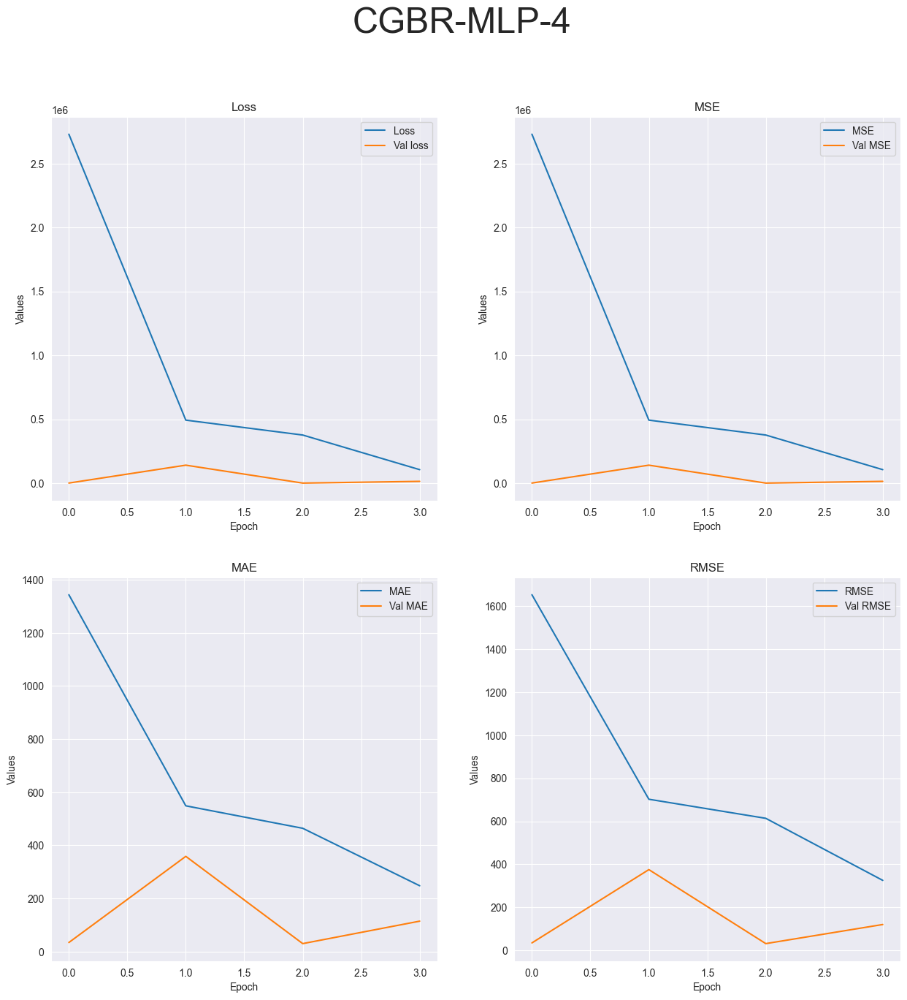

R-squared value: -35688.9116


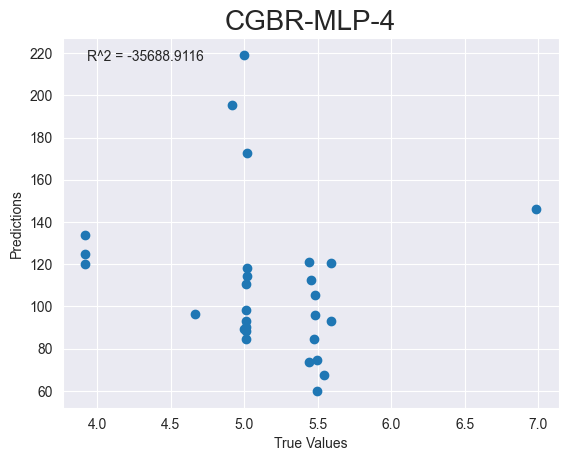

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_103"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_302 (Dense)           (None, 64)                192       
                                                                 
 dropout_70 (Dropout)        (None, 64)                0         
                                                                 
 dense_303 (Dense)           (None, 32)                2080      
                                                                 
 dropout_71 (Dropout)        (None, 32)                0         
                                                                 
 dense_304 (Dense)           (None, 1)                 33        
                                                                 

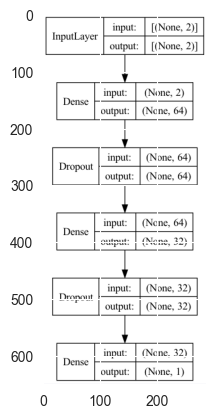

CGBR-MLP-10
Epoch 1/10


2023-05-02 10:14:02.733682: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 222ms/step - loss: 2508475.7500 - mse: 2508475.7500 - mae: 1262.2791 - root_mean_squared_error: 1583.8168 - val_loss: 658.6792 - val_mse: 658.6792 - val_mae: 24.0872 - val_root_mean_squared_error: 25.6647
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 659467.2500 - mse: 659467.2500 - mae: 596.9396 - root_mean_squared_error: 812.0759

2023-05-02 10:14:03.509332: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 24ms/step - loss: 527895.7500 - mse: 527895.7500 - mae: 543.3682 - root_mean_squared_error: 726.5643 - val_loss: 9679.7568 - val_mse: 9679.7568 - val_mae: 94.6234 - val_root_mean_squared_error: 98.3858
Epoch 3/10
3/3 [==============================] - 0s 40ms/step - loss: 234242.5156 - mse: 234242.5156 - mae: 362.8885 - root_mean_squared_error: 483.9861 - val_loss: 70071.3281 - val_mse: 70071.3281 - val_mae: 253.0035 - val_root_mean_squared_error: 264.7099
Epoch 4/10
3/3 [==============================] - 0s 31ms/step - loss: 80555.0000 - mse: 80555.0000 - mae: 209.2354 - root_mean_squared_error: 283.8221 - val_loss: 66226.6172 - val_mse: 66226.6172 - val_mae: 245.9524 - val_root_mean_squared_error: 257.3453
Epoch 5/10
3/3 [==============================] - 0s 40ms/step - loss: 57563.9531 - mse: 57563.9531 - mae: 198.7654 - root_mean_squared_error: 239.9249 - val_loss: 35728.9492 - val_mse: 35728.9492 - val_mae: 180.5332 - val_root_mean_squared

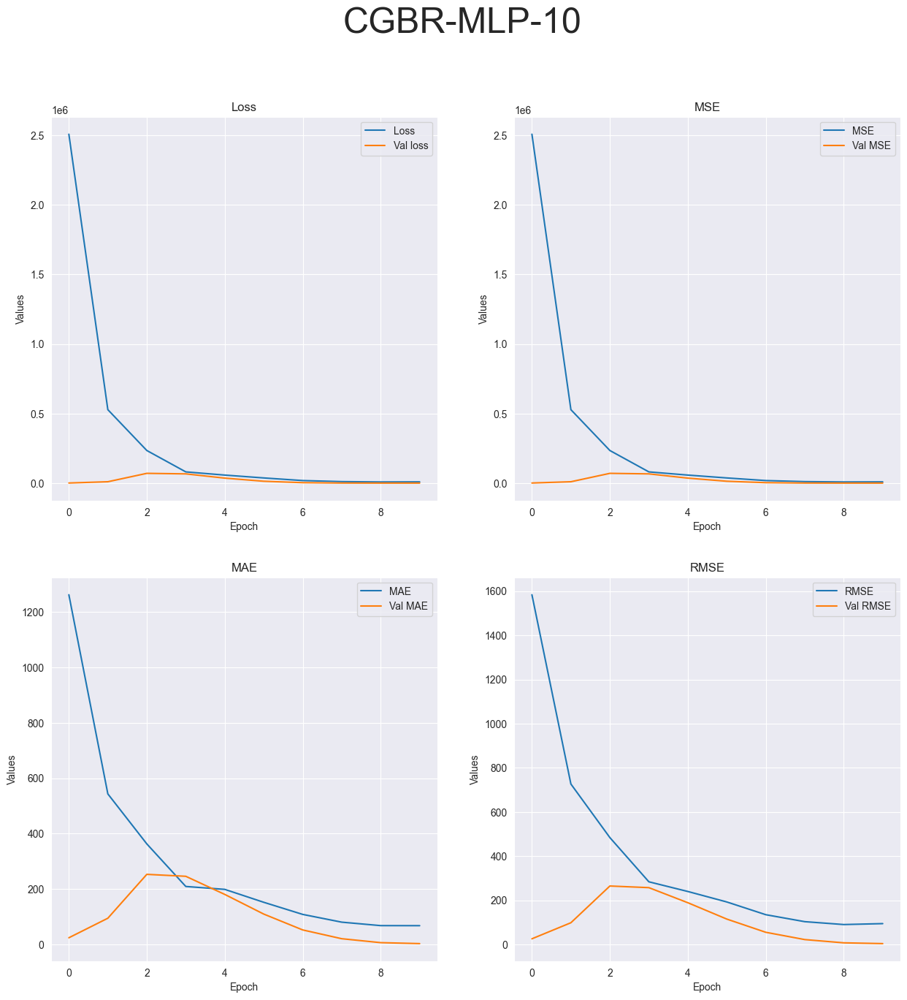

R-squared value: -23.9595


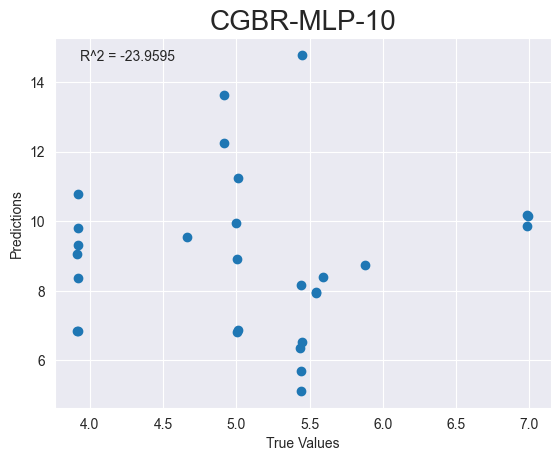

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_104"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_305 (Dense)           (None, 64)                192       
                                                                 
 dropout_72 (Dropout)        (None, 64)                0         
                                                                 
 dense_306 (Dense)           (None, 32)                2080      
                                                                 
 dropout_73 (Dropout)        (None, 32)                0         
                                                                 
 dense_307 (Dense)           (None, 1)                 33        
                                                                 

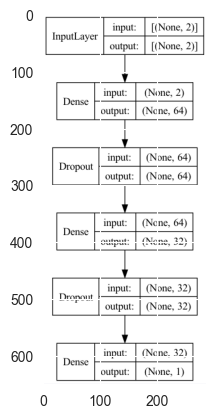

CGBR-MLP-20
Epoch 1/20


2023-05-02 10:14:05.431238: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 156ms/step - loss: 2737144.7500 - mse: 2737144.7500 - mae: 1291.3274 - root_mean_squared_error: 1654.4319 - val_loss: 24137.1758 - val_mse: 24137.1758 - val_mae: 148.9451 - val_root_mean_squared_error: 155.3614
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 591930.1250 - mse: 591930.1250 - mae: 635.6565 - root_mean_squared_error: 769.3699

2023-05-02 10:14:05.938118: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 53ms/step - loss: 605862.5625 - mse: 605862.5625 - mae: 589.9862 - root_mean_squared_error: 778.3718 - val_loss: 201718.5625 - val_mse: 201718.5625 - val_mae: 429.7851 - val_root_mean_squared_error: 449.1309
Epoch 3/20
3/3 [==============================] - 0s 43ms/step - loss: 337438.7500 - mse: 337438.7500 - mae: 445.4545 - root_mean_squared_error: 580.8948 - val_loss: 1000.1435 - val_mse: 1000.1435 - val_mae: 29.7585 - val_root_mean_squared_error: 31.6250
Epoch 4/20
3/3 [==============================] - 0s 30ms/step - loss: 100921.4844 - mse: 100921.4844 - mae: 228.9696 - root_mean_squared_error: 317.6814 - val_loss: 17335.1738 - val_mse: 17335.1738 - val_mae: 125.4251 - val_root_mean_squared_error: 131.6631
Epoch 5/20
3/3 [==============================] - 0s 24ms/step - loss: 82373.4219 - mse: 82373.4219 - mae: 216.5488 - root_mean_squared_error: 287.0077 - val_loss: 16178.7637 - val_mse: 16178.7637 - val_mae: 121.1544 - val_root_mean_squ

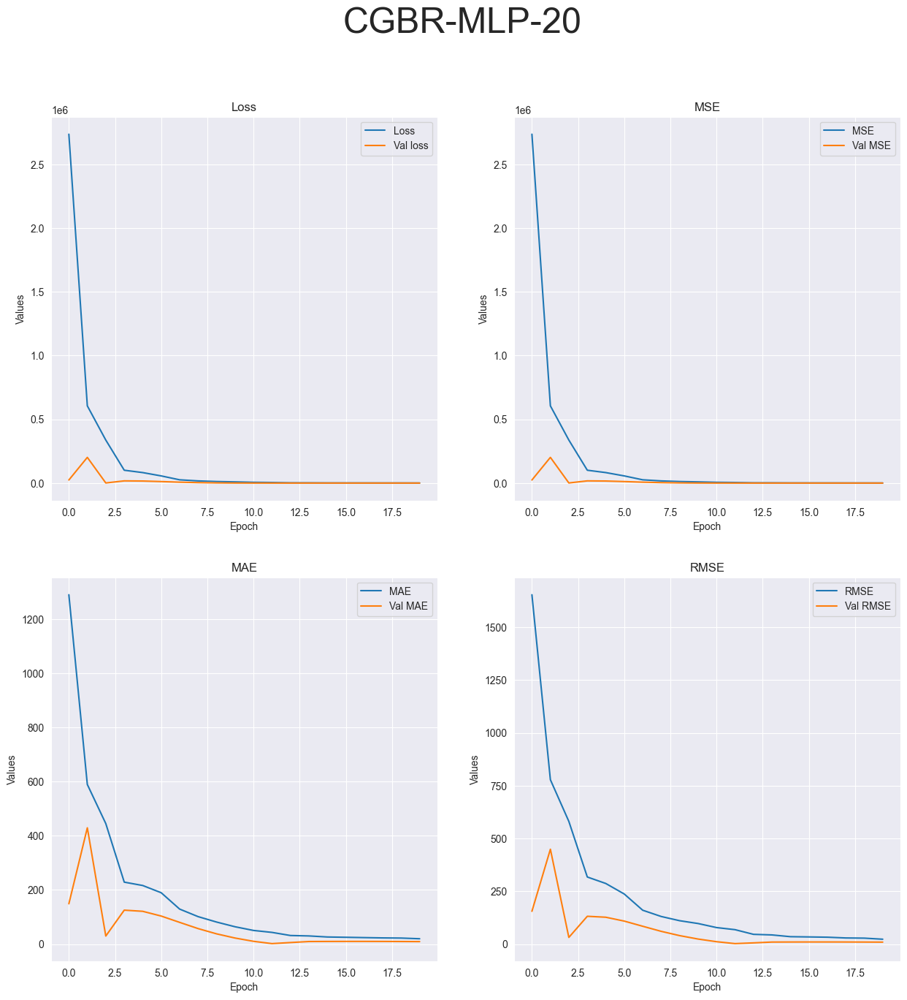

R-squared value: -259.2775


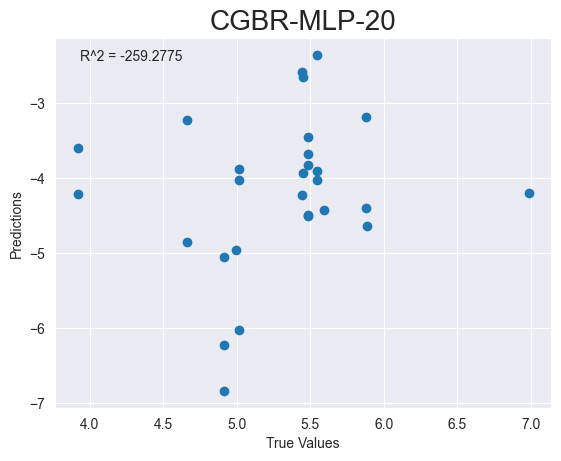

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_105"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_308 (Dense)           (None, 64)                192       
                                                                 
 dense_309 (Dense)           (None, 32)                2080      
                                                                 
 dense_310 (Dense)           (None, 16)                528       
                                                                 
 dense_311 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
____________________________________

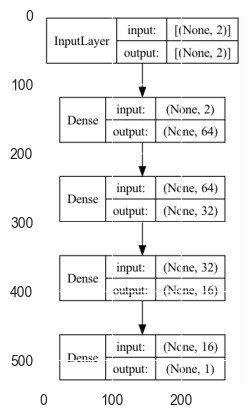

CGBR-FCNN-1


2023-05-02 10:14:08.510895: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 171ms/step - loss: 6314433.5000 - mse: 6314433.5000 - mae: 1906.4663 - root_mean_squared_error: 2512.8538 - val_loss: 124213.2812 - val_mse: 124213.2812 - val_mae: 338.1737 - val_root_mean_squared_error: 352.4391


2023-05-02 10:14:09.030574: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 130ms/step - loss: 166702.6719 - mse: 166702.6719 - mae: 390.7466 - root_mean_squared_error: 408.2924
Test loss: [166702.671875, 166702.671875, 390.74664306640625, 408.2923889160156]
['loss', 'mse', 'mae', 'root_mean_squared_error']


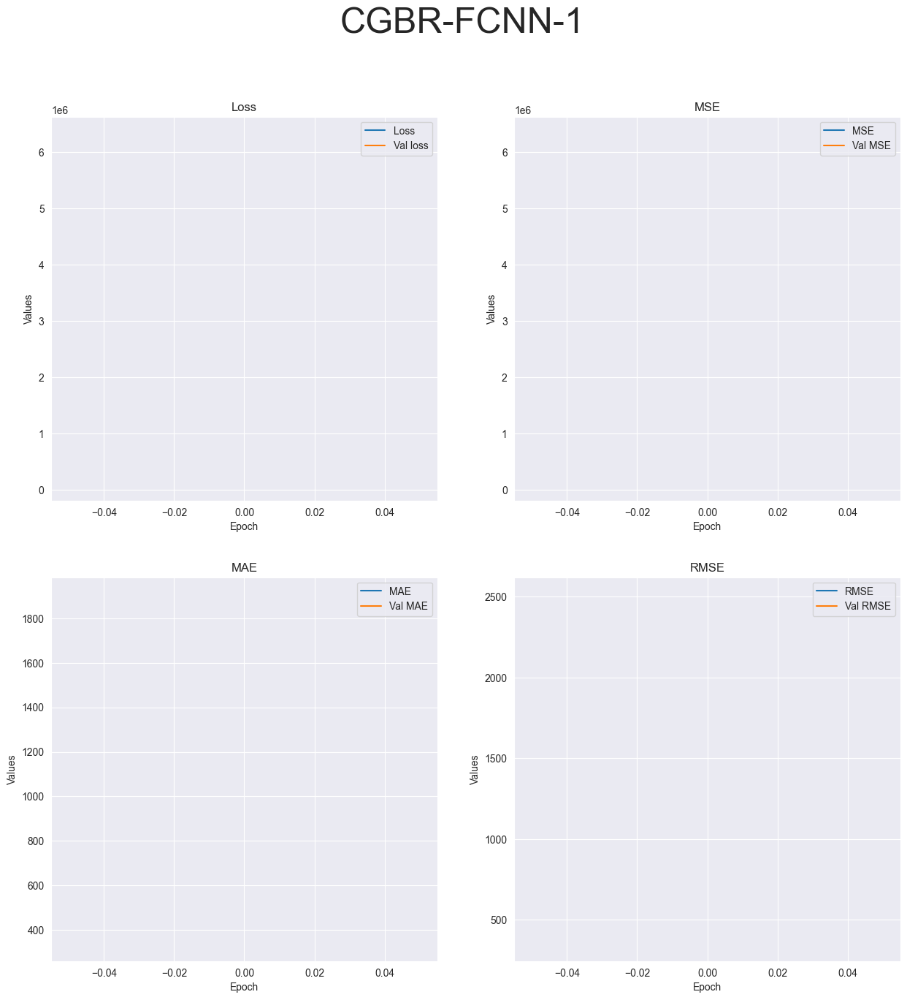

R-squared value: -603378.8153


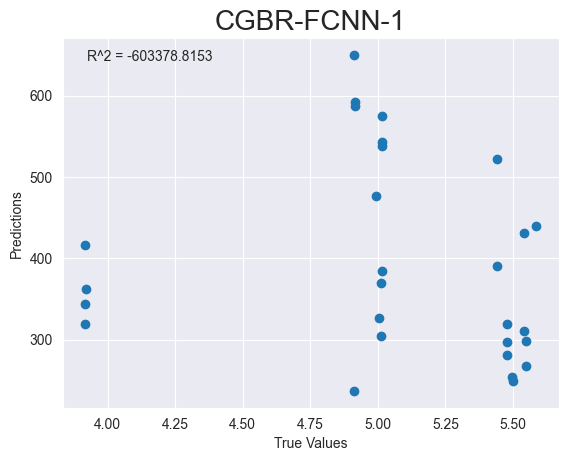

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_106"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_312 (Dense)           (None, 64)                192       
                                                                 
 dense_313 (Dense)           (None, 32)                2080      
                                                                 
 dense_314 (Dense)           (None, 16)                528       
                                                                 
 dense_315 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
________________________________________________________________

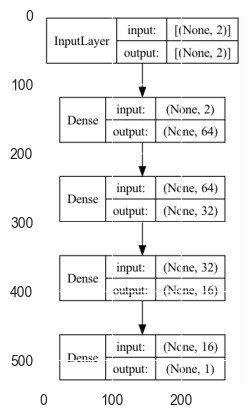

CGBR-FCNN-4
Epoch 1/4


2023-05-02 10:14:11.209421: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 178ms/step - loss: 7236614.0000 - mse: 7236614.0000 - mae: 1963.7477 - root_mean_squared_error: 2690.0955 - val_loss: 235005.6562 - val_mse: 235005.6562 - val_mae: 468.9122 - val_root_mean_squared_error: 484.7738
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 224611.2031 - mse: 224611.2031 - mae: 456.3471 - root_mean_squared_error: 473.9316

2023-05-02 10:14:11.848425: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 54ms/step - loss: 1687080.1250 - mse: 1687080.1250 - mae: 1131.4564 - root_mean_squared_error: 1298.8765 - val_loss: 3042655.0000 - val_mse: 3042655.0000 - val_mae: 1688.1107 - val_root_mean_squared_error: 1744.3208
Epoch 3/4
3/3 [==============================] - 0s 41ms/step - loss: 1889699.2500 - mse: 1889699.2500 - mae: 1291.8430 - root_mean_squared_error: 1374.6633 - val_loss: 352684.2188 - val_mse: 352684.2188 - val_mae: 574.5160 - val_root_mean_squared_error: 593.8723
Epoch 4/4
1/1 [==============================] - 0s 53ms/step - loss: 39144.0195 - mse: 39144.0195 - mae: 189.6787 - root_mean_squared_error: 197.8485
Test loss: [39144.01953125, 39144.01953125, 189.67868041992188, 197.84848022460938]
['loss', 'mse', 'mae', 'root_mean_squared_error']


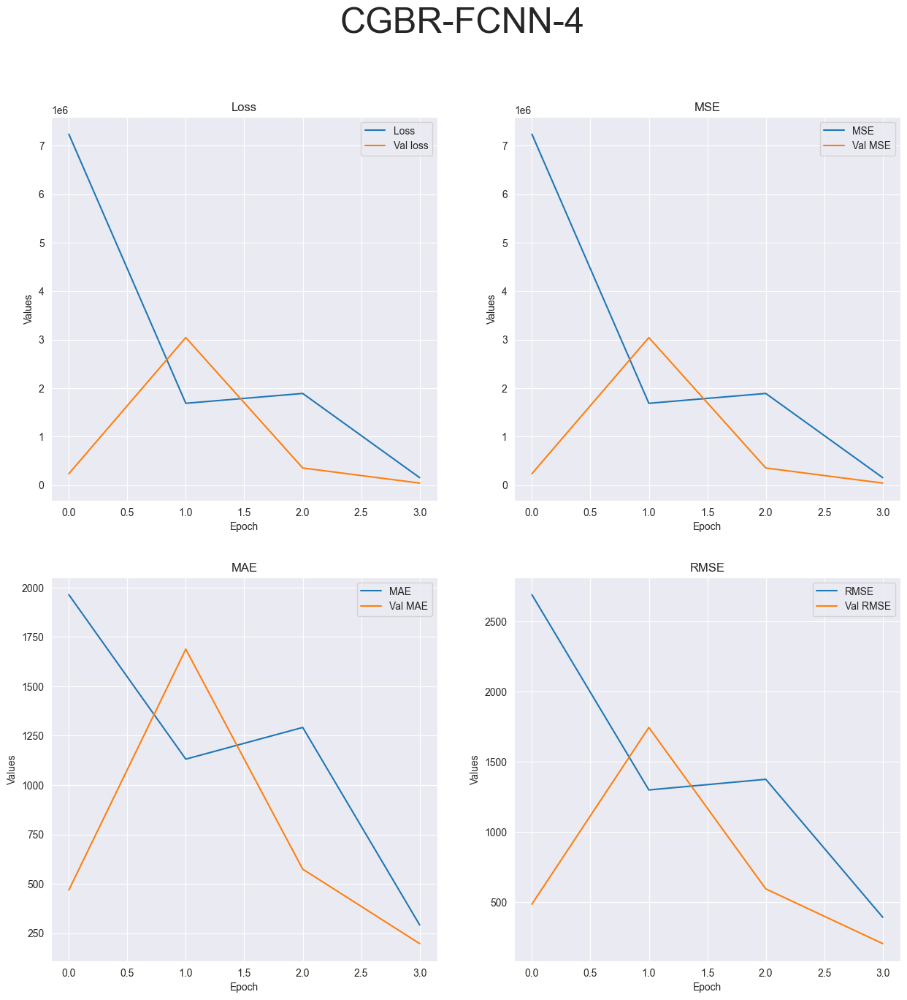

R-squared value: -67265.5389


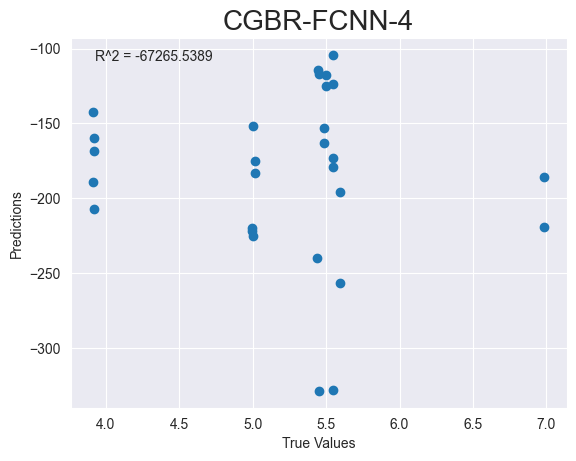

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_107"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_316 (Dense)           (None, 64)                192       
                                                                 
 dense_317 (Dense)           (None, 32)                2080      
                                                                 
 dense_318 (Dense)           (None, 16)                528       
                                                                 
 dense_319 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_______________________________________________________________

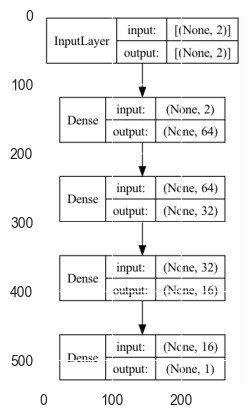

CGBR-FCNN-10
Epoch 1/10


2023-05-02 10:14:13.522041: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 212ms/step - loss: 6806653.0000 - mse: 6806653.0000 - mae: 1937.9410 - root_mean_squared_error: 2608.9563 - val_loss: 218846.9062 - val_mse: 218846.9062 - val_mae: 451.5173 - val_root_mean_squared_error: 467.8108
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 233807.1250 - mse: 233807.1250 - mae: 470.1488 - root_mean_squared_error: 483.5361

2023-05-02 10:14:14.084627: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 33ms/step - loss: 1907987.6250 - mse: 1907987.6250 - mae: 1203.3157 - root_mean_squared_error: 1381.2992 - val_loss: 2250288.2500 - val_mse: 2250288.2500 - val_mae: 1448.6025 - val_root_mean_squared_error: 1500.0961
Epoch 3/10
3/3 [==============================] - 0s 32ms/step - loss: 1703010.1250 - mse: 1703010.1250 - mae: 1223.5930 - root_mean_squared_error: 1304.9943 - val_loss: 195235.2969 - val_mse: 195235.2969 - val_mae: 426.4460 - val_root_mean_squared_error: 441.8544
Epoch 4/10
3/3 [==============================] - 0s 25ms/step - loss: 89980.8281 - mse: 89980.8281 - mae: 241.1797 - root_mean_squared_error: 299.9680 - val_loss: 54298.6289 - val_mse: 54298.6289 - val_mae: 225.4088 - val_root_mean_squared_error: 233.0207
Epoch 5/10
3/3 [==============================] - 0s 24ms/step - loss: 123582.3359 - mse: 123582.3359 - mae: 332.2378 - root_mean_squared_error: 351.5428 - val_loss: 190976.4375 - val_mse: 190976.4375 - val_mae: 422.4427

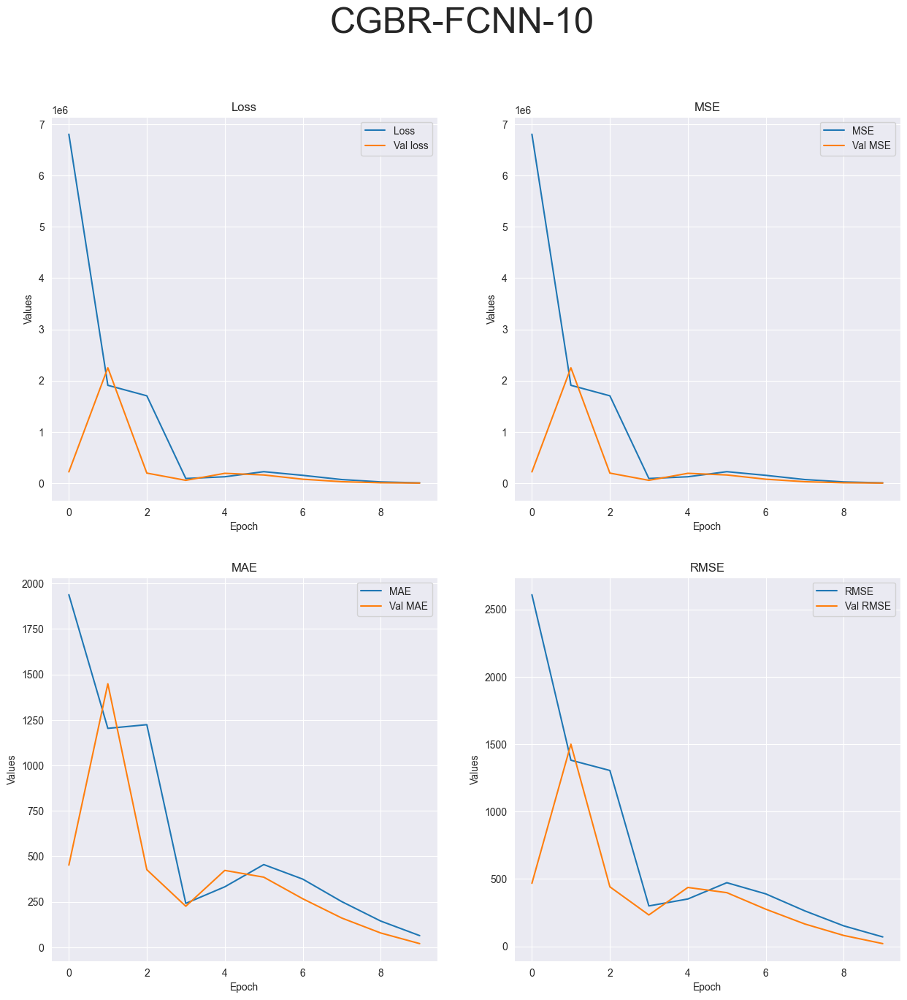

R-squared value: -917.3556


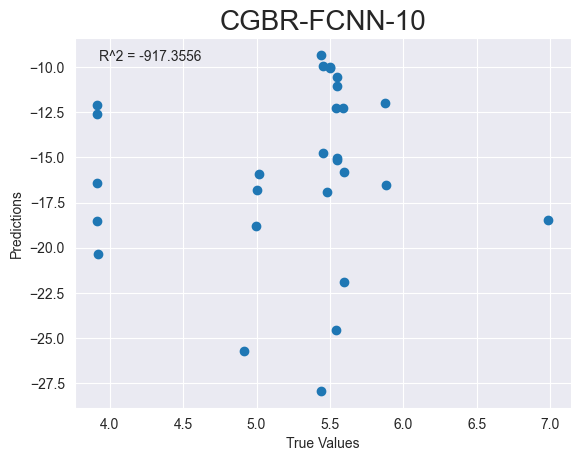

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_108"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_320 (Dense)           (None, 64)                192       
                                                                 
 dense_321 (Dense)           (None, 32)                2080      
                                                                 
 dense_322 (Dense)           (None, 16)                528       
                                                                 
 dense_323 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_______________________________________________________________

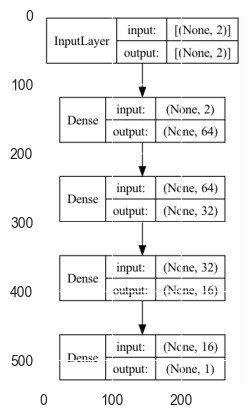

CGBR-FCNN-20
Epoch 1/20


2023-05-02 10:14:15.977271: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 221ms/step - loss: 6727961.0000 - mse: 6727961.0000 - mae: 1933.4480 - root_mean_squared_error: 2593.8313 - val_loss: 210865.0156 - val_mse: 210865.0156 - val_mae: 439.6473 - val_root_mean_squared_error: 459.2004
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 241104.3438 - mse: 241104.3438 - mae: 468.0579 - root_mean_squared_error: 491.0238

2023-05-02 10:14:16.520212: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 30ms/step - loss: 1677465.8750 - mse: 1677465.8750 - mae: 1146.1877 - root_mean_squared_error: 1295.1702 - val_loss: 2464343.7500 - val_mse: 2464343.7500 - val_mae: 1504.0598 - val_root_mean_squared_error: 1569.8229
Epoch 3/20
3/3 [==============================] - 0s 34ms/step - loss: 1785752.2500 - mse: 1785752.2500 - mae: 1260.4187 - root_mean_squared_error: 1336.3204 - val_loss: 242056.6250 - val_mse: 242056.6250 - val_mae: 471.0752 - val_root_mean_squared_error: 491.9925
Epoch 4/20
3/3 [==============================] - 0s 33ms/step - loss: 108882.9453 - mse: 108882.9453 - mae: 259.3523 - root_mean_squared_error: 329.9742 - val_loss: 48234.0000 - val_mse: 48234.0000 - val_mae: 210.9215 - val_root_mean_squared_error: 219.6224
Epoch 5/20
3/3 [==============================] - 0s 16ms/step - loss: 114059.2500 - mse: 114059.2500 - mae: 316.1373 - root_mean_squared_error: 337.7266 - val_loss: 194340.7031 - val_mse: 194340.7031 - val_mae: 422.93

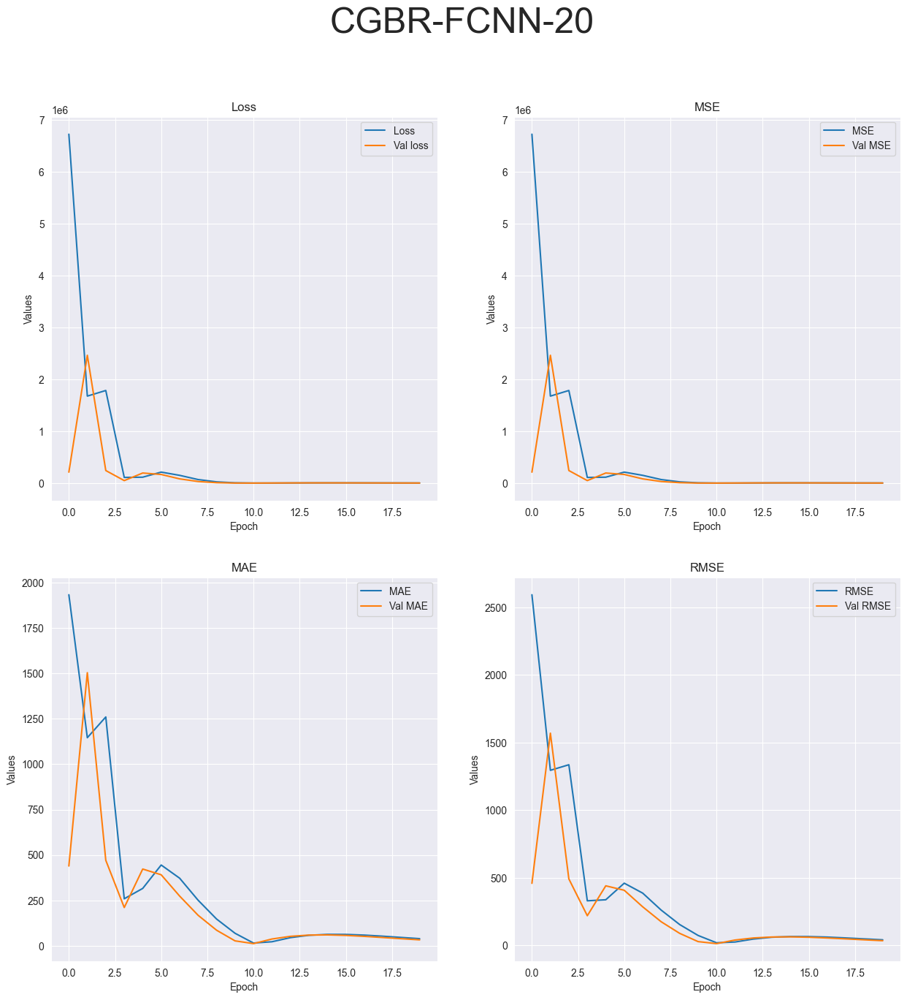

R-squared value: -3031.6609


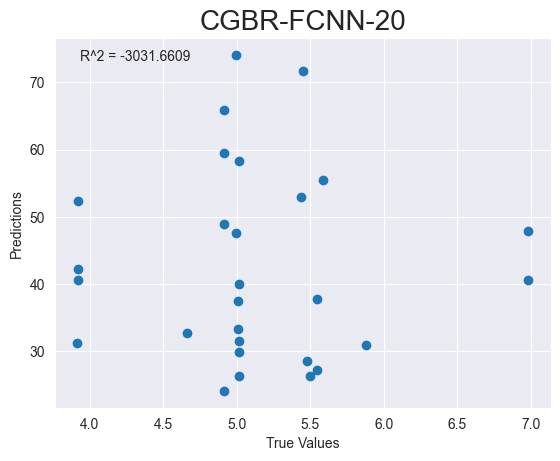

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_109"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_324 (Dense)           (None, 128)               384       
                                                                 
 dense_325 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


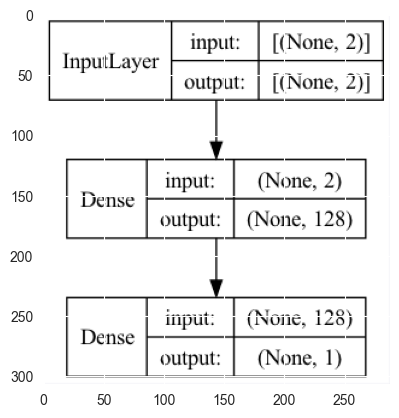

CGBR-DeepSVM-1


2023-05-02 10:14:19.003432: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 163ms/step - loss: 648374592.0000 - mse: 648374592.0000 - mae: 24240.5059 - root_mean_squared_error: 25463.2012 - val_loss: 367628608.0000 - val_mse: 367628608.0000 - val_mae: 18319.2637 - val_root_mean_squared_error: 19173.6445


2023-05-02 10:14:19.517714: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 51ms/step - loss: 343187616.0000 - mse: 343187616.0000 - mae: 17722.6484 - root_mean_squared_error: 18525.3242
Test loss: [343187616.0, 343187616.0, 17722.6484375, 18525.32421875]
['loss', 'mse', 'mae', 'root_mean_squared_error']


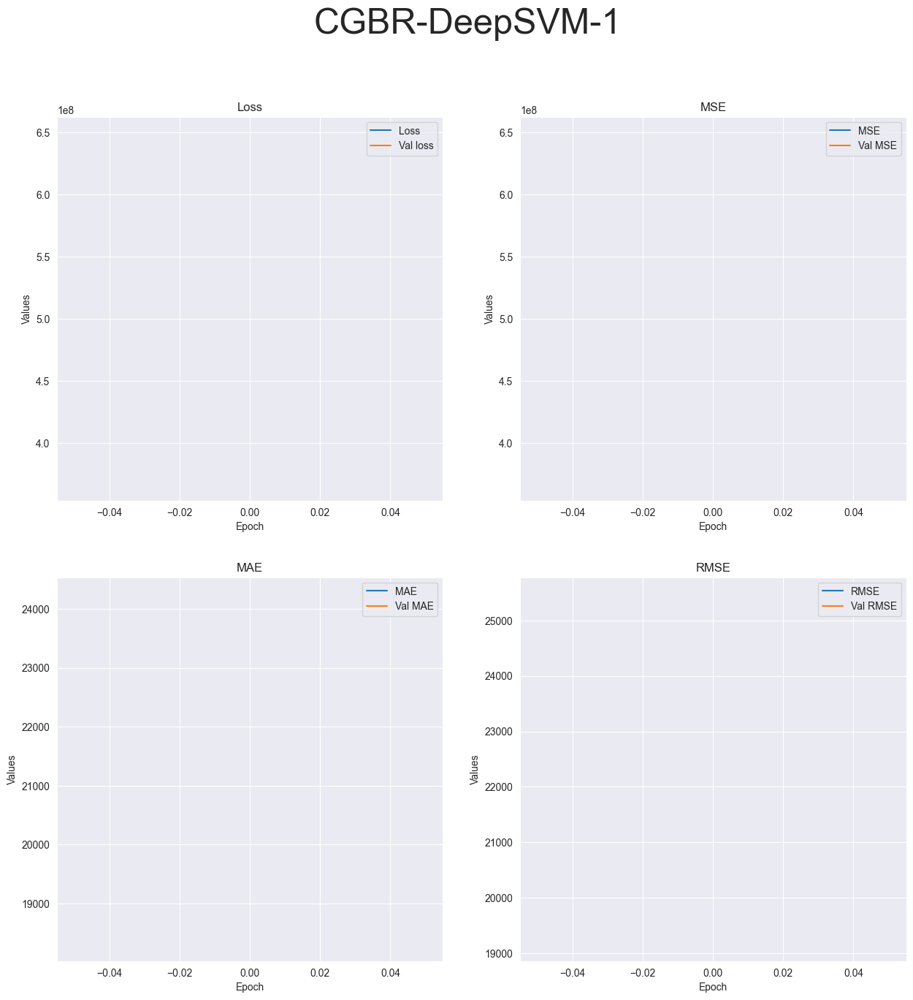

R-squared value: -418208501.7853


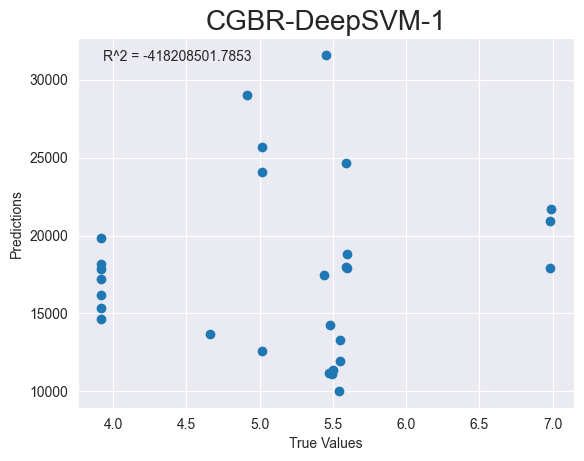

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_110"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_326 (Dense)           (None, 128)               384       
                                                                 
 dense_327 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


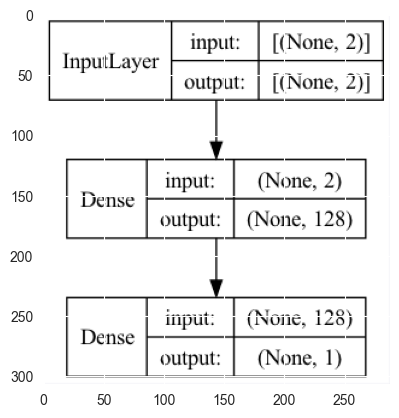

CGBR-DeepSVM-4
Epoch 1/4


2023-05-02 10:14:21.602387: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 209ms/step - loss: 635225920.0000 - mse: 635225920.0000 - mae: 24290.7871 - root_mean_squared_error: 25203.6895 - val_loss: 333567072.0000 - val_mse: 333567072.0000 - val_mae: 17584.3828 - val_root_mean_squared_error: 18263.8184
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 341650336.0000 - mse: 341650336.0000 - mae: 17749.3945 - root_mean_squared_error: 18483.7852

2023-05-02 10:14:22.237199: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 41ms/step - loss: 259014432.0000 - mse: 259014432.0000 - mae: 15367.5264 - root_mean_squared_error: 16093.9258 - val_loss: 126700920.0000 - val_mse: 126700920.0000 - val_mae: 10837.2354 - val_root_mean_squared_error: 11256.1504
Epoch 3/4
3/3 [==============================] - 0s 46ms/step - loss: 96256192.0000 - mse: 96256192.0000 - mae: 9419.2305 - root_mean_squared_error: 9811.0244 - val_loss: 48768992.0000 - val_mse: 48768992.0000 - val_mae: 6723.4155 - val_root_mean_squared_error: 6983.4800
Epoch 4/4
1/1 [==============================] - 0s 47ms/step - loss: 19656900.0000 - mse: 19656900.0000 - mae: 4217.6870 - root_mean_squared_error: 4433.6104
Test loss: [19656900.0, 19656900.0, 4217.68701171875, 4433.6103515625]
['loss', 'mse', 'mae', 'root_mean_squared_error']


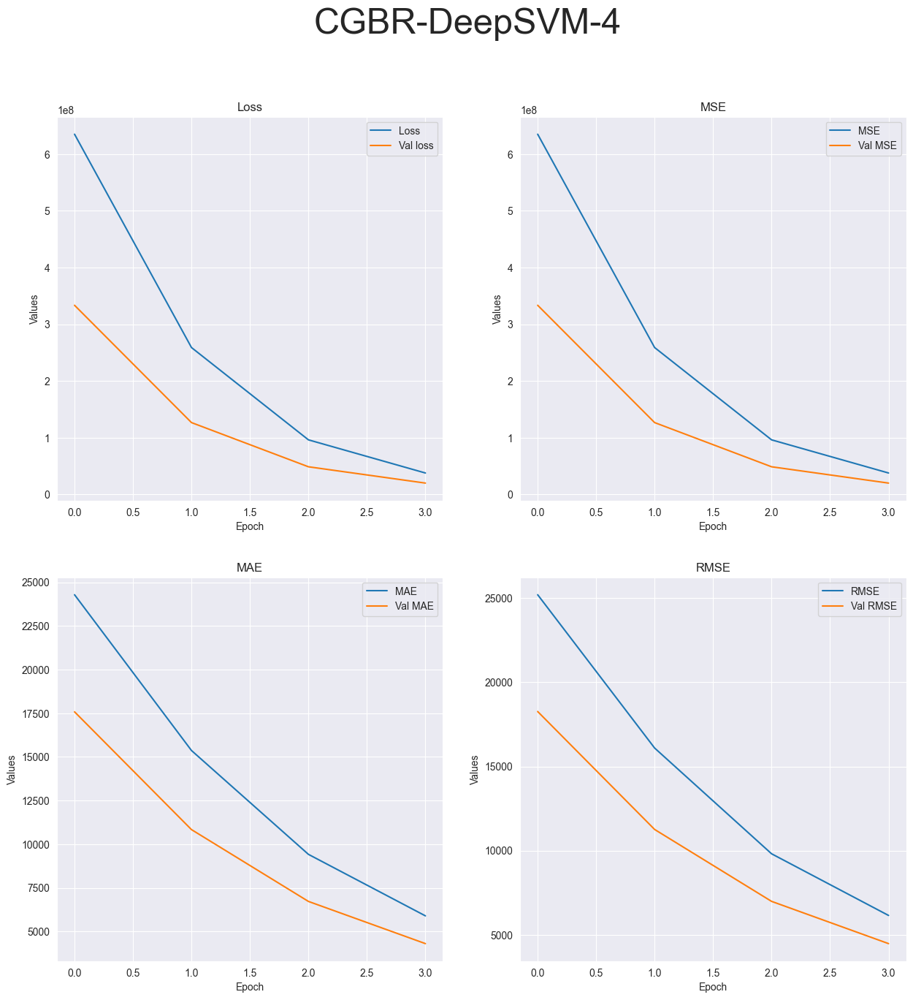

R-squared value: -62441129.7023


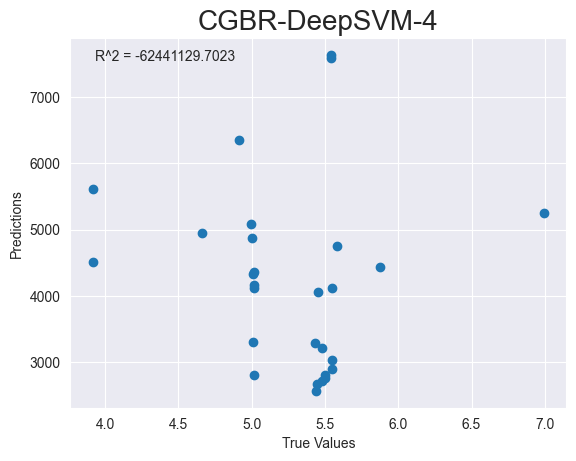

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_111"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_328 (Dense)           (None, 128)               384       
                                                                 
 dense_329 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


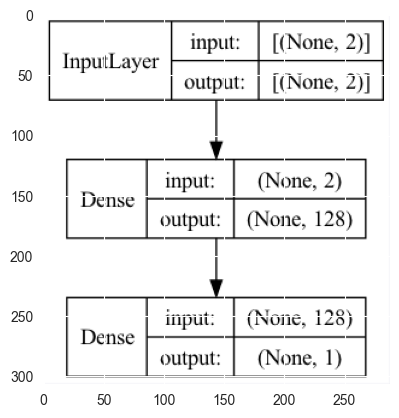

CGBR-DeepSVM-10
Epoch 1/10


2023-05-02 10:14:24.074577: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 153ms/step - loss: 652701760.0000 - mse: 652701760.0000 - mae: 24441.7637 - root_mean_squared_error: 25548.0293 - val_loss: 342012512.0000 - val_mse: 342012512.0000 - val_mae: 17967.2969 - val_root_mean_squared_error: 18493.5801
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 347420480.0000 - mse: 347420480.0000 - mae: 17670.9727 - root_mean_squared_error: 18639.2188

2023-05-02 10:14:24.530709: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 43ms/step - loss: 266695392.0000 - mse: 266695392.0000 - mae: 15508.0576 - root_mean_squared_error: 16330.8115 - val_loss: 130994320.0000 - val_mse: 130994320.0000 - val_mae: 11119.4297 - val_root_mean_squared_error: 11445.2754
Epoch 3/10
3/3 [==============================] - 0s 33ms/step - loss: 100132648.0000 - mse: 100132648.0000 - mae: 9553.6602 - root_mean_squared_error: 10006.6299 - val_loss: 50799800.0000 - val_mse: 50799800.0000 - val_mae: 6924.3501 - val_root_mean_squared_error: 7127.3979
Epoch 4/10
3/3 [==============================] - 0s 18ms/step - loss: 40202672.0000 - mse: 40202672.0000 - mae: 6023.3945 - root_mean_squared_error: 6340.5576 - val_loss: 20907364.0000 - val_mse: 20907364.0000 - val_mae: 4442.0776 - val_root_mean_squared_error: 4572.4570
Epoch 5/10
3/3 [==============================] - 0s 23ms/step - loss: 17280392.0000 - mse: 17280392.0000 - mae: 3928.6790 - root_mean_squared_error: 4156.9692 - val_loss: 9657933.0

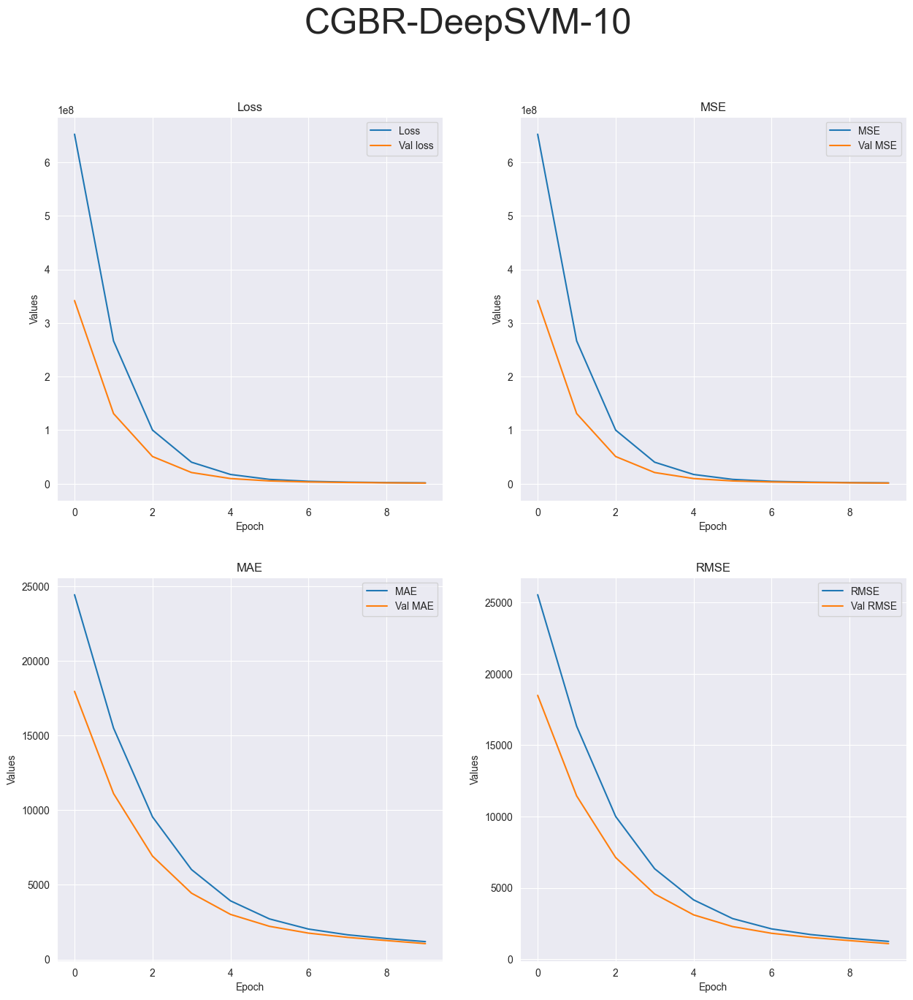

R-squared value: -2598875.6519


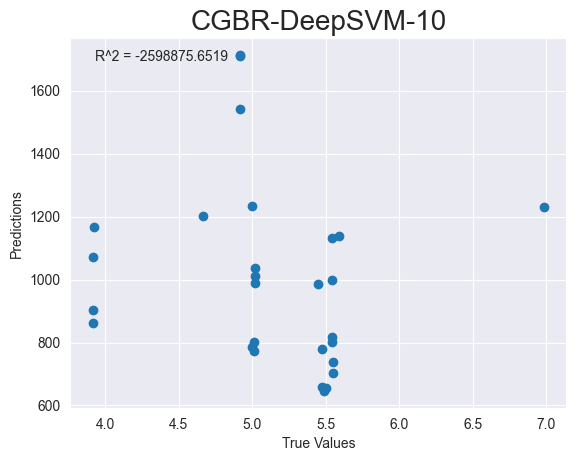

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
Model: "sequential_112"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_330 (Dense)           (None, 128)               384       
                                                                 
 dense_331 (Dense)           (None, 1)                 129       
                                                                 
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
None


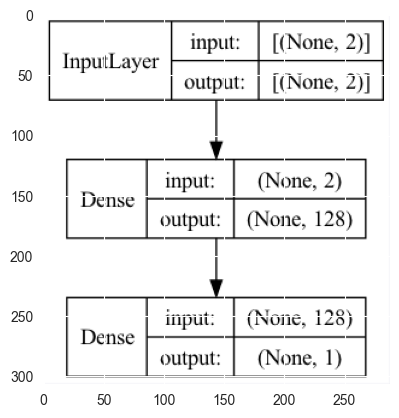

CGBR-DeepSVM-20
Epoch 1/20


2023-05-02 10:14:26.739552: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 194ms/step - loss: 639099712.0000 - mse: 639099712.0000 - mae: 24079.6426 - root_mean_squared_error: 25280.4219 - val_loss: 339436000.0000 - val_mse: 339436000.0000 - val_mae: 17909.3828 - val_root_mean_squared_error: 18423.7891
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 338121760.0000 - mse: 338121760.0000 - mae: 17792.8203 - root_mean_squared_error: 18388.0879

2023-05-02 10:14:27.326920: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 21ms/step - loss: 258347312.0000 - mse: 258347312.0000 - mae: 15322.3613 - root_mean_squared_error: 16073.1865 - val_loss: 132754496.0000 - val_mse: 132754496.0000 - val_mae: 11200.0908 - val_root_mean_squared_error: 11521.9141
Epoch 3/20
3/3 [==============================] - 0s 42ms/step - loss: 100334072.0000 - mse: 100334072.0000 - mae: 9547.2832 - root_mean_squared_error: 10016.6895 - val_loss: 52032256.0000 - val_mse: 52032256.0000 - val_mae: 7011.7451 - val_root_mean_squared_error: 7213.3389
Epoch 4/20
3/3 [==============================] - 0s 27ms/step - loss: 40190504.0000 - mse: 40190504.0000 - mae: 6033.7832 - root_mean_squared_error: 6339.5981 - val_loss: 21578740.0000 - val_mse: 21578740.0000 - val_mae: 4515.3647 - val_root_mean_squared_error: 4645.2925
Epoch 5/20
3/3 [==============================] - 0s 28ms/step - loss: 16723177.0000 - mse: 16723177.0000 - mae: 3921.4568 - root_mean_squared_error: 4089.3982 - val_loss: 10014250.

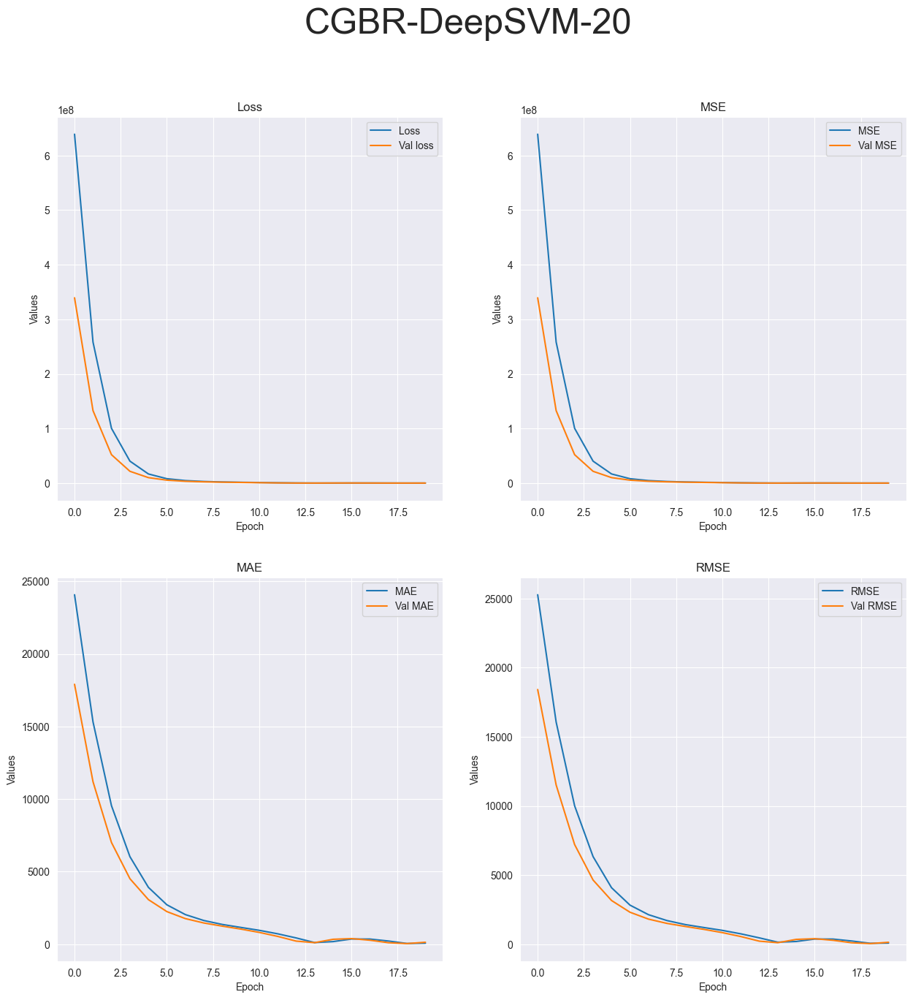

R-squared value: -64949.5615


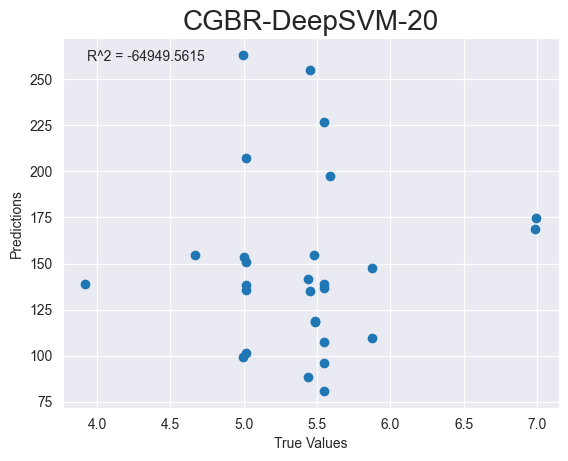

Running tests on FBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_113"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_332 (Dense)           (None, 64)                512       
                                                                 
 dropout_74 (Dropout)        (None, 64)                0         
                                                                 
 dense_333 (Dense)           (None, 32)                2080      
                                                                 
 dropout_75 (Dropout)        (None, 32)           

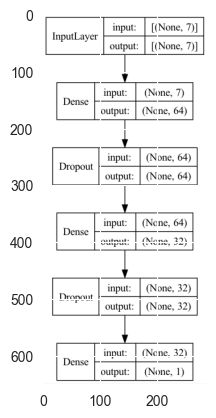

FBR-MLP-1


2023-05-02 10:14:29.885525: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 244ms/step - loss: 32.0309 - mse: 32.0309 - mae: 4.2104 - root_mean_squared_error: 5.6596 - val_loss: 4.9254 - val_mse: 4.9254 - val_mae: 2.0531 - val_root_mean_squared_error: 2.2193


2023-05-02 10:14:30.673354: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 112ms/step - loss: 5.2438 - mse: 5.2438 - mae: 2.0209 - root_mean_squared_error: 2.2899
Test loss: [5.243805885314941, 5.243805885314941, 2.0209381580352783, 2.289935827255249]
['loss', 'mse', 'mae', 'root_mean_squared_error']


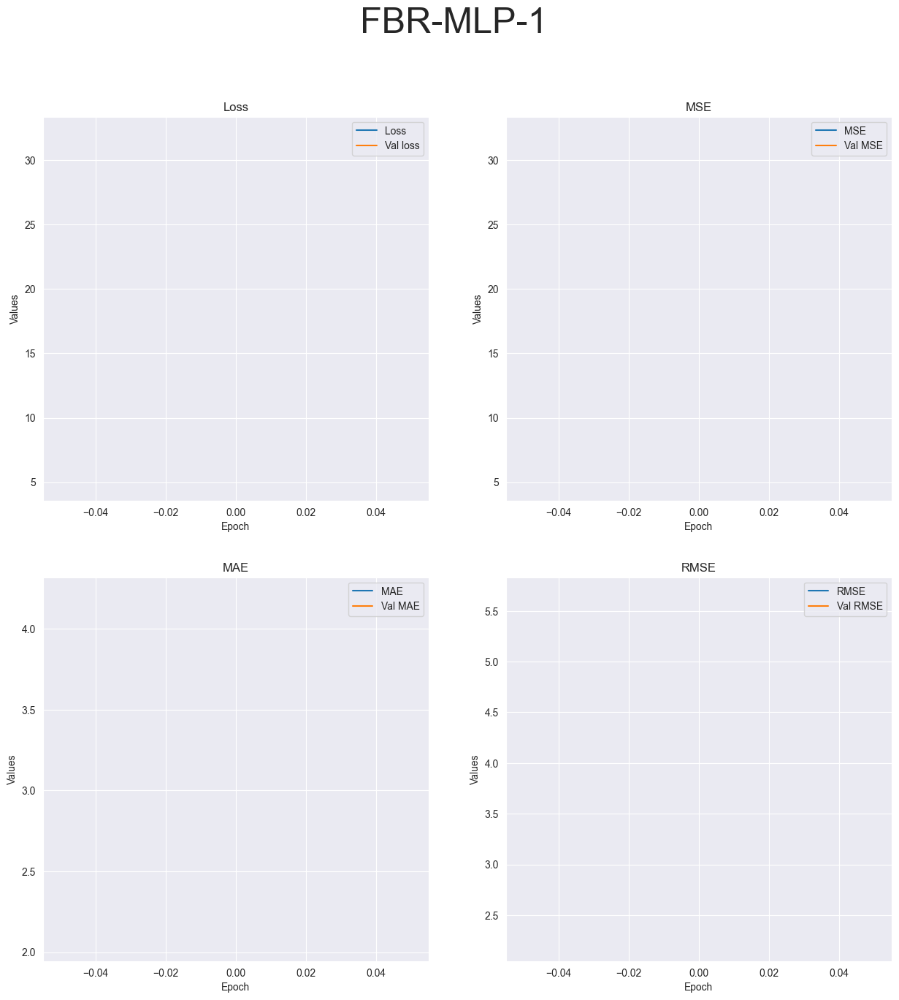

R-squared value: -9.1571


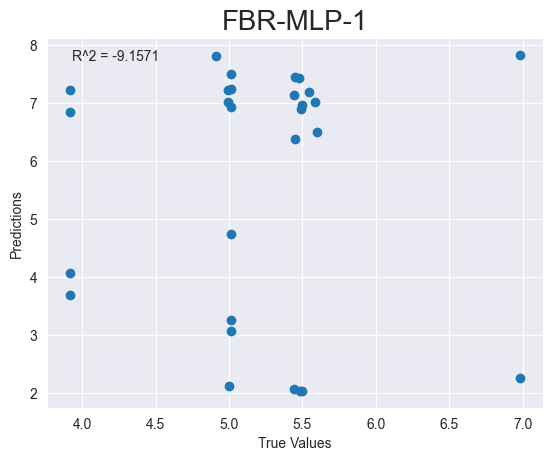

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_114"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_335 (Dense)           (None, 64)                512       
                                                                 
 dropout_76 (Dropout)        (None, 64)                0         
                                                                 
 dense_336 (Dense)           (None, 32)                2080      
                                                                 
 dropout_77 (Dropout)        (None, 32)                0         
                                               

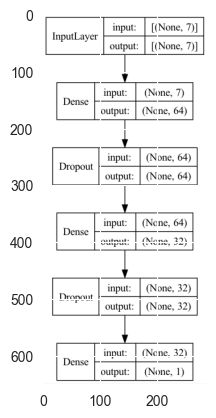

FBR-MLP-4
Epoch 1/4


2023-05-02 10:14:32.872409: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 255ms/step - loss: 21.5323 - mse: 21.5323 - mae: 3.7365 - root_mean_squared_error: 4.6403 - val_loss: 3.7175 - val_mse: 3.7175 - val_mae: 1.5622 - val_root_mean_squared_error: 1.9281
Epoch 2/4


2023-05-02 10:14:33.965234: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 33ms/step - loss: 12.2608 - mse: 12.2608 - mae: 2.8379 - root_mean_squared_error: 3.5015 - val_loss: 4.0169 - val_mse: 4.0169 - val_mae: 1.8556 - val_root_mean_squared_error: 2.0042
Epoch 3/4
3/3 [==============================] - 0s 33ms/step - loss: 5.3789 - mse: 5.3789 - mae: 1.8792 - root_mean_squared_error: 2.3192 - val_loss: 2.0763 - val_mse: 2.0763 - val_mae: 1.0990 - val_root_mean_squared_error: 1.4409
Epoch 4/4
1/1 [==============================] - 0s 73ms/step - loss: 1.3583 - mse: 1.3583 - mae: 0.9417 - root_mean_squared_error: 1.1655
Test loss: [1.35833740234375, 1.35833740234375, 0.9417212605476379, 1.1654772758483887]
['loss', 'mse', 'mae', 'root_mean_squared_error']


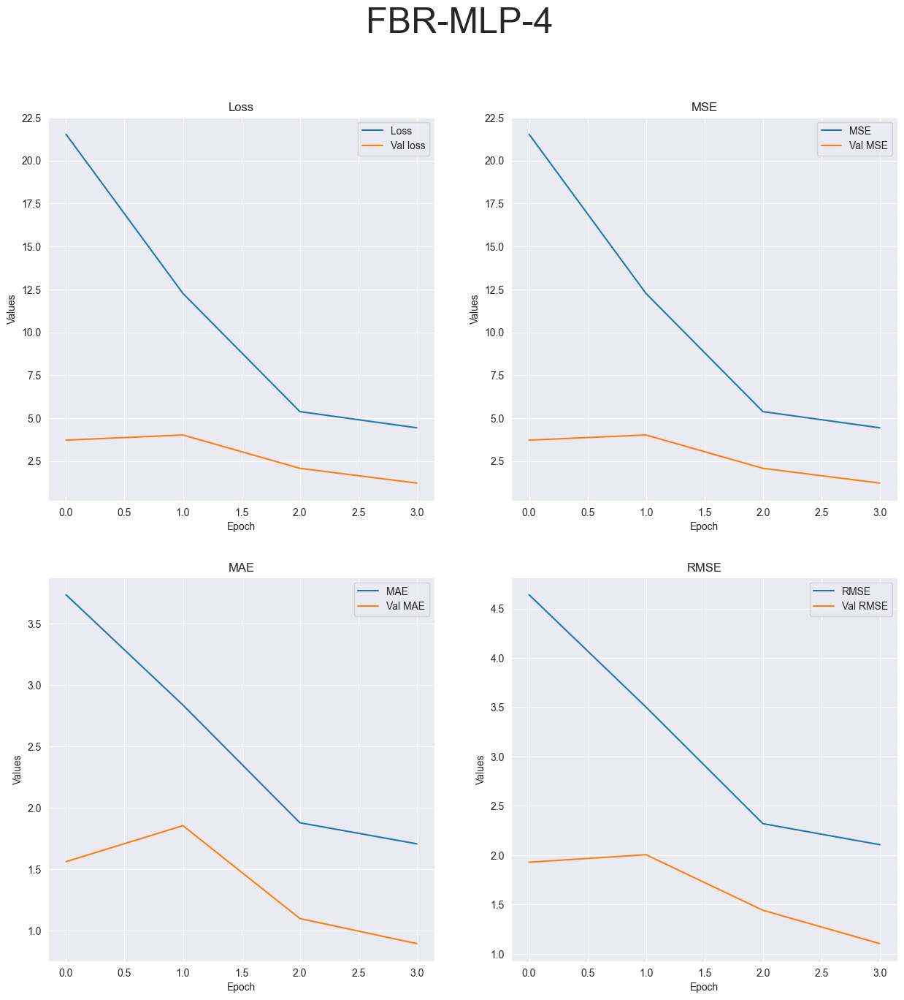

R-squared value: -2.2126


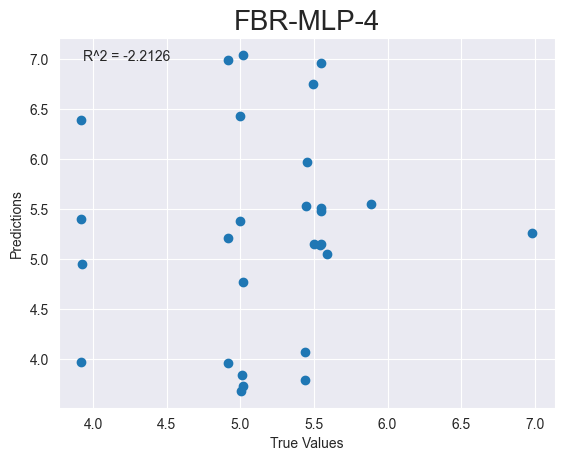

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_115"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_338 (Dense)           (None, 64)                512       
                                                                 
 dropout_78 (Dropout)        (None, 64)                0         
                                                                 
 dense_339 (Dense)           (None, 32)                2080      
                                                                 
 dropout_79 (Dropout)        (None, 32)                0         
                                              

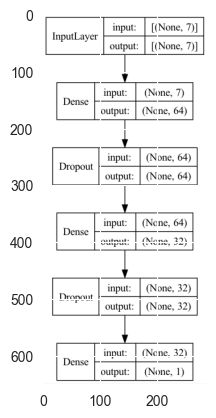

FBR-MLP-10
Epoch 1/10


2023-05-02 10:14:35.705836: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 298ms/step - loss: 24.8167 - mse: 24.8167 - mae: 4.1503 - root_mean_squared_error: 4.9816 - val_loss: 9.6615 - val_mse: 9.6615 - val_mae: 2.7035 - val_root_mean_squared_error: 3.1083
Epoch 2/10


2023-05-02 10:14:36.650037: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 44ms/step - loss: 12.9072 - mse: 12.9072 - mae: 2.8458 - root_mean_squared_error: 3.5927 - val_loss: 1.1824 - val_mse: 1.1824 - val_mae: 0.8311 - val_root_mean_squared_error: 1.0874
Epoch 3/10
3/3 [==============================] - 0s 34ms/step - loss: 5.1126 - mse: 5.1126 - mae: 1.8448 - root_mean_squared_error: 2.2611 - val_loss: 2.3613 - val_mse: 2.3613 - val_mae: 1.3282 - val_root_mean_squared_error: 1.5366
Epoch 4/10
3/3 [==============================] - 0s 27ms/step - loss: 4.0556 - mse: 4.0556 - mae: 1.6842 - root_mean_squared_error: 2.0139 - val_loss: 1.3349 - val_mse: 1.3349 - val_mae: 0.9993 - val_root_mean_squared_error: 1.1554
Epoch 5/10
3/3 [==============================] - 0s 19ms/step - loss: 3.1254 - mse: 3.1254 - mae: 1.3900 - root_mean_squared_error: 1.7679 - val_loss: 0.9880 - val_mse: 0.9880 - val_mae: 0.8853 - val_root_mean_squared_error: 0.9940
Epoch 6/10
3/3 [==============================] - 0s 22ms/step - loss: 2.4728

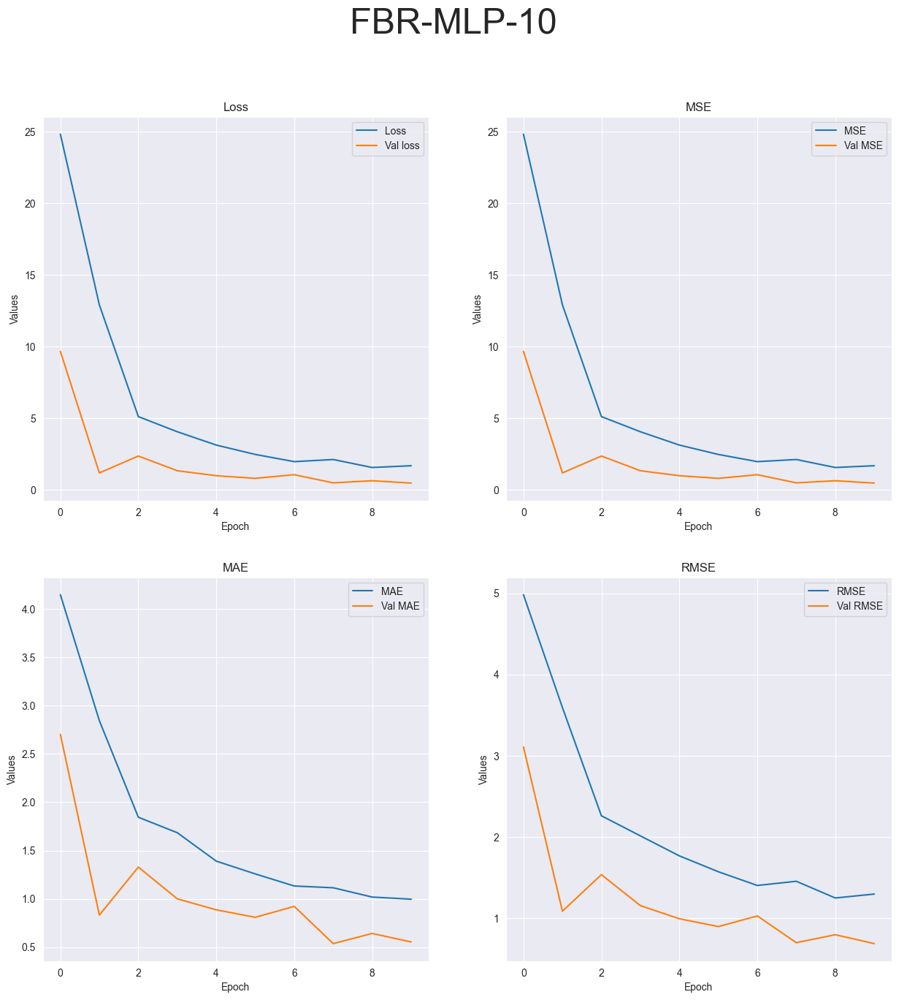

R-squared value: -1.0710


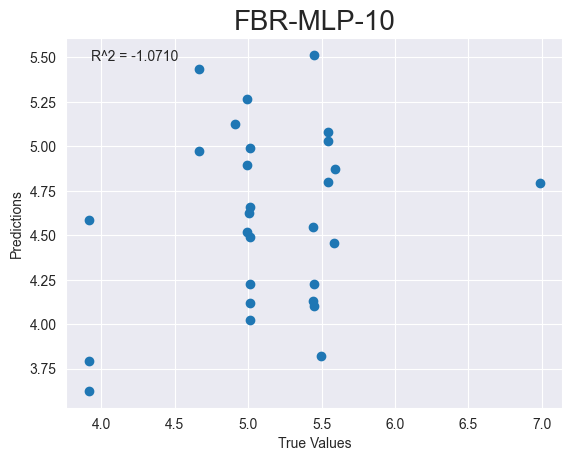

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_116"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_341 (Dense)           (None, 64)                512       
                                                                 
 dropout_80 (Dropout)        (None, 64)                0         
                                                                 
 dense_342 (Dense)           (None, 32)                2080      
                                                                 
 dropout_81 (Dropout)        (None, 32)                0         
                                              

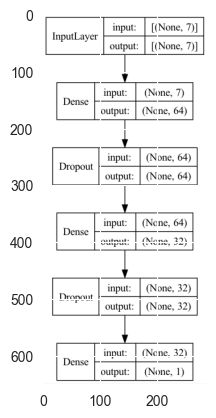

FBR-MLP-20
Epoch 1/20


2023-05-02 10:14:38.690727: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 226ms/step - loss: 22.6884 - mse: 22.6884 - mae: 3.6988 - root_mean_squared_error: 4.7632 - val_loss: 7.5359 - val_mse: 7.5359 - val_mae: 2.5560 - val_root_mean_squared_error: 2.7452
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 11.8493 - mse: 11.8493 - mae: 2.7677 - root_mean_squared_error: 3.4423

2023-05-02 10:14:39.515707: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 81ms/step - loss: 11.0443 - mse: 11.0443 - mae: 2.7611 - root_mean_squared_error: 3.3233 - val_loss: 2.2410 - val_mse: 2.2410 - val_mae: 1.0822 - val_root_mean_squared_error: 1.4970
Epoch 3/20
3/3 [==============================] - 0s 33ms/step - loss: 6.6899 - mse: 6.6899 - mae: 2.1364 - root_mean_squared_error: 2.5865 - val_loss: 3.0585 - val_mse: 3.0585 - val_mae: 1.6357 - val_root_mean_squared_error: 1.7489
Epoch 4/20
3/3 [==============================] - 0s 43ms/step - loss: 4.2040 - mse: 4.2040 - mae: 1.6353 - root_mean_squared_error: 2.0504 - val_loss: 1.0980 - val_mse: 1.0980 - val_mae: 0.9592 - val_root_mean_squared_error: 1.0479
Epoch 5/20
3/3 [==============================] - 0s 40ms/step - loss: 3.8028 - mse: 3.8028 - mae: 1.5530 - root_mean_squared_error: 1.9501 - val_loss: 0.9863 - val_mse: 0.9863 - val_mae: 0.7696 - val_root_mean_squared_error: 0.9931
Epoch 6/20
3/3 [==============================] - 0s 18ms/step - loss: 2.9836

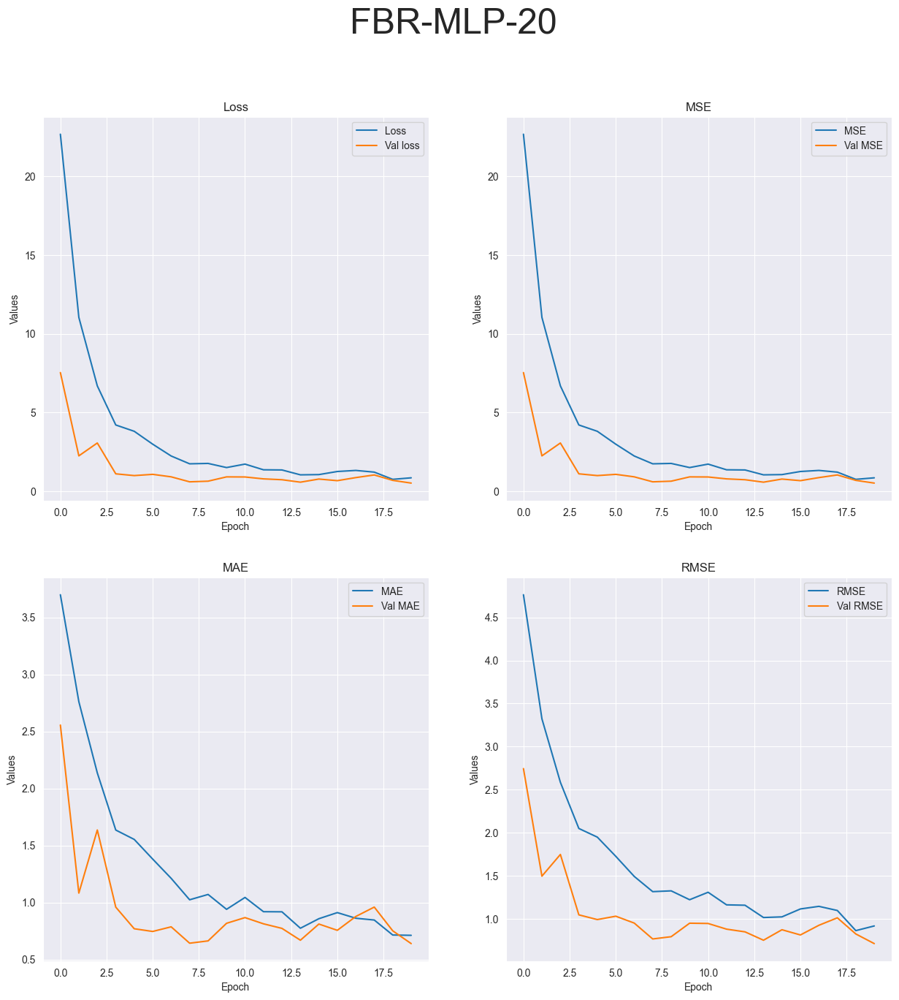

R-squared value: -0.7856


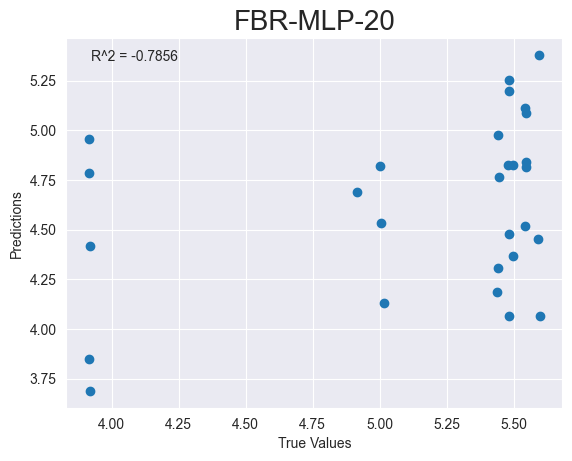

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_117"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_344 (Dense)           (None, 64)                512       
                                                                 
 dense_345 (Dense)           (None, 32)                2080      
                                                                 
 dense_346 (Dense)           (None, 16)                528       
                                                                 
 dense_347 (Dense)           (None, 1)                 17        
                   

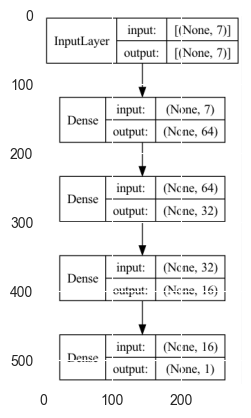

FBR-FCNN-1


2023-05-02 10:14:42.335499: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 236ms/step - loss: 28.5961 - mse: 28.5961 - mae: 4.7138 - root_mean_squared_error: 5.3475 - val_loss: 2.0503 - val_mse: 2.0503 - val_mae: 1.0778 - val_root_mean_squared_error: 1.4319


2023-05-02 10:14:43.114159: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 63ms/step - loss: 3.6836 - mse: 3.6836 - mae: 1.6908 - root_mean_squared_error: 1.9193
Test loss: [3.683612823486328, 3.683612823486328, 1.6908342838287354, 1.919274091720581]
['loss', 'mse', 'mae', 'root_mean_squared_error']


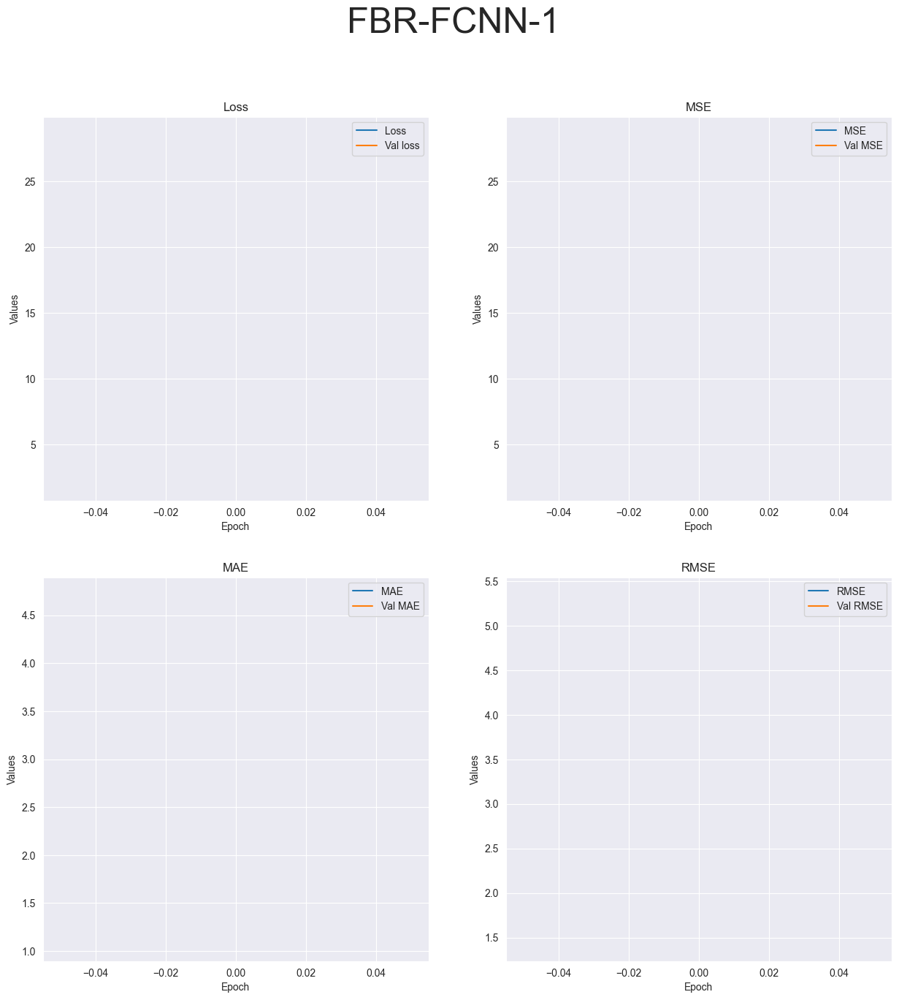

R-squared value: -6.7780


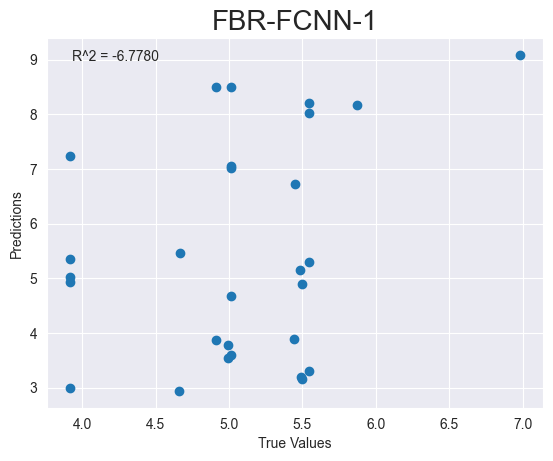

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_118"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_348 (Dense)           (None, 64)                512       
                                                                 
 dense_349 (Dense)           (None, 32)                2080      
                                                                 
 dense_350 (Dense)           (None, 16)                528       
                                                                 
 dense_351 (Dense)           (None, 1)                 17        
                                               

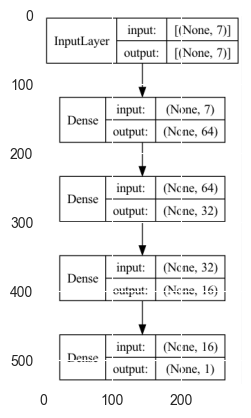

FBR-FCNN-4
Epoch 1/4


2023-05-02 10:14:45.305379: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 230ms/step - loss: 32.1392 - mse: 32.1392 - mae: 4.8628 - root_mean_squared_error: 5.6691 - val_loss: 1.9927 - val_mse: 1.9927 - val_mae: 1.1531 - val_root_mean_squared_error: 1.4116
Epoch 2/4
1/3 [=========>....................] - ETA: 0s - loss: 2.7897 - mse: 2.7897 - mae: 1.3901 - root_mean_squared_error: 1.6702

2023-05-02 10:14:46.044043: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 37ms/step - loss: 5.6133 - mse: 5.6133 - mae: 2.0771 - root_mean_squared_error: 2.3692 - val_loss: 7.1326 - val_mse: 7.1326 - val_mae: 2.1708 - val_root_mean_squared_error: 2.6707
Epoch 3/4
3/3 [==============================] - 0s 64ms/step - loss: 5.8842 - mse: 5.8842 - mae: 2.0508 - root_mean_squared_error: 2.4257 - val_loss: 2.6699 - val_mse: 2.6699 - val_mae: 1.3062 - val_root_mean_squared_error: 1.6340
Epoch 4/4
1/1 [==============================] - 0s 88ms/step - loss: 1.5042 - mse: 1.5042 - mae: 1.0185 - root_mean_squared_error: 1.2265
Test loss: [1.504243016242981, 1.504243016242981, 1.0184556245803833, 1.2264758348464966]
['loss', 'mse', 'mae', 'root_mean_squared_error']


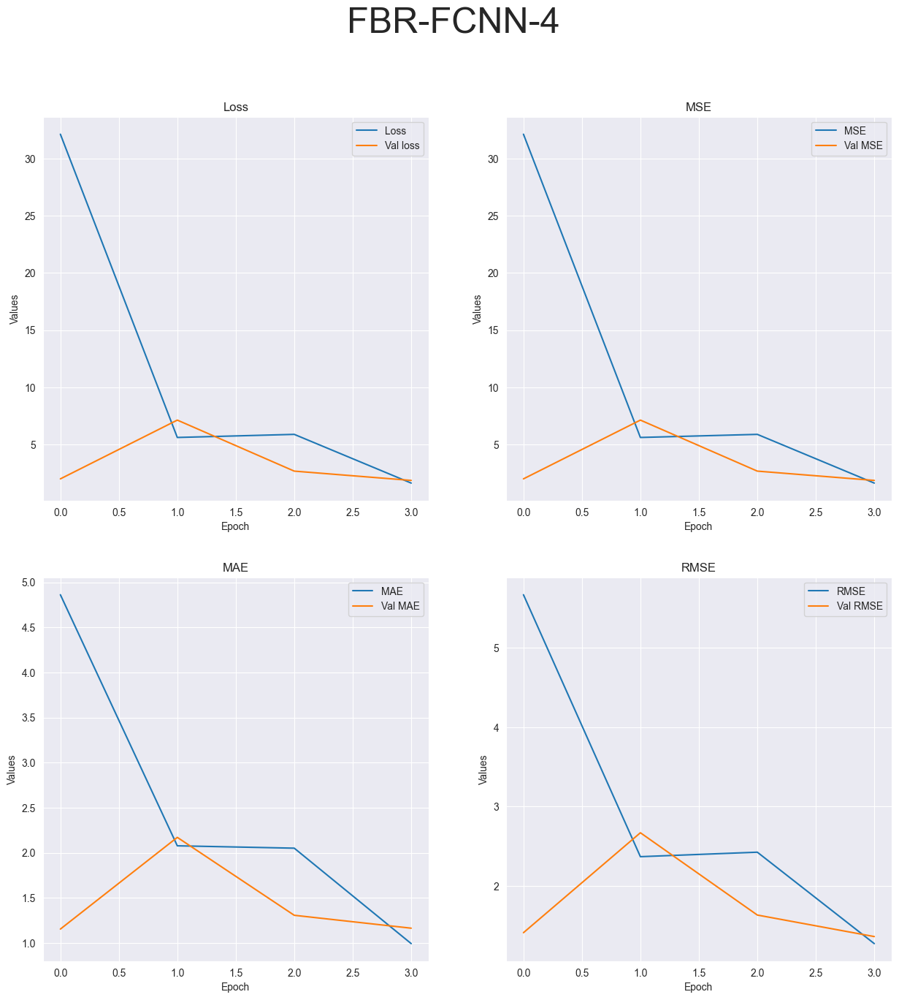

R-squared value: -2.5663


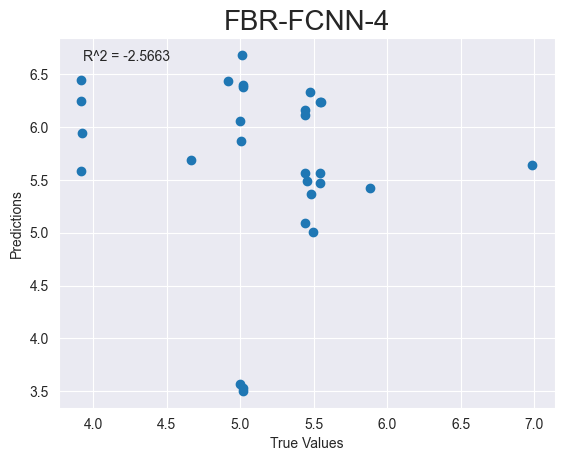

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_119"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_352 (Dense)           (None, 64)                512       
                                                                 
 dense_353 (Dense)           (None, 32)                2080      
                                                                 
 dense_354 (Dense)           (None, 16)                528       
                                                                 
 dense_355 (Dense)           (None, 1)                 17        
                                              

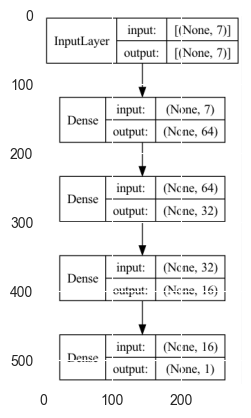

FBR-FCNN-10
Epoch 1/10


2023-05-02 10:14:47.879045: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 204ms/step - loss: 29.5243 - mse: 29.5243 - mae: 4.6581 - root_mean_squared_error: 5.4336 - val_loss: 3.7443 - val_mse: 3.7443 - val_mae: 1.3006 - val_root_mean_squared_error: 1.9350
Epoch 2/10
1/3 [=========>....................] - ETA: 0s - loss: 3.4871 - mse: 3.4871 - mae: 1.1986 - root_mean_squared_error: 1.8674

2023-05-02 10:14:48.557882: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 59ms/step - loss: 5.0584 - mse: 5.0584 - mae: 1.8289 - root_mean_squared_error: 2.2491 - val_loss: 6.6012 - val_mse: 6.6012 - val_mae: 2.3732 - val_root_mean_squared_error: 2.5693
Epoch 3/10
3/3 [==============================] - 0s 20ms/step - loss: 6.1536 - mse: 6.1536 - mae: 2.2193 - root_mean_squared_error: 2.4806 - val_loss: 2.1227 - val_mse: 2.1227 - val_mae: 1.1758 - val_root_mean_squared_error: 1.4570
Epoch 4/10
3/3 [==============================] - 0s 31ms/step - loss: 1.9991 - mse: 1.9991 - mae: 1.0761 - root_mean_squared_error: 1.4139 - val_loss: 3.1343 - val_mse: 3.1343 - val_mae: 1.3647 - val_root_mean_squared_error: 1.7704
Epoch 5/10
3/3 [==============================] - 0s 27ms/step - loss: 1.6979 - mse: 1.6979 - mae: 1.0156 - root_mean_squared_error: 1.3030 - val_loss: 1.1539 - val_mse: 1.1539 - val_mae: 0.8649 - val_root_mean_squared_error: 1.0742
Epoch 6/10
3/3 [==============================] - 0s 27ms/step - loss: 0.7796 -

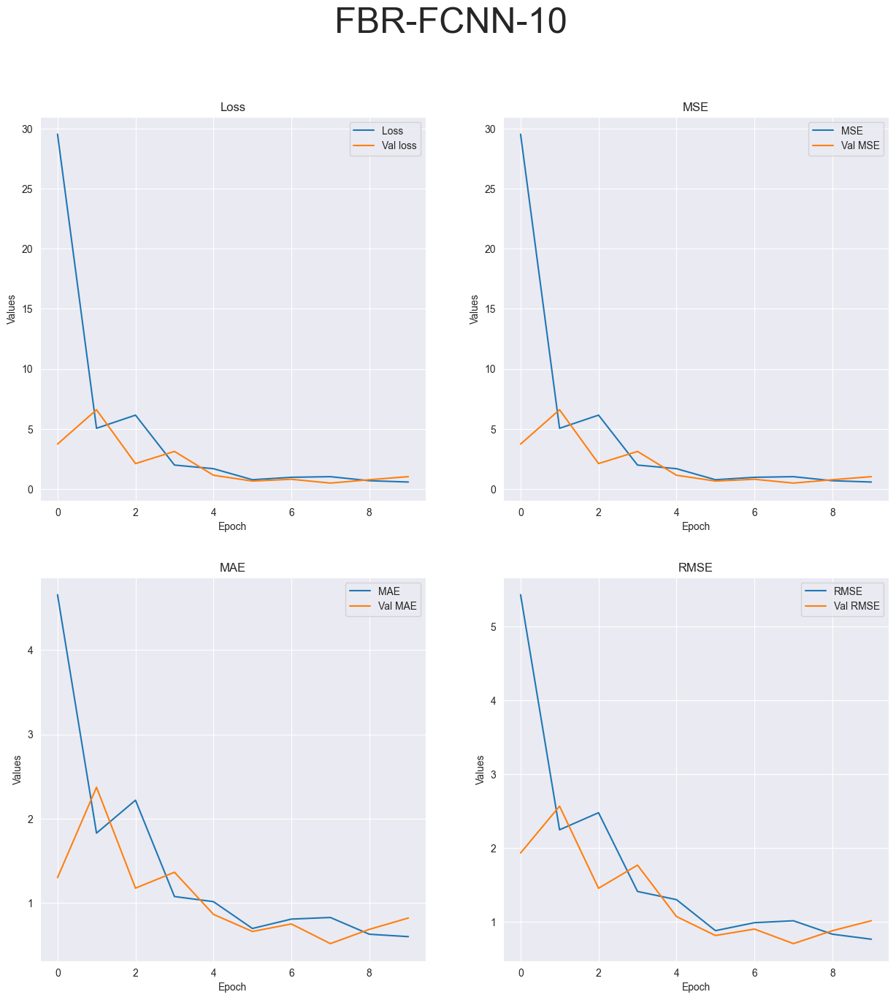

R-squared value: -0.4716


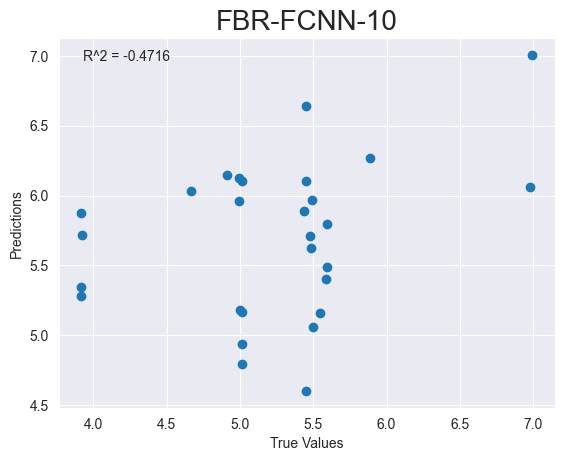

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_120"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_356 (Dense)           (None, 64)                512       
                                                                 
 dense_357 (Dense)           (None, 32)                2080      
                                                                 
 dense_358 (Dense)           (None, 16)                528       
                                                                 
 dense_359 (Dense)           (None, 1)                 17        
                                              

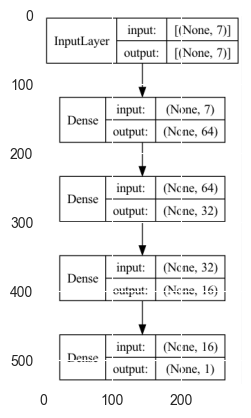

FBR-FCNN-20
Epoch 1/20


2023-05-02 10:14:50.720945: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 212ms/step - loss: 33.4494 - mse: 33.4494 - mae: 5.0333 - root_mean_squared_error: 5.7835 - val_loss: 1.1166 - val_mse: 1.1166 - val_mae: 0.9555 - val_root_mean_squared_error: 1.0567
Epoch 2/20
1/3 [=========>....................] - ETA: 0s - loss: 1.1296 - mse: 1.1296 - mae: 0.9536 - root_mean_squared_error: 1.0628

2023-05-02 10:14:51.509408: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 105ms/step - loss: 5.2586 - mse: 5.2586 - mae: 1.8986 - root_mean_squared_error: 2.2932 - val_loss: 6.8082 - val_mse: 6.8082 - val_mae: 2.2607 - val_root_mean_squared_error: 2.6093
Epoch 3/20
3/3 [==============================] - 0s 46ms/step - loss: 5.7254 - mse: 5.7254 - mae: 1.9969 - root_mean_squared_error: 2.3928 - val_loss: 1.2990 - val_mse: 1.2990 - val_mae: 0.9316 - val_root_mean_squared_error: 1.1397
Epoch 4/20
3/3 [==============================] - 0s 33ms/step - loss: 1.3192 - mse: 1.3192 - mae: 0.9187 - root_mean_squared_error: 1.1486 - val_loss: 1.1243 - val_mse: 1.1243 - val_mae: 0.8733 - val_root_mean_squared_error: 1.0603
Epoch 5/20
3/3 [==============================] - 0s 32ms/step - loss: 1.5224 - mse: 1.5224 - mae: 1.0729 - root_mean_squared_error: 1.2339 - val_loss: 0.7127 - val_mse: 0.7127 - val_mae: 0.6690 - val_root_mean_squared_error: 0.8442
Epoch 6/20
3/3 [==============================] - 0s 27ms/step - loss: 0.9632 

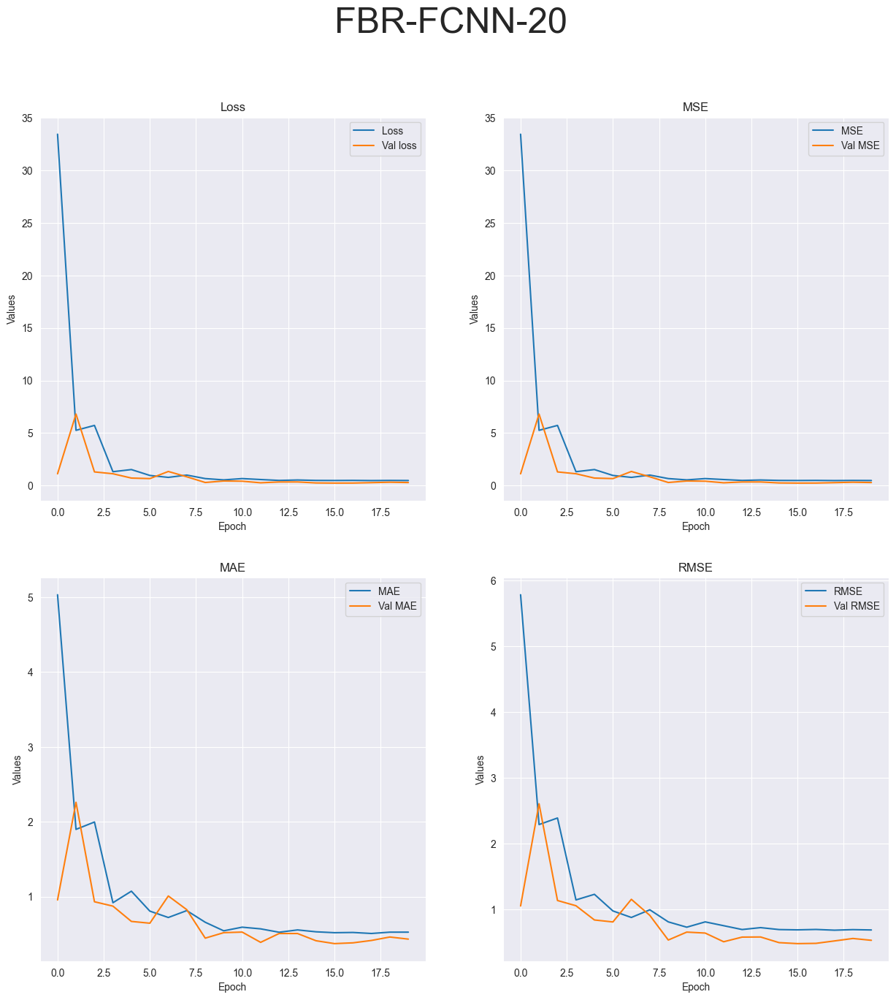

R-squared value: 0.1041


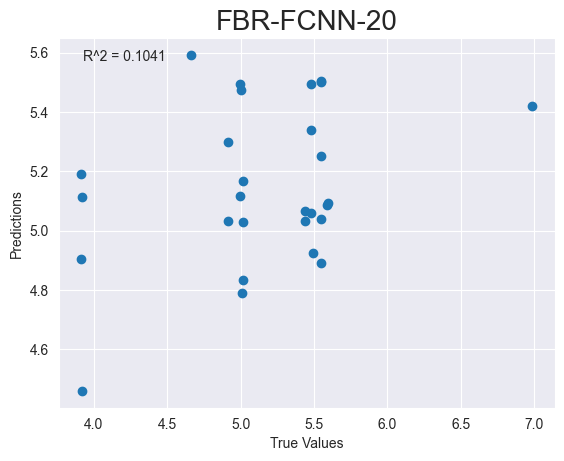

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_121"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_360 (Dense)           (None, 128)               1024      
                                                                 
 dense_361 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


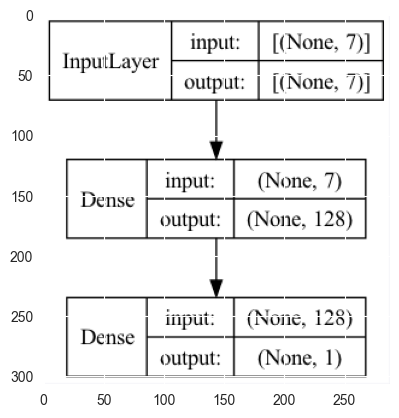

FBR-DeepSVM-1


2023-05-02 10:14:54.338063: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 225ms/step - loss: 20.6242 - mse: 20.4889 - mae: 3.7274 - root_mean_squared_error: 4.5265 - val_loss: 4.7996 - val_mse: 4.6659 - val_mae: 1.8354 - val_root_mean_squared_error: 2.1601


2023-05-02 10:14:55.077111: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 87ms/step - loss: 5.3515 - mse: 5.2178 - mae: 1.9827 - root_mean_squared_error: 2.2843
Test loss: [5.351540565490723, 5.217797756195068, 1.982715368270874, 2.284250020980835]
['loss', 'mse', 'mae', 'root_mean_squared_error']


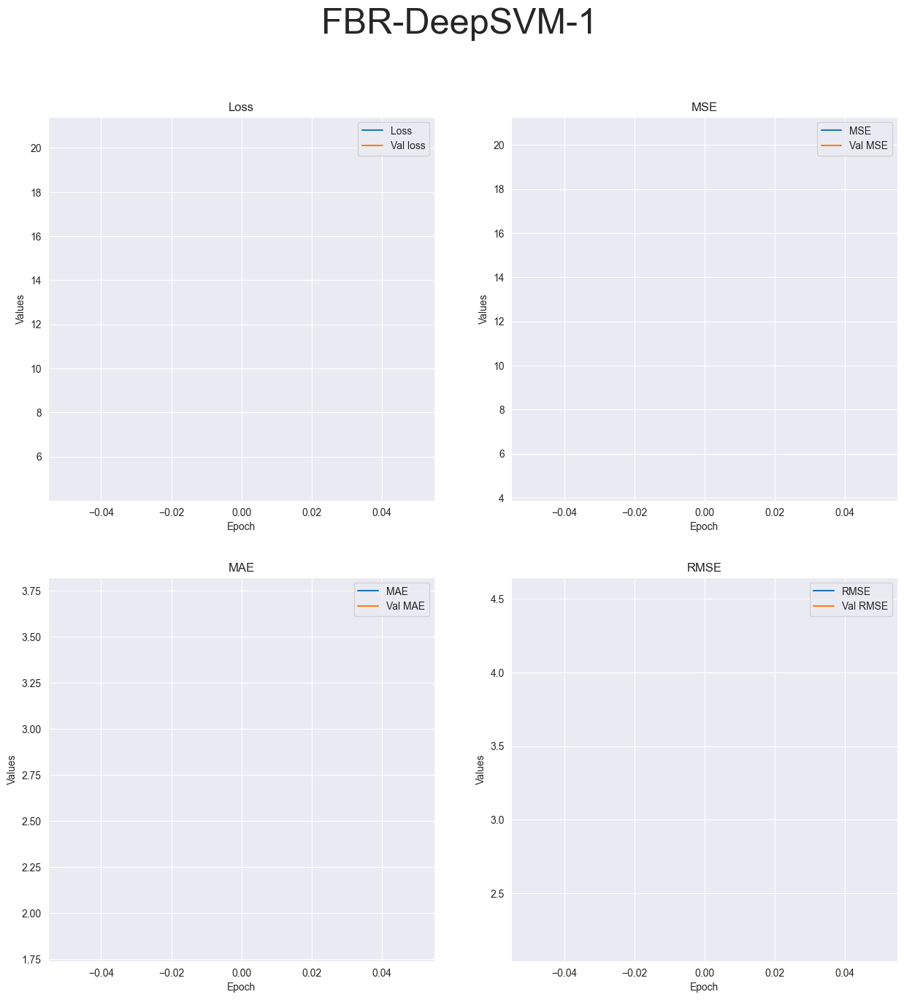

R-squared value: -7.0711


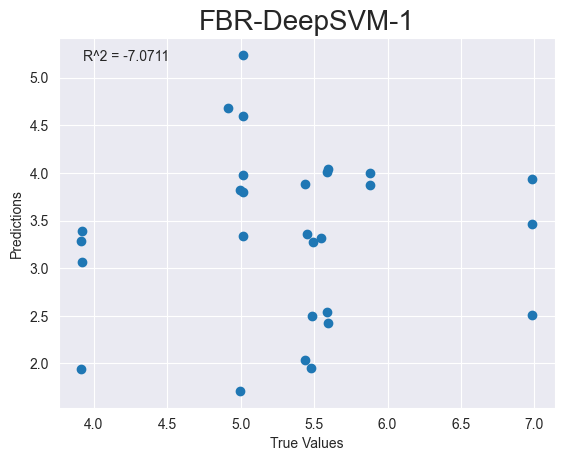

Running tests with 4 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_122"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_362 (Dense)           (None, 128)               1024      
                                                                 
 dense_363 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


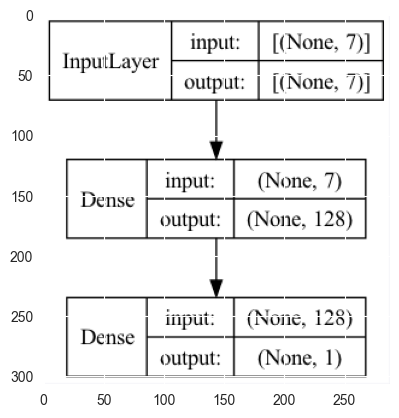

FBR-DeepSVM-4
Epoch 1/4


2023-05-02 10:14:57.324110: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 230ms/step - loss: 22.3093 - mse: 22.1737 - mae: 4.0545 - root_mean_squared_error: 4.7089 - val_loss: 7.4561 - val_mse: 7.3211 - val_mae: 2.2335 - val_root_mean_squared_error: 2.7058
Epoch 2/4


2023-05-02 10:14:58.304056: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 77ms/step - loss: 9.8224 - mse: 9.6885 - mae: 2.4759 - root_mean_squared_error: 3.1126 - val_loss: 18.6034 - val_mse: 18.4709 - val_mae: 3.7913 - val_root_mean_squared_error: 4.2978
Epoch 3/4
3/3 [==============================] - 0s 29ms/step - loss: 8.4048 - mse: 8.2723 - mae: 2.1322 - root_mean_squared_error: 2.8762 - val_loss: 7.1144 - val_mse: 6.9813 - val_mae: 2.3600 - val_root_mean_squared_error: 2.6422
Epoch 4/4
1/1 [==============================] - 0s 67ms/step - loss: 5.2448 - mse: 5.1128 - mae: 1.9283 - root_mean_squared_error: 2.2612
Test loss: [5.244844913482666, 5.112817287445068, 1.9282782077789307, 2.2611539363861084]
['loss', 'mse', 'mae', 'root_mean_squared_error']


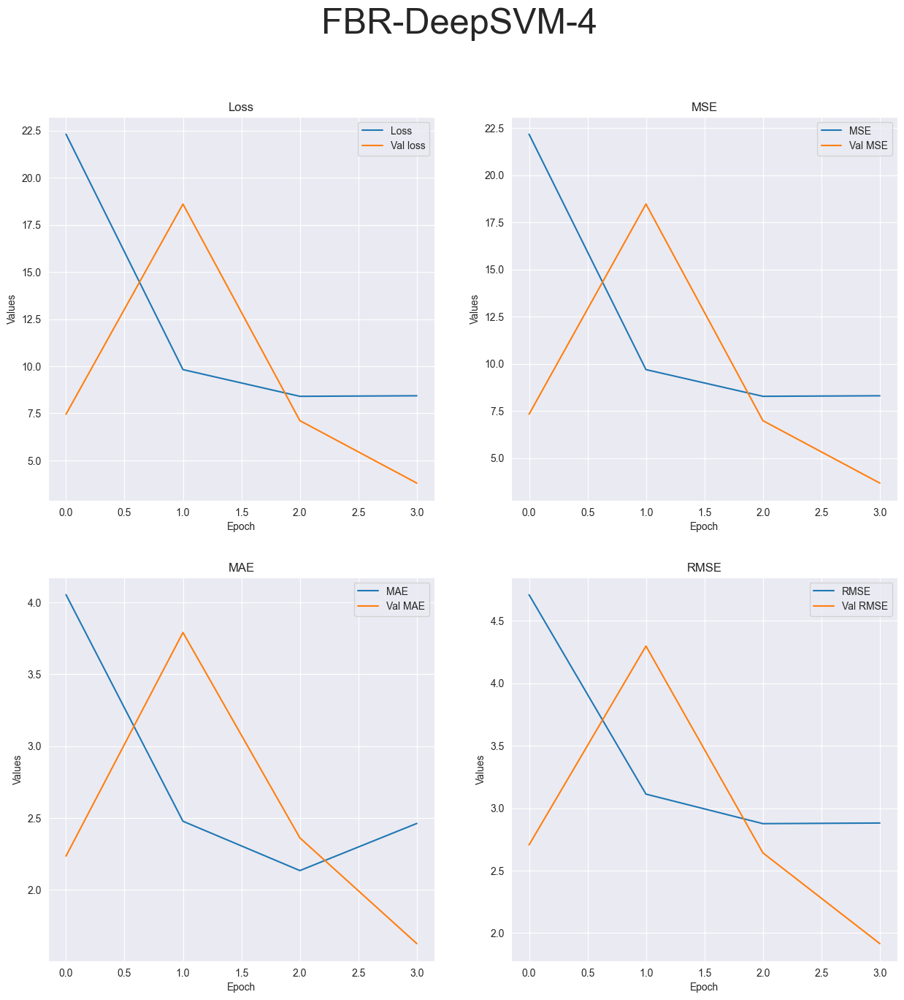

R-squared value: -6.1884


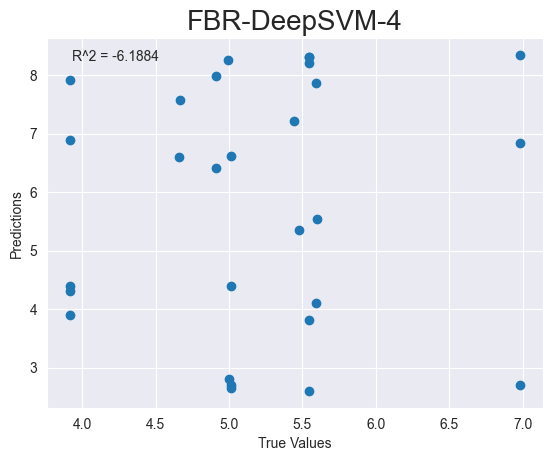

Running tests with 10 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_123"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_364 (Dense)           (None, 128)               1024      
                                                                 
 dense_365 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


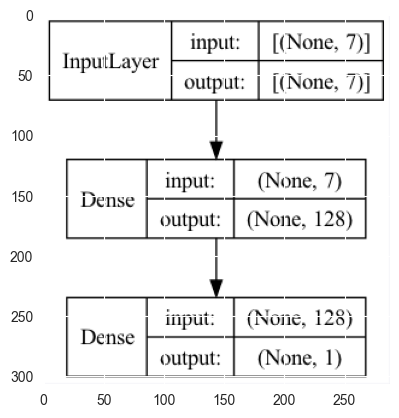

FBR-DeepSVM-10
Epoch 1/10


2023-05-02 10:15:00.158529: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 221ms/step - loss: 26.0199 - mse: 25.8843 - mae: 4.3210 - root_mean_squared_error: 5.0877 - val_loss: 14.4097 - val_mse: 14.2745 - val_mae: 3.5357 - val_root_mean_squared_error: 3.7782
Epoch 2/10


2023-05-02 10:15:00.785093: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 36ms/step - loss: 7.8753 - mse: 7.7412 - mae: 2.2532 - root_mean_squared_error: 2.7823 - val_loss: 20.8989 - val_mse: 20.7663 - val_mae: 3.9341 - val_root_mean_squared_error: 4.5570
Epoch 3/10
3/3 [==============================] - 0s 19ms/step - loss: 12.1172 - mse: 11.9846 - mae: 2.7405 - root_mean_squared_error: 3.4619 - val_loss: 1.3642 - val_mse: 1.2312 - val_mae: 0.8868 - val_root_mean_squared_error: 1.1096
Epoch 4/10
3/3 [==============================] - 0s 25ms/step - loss: 5.7825 - mse: 5.6494 - mae: 1.8255 - root_mean_squared_error: 2.3768 - val_loss: 10.3697 - val_mse: 10.2370 - val_mae: 2.8550 - val_root_mean_squared_error: 3.1995
Epoch 5/10
3/3 [==============================] - 0s 36ms/step - loss: 5.1152 - mse: 4.9832 - mae: 1.8020 - root_mean_squared_error: 2.2323 - val_loss: 1.4033 - val_mse: 1.2725 - val_mae: 1.0077 - val_root_mean_squared_error: 1.1280
Epoch 6/10
3/3 [==============================] - 0s 35ms/step - loss: 3.

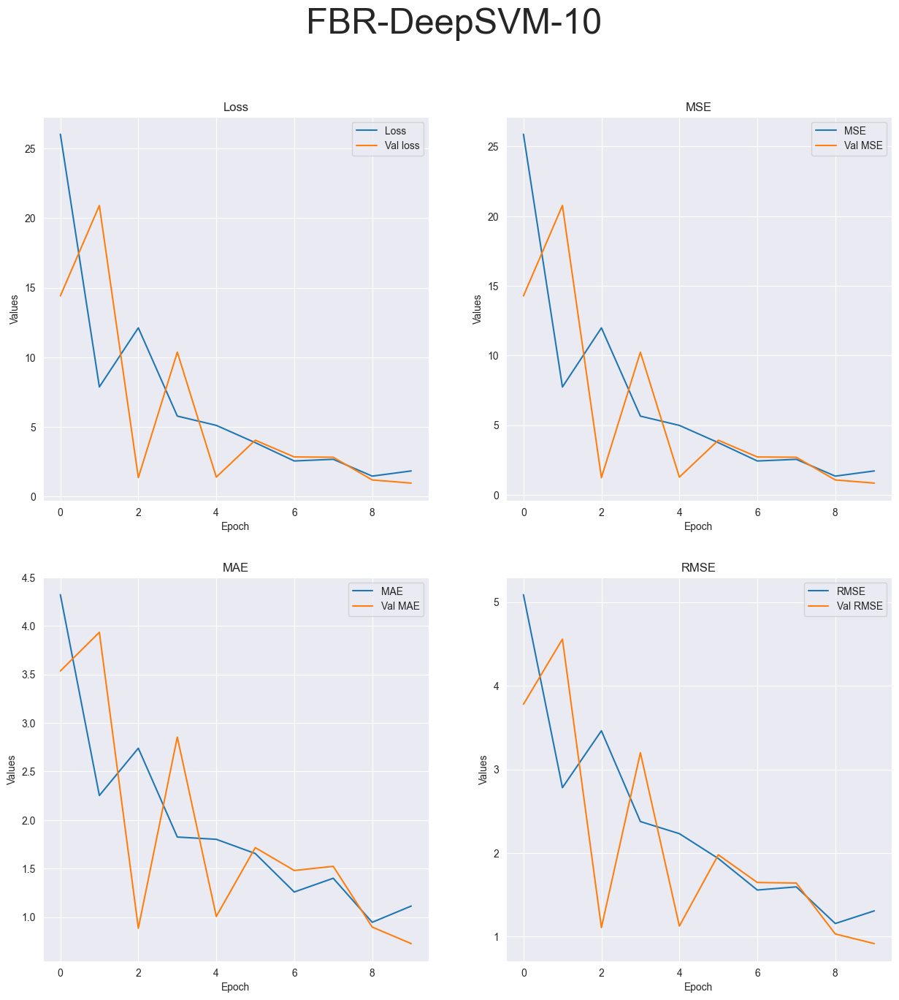

R-squared value: -1.6059


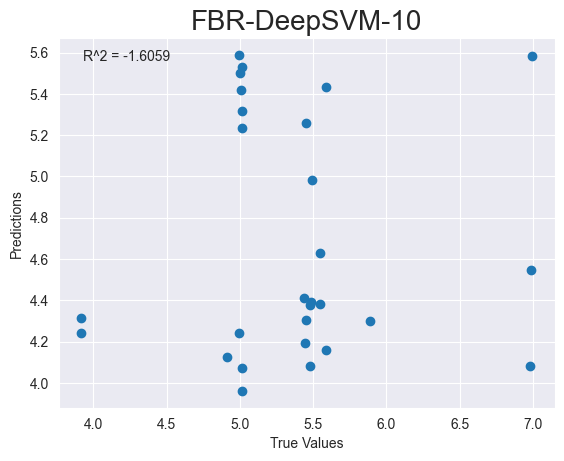

Running tests with 20 epochs...
   ID  AverageMass       hu0       hu1        hu2        hu3        hu4  \
0  21       6.9924  3.077730  8.909260  11.944054  11.944054  25.357529   
1  22       6.9847  2.489005  7.233462   9.826464   9.826464  20.528179   

         hu5        hu6  
0  17.910823  25.327582  
1  14.155822  20.188483  
Model: "sequential_124"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_366 (Dense)           (None, 128)               1024      
                                                                 
 dense_367 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,153
Trainable params: 1,153
Non-trainable params: 0
_________________________________________________________________
None


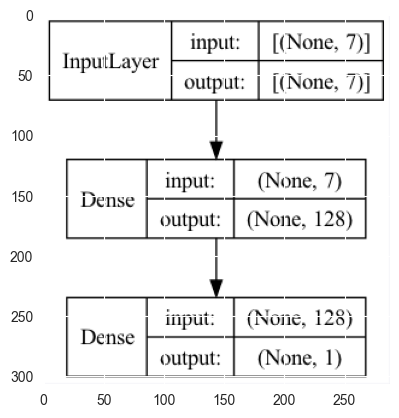

FBR-DeepSVM-20
Epoch 1/20


2023-05-02 10:15:02.823821: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 205ms/step - loss: 20.0001 - mse: 19.8646 - mae: 3.6293 - root_mean_squared_error: 4.4570 - val_loss: 4.6036 - val_mse: 4.4693 - val_mae: 1.8545 - val_root_mean_squared_error: 2.1141
Epoch 2/20


2023-05-02 10:15:03.526383: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 72ms/step - loss: 11.2396 - mse: 11.1059 - mae: 2.6535 - root_mean_squared_error: 3.3326 - val_loss: 1.4421 - val_mse: 1.3090 - val_mae: 1.0326 - val_root_mean_squared_error: 1.1441
Epoch 3/20
3/3 [==============================] - 0s 46ms/step - loss: 4.1160 - mse: 3.9827 - mae: 1.4945 - root_mean_squared_error: 1.9957 - val_loss: 4.9911 - val_mse: 4.8580 - val_mae: 1.7877 - val_root_mean_squared_error: 2.2041
Epoch 4/20
3/3 [==============================] - 0s 19ms/step - loss: 4.0945 - mse: 3.9619 - mae: 1.5049 - root_mean_squared_error: 1.9905 - val_loss: 3.6095 - val_mse: 3.4779 - val_mae: 1.6051 - val_root_mean_squared_error: 1.8649
Epoch 5/20
3/3 [==============================] - 0s 25ms/step - loss: 4.0152 - mse: 3.8837 - mae: 1.6425 - root_mean_squared_error: 1.9707 - val_loss: 2.9200 - val_mse: 2.7883 - val_mae: 1.4779 - val_root_mean_squared_error: 1.6698
Epoch 6/20
3/3 [==============================] - 0s 19ms/step - loss: 1.4186

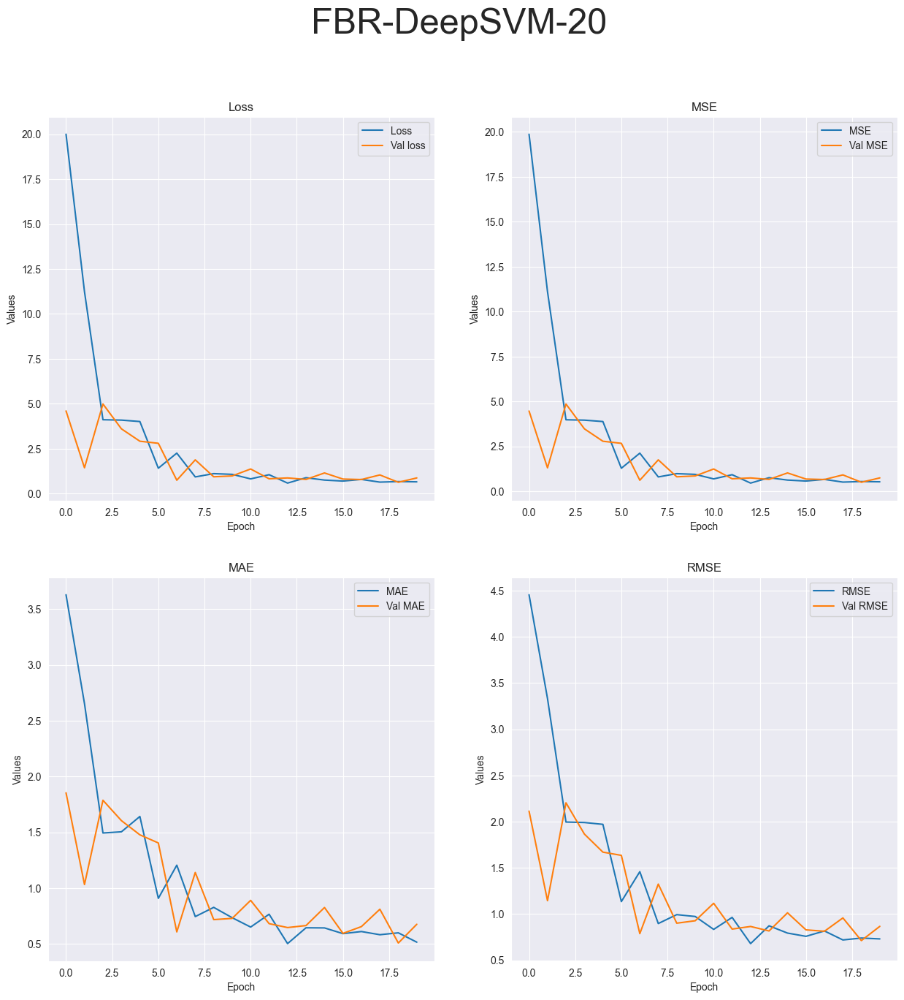

R-squared value: -0.0875


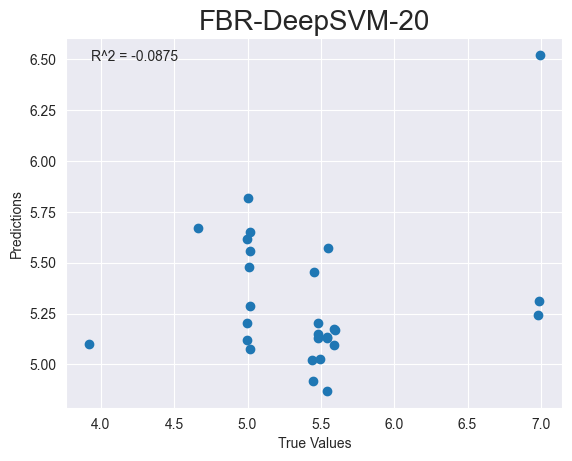

Running tests on CBR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_125"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_368 (Dense)           (None, 64)                256       
                                                                 
 dropout_82 (Dropout)        (None, 64)                0         
                                                                 
 dense_369 (Dense)           (None, 32)                2080      
                                                                 
 dropout_83 (Dropout)        (None, 32)                0         
                                                                 
 dense_370 (Dense)           (None, 1)                 33

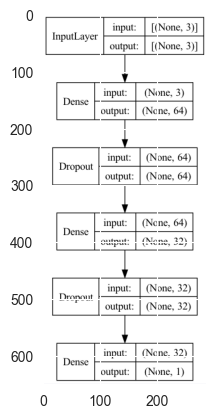

CBR-MLP-1


2023-05-02 10:15:06.623183: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 337ms/step - loss: 126.6481 - mse: 126.6481 - mae: 8.9681 - root_mean_squared_error: 11.2538 - val_loss: 0.5738 - val_mse: 0.5738 - val_mae: 0.6720 - val_root_mean_squared_error: 0.7575


2023-05-02 10:15:07.616565: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 100ms/step - loss: 0.6915 - mse: 0.6915 - mae: 0.6921 - root_mean_squared_error: 0.8316
Test loss: [0.6914793252944946, 0.6914793252944946, 0.6920588612556458, 0.8315523862838745]
['loss', 'mse', 'mae', 'root_mean_squared_error']


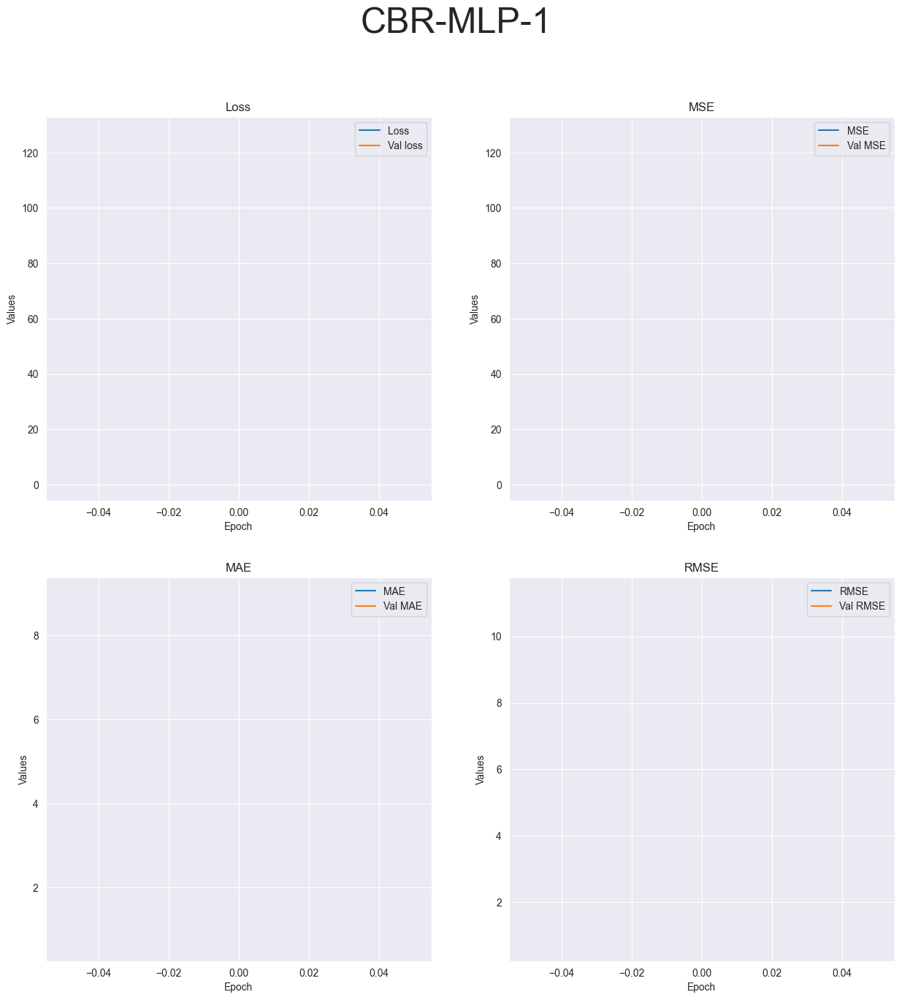

R-squared value: -0.4649


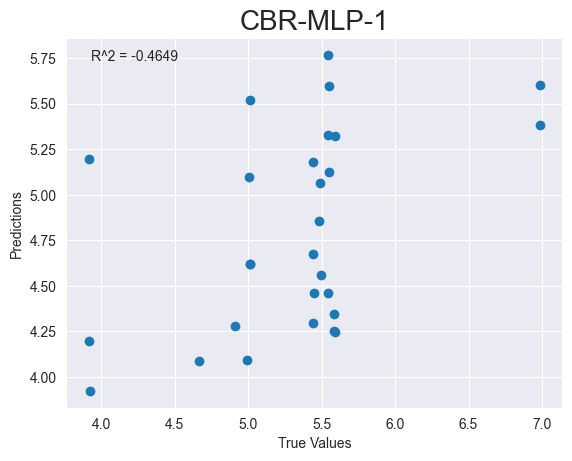

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_126"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_371 (Dense)           (None, 64)                256       
                                                                 
 dropout_84 (Dropout)        (None, 64)                0         
                                                                 
 dense_372 (Dense)           (None, 32)                2080      
                                                                 
 dropout_85 (Dropout)        (None, 32)                0         
                                                                 
 dense_373 (Dense)           (None, 1)                 33        
                                                      

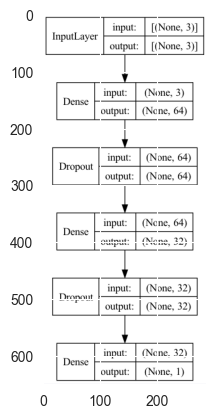

CBR-MLP-4
Epoch 1/4


2023-05-02 10:15:09.831893: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 313ms/step - loss: 101.2844 - mse: 101.2844 - mae: 8.3735 - root_mean_squared_error: 10.0640 - val_loss: 6.5552 - val_mse: 6.5552 - val_mae: 2.3554 - val_root_mean_squared_error: 2.5603
Epoch 2/4


2023-05-02 10:15:11.163028: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 87ms/step - loss: 25.4389 - mse: 25.4389 - mae: 3.9139 - root_mean_squared_error: 5.0437 - val_loss: 4.0227 - val_mse: 4.0227 - val_mae: 1.9102 - val_root_mean_squared_error: 2.0057
Epoch 3/4
3/3 [==============================] - 0s 65ms/step - loss: 13.6987 - mse: 13.6987 - mae: 2.9021 - root_mean_squared_error: 3.7012 - val_loss: 0.6364 - val_mse: 0.6364 - val_mae: 0.6263 - val_root_mean_squared_error: 0.7978
Epoch 4/4
1/1 [==============================] - 0s 80ms/step - loss: 12.1008 - mse: 12.1008 - mae: 1.3482 - root_mean_squared_error: 3.4786
Test loss: [12.10079288482666, 12.10079288482666, 1.3482025861740112, 3.478619337081909]
['loss', 'mse', 'mae', 'root_mean_squared_error']


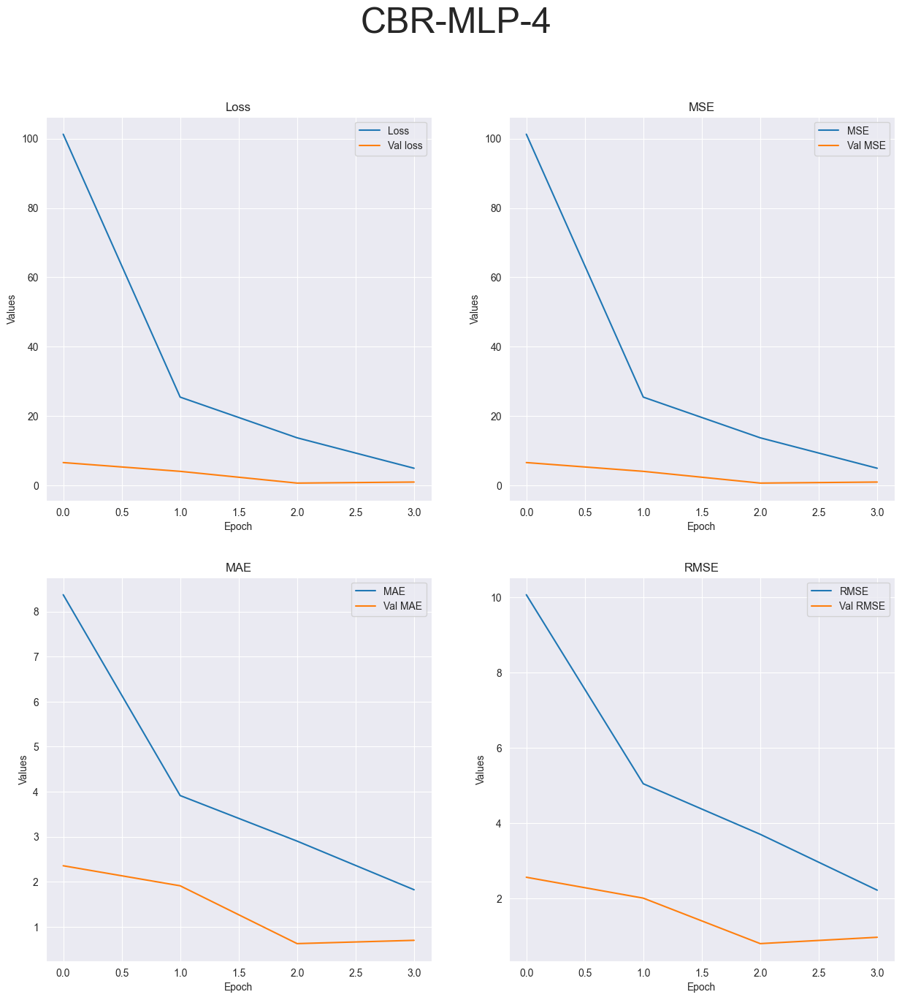

R-squared value: -18.4792


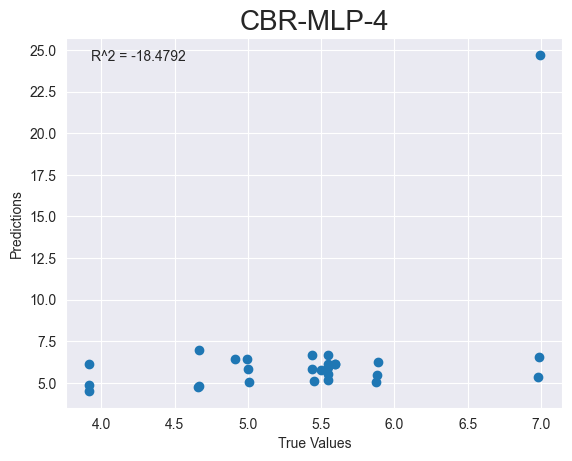

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_127"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_374 (Dense)           (None, 64)                256       
                                                                 
 dropout_86 (Dropout)        (None, 64)                0         
                                                                 
 dense_375 (Dense)           (None, 32)                2080      
                                                                 
 dropout_87 (Dropout)        (None, 32)                0         
                                                                 
 dense_376 (Dense)           (None, 1)                 33        
                                                     

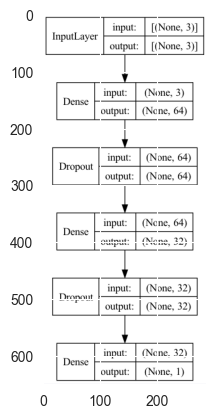

CBR-MLP-10
Epoch 1/10


2023-05-02 10:15:13.105617: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 304ms/step - loss: 84.7448 - mse: 84.7448 - mae: 7.2300 - root_mean_squared_error: 9.2057 - val_loss: 4.4000 - val_mse: 4.4000 - val_mae: 1.9315 - val_root_mean_squared_error: 2.0976
Epoch 2/10


2023-05-02 10:15:14.085403: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 52ms/step - loss: 26.3299 - mse: 26.3299 - mae: 3.9629 - root_mean_squared_error: 5.1313 - val_loss: 0.9299 - val_mse: 0.9299 - val_mae: 0.7091 - val_root_mean_squared_error: 0.9643
Epoch 3/10
3/3 [==============================] - 0s 52ms/step - loss: 6.8510 - mse: 6.8510 - mae: 2.1095 - root_mean_squared_error: 2.6174 - val_loss: 0.7861 - val_mse: 0.7861 - val_mae: 0.6525 - val_root_mean_squared_error: 0.8866
Epoch 4/10
3/3 [==============================] - 0s 48ms/step - loss: 3.8183 - mse: 3.8183 - mae: 1.5890 - root_mean_squared_error: 1.9540 - val_loss: 3.2285 - val_mse: 3.2285 - val_mae: 1.6251 - val_root_mean_squared_error: 1.7968
Epoch 5/10
3/3 [==============================] - 0s 26ms/step - loss: 2.6794 - mse: 2.6794 - mae: 1.3155 - root_mean_squared_error: 1.6369 - val_loss: 4.2106 - val_mse: 4.2106 - val_mae: 1.8852 - val_root_mean_squared_error: 2.0520
Epoch 6/10
3/3 [==============================] - 0s 35ms/step - loss: 2.0913

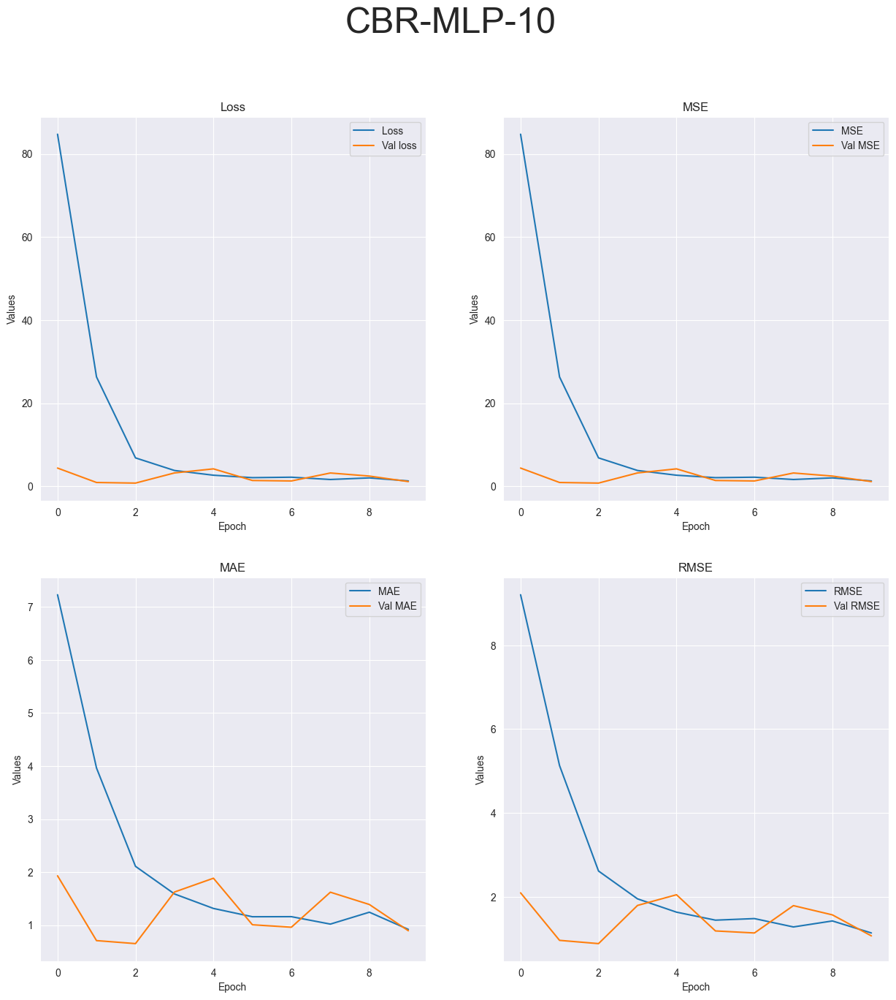

R-squared value: -15.2369


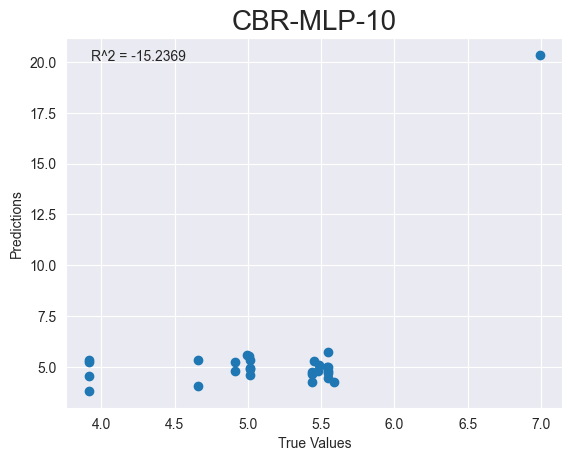

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_128"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_377 (Dense)           (None, 64)                256       
                                                                 
 dropout_88 (Dropout)        (None, 64)                0         
                                                                 
 dense_378 (Dense)           (None, 32)                2080      
                                                                 
 dropout_89 (Dropout)        (None, 32)                0         
                                                                 
 dense_379 (Dense)           (None, 1)                 33        
                                                     

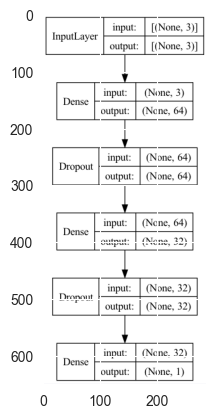

CBR-MLP-20
Epoch 1/20


2023-05-02 10:15:16.399957: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 292ms/step - loss: 81.7751 - mse: 81.7751 - mae: 7.3970 - root_mean_squared_error: 9.0430 - val_loss: 0.3627 - val_mse: 0.3627 - val_mae: 0.5039 - val_root_mean_squared_error: 0.6023
Epoch 2/20


2023-05-02 10:15:17.397946: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 70ms/step - loss: 27.2962 - mse: 27.2962 - mae: 4.0246 - root_mean_squared_error: 5.2246 - val_loss: 0.5659 - val_mse: 0.5659 - val_mae: 0.6608 - val_root_mean_squared_error: 0.7523
Epoch 3/20
3/3 [==============================] - 0s 27ms/step - loss: 9.4102 - mse: 9.4102 - mae: 2.3717 - root_mean_squared_error: 3.0676 - val_loss: 1.2529 - val_mse: 1.2529 - val_mae: 0.9030 - val_root_mean_squared_error: 1.1193
Epoch 4/20
3/3 [==============================] - 0s 50ms/step - loss: 4.7046 - mse: 4.7046 - mae: 1.7061 - root_mean_squared_error: 2.1690 - val_loss: 0.6125 - val_mse: 0.6125 - val_mae: 0.6889 - val_root_mean_squared_error: 0.7826
Epoch 5/20
3/3 [==============================] - 0s 26ms/step - loss: 3.5561 - mse: 3.5561 - mae: 1.4834 - root_mean_squared_error: 1.8858 - val_loss: 3.6169 - val_mse: 3.6169 - val_mae: 1.8168 - val_root_mean_squared_error: 1.9018
Epoch 6/20
3/3 [==============================] - 0s 26ms/step - loss: 3.0170

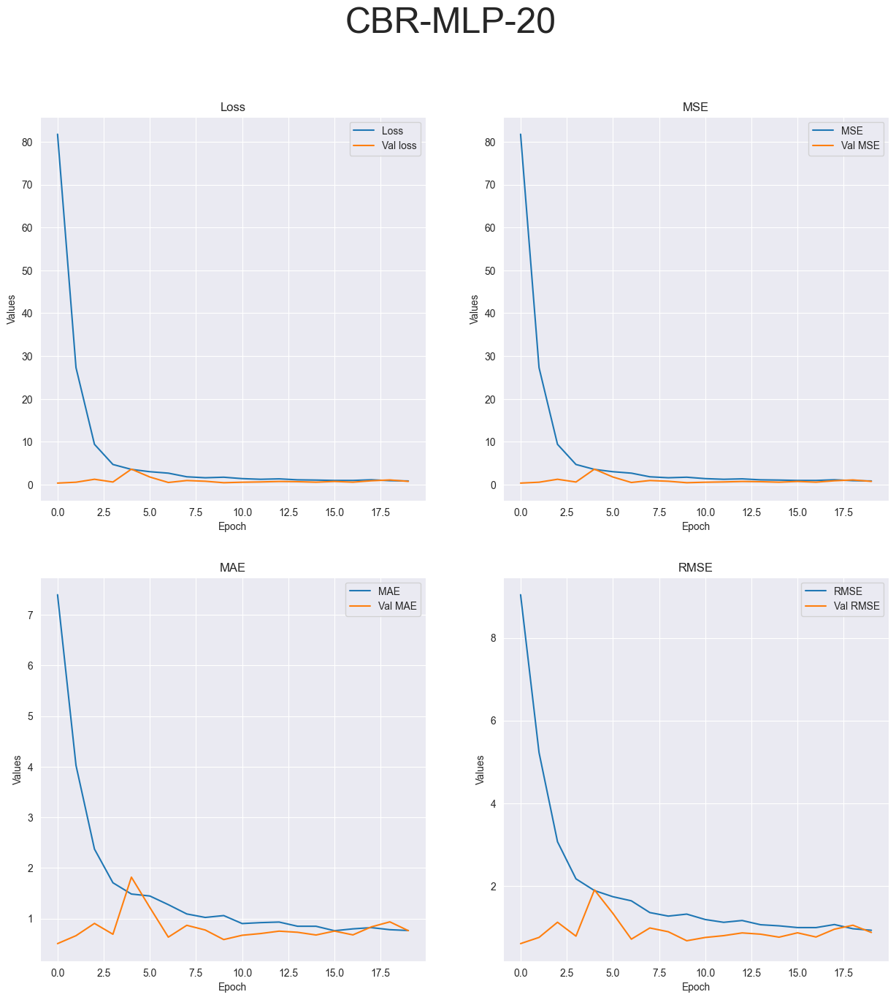

R-squared value: -8.5218


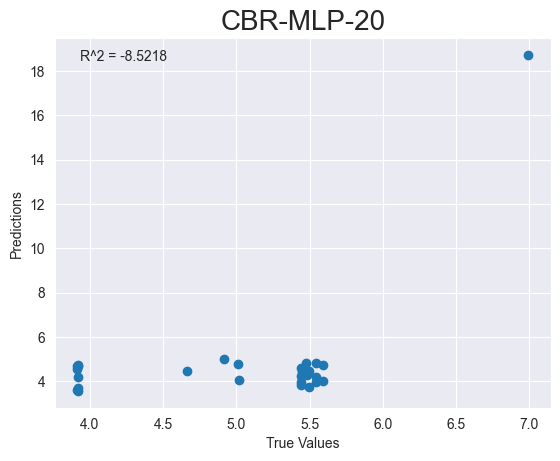

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_129"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_380 (Dense)           (None, 64)                256       
                                                                 
 dense_381 (Dense)           (None, 32)                2080      
                                                                 
 dense_382 (Dense)           (None, 16)                528       
                                                                 
 dense_383 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
________________________

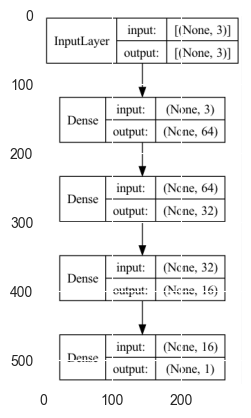

CBR-FCNN-1


2023-05-02 10:15:20.213180: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 242ms/step - loss: 165.5068 - mse: 165.5068 - mae: 10.2151 - root_mean_squared_error: 12.8649 - val_loss: 63.2382 - val_mse: 63.2382 - val_mae: 7.9327 - val_root_mean_squared_error: 7.9522


2023-05-02 10:15:21.015657: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 105ms/step - loss: 59.4678 - mse: 59.4678 - mae: 7.6558 - root_mean_squared_error: 7.7115
Test loss: [59.46782684326172, 59.46782684326172, 7.655766010284424, 7.711538314819336]
['loss', 'mse', 'mae', 'root_mean_squared_error']


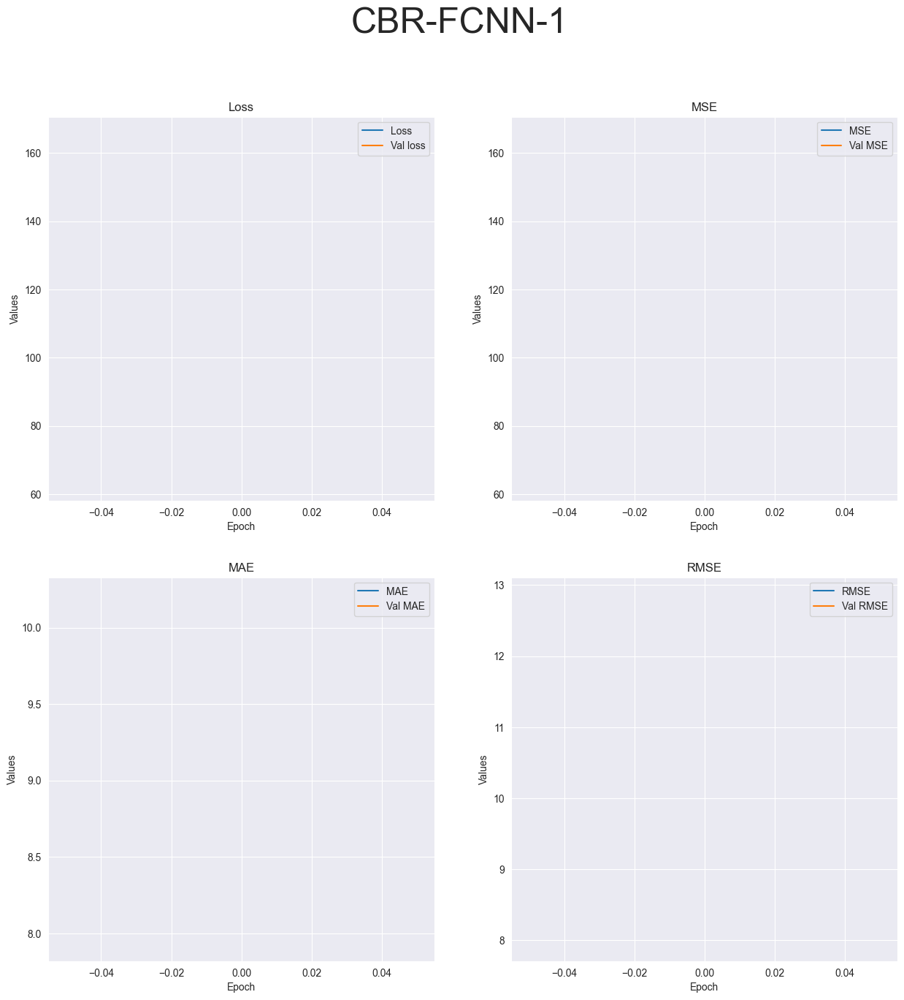

R-squared value: -101.0737


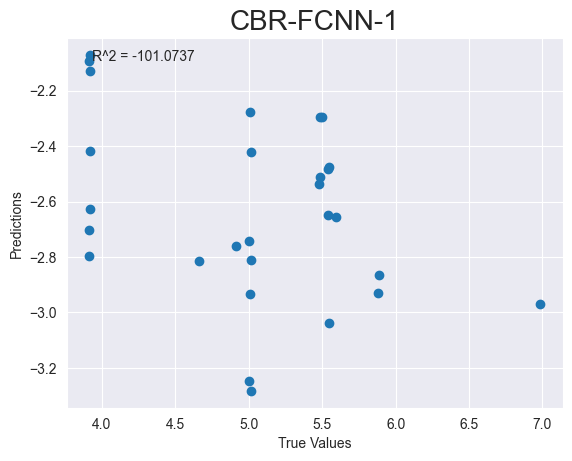

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_130"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_384 (Dense)           (None, 64)                256       
                                                                 
 dense_385 (Dense)           (None, 32)                2080      
                                                                 
 dense_386 (Dense)           (None, 16)                528       
                                                                 
 dense_387 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
____________________________________________________

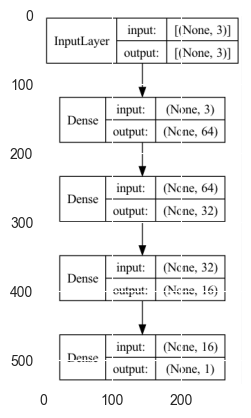

CBR-FCNN-4
Epoch 1/4


2023-05-02 10:15:23.319465: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 259ms/step - loss: 147.7229 - mse: 147.7229 - mae: 9.8476 - root_mean_squared_error: 12.1541 - val_loss: 33.8551 - val_mse: 33.8551 - val_mae: 5.7627 - val_root_mean_squared_error: 5.8185
Epoch 2/4


2023-05-02 10:15:24.288229: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 77ms/step - loss: 79.6035 - mse: 79.6035 - mae: 8.3617 - root_mean_squared_error: 8.9221 - val_loss: 36.6885 - val_mse: 36.6885 - val_mae: 6.0018 - val_root_mean_squared_error: 6.0571
Epoch 3/4
3/3 [==============================] - 0s 44ms/step - loss: 14.6505 - mse: 14.6505 - mae: 3.0607 - root_mean_squared_error: 3.8276 - val_loss: 10.0959 - val_mse: 10.0959 - val_mae: 3.0361 - val_root_mean_squared_error: 3.1774
Epoch 4/4
1/1 [==============================] - 0s 94ms/step - loss: 5.2734 - mse: 5.2734 - mae: 2.1533 - root_mean_squared_error: 2.2964
Test loss: [5.273404598236084, 5.273404598236084, 2.1533331871032715, 2.296389579772949]
['loss', 'mse', 'mae', 'root_mean_squared_error']


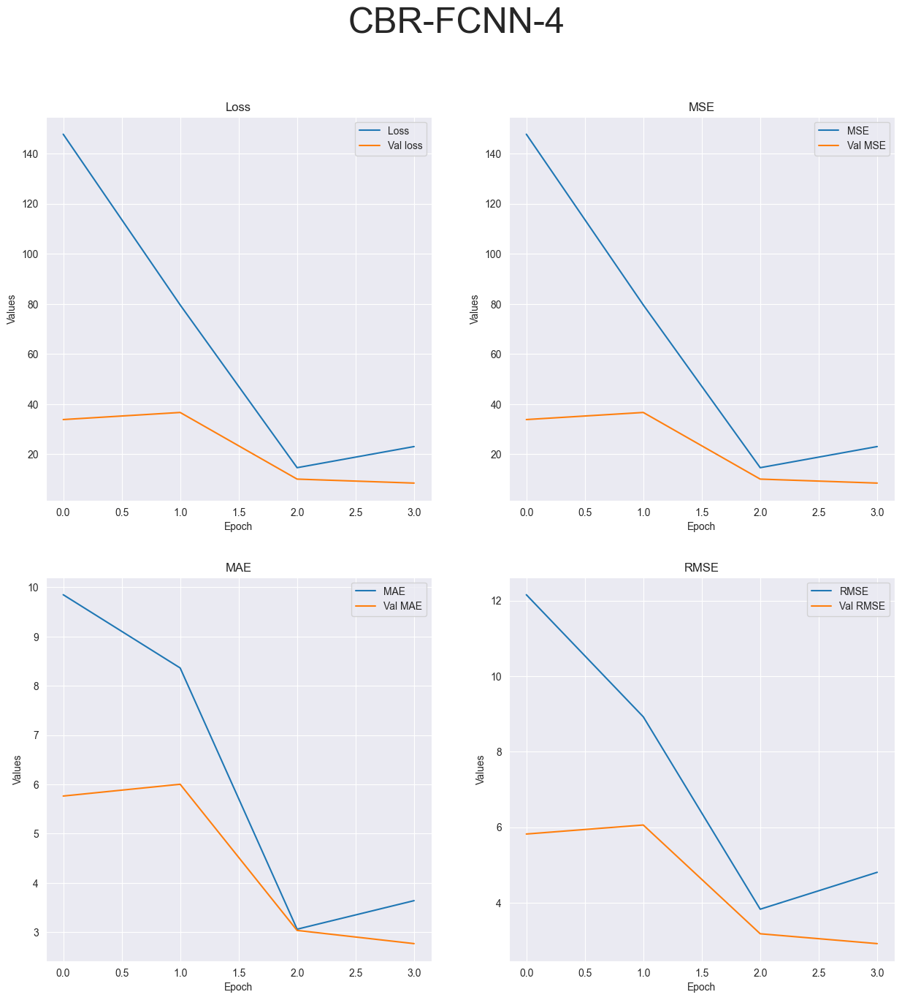

R-squared value: -23.8754


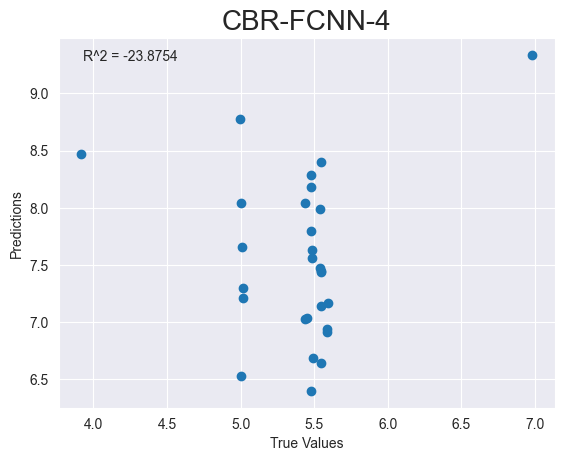

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_131"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_388 (Dense)           (None, 64)                256       
                                                                 
 dense_389 (Dense)           (None, 32)                2080      
                                                                 
 dense_390 (Dense)           (None, 16)                528       
                                                                 
 dense_391 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
___________________________________________________

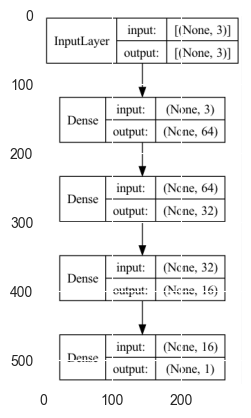

CBR-FCNN-10
Epoch 1/10


2023-05-02 10:15:26.235663: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 253ms/step - loss: 249.4460 - mse: 249.4460 - mae: 10.4944 - root_mean_squared_error: 15.7939 - val_loss: 44.9696 - val_mse: 44.9696 - val_mae: 6.6666 - val_root_mean_squared_error: 6.7059
Epoch 2/10


2023-05-02 10:15:27.152436: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 86ms/step - loss: 123.8067 - mse: 123.8067 - mae: 10.4240 - root_mean_squared_error: 11.1268 - val_loss: 81.7575 - val_mse: 81.7575 - val_mae: 8.9971 - val_root_mean_squared_error: 9.0420
Epoch 3/10
3/3 [==============================] - 0s 44ms/step - loss: 47.6422 - mse: 47.6422 - mae: 5.9843 - root_mean_squared_error: 6.9023 - val_loss: 1.6170 - val_mse: 1.6170 - val_mae: 1.0223 - val_root_mean_squared_error: 1.2716
Epoch 4/10
3/3 [==============================] - 0s 19ms/step - loss: 15.1329 - mse: 15.1329 - mae: 2.3042 - root_mean_squared_error: 3.8901 - val_loss: 12.6308 - val_mse: 12.6308 - val_mae: 3.3917 - val_root_mean_squared_error: 3.5540
Epoch 5/10
3/3 [==============================] - 0s 42ms/step - loss: 17.5145 - mse: 17.5145 - mae: 2.9789 - root_mean_squared_error: 4.1850 - val_loss: 3.7920 - val_mse: 3.7920 - val_mae: 1.7236 - val_root_mean_squared_error: 1.9473
Epoch 6/10
3/3 [==============================] - 0s 22ms/step 

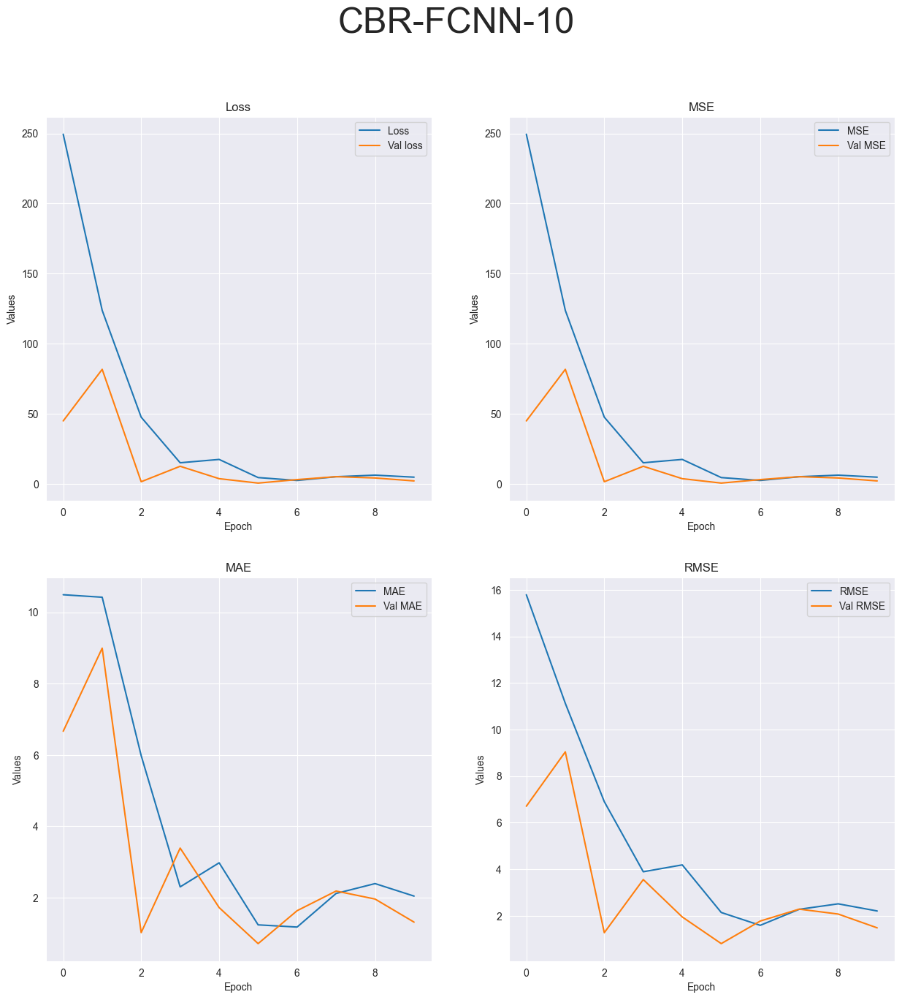

R-squared value: -7.0417


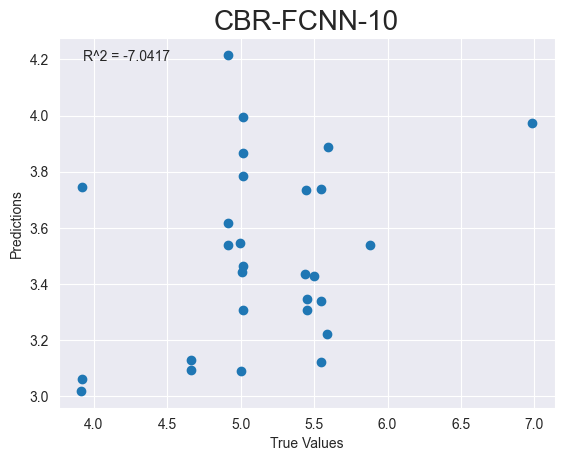

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_132"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_392 (Dense)           (None, 64)                256       
                                                                 
 dense_393 (Dense)           (None, 32)                2080      
                                                                 
 dense_394 (Dense)           (None, 16)                528       
                                                                 
 dense_395 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
___________________________________________________

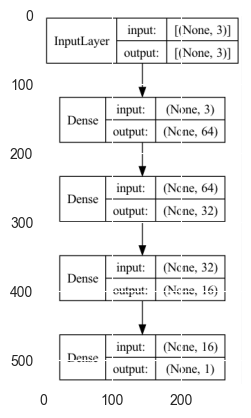

CBR-FCNN-20
Epoch 1/20


2023-05-02 10:15:29.340626: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 231ms/step - loss: 149.7744 - mse: 149.7744 - mae: 9.9618 - root_mean_squared_error: 12.2382 - val_loss: 29.5000 - val_mse: 29.5000 - val_mae: 5.3928 - val_root_mean_squared_error: 5.4314
Epoch 2/20


2023-05-02 10:15:30.208081: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 68ms/step - loss: 68.8996 - mse: 68.8996 - mae: 8.0486 - root_mean_squared_error: 8.3006 - val_loss: 41.3070 - val_mse: 41.3070 - val_mae: 6.3929 - val_root_mean_squared_error: 6.4271
Epoch 3/20
3/3 [==============================] - 0s 51ms/step - loss: 19.6761 - mse: 19.6761 - mae: 3.5804 - root_mean_squared_error: 4.4358 - val_loss: 5.8723 - val_mse: 5.8723 - val_mae: 2.2722 - val_root_mean_squared_error: 2.4233
Epoch 4/20
3/3 [==============================] - 0s 33ms/step - loss: 20.6946 - mse: 20.6946 - mae: 3.3122 - root_mean_squared_error: 4.5491 - val_loss: 4.3520 - val_mse: 4.3520 - val_mae: 1.9292 - val_root_mean_squared_error: 2.0862
Epoch 5/20
3/3 [==============================] - 0s 33ms/step - loss: 10.7263 - mse: 10.7263 - mae: 1.7059 - root_mean_squared_error: 3.2751 - val_loss: 2.1537 - val_mse: 2.1537 - val_mae: 1.3029 - val_root_mean_squared_error: 1.4675
Epoch 6/20
3/3 [==============================] - 0s 25ms/step - loss

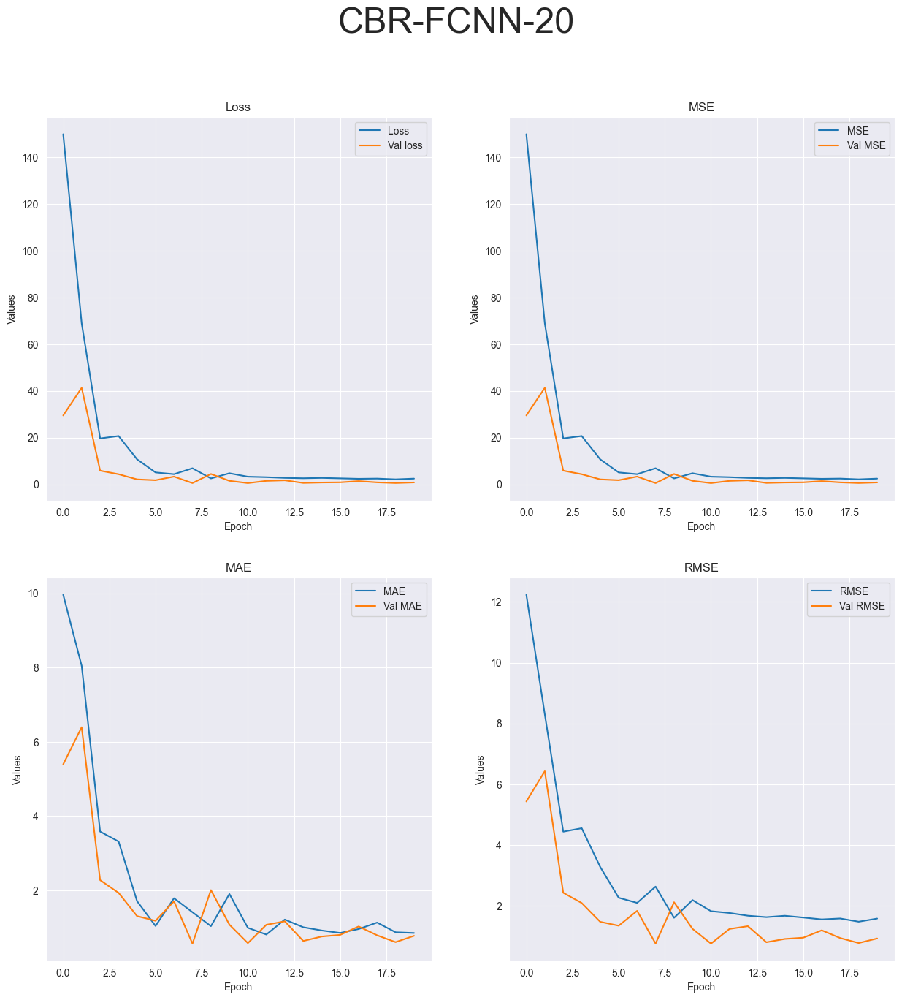

R-squared value: -0.8402


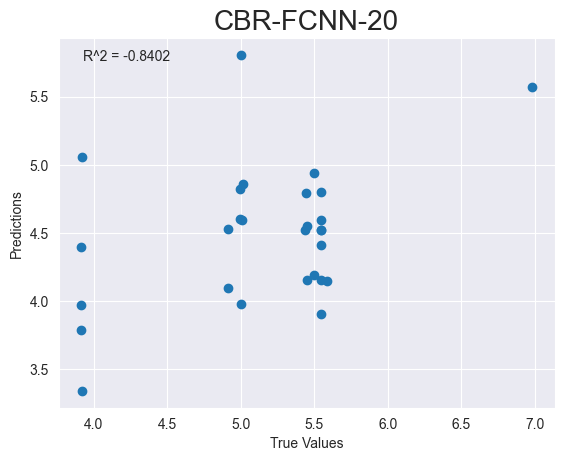

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_133"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_396 (Dense)           (None, 128)               512       
                                                                 
 dense_397 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


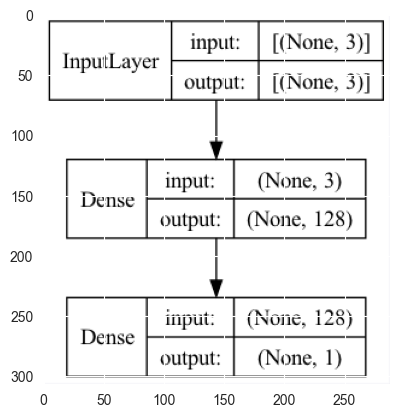

CBR-DeepSVM-1


2023-05-02 10:15:33.033163: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 227ms/step - loss: 3884.7043 - mse: 3884.6489 - mae: 55.6956 - root_mean_squared_error: 62.3270 - val_loss: 29.9943 - val_mse: 29.9405 - val_mae: 4.3511 - val_root_mean_squared_error: 5.4718


2023-05-02 10:15:33.782557: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 74ms/step - loss: 23.6924 - mse: 23.6386 - mae: 4.2725 - root_mean_squared_error: 4.8620
Test loss: [23.69243049621582, 23.63859748840332, 4.272491455078125, 4.861954212188721]
['loss', 'mse', 'mae', 'root_mean_squared_error']


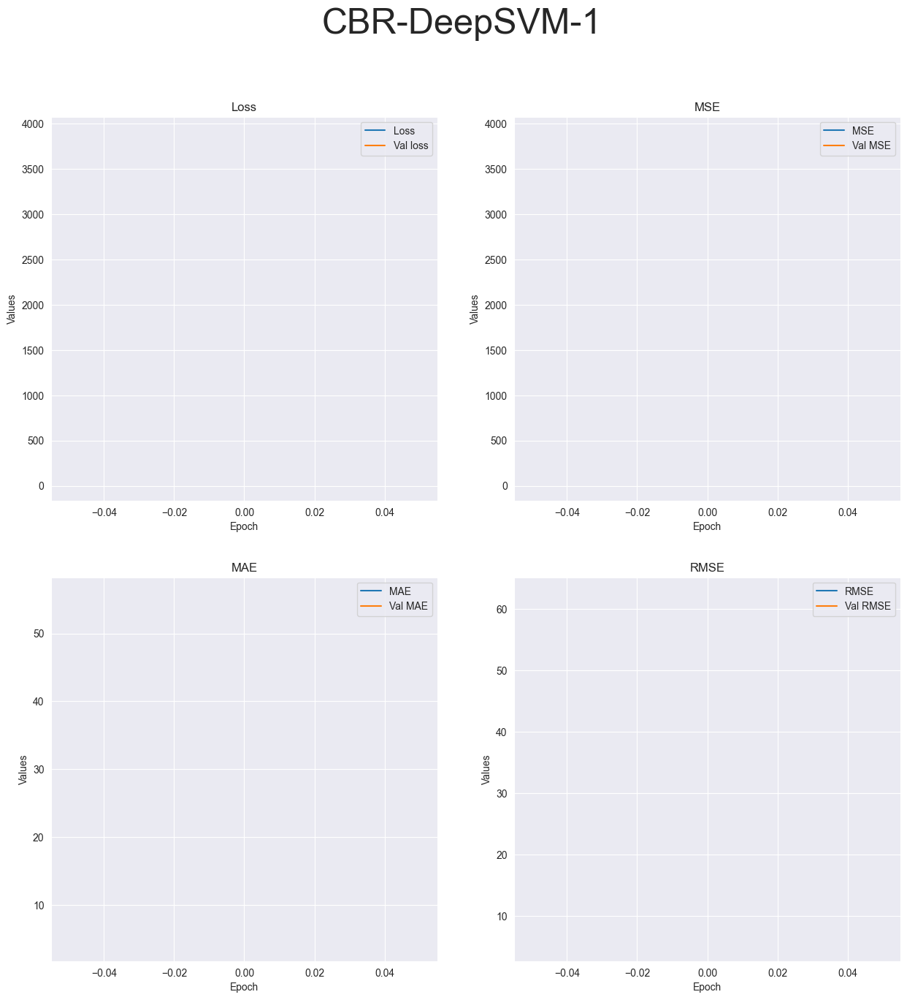

R-squared value: -53.1137


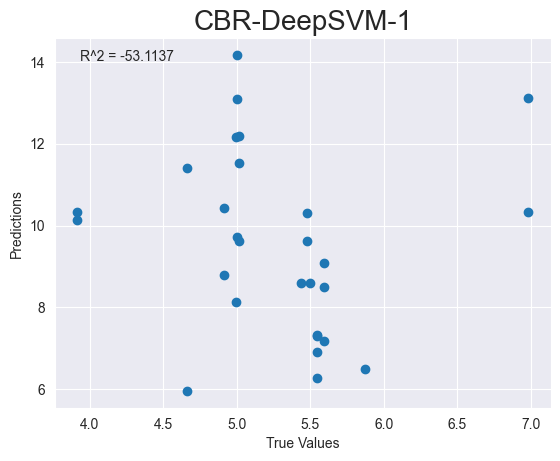

Running tests with 4 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_134"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_398 (Dense)           (None, 128)               512       
                                                                 
 dense_399 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


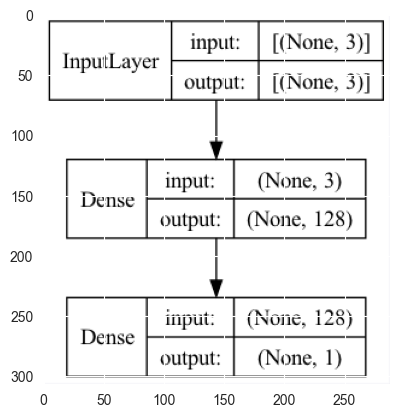

CBR-DeepSVM-4
Epoch 1/4


2023-05-02 10:15:36.005213: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 250ms/step - loss: 4757.4282 - mse: 4757.3730 - mae: 58.0742 - root_mean_squared_error: 68.9737 - val_loss: 62.2536 - val_mse: 62.1996 - val_mae: 7.3037 - val_root_mean_squared_error: 7.8867
Epoch 2/4


2023-05-02 10:15:37.184928: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 57ms/step - loss: 218.3471 - mse: 218.2928 - mae: 12.9186 - root_mean_squared_error: 14.7747 - val_loss: 909.4910 - val_mse: 909.4363 - val_mae: 30.0902 - val_root_mean_squared_error: 30.1569
Epoch 3/4
3/3 [==============================] - 0s 49ms/step - loss: 1250.6490 - mse: 1250.5946 - mae: 33.1632 - root_mean_squared_error: 35.3637 - val_loss: 798.0588 - val_mse: 798.0056 - val_mae: 28.1871 - val_root_mean_squared_error: 28.2490
Epoch 4/4
1/1 [==============================] - 0s 69ms/step - loss: 97.5919 - mse: 97.5408 - mae: 9.8014 - root_mean_squared_error: 9.8763
Test loss: [97.5919189453125, 97.54084777832031, 9.801376342773438, 9.876276969909668]
['loss', 'mse', 'mae', 'root_mean_squared_error']


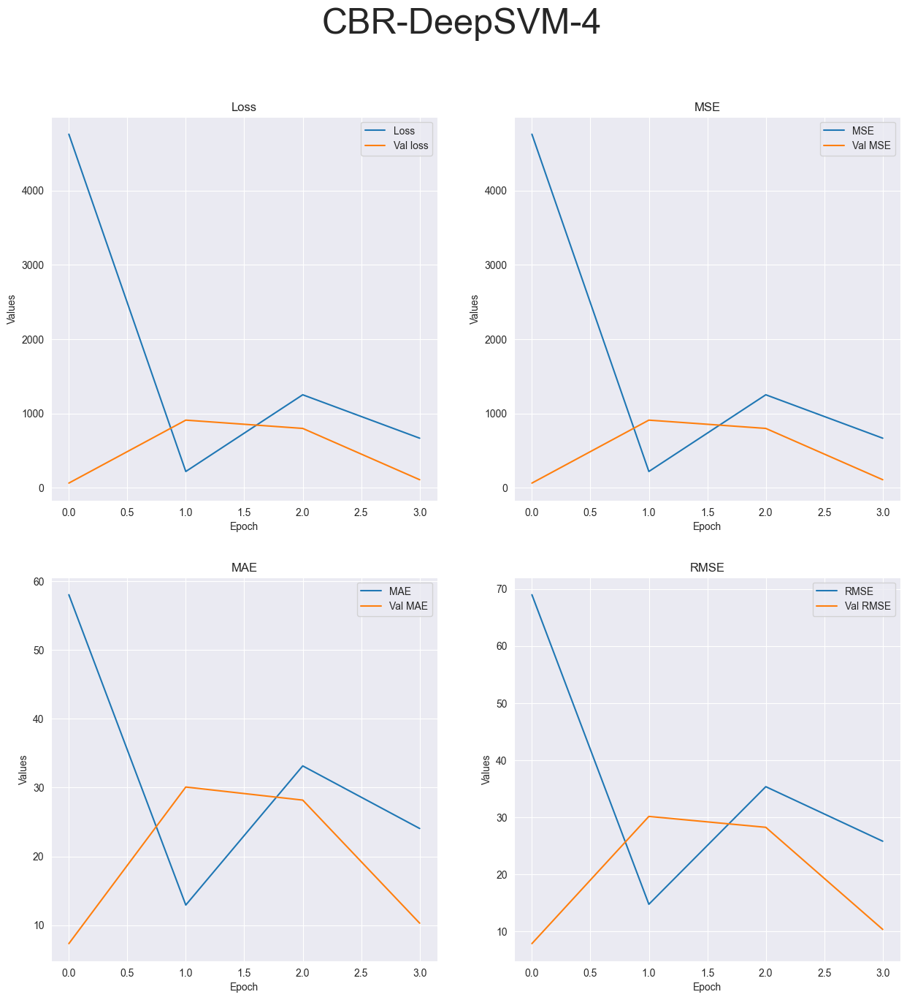

R-squared value: -170.4916


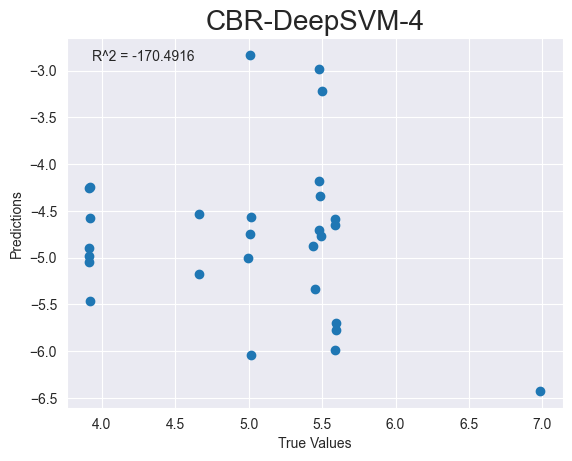

Running tests with 10 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_135"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_400 (Dense)           (None, 128)               512       
                                                                 
 dense_401 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


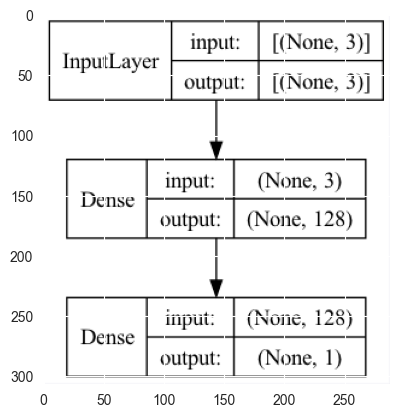

CBR-DeepSVM-10
Epoch 1/10


2023-05-02 10:15:38.984528: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 241ms/step - loss: 3472.2075 - mse: 3472.1516 - mae: 54.6162 - root_mean_squared_error: 58.9250 - val_loss: 44.4575 - val_mse: 44.4035 - val_mae: 5.5932 - val_root_mean_squared_error: 6.6636


2023-05-02 10:15:39.713848: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


Epoch 2/10
3/3 [==============================] - 0s 52ms/step - loss: 278.5905 - mse: 278.5362 - mae: 13.8085 - root_mean_squared_error: 16.6894 - val_loss: 1908.7225 - val_mse: 1908.6678 - val_mae: 37.2730 - val_root_mean_squared_error: 43.6883
Epoch 3/10
3/3 [==============================] - 0s 31ms/step - loss: 1091.2365 - mse: 1091.1824 - mae: 32.9248 - root_mean_squared_error: 33.0331 - val_loss: 1171.3112 - val_mse: 1171.2584 - val_mae: 29.3112 - val_root_mean_squared_error: 34.2237
Epoch 4/10
3/3 [==============================] - 0s 25ms/step - loss: 429.3842 - mse: 429.3321 - mae: 19.9640 - root_mean_squared_error: 20.7203 - val_loss: 48.9994 - val_mse: 48.9486 - val_mae: 6.0911 - val_root_mean_squared_error: 6.9963
Epoch 5/10
3/3 [==============================] - 0s 33ms/step - loss: 25.2302 - mse: 25.1798 - mae: 4.2736 - root_mean_squared_error: 5.0179 - val_loss: 227.2653 - val_mse: 227.2153 - val_mae: 12.4605 - val_root_mean_squared_error: 15.0737
Epoch 6/10
3/3 [======

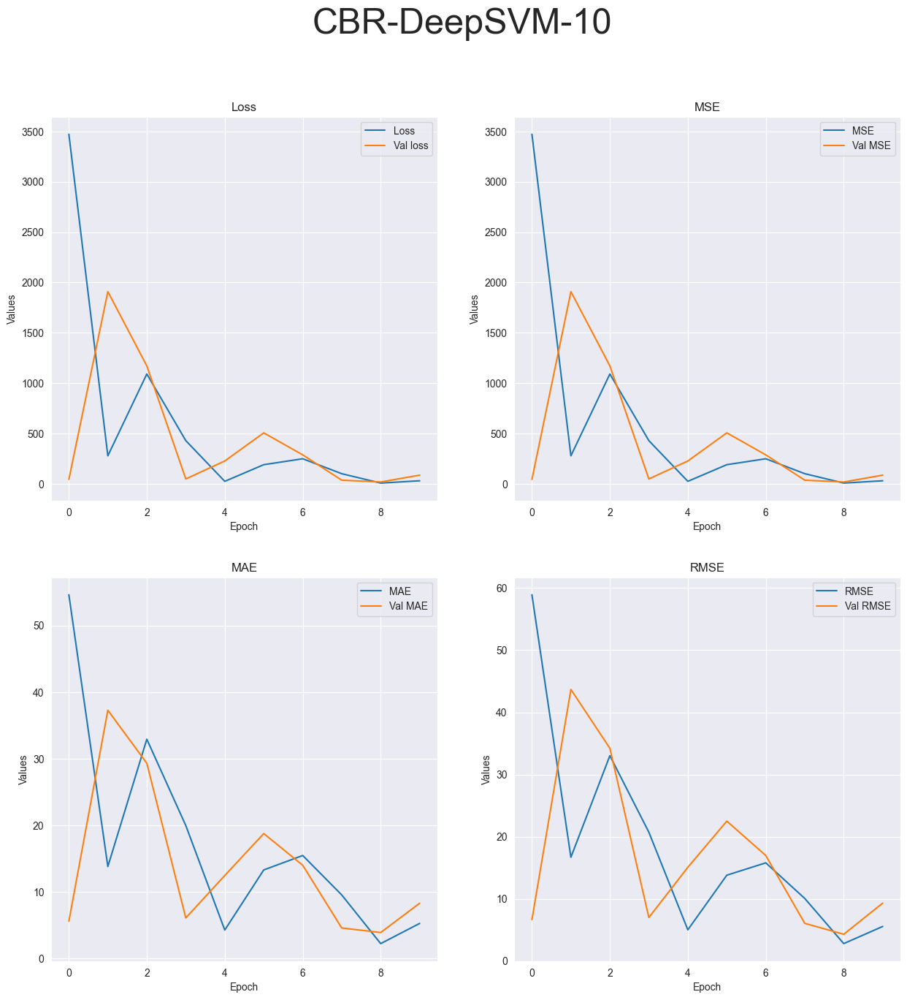

R-squared value: -108.5671


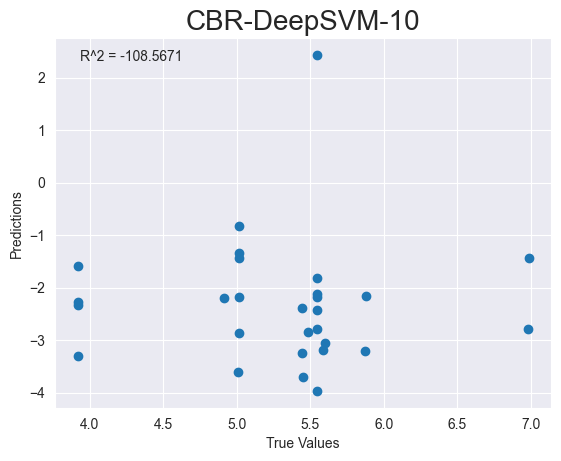

Running tests with 20 epochs...
   ID  AverageMass       meanB       meanG       meanR
0  21       6.9924  198.893786  199.678142  182.305782
1  22       6.9847   54.970148   54.612693   44.816905
Model: "sequential_136"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_402 (Dense)           (None, 128)               512       
                                                                 
 dense_403 (Dense)           (None, 1)                 129       
                                                                 
Total params: 641
Trainable params: 641
Non-trainable params: 0
_________________________________________________________________
None


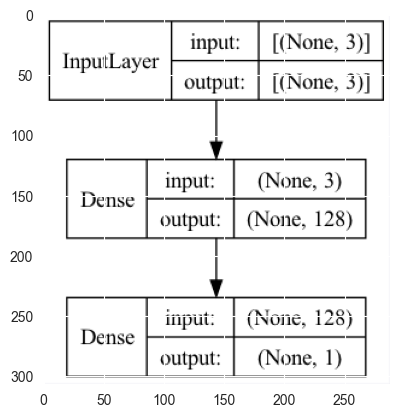

CBR-DeepSVM-20
Epoch 1/20


2023-05-02 10:15:41.958807: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 252ms/step - loss: 3998.0186 - mse: 3997.9631 - mae: 56.3959 - root_mean_squared_error: 63.2295 - val_loss: 19.7188 - val_mse: 19.6650 - val_mae: 3.7105 - val_root_mean_squared_error: 4.4345
Epoch 2/20


2023-05-02 10:15:42.756426: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 61ms/step - loss: 327.9505 - mse: 327.8964 - mae: 14.8338 - root_mean_squared_error: 18.1079 - val_loss: 1024.2471 - val_mse: 1024.1927 - val_mae: 31.9045 - val_root_mean_squared_error: 32.0030
Epoch 3/20
3/3 [==============================] - 0s 30ms/step - loss: 1322.6562 - mse: 1322.6023 - mae: 34.4856 - root_mean_squared_error: 36.3676 - val_loss: 695.7592 - val_mse: 695.7065 - val_mae: 26.2968 - val_root_mean_squared_error: 26.3762
Epoch 4/20
3/3 [==============================] - 0s 43ms/step - loss: 487.3185 - mse: 487.2665 - mae: 21.1159 - root_mean_squared_error: 22.0741 - val_loss: 36.6997 - val_mse: 36.6489 - val_mae: 5.8832 - val_root_mean_squared_error: 6.0538
Epoch 5/20
3/3 [==============================] - 0s 23ms/step - loss: 36.3566 - mse: 36.3060 - mae: 4.9552 - root_mean_squared_error: 6.0255 - val_loss: 137.6275 - val_mse: 137.5774 - val_mae: 11.4052 - val_root_mean_squared_error: 11.7293
Epoch 6/20
3/3 [===================

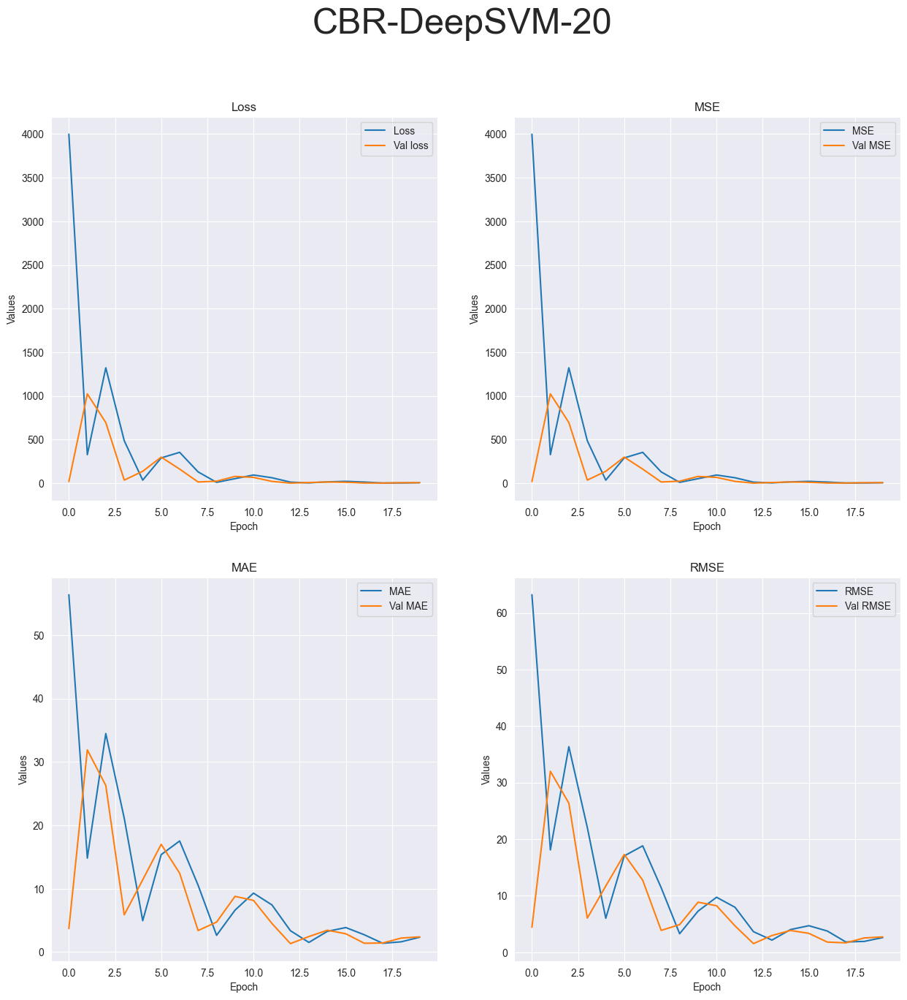

R-squared value: -16.4021


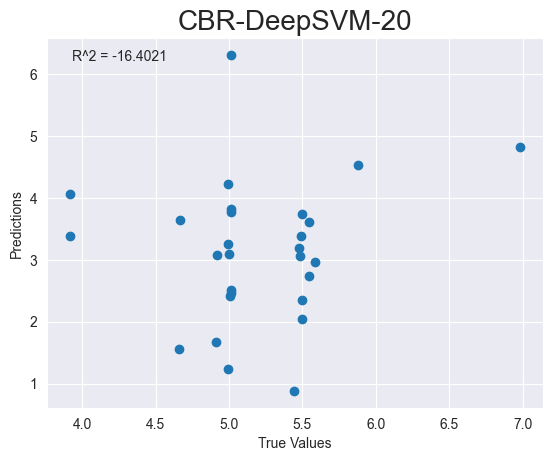

Running tests on ABR.csv dataset...
Running MLP model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_137"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_404 (Dense)           (None, 64)                832       
                                                                 
 dropout_90 (Dropout)        (None, 64)                0         
                            

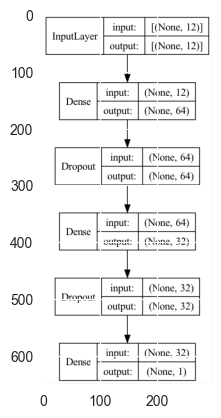

ABR-MLP-1


2023-05-02 10:15:45.558964: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 297ms/step - loss: 2203661.0000 - mse: 2203661.0000 - mae: 1118.9017 - root_mean_squared_error: 1484.4733 - val_loss: 49449.8203 - val_mse: 49449.8203 - val_mae: 216.5686 - val_root_mean_squared_error: 222.3732


2023-05-02 10:15:46.668792: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 133ms/step - loss: 61691.4805 - mse: 61691.4805 - mae: 238.2089 - root_mean_squared_error: 248.3777
Test loss: [61691.48046875, 61691.48046875, 238.2089385986328, 248.37770080566406]
['loss', 'mse', 'mae', 'root_mean_squared_error']


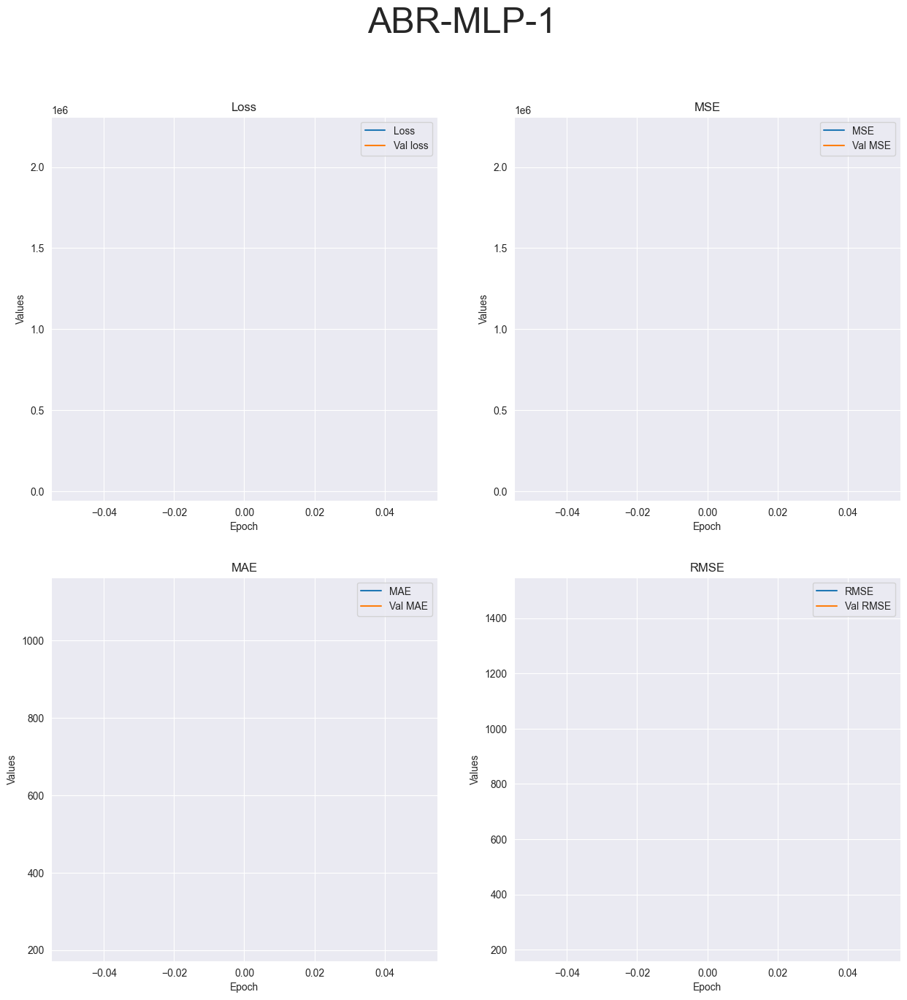

R-squared value: -114960.3807


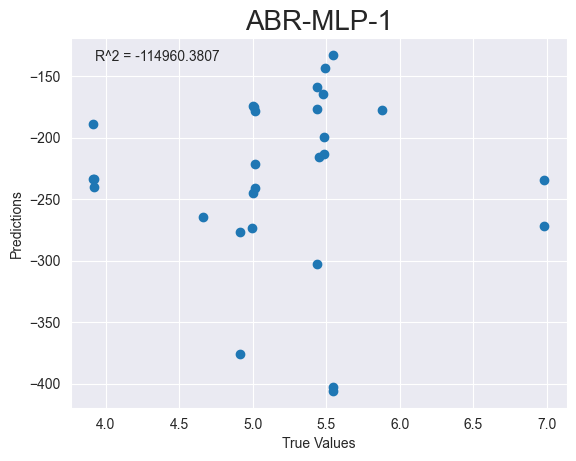

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_138"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_407 (Dense)           (None, 64)                832       
                                                                 
 dropout_92 (Dropout)        (None, 64)                0         
                                                                 
 dense_408 (Dense)       

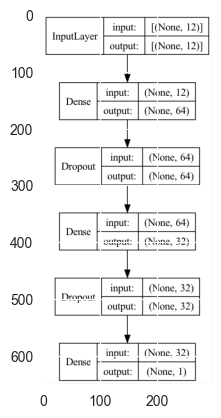

ABR-MLP-4
Epoch 1/4


2023-05-02 10:15:49.006758: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 300ms/step - loss: 2089149.2500 - mse: 2089149.2500 - mae: 1139.0323 - root_mean_squared_error: 1445.3889 - val_loss: 79358.4922 - val_mse: 79358.4922 - val_mae: 273.7279 - val_root_mean_squared_error: 281.7064
Epoch 2/4


2023-05-02 10:15:50.307400: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 92ms/step - loss: 398098.1562 - mse: 398098.1562 - mae: 502.3143 - root_mean_squared_error: 630.9502 - val_loss: 61433.9492 - val_mse: 61433.9492 - val_mae: 240.8612 - val_root_mean_squared_error: 247.8587
Epoch 3/4
3/3 [==============================] - 0s 40ms/step - loss: 199858.9844 - mse: 199858.9844 - mae: 341.0748 - root_mean_squared_error: 447.0559 - val_loss: 23395.7129 - val_mse: 23395.7129 - val_mae: 148.1154 - val_root_mean_squared_error: 152.9566
Epoch 4/4
1/1 [==============================] - 0s 59ms/step - loss: 23084.4512 - mse: 23084.4512 - mae: 142.9732 - root_mean_squared_error: 151.9357
Test loss: [23084.451171875, 23084.451171875, 142.97317504882812, 151.93568420410156]
['loss', 'mse', 'mae', 'root_mean_squared_error']


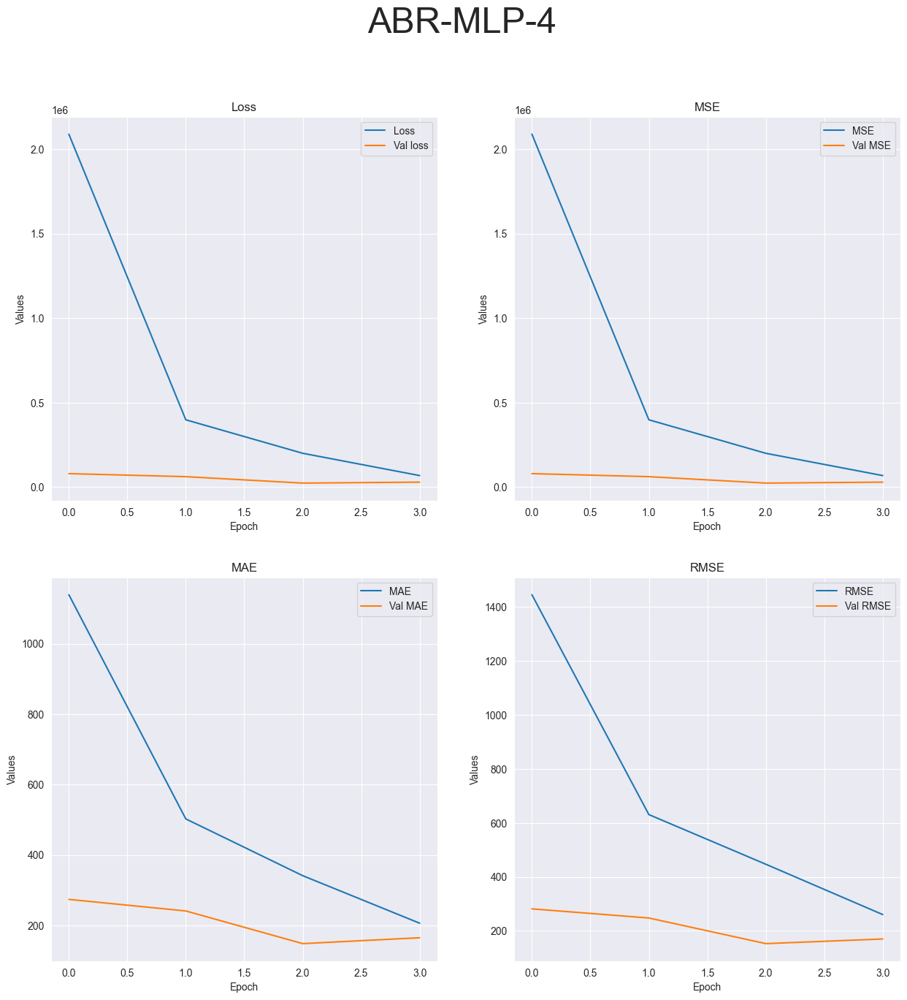

R-squared value: -66322.0838


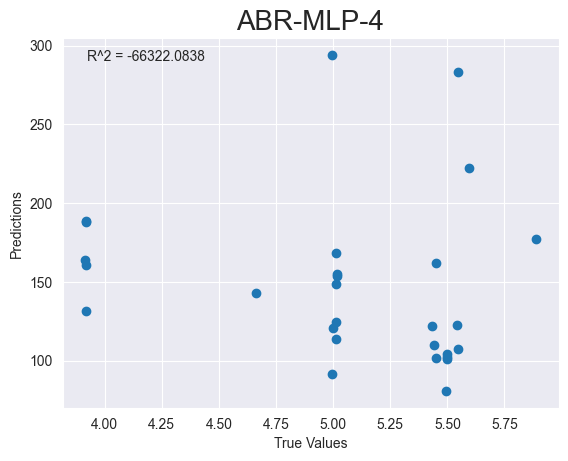

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_139"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_410 (Dense)           (None, 64)                832       
                                                                 
 dropout_94 (Dropout)        (None, 64)                0         
                                                                 
 dense_411 (Dense)      

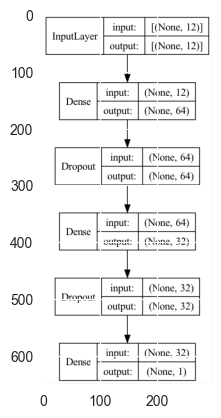

ABR-MLP-10
Epoch 1/10


2023-05-02 10:15:52.386554: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 293ms/step - loss: 2038272.0000 - mse: 2038272.0000 - mae: 1124.4602 - root_mean_squared_error: 1427.6807 - val_loss: 379.6456 - val_mse: 379.6456 - val_mae: 19.0960 - val_root_mean_squared_error: 19.4845
Epoch 2/10


2023-05-02 10:15:53.462976: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 98ms/step - loss: 418643.7812 - mse: 418643.7812 - mae: 478.0808 - root_mean_squared_error: 647.0269 - val_loss: 129453.9141 - val_mse: 129453.9141 - val_mae: 343.7494 - val_root_mean_squared_error: 359.7971
Epoch 3/10
3/3 [==============================] - 0s 34ms/step - loss: 246446.1406 - mse: 246446.1406 - mae: 391.4757 - root_mean_squared_error: 496.4334 - val_loss: 20.5560 - val_mse: 20.5560 - val_mae: 4.0006 - val_root_mean_squared_error: 4.5339
Epoch 4/10
3/3 [==============================] - 0s 21ms/step - loss: 79099.9922 - mse: 79099.9922 - mae: 216.0839 - root_mean_squared_error: 281.2472 - val_loss: 37879.1914 - val_mse: 37879.1914 - val_mae: 185.1470 - val_root_mean_squared_error: 194.6258
Epoch 5/10
3/3 [==============================] - 0s 67ms/step - loss: 65872.3516 - mse: 65872.3516 - mae: 205.5810 - root_mean_squared_error: 256.6561 - val_loss: 34491.3086 - val_mse: 34491.3086 - val_mae: 176.6465 - val_root_mean_squared_err

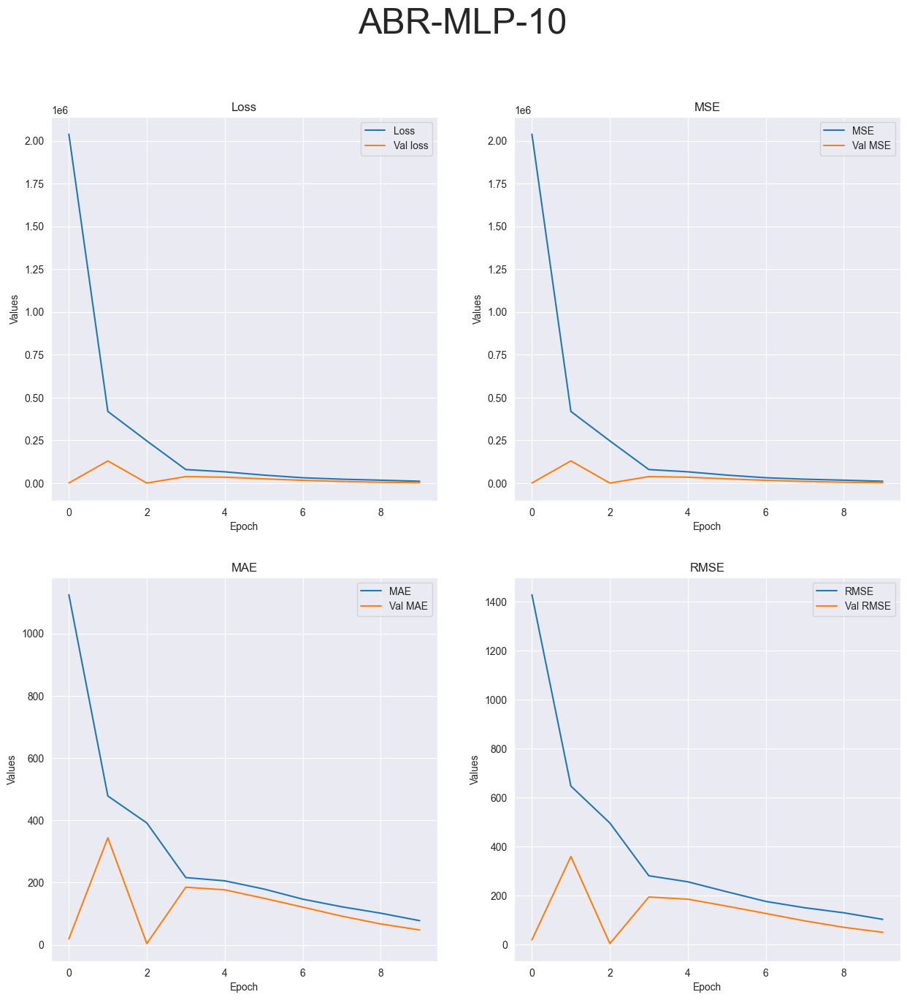

R-squared value: -3436.4455


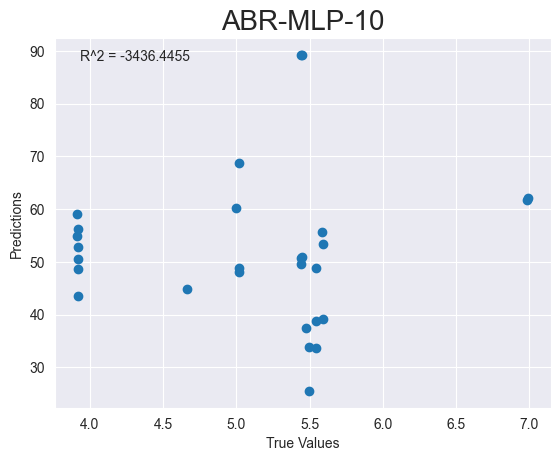

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_140"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_413 (Dense)           (None, 64)                832       
                                                                 
 dropout_96 (Dropout)        (None, 64)                0         
                                                                 
 dense_414 (Dense)      

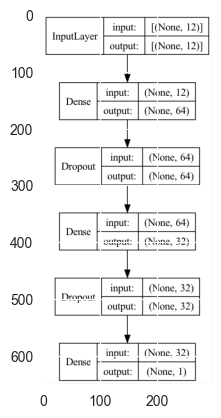

ABR-MLP-20
Epoch 1/20


2023-05-02 10:15:56.415452: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 286ms/step - loss: 2466501.7500 - mse: 2466501.7500 - mae: 1195.1296 - root_mean_squared_error: 1570.5100 - val_loss: 45436.5547 - val_mse: 45436.5547 - val_mae: 206.6342 - val_root_mean_squared_error: 213.1585
Epoch 2/20


2023-05-02 10:15:57.499835: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 89ms/step - loss: 356214.3750 - mse: 356214.3750 - mae: 464.3078 - root_mean_squared_error: 596.8370 - val_loss: 80972.5547 - val_mse: 80972.5547 - val_mae: 275.8381 - val_root_mean_squared_error: 284.5568
Epoch 3/20
3/3 [==============================] - 0s 47ms/step - loss: 211535.6250 - mse: 211535.6250 - mae: 360.9854 - root_mean_squared_error: 459.9300 - val_loss: 944.3644 - val_mse: 944.3644 - val_mae: 29.5713 - val_root_mean_squared_error: 30.7305
Epoch 4/20
3/3 [==============================] - 0s 41ms/step - loss: 53021.2930 - mse: 53021.2930 - mae: 164.2165 - root_mean_squared_error: 230.2635 - val_loss: 14266.3613 - val_mse: 14266.3613 - val_mae: 115.2213 - val_root_mean_squared_error: 119.4419
Epoch 5/20
3/3 [==============================] - 0s 20ms/step - loss: 42381.8320 - mse: 42381.8320 - mae: 160.0607 - root_mean_squared_error: 205.8685 - val_loss: 13604.6689 - val_mse: 13604.6689 - val_mae: 112.5140 - val_root_mean_squared_e

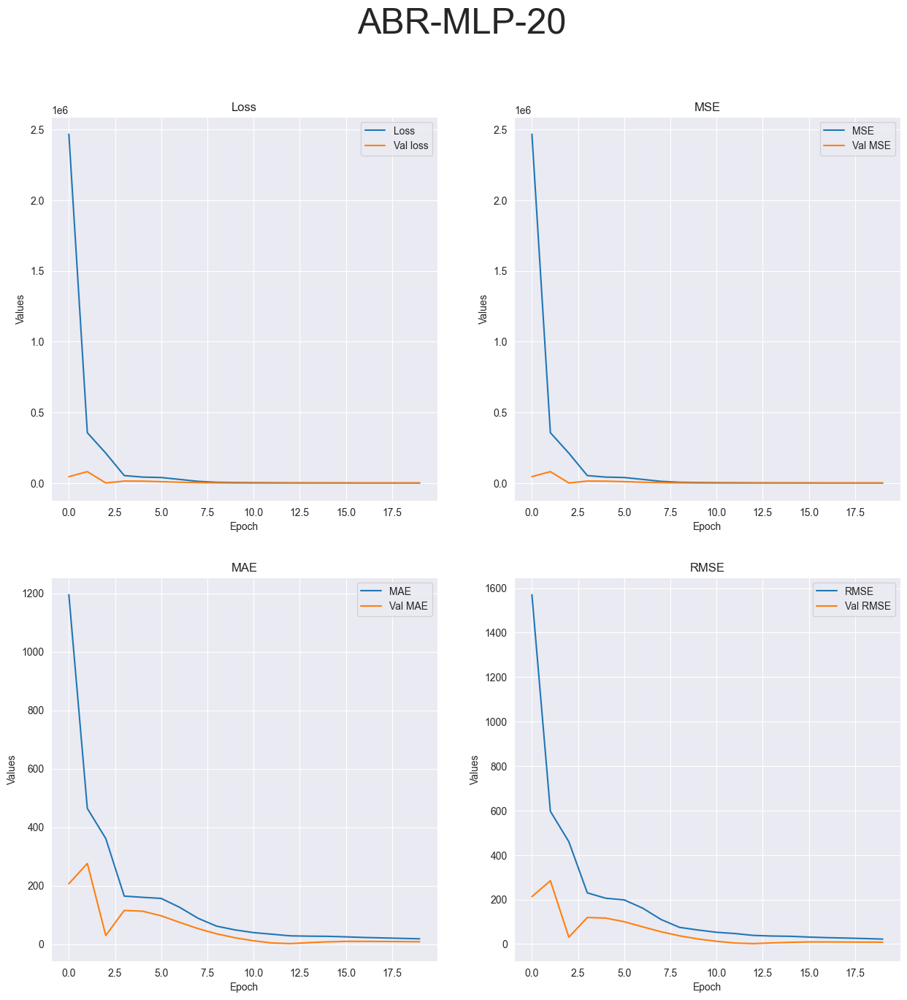

R-squared value: -232.6745


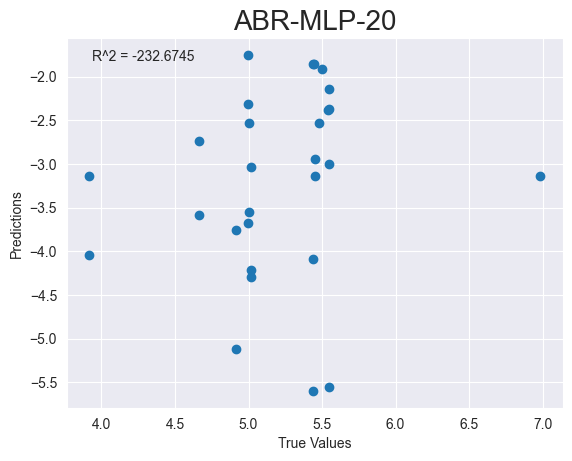

Running FCNN model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_141"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_416 (Dense)           (None, 64)                832       
                                                                 
 dense_417 (Dense)           (None, 32)                2080      
                                                               

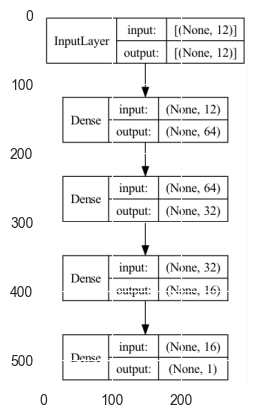

ABR-FCNN-1


2023-05-02 10:16:00.540341: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 283ms/step - loss: 4984483.5000 - mse: 4984483.5000 - mae: 1703.2030 - root_mean_squared_error: 2232.5957 - val_loss: 180086.9844 - val_mse: 180086.9844 - val_mae: 409.9193 - val_root_mean_squared_error: 424.3666


2023-05-02 10:16:01.475328: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 82ms/step - loss: 189018.5156 - mse: 189018.5156 - mae: 423.5589 - root_mean_squared_error: 434.7626
Test loss: [189018.515625, 189018.515625, 423.5589294433594, 434.7626037597656]
['loss', 'mse', 'mae', 'root_mean_squared_error']


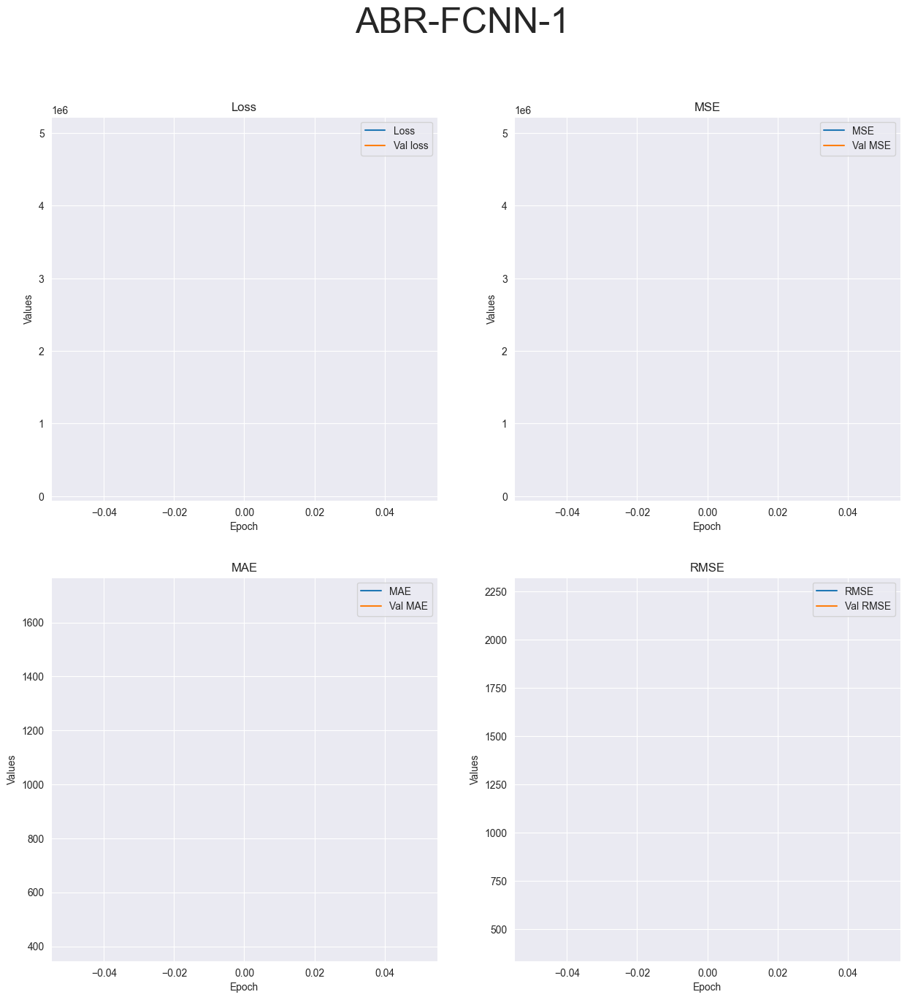

R-squared value: -288872.5313


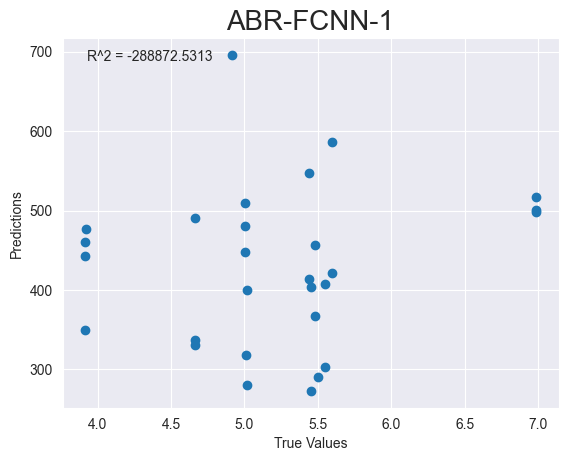

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_142"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_420 (Dense)           (None, 64)                832       
                                                                 
 dense_421 (Dense)           (None, 32)                2080      
                                                                 
 dense_422 (Dense)       

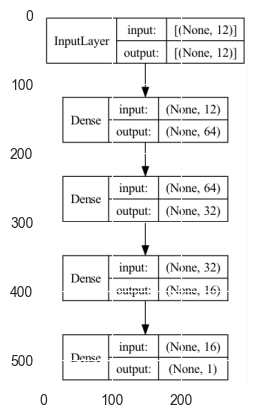

ABR-FCNN-4
Epoch 1/4


2023-05-02 10:16:03.069763: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 262ms/step - loss: 5906438.0000 - mse: 5906438.0000 - mae: 1766.9270 - root_mean_squared_error: 2430.3164 - val_loss: 141723.8750 - val_mse: 141723.8750 - val_mae: 363.6295 - val_root_mean_squared_error: 376.4623
Epoch 2/4


2023-05-02 10:16:03.913680: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 89ms/step - loss: 1352509.2500 - mse: 1352509.3750 - mae: 1000.1171 - root_mean_squared_error: 1162.9744 - val_loss: 1766285.2500 - val_mse: 1766285.2500 - val_mae: 1285.0798 - val_root_mean_squared_error: 1329.0166
Epoch 3/4
3/3 [==============================] - 0s 37ms/step - loss: 1173438.8750 - mse: 1173438.8750 - mae: 957.6831 - root_mean_squared_error: 1083.2538 - val_loss: 16.9059 - val_mse: 16.9059 - val_mae: 3.5104 - val_root_mean_squared_error: 4.1117
Epoch 4/4
1/1 [==============================] - 0s 101ms/step - loss: 469540.4062 - mse: 469540.4062 - mae: 675.1917 - root_mean_squared_error: 685.2302
Test loss: [469540.40625, 469540.40625, 675.1917114257812, 685.2301635742188]
['loss', 'mse', 'mae', 'root_mean_squared_error']


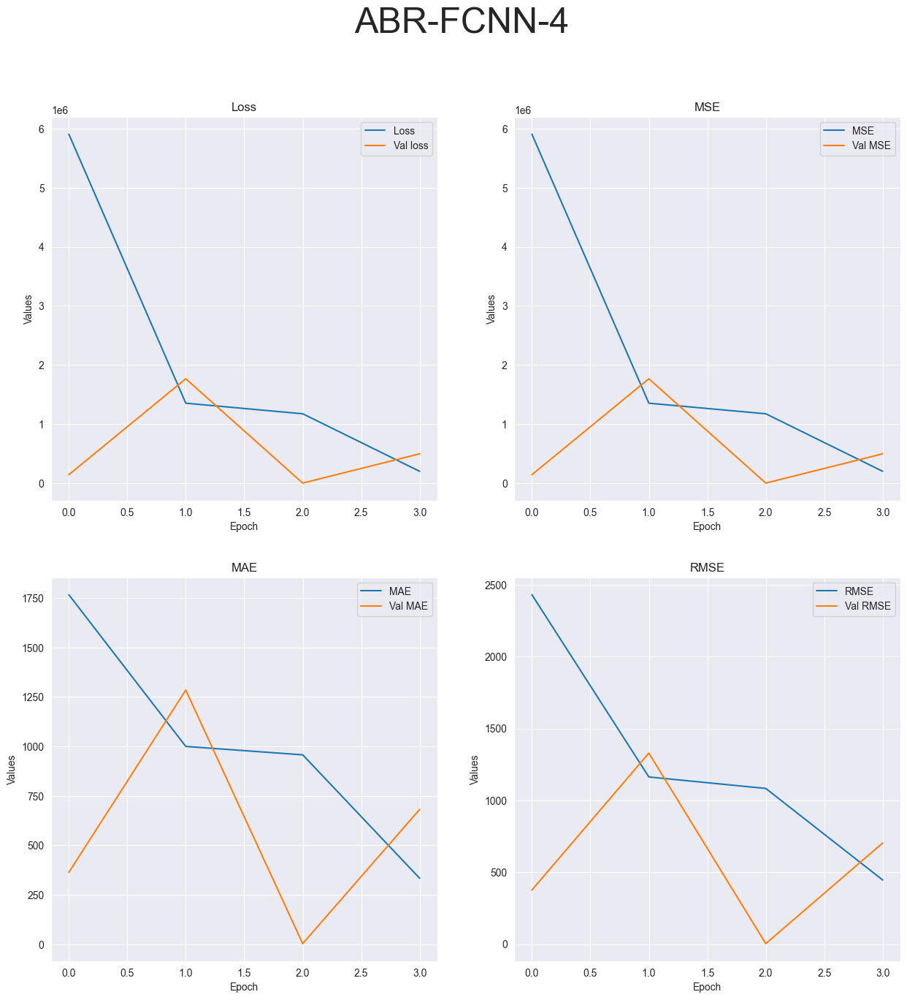

R-squared value: -677675.9041


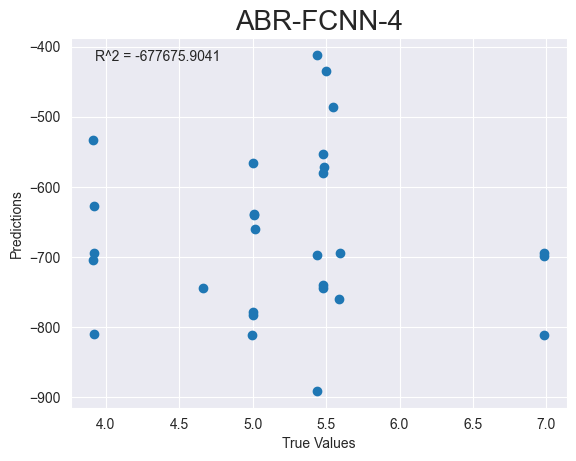

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_143"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_424 (Dense)           (None, 64)                832       
                                                                 
 dense_425 (Dense)           (None, 32)                2080      
                                                                 
 dense_426 (Dense)      

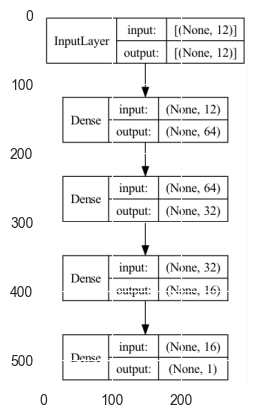

ABR-FCNN-10
Epoch 1/10


2023-05-02 10:16:06.808157: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 282ms/step - loss: 6642050.0000 - mse: 6642050.0000 - mae: 1863.1306 - root_mean_squared_error: 2577.2175 - val_loss: 186765.5625 - val_mse: 186765.5625 - val_mae: 410.1829 - val_root_mean_squared_error: 432.1638
Epoch 2/10


2023-05-02 10:16:07.804510: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 73ms/step - loss: 1451948.2500 - mse: 1451948.2500 - mae: 1041.8683 - root_mean_squared_error: 1204.9681 - val_loss: 2335517.5000 - val_mse: 2335517.5000 - val_mae: 1450.3640 - val_root_mean_squared_error: 1528.2400
Epoch 3/10
3/3 [==============================] - 0s 43ms/step - loss: 1356977.1250 - mse: 1356977.1250 - mae: 1069.6499 - root_mean_squared_error: 1164.8936 - val_loss: 20615.8223 - val_mse: 20615.8223 - val_mae: 135.5124 - val_root_mean_squared_error: 143.5821
Epoch 4/10
3/3 [==============================] - 0s 32ms/step - loss: 140300.3750 - mse: 140300.3750 - mae: 319.3690 - root_mean_squared_error: 374.5669 - val_loss: 627710.9375 - val_mse: 627710.9375 - val_mae: 753.1076 - val_root_mean_squared_error: 792.2821
Epoch 5/10
3/3 [==============================] - 0s 28ms/step - loss: 572388.5625 - mse: 572388.5625 - mae: 726.6367 - root_mean_squared_error: 756.5637 - val_loss: 317635.5938 - val_mse: 317635.5938 - val_mae: 535.97

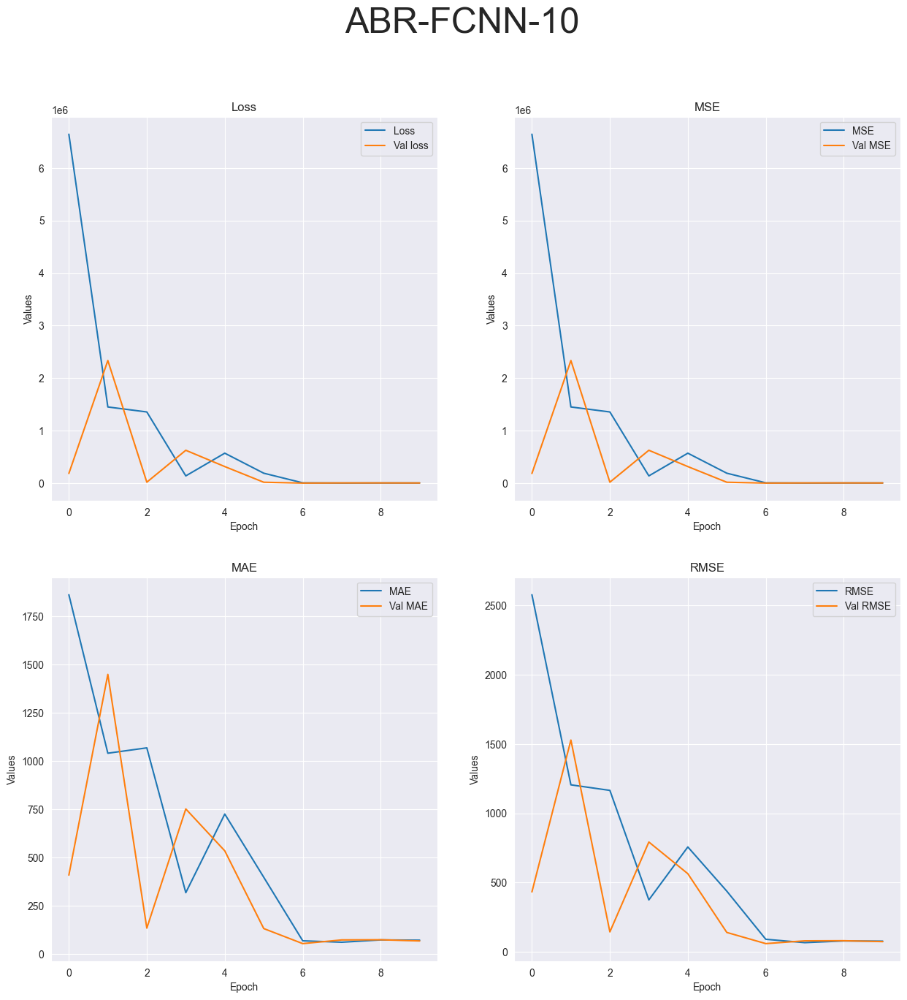

R-squared value: -7778.8296


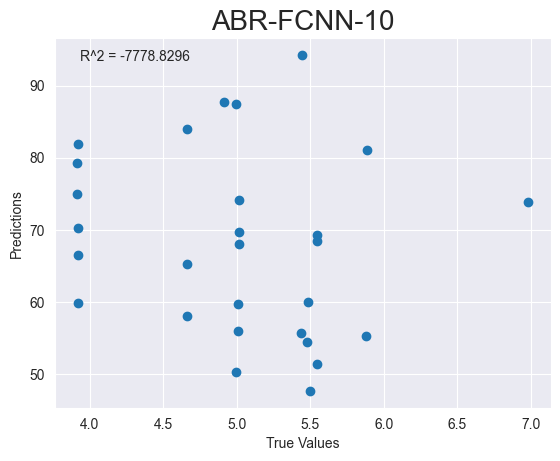

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_144"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_428 (Dense)           (None, 64)                832       
                                                                 
 dense_429 (Dense)           (None, 32)                2080      
                                                                 
 dense_430 (Dense)      

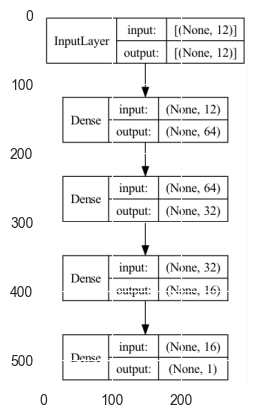

ABR-FCNN-20
Epoch 1/20


2023-05-02 10:16:10.098468: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 259ms/step - loss: 5837579.0000 - mse: 5837579.0000 - mae: 1765.1699 - root_mean_squared_error: 2416.1082 - val_loss: 205537.0000 - val_mse: 205537.0000 - val_mae: 435.3431 - val_root_mean_squared_error: 453.3619
Epoch 2/20


2023-05-02 10:16:10.921814: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 58ms/step - loss: 1408565.6250 - mse: 1408565.6250 - mae: 1032.7714 - root_mean_squared_error: 1186.8301 - val_loss: 2308353.0000 - val_mse: 2308353.0000 - val_mae: 1459.3356 - val_root_mean_squared_error: 1519.3265
Epoch 3/20
3/3 [==============================] - 0s 33ms/step - loss: 1186743.7500 - mse: 1186743.7500 - mae: 1002.6860 - root_mean_squared_error: 1089.3777 - val_loss: 18244.3809 - val_mse: 18244.3809 - val_mae: 129.0162 - val_root_mean_squared_error: 135.0718
Epoch 4/20
3/3 [==============================] - 0s 35ms/step - loss: 147982.0000 - mse: 147982.0000 - mae: 313.7894 - root_mean_squared_error: 384.6843 - val_loss: 587789.9375 - val_mse: 587789.9375 - val_mae: 737.4594 - val_root_mean_squared_error: 766.6746
Epoch 5/20
3/3 [==============================] - 0s 30ms/step - loss: 480321.1562 - mse: 480321.1562 - mae: 667.1310 - root_mean_squared_error: 693.0521 - val_loss: 277613.0000 - val_mse: 277613.0000 - val_mae: 507.03

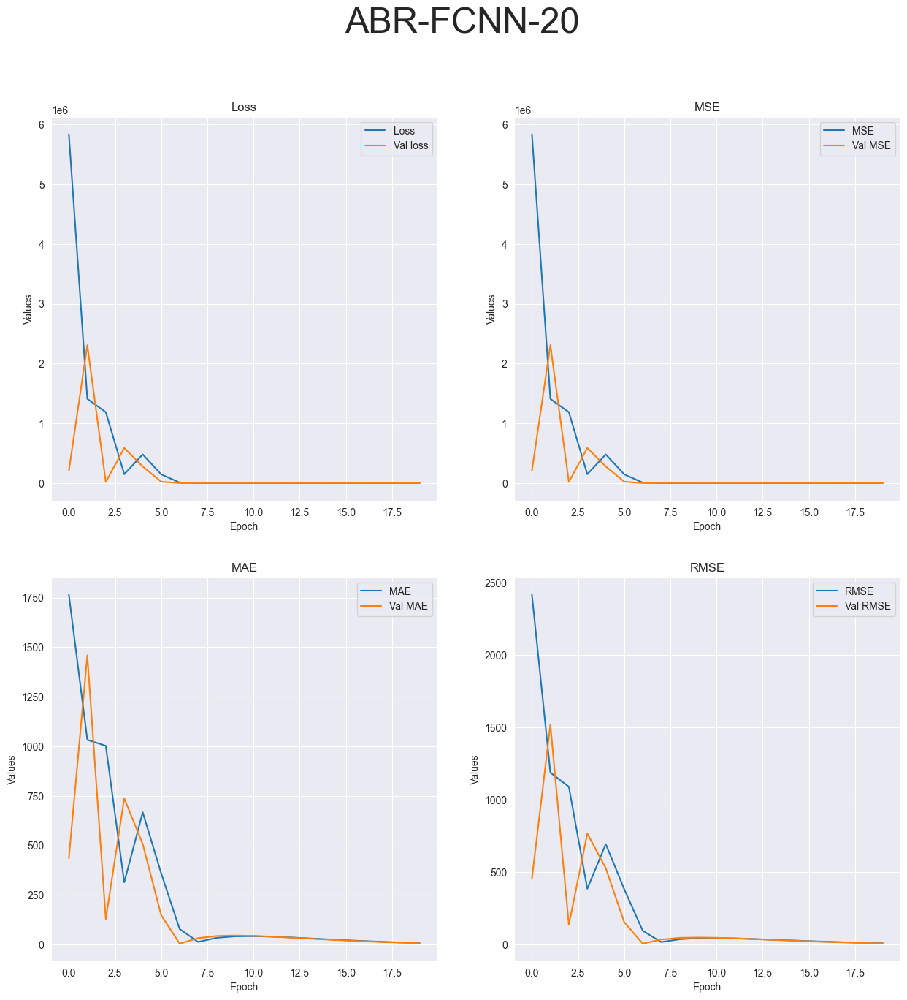

R-squared value: -137.6386


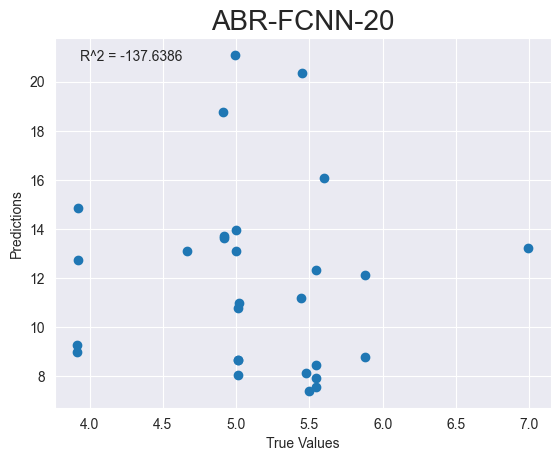

Running DeepSVM model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_145"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_432 (Dense)           (None, 128)               1664      
                                                                 
 dense_433 (Dense)           (None, 1)                 129       
                                                            

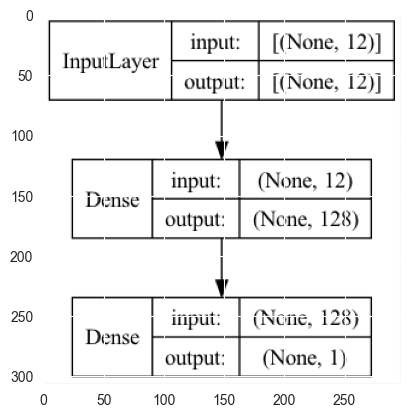

ABR-DeepSVM-1


2023-05-02 10:16:13.848714: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 238ms/step - loss: 588123776.0000 - mse: 588123776.0000 - mae: 23172.6582 - root_mean_squared_error: 24251.2637 - val_loss: 291107776.0000 - val_mse: 291107776.0000 - val_mae: 16633.5352 - val_root_mean_squared_error: 17061.8809


2023-05-02 10:16:14.681197: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 86ms/step - loss: 334054752.0000 - mse: 334054752.0000 - mae: 17336.0605 - root_mean_squared_error: 18277.1641
Test loss: [334054752.0, 334054752.0, 17336.060546875, 18277.1640625]
['loss', 'mse', 'mae', 'root_mean_squared_error']


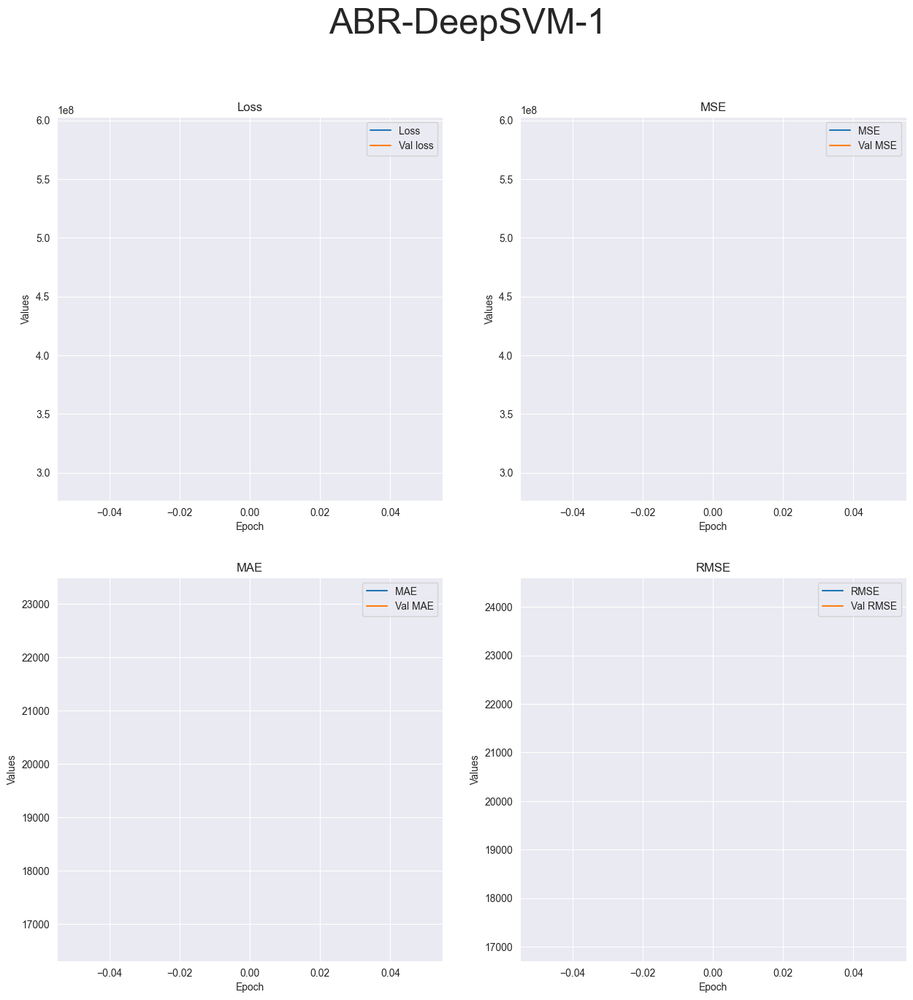

R-squared value: -940235628.6118


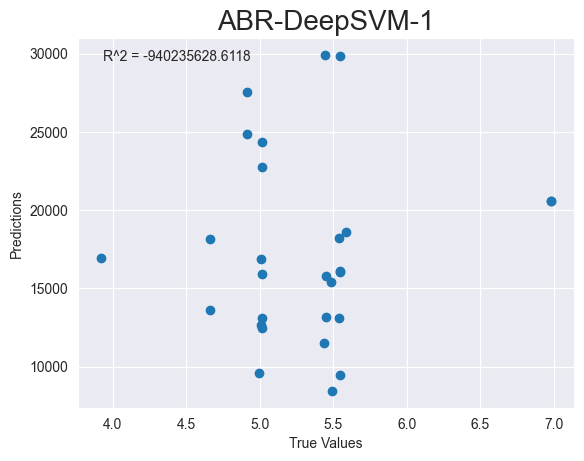

Running tests with 4 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_146"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_434 (Dense)           (None, 128)               1664      
                                                                 
 dense_435 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Train

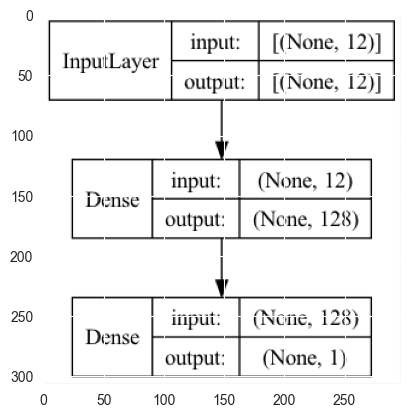

ABR-DeepSVM-4
Epoch 1/4


2023-05-02 10:16:16.288581: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 221ms/step - loss: 565566208.0000 - mse: 565566208.0000 - mae: 22883.9863 - root_mean_squared_error: 23781.6367 - val_loss: 330653824.0000 - val_mse: 330653824.0000 - val_mae: 17350.5586 - val_root_mean_squared_error: 18183.8887
Epoch 2/4


2023-05-02 10:16:16.959100: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 83ms/step - loss: 220031184.0000 - mse: 220031184.0000 - mae: 14270.5508 - root_mean_squared_error: 14833.4482 - val_loss: 123969224.0000 - val_mse: 123969224.0000 - val_mae: 10619.8984 - val_root_mean_squared_error: 11134.1465
Epoch 3/4
3/3 [==============================] - 0s 36ms/step - loss: 84642520.0000 - mse: 84642520.0000 - mae: 8759.4463 - root_mean_squared_error: 9200.1367 - val_loss: 45048204.0000 - val_mse: 45048204.0000 - val_mae: 6398.8765 - val_root_mean_squared_error: 6711.7959
Epoch 4/4
1/1 [==============================] - 0s 97ms/step - loss: 16199115.0000 - mse: 16199115.0000 - mae: 3808.3008 - root_mean_squared_error: 4024.8125
Test loss: [16199115.0, 16199115.0, 3808.30078125, 4024.8125]
['loss', 'mse', 'mae', 'root_mean_squared_error']


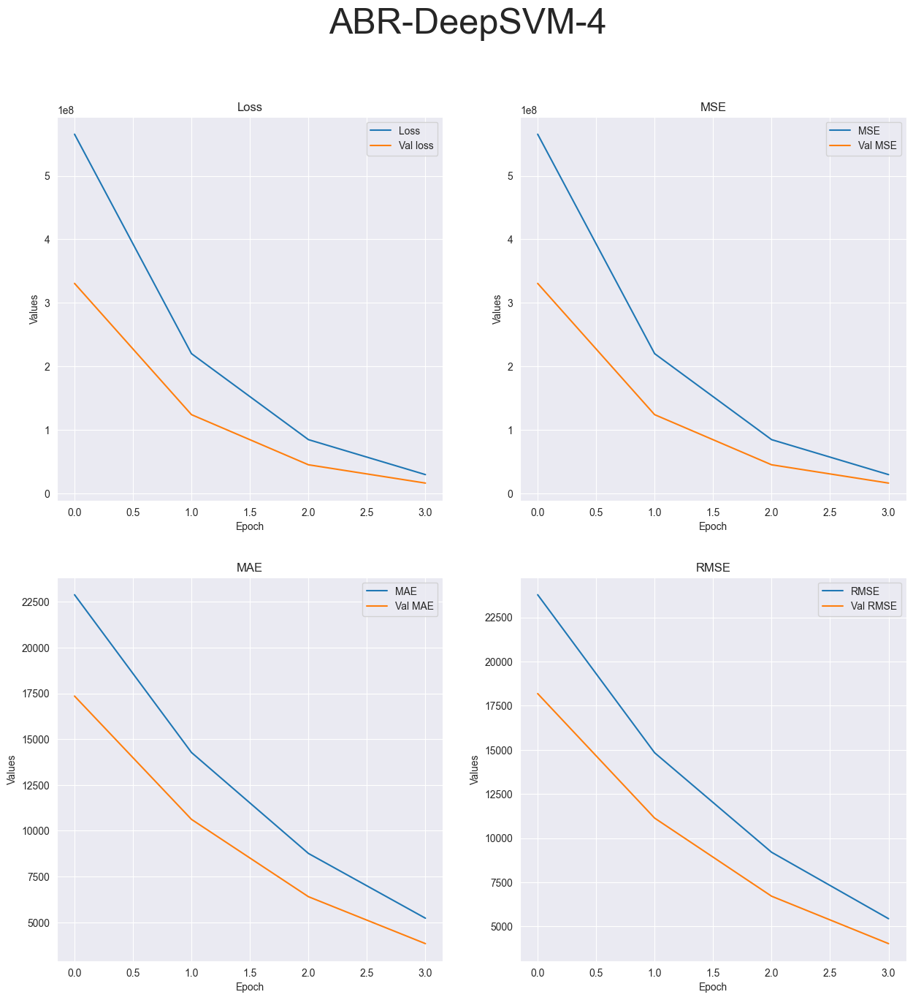

R-squared value: -64532544.1417


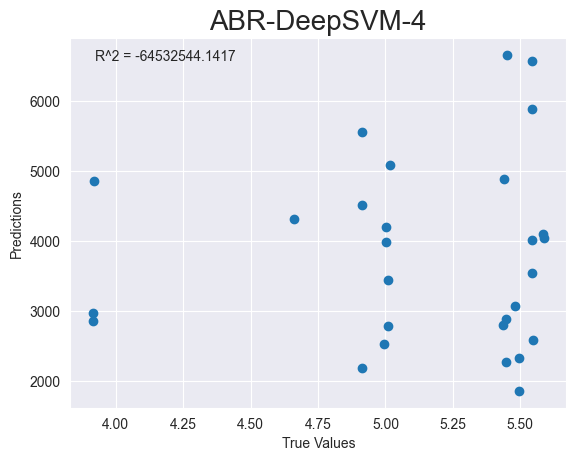

Running tests with 10 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_147"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_436 (Dense)           (None, 128)               1664      
                                                                 
 dense_437 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Trai

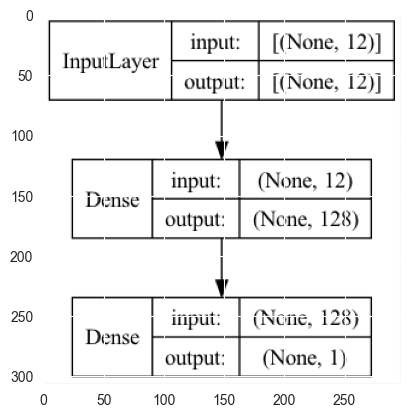

ABR-DeepSVM-10
Epoch 1/10


2023-05-02 10:16:19.820183: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 240ms/step - loss: 606229696.0000 - mse: 606229696.0000 - mae: 23572.6406 - root_mean_squared_error: 24621.7324 - val_loss: 319439680.0000 - val_mse: 319439680.0000 - val_mae: 17293.5898 - val_root_mean_squared_error: 17872.8750
Epoch 2/10


2023-05-02 10:16:20.687124: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 113ms/step - loss: 239935584.0000 - mse: 239935584.0000 - mae: 14718.5479 - root_mean_squared_error: 15489.8545 - val_loss: 118890216.0000 - val_mse: 118890216.0000 - val_mae: 10547.6865 - val_root_mean_squared_error: 10903.6787
Epoch 3/10
3/3 [==============================] - 0s 40ms/step - loss: 88417520.0000 - mse: 88417520.0000 - mae: 8945.1758 - root_mean_squared_error: 9403.0586 - val_loss: 43405496.0000 - val_mse: 43405496.0000 - val_mae: 6371.2866 - val_root_mean_squared_error: 6588.2847
Epoch 4/10
3/3 [==============================] - 0s 28ms/step - loss: 32350634.0000 - mse: 32350634.0000 - mae: 5400.4131 - root_mean_squared_error: 5687.7617 - val_loss: 15564435.0000 - val_mse: 15564435.0000 - val_mae: 3813.7805 - val_root_mean_squared_error: 3945.1787
Epoch 5/10
3/3 [==============================] - 0s 21ms/step - loss: 11737284.0000 - mse: 11737284.0000 - mae: 3223.7603 - root_mean_squared_error: 3425.9719 - val_loss: 5029107.000

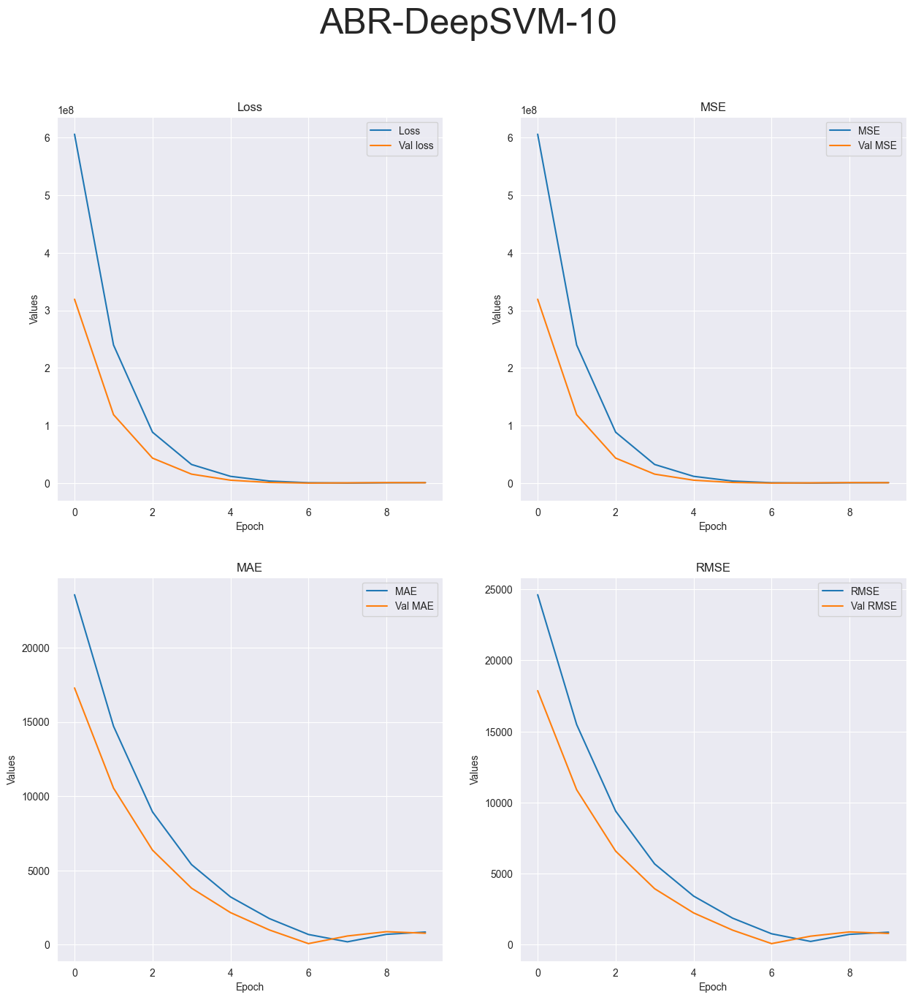

R-squared value: -1223863.1347


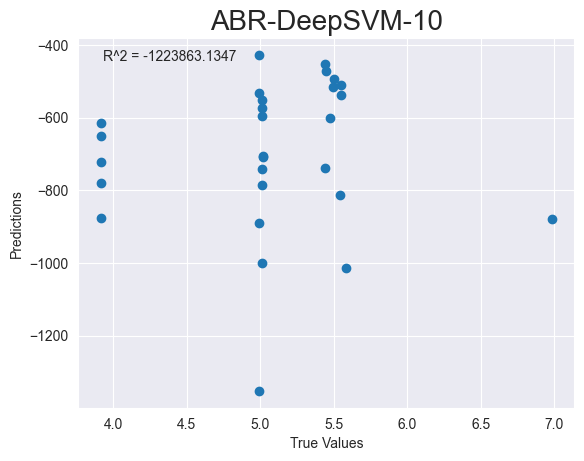

Running tests with 20 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
Model: "sequential_148"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_438 (Dense)           (None, 128)               1664      
                                                                 
 dense_439 (Dense)           (None, 1)                 129       
                                                                 
Total params: 1,793
Trai

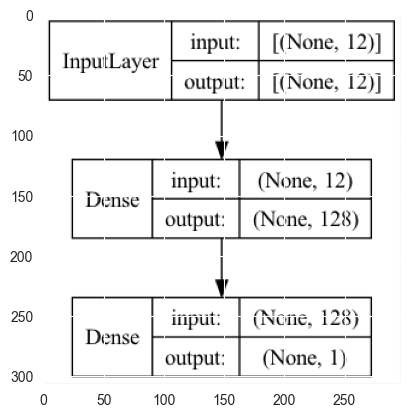

ABR-DeepSVM-20
Epoch 1/20


2023-05-02 10:16:23.328399: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 249ms/step - loss: 570789312.0000 - mse: 570789312.0000 - mae: 22938.3574 - root_mean_squared_error: 23891.1973 - val_loss: 282859648.0000 - val_mse: 282859648.0000 - val_mae: 16221.9346 - val_root_mean_squared_error: 16818.4316
Epoch 2/20


2023-05-02 10:16:24.041309: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 35ms/step - loss: 225871440.0000 - mse: 225871440.0000 - mae: 14295.2979 - root_mean_squared_error: 15029.0195 - val_loss: 105078120.0000 - val_mse: 105078120.0000 - val_mae: 9883.9043 - val_root_mean_squared_error: 10250.7617
Epoch 3/20
3/3 [==============================] - 0s 28ms/step - loss: 83318672.0000 - mse: 83318672.0000 - mae: 8695.4678 - root_mean_squared_error: 9127.9062 - val_loss: 38262752.0000 - val_mse: 38262752.0000 - val_mae: 5961.8721 - val_root_mean_squared_error: 6185.6895
Epoch 4/20
3/3 [==============================] - 0s 34ms/step - loss: 30236848.0000 - mse: 30236848.0000 - mae: 5234.1509 - root_mean_squared_error: 5498.8042 - val_loss: 13698020.0000 - val_mse: 13698020.0000 - val_mae: 3565.2954 - val_root_mean_squared_error: 3701.0837
Epoch 5/20
3/3 [==============================] - 0s 25ms/step - loss: 10682936.0000 - mse: 10682936.0000 - mae: 3106.0552 - root_mean_squared_error: 3268.4761 - val_loss: 4403153.0000 

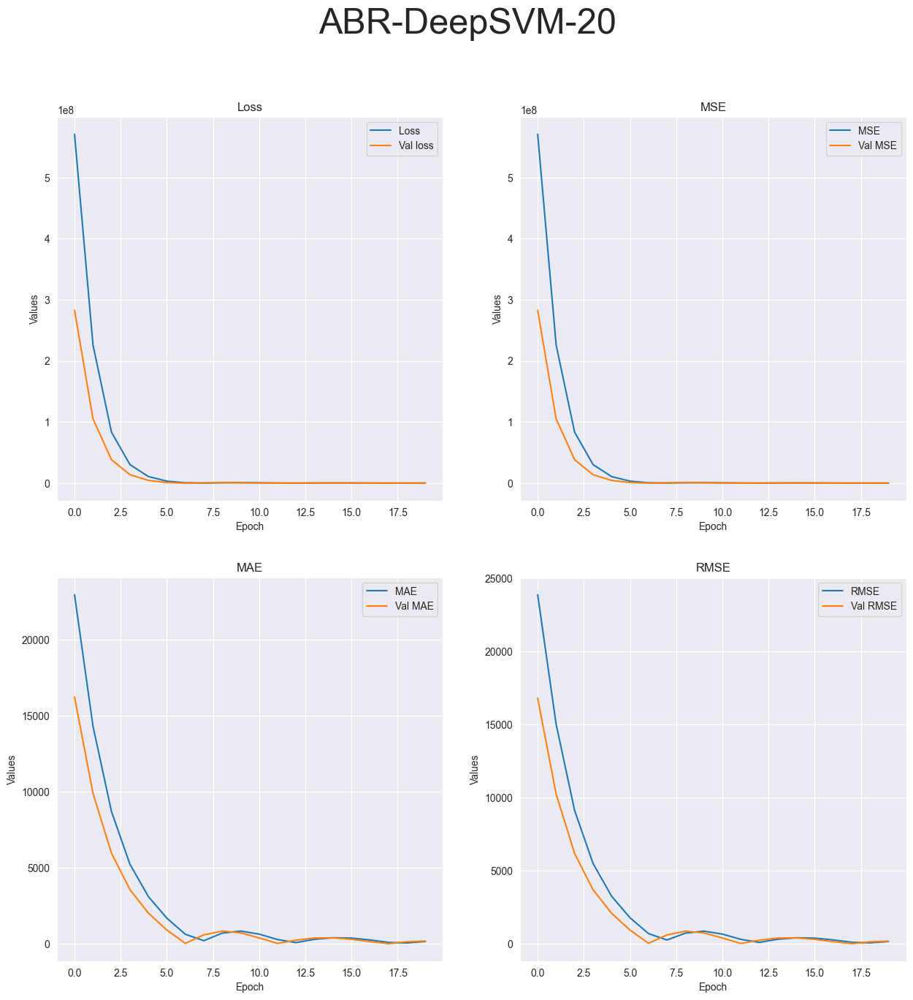

R-squared value: -88383.9283


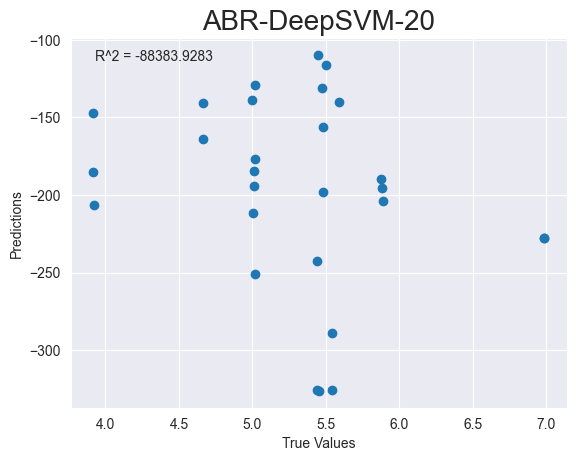

Running MachineLearning tests...
Running tests on CGBR.csv dataset...
Running Linear model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
CGBR-Linear-1
Running SVR model tests...
Running tests with 1 epochs...
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
CGBR-SVR
plotting linear


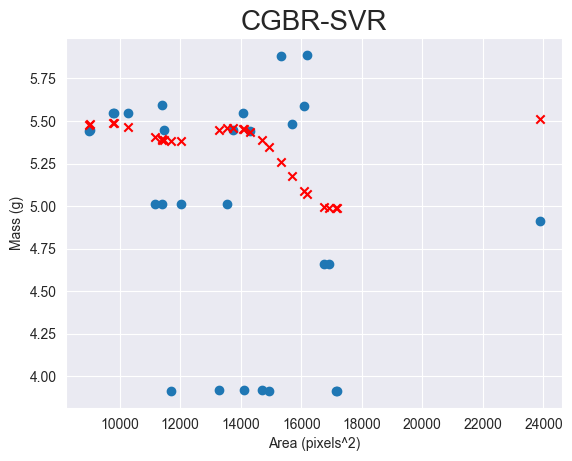

R-squared value: -0.2219


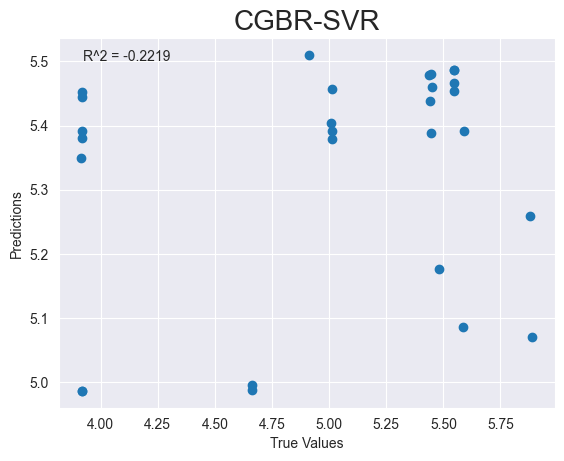

Running Images tests...
Running tests on CIBR.pkl dataset...
Running CNN model tests...
Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_149"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 69, 69, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_13 (Conv2D)          (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_13 (MaxPoolin  (None, 33, 33,

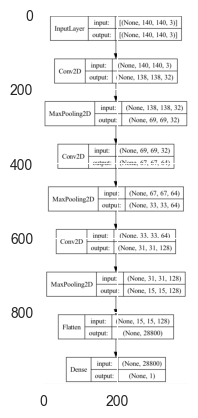

CIBR-CNN-2
Epoch 1/2


2023-05-02 10:16:28.857767: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2880.9048 - mse: 2880.9048 - mae: 32.5872 - root_mean_squared_error: 53.6741

2023-05-02 10:16:30.953547: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 714ms/step - loss: 2880.9048 - mse: 2880.9048 - mae: 32.5872 - root_mean_squared_error: 53.6741 - val_loss: 26.3567 - val_mse: 26.3567 - val_mae: 5.0999 - val_root_mean_squared_error: 5.1339
Epoch 2/2
1/1 [==============================] - 2s 2s/step - loss: 2.2656 - mse: 2.2656 - mae: 1.3285 - root_mean_squared_error: 1.5052
Test loss: [2.2655551433563232, 2.2655551433563232, 1.328501582145691, 1.505176067352295]
['loss', 'mse', 'mae', 'root_mean_squared_error']


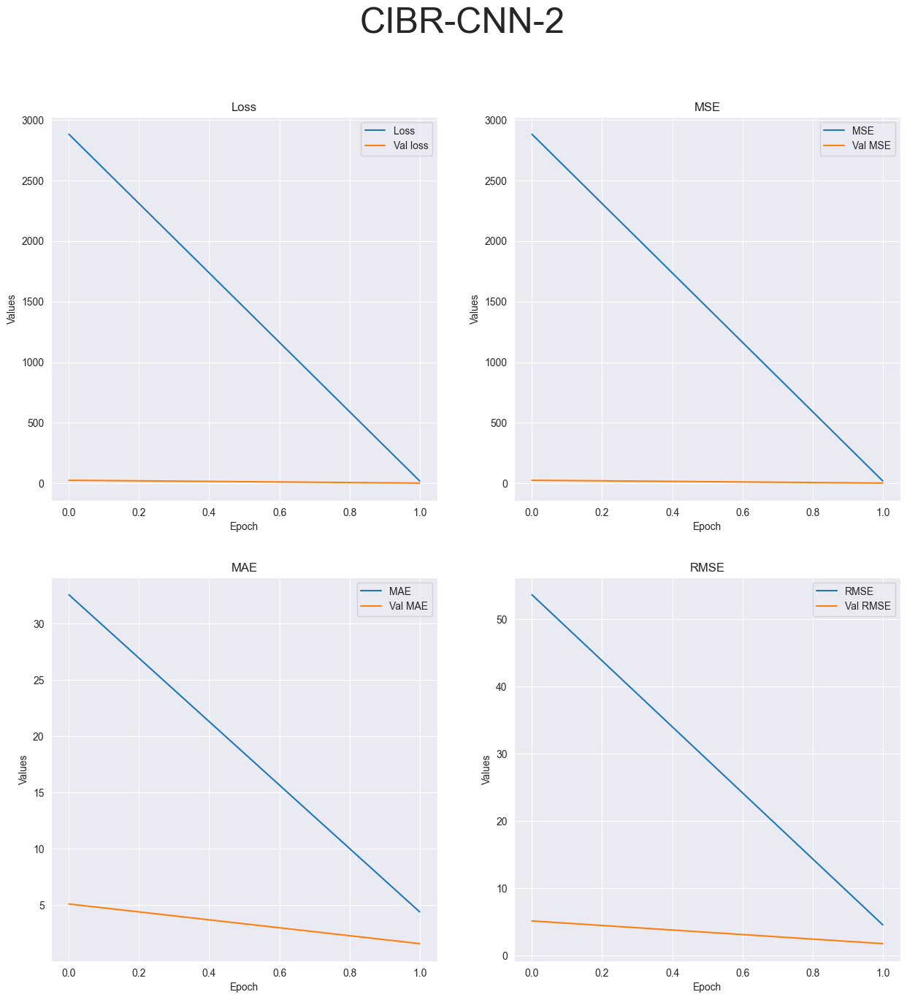

R-squared value: -3.4812


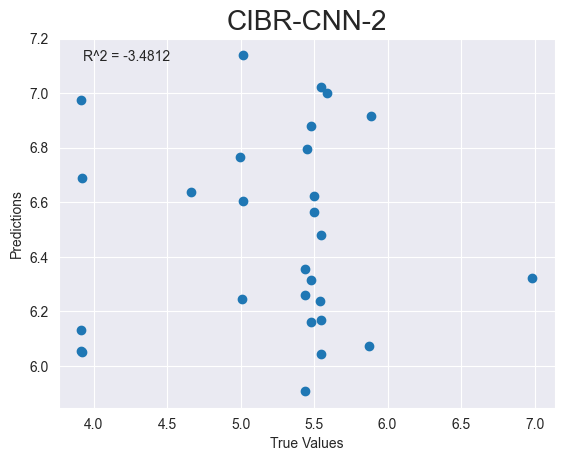

Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_150"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_15 (Conv2D)          (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_15 (MaxPoolin  (None, 69, 69, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_16 (Conv2D)          (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_16 (MaxPoolin  (None, 33, 33, 64)       0         
 g2D)                                                            


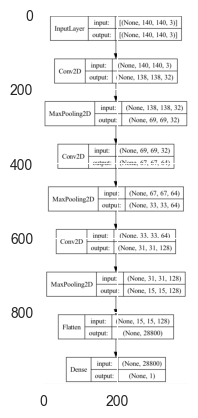

CIBR-CNN-2
Epoch 1/2


2023-05-02 10:16:37.447853: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2804.2085 - mse: 2804.2085 - mae: 31.9640 - root_mean_squared_error: 52.9548

2023-05-02 10:16:40.289807: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 4s 1s/step - loss: 2804.2085 - mse: 2804.2085 - mae: 31.9640 - root_mean_squared_error: 52.9548 - val_loss: 32.1273 - val_mse: 32.1273 - val_mae: 5.6418 - val_root_mean_squared_error: 5.6681
Epoch 2/2
1/1 [==============================] - 0s 226ms/step - loss: 9.7261 - mse: 9.7261 - mae: 3.0519 - root_mean_squared_error: 3.1187
Test loss: [9.726109504699707, 9.726109504699707, 3.051875352859497, 3.118671178817749]
['loss', 'mse', 'mae', 'root_mean_squared_error']


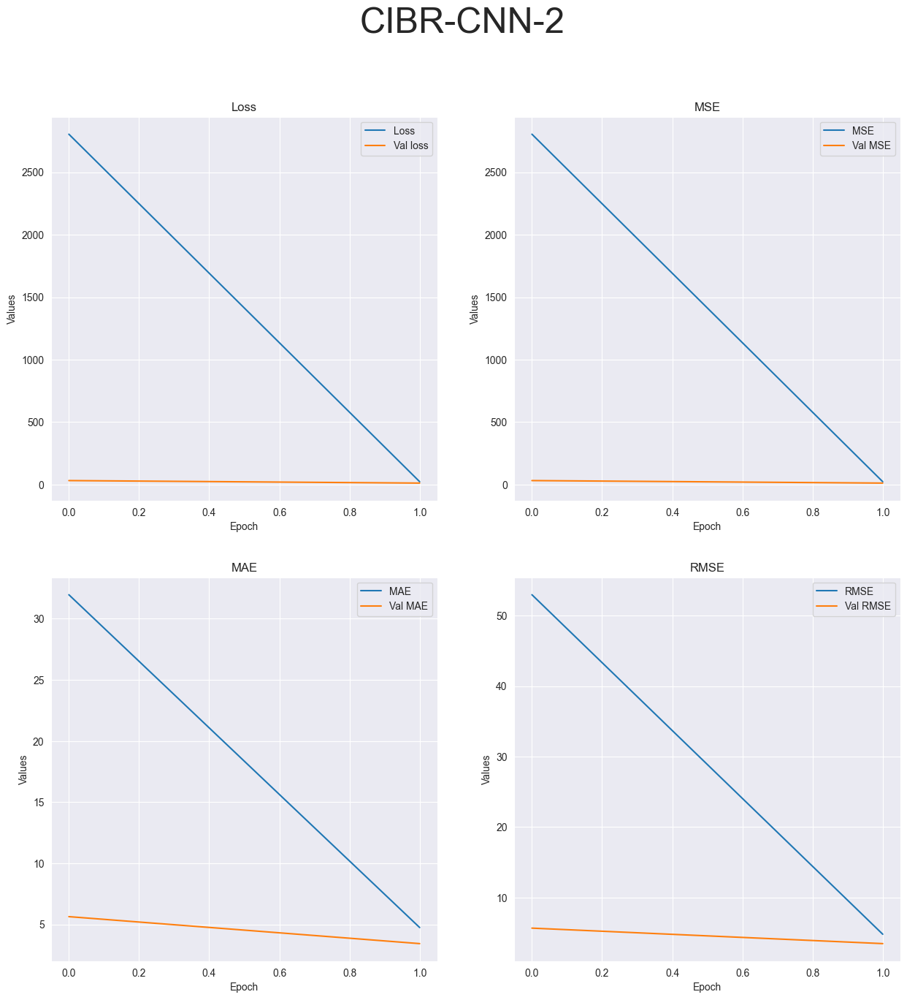

R-squared value: -19.9187


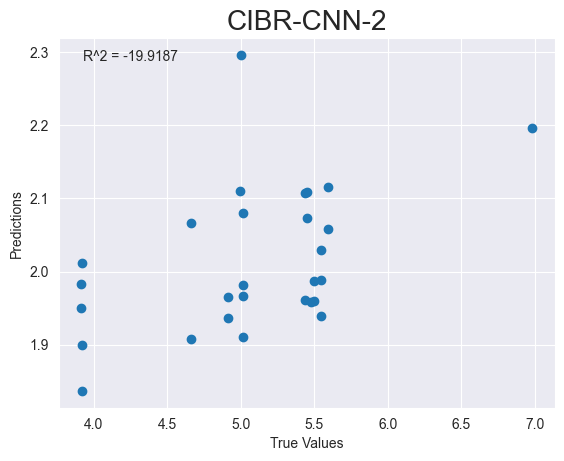

Running tests with 1 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_151"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_18 (MaxPoolin  (None, 69, 69, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_19 (Conv2D)          (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_19 (MaxPoolin  (None, 33, 33, 64)       0         
 g2D)                                                            


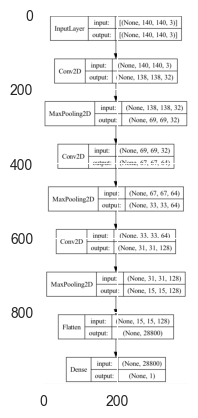

CIBR-CNN-1


2023-05-02 10:16:44.331028: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2888.8225 - mse: 2888.8225 - mae: 32.5586 - root_mean_squared_error: 53.7478

2023-05-02 10:16:45.589908: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 228ms/step - loss: 32.2065 - mse: 32.2065 - mae: 5.6447 - root_mean_squared_error: 5.6751
Test loss: [32.206459045410156, 32.206459045410156, 5.644664287567139, 5.675073623657227]
['loss', 'mse', 'mae', 'root_mean_squared_error']


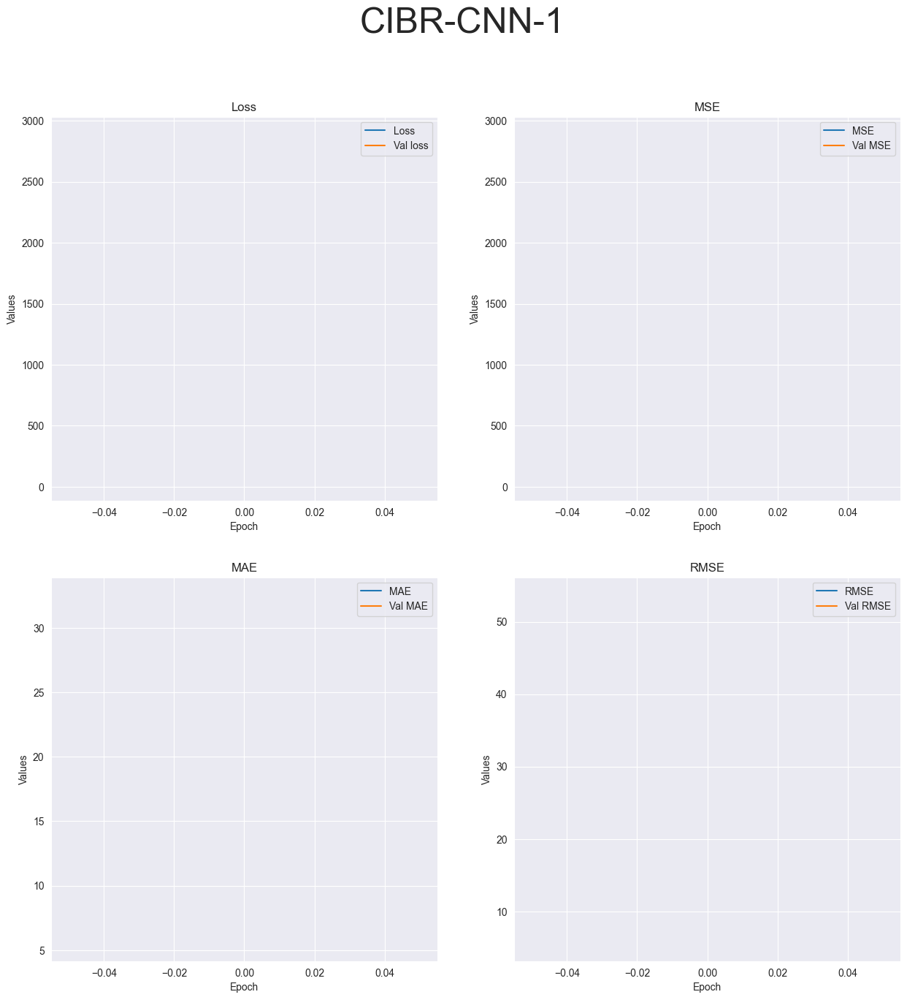

R-squared value: -98.8921


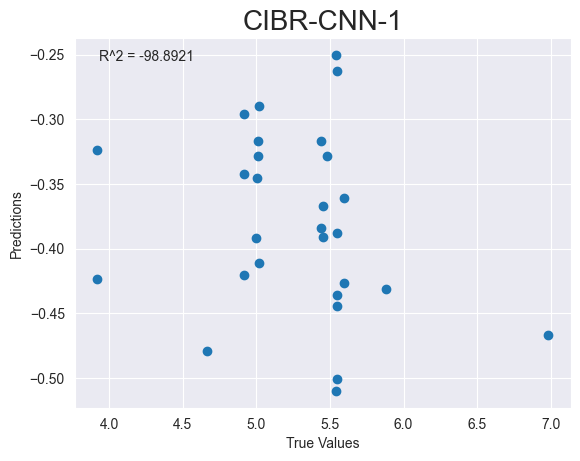

Running tests with 4 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
entrando
Model: "sequential_152"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_21 (Conv2D)          (None, 138, 138, 32)      896       
                                                                 
 max_pooling2d_21 (MaxPoolin  (None, 69, 69, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_22 (Conv2D)          (None, 67, 67, 64)        18496     
                                                                 
 max_pooling2d_22 (MaxPoolin  (None, 33, 33, 64)       0         
 g2D)                                                            


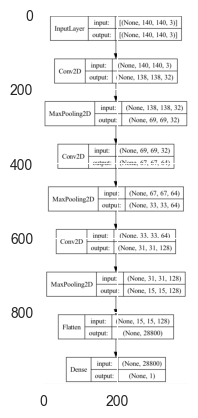

CIBR-CNN-4
Epoch 1/4


2023-05-02 10:16:48.829951: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 1876.6498 - mse: 1876.6498 - mae: 28.7492 - root_mean_squared_error: 43.3203

2023-05-02 10:16:49.971937: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 394ms/step - loss: 1876.6498 - mse: 1876.6498 - mae: 28.7492 - root_mean_squared_error: 43.3203 - val_loss: 32.6012 - val_mse: 32.6012 - val_mae: 5.6549 - val_root_mean_squared_error: 5.7097
Epoch 2/4
3/3 [==============================] - 0s 136ms/step - loss: 28.2030 - mse: 28.2030 - mae: 5.2608 - root_mean_squared_error: 5.3106 - val_loss: 16.5220 - val_mse: 16.5220 - val_mae: 4.0171 - val_root_mean_squared_error: 4.0647
Epoch 3/4
3/3 [==============================] - 0s 99ms/step - loss: 8.6688 - mse: 8.6688 - mae: 2.5160 - root_mean_squared_error: 2.9443 - val_loss: 11.6433 - val_mse: 11.6433 - val_mae: 3.3587 - val_root_mean_squared_error: 3.4122
Epoch 4/4
1/1 [==============================] - 0s 178ms/step - loss: 1.3824 - mse: 1.3824 - mae: 0.9653 - root_mean_squared_error: 1.1757
Test loss: [1.3823765516281128, 1.3823765516281128, 0.9653481245040894, 1.1757451295852661]
['loss', 'mse', 'mae', 'root_mean_squared_error']


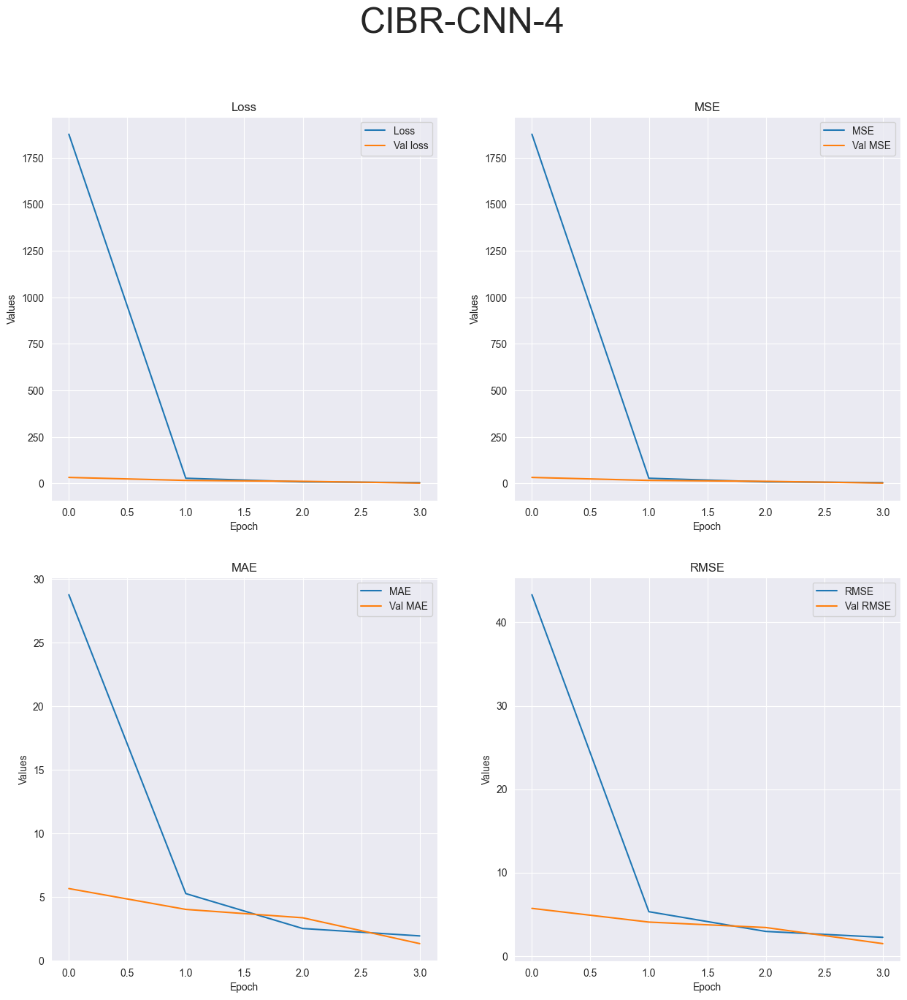

R-squared value: -1.8824


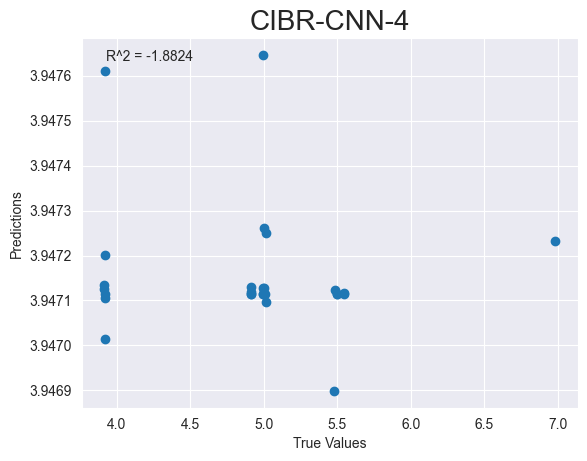

Running RestNet model tests...
Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
CIBR-RestNet-2
Running tests with 2 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
CIBR-RestNet-2
Running tests with 1 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86, 70], [78, 81, 65], [66, 69, 53], [6...
CIBR-RestNet-1
Running tests with 4 epochs...
   ID  AverageMass                                                img
0  21       6.9924  [[[225, 230, 209], [223, 228, 207], [220, 225,...
1  22       6.9847  [[[83, 86,

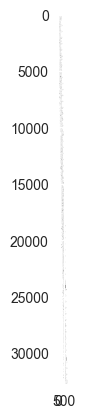

CIBR-DenseNet-2


ValueError: Failed to convert a NumPy array to a Tensor (Unsupported object type numpy.ndarray).

In [56]:
for experiment_name, experiment_data in RawExperiments.items():
    print(f"Running experiments for {experiment_name}...")
    for test_name, test_data in experiment_data["Tests"].items():
        print(f"Running {test_name} tests...")
        for dataset in test_data["Datasets"]:
            print(f"Running tests on {dataset + test_data['Extention']} dataset...")
            for model in test_data["Models"]:
                print(f"Running {model} model tests...")
                if "Epochs" in test_data:
                    for epochs in test_data["Epochs"]:
                        print(f"Running tests with {epochs} epochs...")

                        # Call the function that runs the test with the given dataset, model, and epoch

                        dataframe = None
                        if(test_data["Extention"] == '.pkl'):
                            dataframe = pd.read_pickle(dataset + test_data['Extention'])
                        else:
                            dataframe = pd.read_csv(dataset + test_data['Extention'])
                        test = AutomaticLearning(dataframe, dataset + "-" + model, model)
                        test.buildData()
                        test.buildModel()
                        test.train(epochs)
                        test.plot(experiment_name +'-'+)


In [42]:
import os
import pandas as pd



# Define the function for running a single experiment


def run_experiment(berry_type, experiment_name, dataset_name, data_ext, test_name, model_name, epoch):
    print(f"Running experiment {experiment_name}, dataset {dataset_name}, test {test_name}, model {model_name}, epoch {epoch}")

    print(dataset_name)
 
    print("EXTENTION",data_ext)
    dataframe = None
    if(data_ext == '.pkl'):
        dataframe = pd.read_pickle(dataset_name + data_ext)
    else:
        dataframe = pd.read_csv(dataset_name + data_ext)
    test = AutomaticLearning(dataframe, dataset_name + "-" + model_name, model_name)
    print("no ha tronado")
    test.buildData()
    test.buildModel()
    test.train(epoch)
    test.plot(berry_type + '-' + experiment_name, save = True, show = False)
    result = test.gather_data()
    return result


def run_all_experiments(experiments, save_path, results_dict):
    for experiment_name, experiment in experiments.items():
        print(f"Running experiment: {experiment_name}")
        for berry_type, berry_experiment in experiment.items():
            print(f"Berry Type: {berry_type}")
            for test_name, test in berry_experiment['Tests'].items():
                print(f"Test Name: {test_name}")
                for dataset_name in test['Datasets']:
                    #data_ext = test["Extention"]
                    #data_path = os.path.join('data', berry_type, dataset_name + data_ext)
                    print(f"Dataset Name: {dataset_name}")
                    for model_name in test['Models']:
                        print(f"Model Name: {model_name}")
                        for epoch in test['Epochs']:
                            print(f"Epoch: {epoch}")
                            # Run the experiment
                            #folder = "./{berry_type}-{experiment_name}"
                            result = run_experiment(berry_type, experiment_name, dataset_name, test['Extention'], test_name, model_name, epoch)
                            # Store the result
                            if experiment_name not in results_dict:
                                results_dict[experiment_name] = {}
                            if test_name not in results_dict[experiment_name]:
                                results_dict[experiment_name][test_name] = {}
                            if dataset_name not in results_dict[experiment_name][test_name]:
                                results_dict[experiment_name][test_name][dataset_name] = {}
                            if model_name not in results_dict[experiment_name][test_name][dataset_name]:
                                results_dict[experiment_name][test_name][dataset_name][model_name] = {}
                            if epoch not in results_dict[experiment_name][test_name][dataset_name][model_name]:
                                results_dict[experiment_name][test_name][dataset_name][model_name][epoch] = {}
                            results_dict[experiment_name][test_name][dataset_name][model_name][epoch] = result
    return results_dict

    # Save the results





In [71]:
results_machinelearning = run_all_experiments(experimentsMachineLearning, "./", {})
with open("resultsMachineLearning.json", 'w') as f:
    json.dump(results_machinelearning, f)

Running experiment: Raw
Berry Type: Blueberries
Test Name: MachineLearning
Dataset Name: CGBR
Model Name: linear
Epoch: 1
Running experiment Raw, dataset CGBR, test MachineLearning, model linear, epoch 1
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21      10.2444              17784.0     0.7531
1  22      10.2427              17844.0     0.7737
no ha tronado
CGBR-linear
linear [ 9.78967185  8.58050856 10.31629222 10.73621898  8.72412388  8.78593769
 10.29343591  8.81730728 11.0771203  10.34470066 10.55651475 10.95571353
 11.03612701 11.46577002  9.78430478  9.59608728  8.95823907 10.2570694
  9.08038612  9.38695672  8.41357425  8.87264359  8.88152702  9.83751278
 11.27431377  9.77366318 10.08051139 10.70836575]
plotting linear
R-squared value: 0.9926
Model Name: SVR
Epoch: 1
Running experiment Raw, dataset CGBR, test MachineLearning, model SVR, epoch 1
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21      10.2444              17

<Figure size 640x480 with 0 Axes>

In [89]:

results_deeplearning = run_all_experiments(experimentsDeepLearning, "./", {})
with open("resultsDeepLearning.json", 'w') as f:
    json.dump(results_deeplearning, f)

Running experiment: Raw
Berry Type: Blueberries
Test Name: DeepLearning
Dataset Name: CGBR
Model Name: MLP
Epoch: 100
Running experiment Raw, dataset CGBR, test DeepLearning, model MLP, epoch 100
CGBR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21      10.2444              17784.0     0.7531
1  22      10.2427              17844.0     0.7737
no ha tronado
CGBR-MLP-100
Epoch 1/100


2023-05-02 21:17:21.800892: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 270ms/step - loss: 2597233.0000 - mse: 2597233.0000 - mae: 1310.0732 - root_mean_squared_error: 1611.5933 - val_loss: 45891.7734 - val_mse: 45891.7734 - val_mae: 208.1526 - val_root_mean_squared_error: 214.2236
Epoch 2/100
1/3 [=========>....................] - ETA: 0s - loss: 634367.5000 - mse: 634367.5000 - mae: 631.7609 - root_mean_squared_error: 796.4719

2023-05-02 21:17:22.787272: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 79ms/step - loss: 678390.8125 - mse: 678390.8125 - mae: 637.6760 - root_mean_squared_error: 823.6448 - val_loss: 298351.5625 - val_mse: 298351.5625 - val_mae: 530.0999 - val_root_mean_squared_error: 546.2157
Epoch 3/100
3/3 [==============================] - 0s 49ms/step - loss: 338820.4375 - mse: 338820.4375 - mae: 456.3309 - root_mean_squared_error: 582.0828 - val_loss: 22807.6797 - val_mse: 22807.6797 - val_mae: 146.0162 - val_root_mean_squared_error: 151.0221
Epoch 4/100
3/3 [==============================] - 0s 29ms/step - loss: 184614.2656 - mse: 184614.2656 - mae: 334.1948 - root_mean_squared_error: 429.6676 - val_loss: 62130.5664 - val_mse: 62130.5664 - val_mae: 241.2820 - val_root_mean_squared_error: 249.2600
Epoch 5/100
3/3 [==============================] - 0s 30ms/step - loss: 122196.8516 - mse: 122196.8516 - mae: 271.2467 - root_mean_squared_error: 349.5667 - val_loss: 36297.6562 - val_mse: 36297.6562 - val_mae: 184.3179 - val_root

2023-05-02 21:17:32.879857: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 343ms/step - loss: 2400892.0000 - mse: 2400892.0000 - mae: 1241.4829 - root_mean_squared_error: 1549.4812 - val_loss: 166856.7031 - val_mse: 166856.7031 - val_mae: 397.5778 - val_root_mean_squared_error: 408.4810
Epoch 2/500


2023-05-02 21:17:34.041587: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 50ms/step - loss: 441384.0000 - mse: 441384.0000 - mae: 526.2634 - root_mean_squared_error: 664.3674 - val_loss: 104978.7734 - val_mse: 104978.7734 - val_mae: 315.4366 - val_root_mean_squared_error: 324.0043
Epoch 3/500
3/3 [==============================] - 0s 46ms/step - loss: 227395.3281 - mse: 227395.3281 - mae: 390.2565 - root_mean_squared_error: 476.8599 - val_loss: 8674.0391 - val_mse: 8674.0391 - val_mae: 90.1536 - val_root_mean_squared_error: 93.1345
Epoch 4/500
3/3 [==============================] - 0s 36ms/step - loss: 104964.7188 - mse: 104964.7188 - mae: 248.7641 - root_mean_squared_error: 323.9826 - val_loss: 12081.6113 - val_mse: 12081.6113 - val_mae: 106.4741 - val_root_mean_squared_error: 109.9164
Epoch 5/500
3/3 [==============================] - 0s 35ms/step - loss: 69753.7500 - mse: 69753.7500 - mae: 191.0717 - root_mean_squared_error: 264.1093 - val_loss: 11385.0205 - val_mse: 11385.0205 - val_mae: 103.3469 - val_root_mean_

2023-05-02 21:17:53.884960: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 266ms/step - loss: 6524355.0000 - mse: 6524355.0000 - mae: 1907.8590 - root_mean_squared_error: 2554.2817 - val_loss: 190372.4844 - val_mse: 190372.4844 - val_mae: 416.3241 - val_root_mean_squared_error: 436.3170
Epoch 2/100


2023-05-02 21:17:54.757095: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 46ms/step - loss: 1681245.1250 - mse: 1681245.1250 - mae: 1128.5472 - root_mean_squared_error: 1296.6284 - val_loss: 2387164.7500 - val_mse: 2387164.7500 - val_mae: 1475.8330 - val_root_mean_squared_error: 1545.0452
Epoch 3/100
3/3 [==============================] - 0s 44ms/step - loss: 1654713.5000 - mse: 1654713.5000 - mae: 1197.9286 - root_mean_squared_error: 1286.3567 - val_loss: 162659.7188 - val_mse: 162659.7188 - val_mae: 384.7836 - val_root_mean_squared_error: 403.3109
Epoch 4/100
3/3 [==============================] - 0s 42ms/step - loss: 78807.6641 - mse: 78807.6641 - mae: 223.4364 - root_mean_squared_error: 280.7270 - val_loss: 94985.4141 - val_mse: 94985.4141 - val_mae: 295.1248 - val_root_mean_squared_error: 308.1971
Epoch 5/100
3/3 [==============================] - 0s 30ms/step - loss: 172346.1875 - mse: 172346.1875 - mae: 394.4763 - root_mean_squared_error: 415.1460 - val_loss: 249028.7031 - val_mse: 249028.7031 - val_mae: 477.4

2023-05-02 21:18:06.526632: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 207ms/step - loss: 8030921.5000 - mse: 8030921.5000 - mae: 2057.2246 - root_mean_squared_error: 2833.8879 - val_loss: 184639.5938 - val_mse: 184639.5938 - val_mae: 409.6643 - val_root_mean_squared_error: 429.6971
Epoch 2/500
1/3 [=========>....................] - ETA: 0s - loss: 180798.4062 - mse: 180798.4062 - mae: 410.4441 - root_mean_squared_error: 425.2039

2023-05-02 21:18:07.502190: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 67ms/step - loss: 1865195.1250 - mse: 1865195.1250 - mae: 1162.2086 - root_mean_squared_error: 1365.7214 - val_loss: 2914803.7500 - val_mse: 2914803.7500 - val_mae: 1629.5333 - val_root_mean_squared_error: 1707.2797
Epoch 3/500
3/3 [==============================] - 0s 31ms/step - loss: 1942085.8750 - mse: 1942085.8750 - mae: 1328.4236 - root_mean_squared_error: 1393.5874 - val_loss: 365527.4062 - val_mse: 365527.4062 - val_mae: 576.6561 - val_root_mean_squared_error: 604.5886
Epoch 4/500
3/3 [==============================] - 0s 60ms/step - loss: 169391.5938 - mse: 169391.5938 - mae: 308.1100 - root_mean_squared_error: 411.5721 - val_loss: 35926.6758 - val_mse: 35926.6758 - val_mae: 181.5860 - val_root_mean_squared_error: 189.5433
Epoch 5/500
3/3 [==============================] - 0s 19ms/step - loss: 100930.0938 - mse: 100930.0938 - mae: 292.9499 - root_mean_squared_error: 317.6950 - val_loss: 213449.6094 - val_mse: 213449.6094 - val_mae: 441

2023-05-02 21:18:43.114546: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 185ms/step - loss: 686855680.0000 - mse: 686855680.0000 - mae: 25164.3770 - root_mean_squared_error: 26207.9316 - val_loss: 310847744.0000 - val_mse: 310847744.0000 - val_mae: 16749.8887 - val_root_mean_squared_error: 17630.8750
Epoch 2/100
1/3 [=========>....................] - ETA: 0s - loss: 425977472.0000 - mse: 425977472.0000 - mae: 20067.8906 - root_mean_squared_error: 20639.2227

2023-05-02 21:18:43.857429: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 62ms/step - loss: 283324800.0000 - mse: 283324800.0000 - mae: 16043.0586 - root_mean_squared_error: 16832.2539 - val_loss: 120381240.0000 - val_mse: 120381240.0000 - val_mae: 10423.2871 - val_root_mean_squared_error: 10971.8389
Epoch 3/100
3/3 [==============================] - 0s 25ms/step - loss: 107524760.0000 - mse: 107524760.0000 - mae: 9939.3184 - root_mean_squared_error: 10369.4150 - val_loss: 47218432.0000 - val_mse: 47218432.0000 - val_mae: 6527.7241 - val_root_mean_squared_error: 6871.5669
Epoch 4/100
3/3 [==============================] - 0s 29ms/step - loss: 41730784.0000 - mse: 41730784.0000 - mae: 6240.9121 - root_mean_squared_error: 6459.9370 - val_loss: 19782878.0000 - val_mse: 19782878.0000 - val_mae: 4224.9702 - val_root_mean_squared_error: 4447.7949
Epoch 5/100
3/3 [==============================] - 0s 20ms/step - loss: 18222770.0000 - mse: 18222770.0000 - mae: 4106.0322 - root_mean_squared_error: 4268.8135 - val_loss: 921512

2023-05-02 21:18:54.190903: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 238ms/step - loss: 671840640.0000 - mse: 671840640.0000 - mae: 24905.1211 - root_mean_squared_error: 25919.8887 - val_loss: 282132576.0000 - val_mse: 282132576.0000 - val_mae: 16221.5186 - val_root_mean_squared_error: 16796.8027
Epoch 2/500
1/3 [=========>....................] - ETA: 0s - loss: 365621600.0000 - mse: 365621600.0000 - mae: 18432.2949 - root_mean_squared_error: 19121.2344

2023-05-02 21:18:54.843544: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 63ms/step - loss: 271488000.0000 - mse: 271488000.0000 - mae: 15718.5420 - root_mean_squared_error: 16476.8926 - val_loss: 107600944.0000 - val_mse: 107600944.0000 - val_mae: 10017.5967 - val_root_mean_squared_error: 10373.0879
Epoch 3/500
3/3 [==============================] - 0s 22ms/step - loss: 103150952.0000 - mse: 103150952.0000 - mae: 9692.5928 - root_mean_squared_error: 10156.3262 - val_loss: 41279220.0000 - val_mse: 41279220.0000 - val_mae: 6204.4985 - val_root_mean_squared_error: 6424.8906
Epoch 4/500
3/3 [==============================] - 0s 35ms/step - loss: 39359728.0000 - mse: 39359728.0000 - mae: 6033.7017 - root_mean_squared_error: 6273.7334 - val_loss: 16991994.0000 - val_mse: 16991994.0000 - val_mae: 3980.5461 - val_root_mean_squared_error: 4122.1348
Epoch 5/500
3/3 [==============================] - 0s 18ms/step - loss: 17250822.0000 - mse: 17250822.0000 - mae: 3951.7773 - root_mean_squared_error: 4153.4106 - val_loss: 783606

2023-05-02 21:19:15.689307: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 258ms/step - loss: 20.3714 - mse: 20.3714 - mae: 3.6005 - root_mean_squared_error: 4.5135 - val_loss: 13.2527 - val_mse: 13.2527 - val_mae: 3.1253 - val_root_mean_squared_error: 3.6404
Epoch 2/100
1/3 [=========>....................] - ETA: 0s - loss: 19.7353 - mse: 19.7353 - mae: 3.7420 - root_mean_squared_error: 4.4424

2023-05-02 21:19:16.685382: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 70ms/step - loss: 18.0723 - mse: 18.0723 - mae: 3.3499 - root_mean_squared_error: 4.2512 - val_loss: 6.4143 - val_mse: 6.4143 - val_mae: 1.8144 - val_root_mean_squared_error: 2.5326
Epoch 3/100
3/3 [==============================] - 0s 61ms/step - loss: 5.5829 - mse: 5.5829 - mae: 1.8756 - root_mean_squared_error: 2.3628 - val_loss: 1.9010 - val_mse: 1.9010 - val_mae: 1.0647 - val_root_mean_squared_error: 1.3788
Epoch 4/100
3/3 [==============================] - 0s 105ms/step - loss: 4.0305 - mse: 4.0305 - mae: 1.5843 - root_mean_squared_error: 2.0076 - val_loss: 2.0002 - val_mse: 2.0002 - val_mae: 0.9842 - val_root_mean_squared_error: 1.4143
Epoch 5/100
3/3 [==============================] - 0s 67ms/step - loss: 3.3684 - mse: 3.3684 - mae: 1.4991 - root_mean_squared_error: 1.8353 - val_loss: 1.5489 - val_mse: 1.5489 - val_mae: 1.0394 - val_root_mean_squared_error: 1.2445
Epoch 6/100
3/3 [==============================] - 0s 66ms/step - loss: 3

2023-05-02 21:19:27.380068: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 293ms/step - loss: 28.8932 - mse: 28.8932 - mae: 4.3815 - root_mean_squared_error: 5.3752 - val_loss: 2.4512 - val_mse: 2.4512 - val_mae: 1.2733 - val_root_mean_squared_error: 1.5656
Epoch 2/500
1/3 [=========>....................] - ETA: 0s - loss: 14.6305 - mse: 14.6305 - mae: 3.0632 - root_mean_squared_error: 3.8250

2023-05-02 21:19:28.502526: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 62ms/step - loss: 11.4247 - mse: 11.4247 - mae: 2.6989 - root_mean_squared_error: 3.3800 - val_loss: 5.3530 - val_mse: 5.3530 - val_mae: 2.0522 - val_root_mean_squared_error: 2.3136
Epoch 3/500
3/3 [==============================] - 0s 52ms/step - loss: 6.3825 - mse: 6.3825 - mae: 2.0828 - root_mean_squared_error: 2.5264 - val_loss: 1.4881 - val_mse: 1.4881 - val_mae: 1.0138 - val_root_mean_squared_error: 1.2199
Epoch 4/500
3/3 [==============================] - 0s 28ms/step - loss: 3.4310 - mse: 3.4310 - mae: 1.5478 - root_mean_squared_error: 1.8523 - val_loss: 0.8695 - val_mse: 0.8695 - val_mae: 0.7840 - val_root_mean_squared_error: 0.9324
Epoch 5/500
3/3 [==============================] - 0s 28ms/step - loss: 3.0794 - mse: 3.0794 - mae: 1.4513 - root_mean_squared_error: 1.7548 - val_loss: 0.5134 - val_mse: 0.5134 - val_mae: 0.5012 - val_root_mean_squared_error: 0.7165
Epoch 6/500
3/3 [==============================] - 0s 34ms/step - loss: 2.

2023-05-02 21:20:05.788013: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 26.5294 - mse: 26.5294 - mae: 4.3498 - root_mean_squared_error: 5.1507

2023-05-02 21:20:06.886321: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 250ms/step - loss: 26.5294 - mse: 26.5294 - mae: 4.3498 - root_mean_squared_error: 5.1507 - val_loss: 2.8442 - val_mse: 2.8442 - val_mae: 1.4114 - val_root_mean_squared_error: 1.6865
Epoch 2/100
3/3 [==============================] - 0s 91ms/step - loss: 6.4753 - mse: 6.4753 - mae: 2.2000 - root_mean_squared_error: 2.5447 - val_loss: 7.6710 - val_mse: 7.6710 - val_mae: 2.6349 - val_root_mean_squared_error: 2.7697
Epoch 3/100
3/3 [==============================] - 0s 34ms/step - loss: 5.3753 - mse: 5.3753 - mae: 2.0390 - root_mean_squared_error: 2.3185 - val_loss: 0.9381 - val_mse: 0.9381 - val_mae: 0.8764 - val_root_mean_squared_error: 0.9686
Epoch 4/100
3/3 [==============================] - 0s 53ms/step - loss: 1.3425 - mse: 1.3425 - mae: 0.9375 - root_mean_squared_error: 1.1587 - val_loss: 2.5991 - val_mse: 2.5991 - val_mae: 1.3258 - val_root_mean_squared_error: 1.6122
Epoch 5/100
3/3 [==============================] - 0s 25ms/step - loss: 2

2023-05-02 21:20:18.490720: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 281ms/step - loss: 28.6300 - mse: 28.6300 - mae: 4.5828 - root_mean_squared_error: 5.3507 - val_loss: 2.0310 - val_mse: 2.0310 - val_mae: 1.1411 - val_root_mean_squared_error: 1.4251
Epoch 2/500


2023-05-02 21:20:19.786782: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 82ms/step - loss: 4.7811 - mse: 4.7811 - mae: 1.7979 - root_mean_squared_error: 2.1866 - val_loss: 6.8355 - val_mse: 6.8355 - val_mae: 2.4220 - val_root_mean_squared_error: 2.6145
Epoch 3/500
3/3 [==============================] - 0s 32ms/step - loss: 6.5521 - mse: 6.5521 - mae: 2.2466 - root_mean_squared_error: 2.5597 - val_loss: 1.6238 - val_mse: 1.6238 - val_mae: 1.0760 - val_root_mean_squared_error: 1.2743
Epoch 4/500
3/3 [==============================] - 0s 30ms/step - loss: 1.7111 - mse: 1.7111 - mae: 1.0529 - root_mean_squared_error: 1.3081 - val_loss: 3.1011 - val_mse: 3.1011 - val_mae: 1.5052 - val_root_mean_squared_error: 1.7610
Epoch 5/500
3/3 [==============================] - 0s 29ms/step - loss: 1.7265 - mse: 1.7265 - mae: 1.0879 - root_mean_squared_error: 1.3140 - val_loss: 1.6115 - val_mse: 1.6115 - val_mae: 1.0611 - val_root_mean_squared_error: 1.2695
Epoch 6/500
3/3 [==============================] - 0s 36ms/step - loss: 0.73

2023-05-02 21:20:54.186693: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 290ms/step - loss: 18.8130 - mse: 18.6774 - mae: 3.6063 - root_mean_squared_error: 4.3217 - val_loss: 1.9681 - val_mse: 1.8332 - val_mae: 1.0731 - val_root_mean_squared_error: 1.3539
Epoch 2/100


2023-05-02 21:20:55.321399: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 50ms/step - loss: 5.9225 - mse: 5.7887 - mae: 1.9763 - root_mean_squared_error: 2.4060 - val_loss: 6.7949 - val_mse: 6.6626 - val_mae: 2.1763 - val_root_mean_squared_error: 2.5812
Epoch 3/100
3/3 [==============================] - 0s 33ms/step - loss: 3.4607 - mse: 3.3284 - mae: 1.4604 - root_mean_squared_error: 1.8244 - val_loss: 7.7212 - val_mse: 7.5885 - val_mae: 2.5331 - val_root_mean_squared_error: 2.7547
Epoch 4/100
3/3 [==============================] - 0s 35ms/step - loss: 4.1191 - mse: 3.9864 - mae: 1.6805 - root_mean_squared_error: 1.9966 - val_loss: 1.7947 - val_mse: 1.6627 - val_mae: 1.0257 - val_root_mean_squared_error: 1.2894
Epoch 5/100
3/3 [==============================] - 0s 23ms/step - loss: 2.1599 - mse: 2.0283 - mae: 1.2200 - root_mean_squared_error: 1.4242 - val_loss: 3.4056 - val_mse: 3.2751 - val_mae: 1.5834 - val_root_mean_squared_error: 1.8097
Epoch 6/100
3/3 [==============================] - 0s 37ms/step - loss: 1.83

2023-05-02 21:21:07.194182: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 27.1854 - mse: 27.0495 - mae: 4.3729 - root_mean_squared_error: 5.2009

2023-05-02 21:21:08.172209: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 257ms/step - loss: 27.1854 - mse: 27.0495 - mae: 4.3729 - root_mean_squared_error: 5.2009 - val_loss: 23.3089 - val_mse: 23.1726 - val_mae: 4.3366 - val_root_mean_squared_error: 4.8138
Epoch 2/500
3/3 [==============================] - 0s 62ms/step - loss: 15.2162 - mse: 15.0815 - mae: 2.9892 - root_mean_squared_error: 3.8835 - val_loss: 25.6968 - val_mse: 25.5647 - val_mae: 4.1423 - val_root_mean_squared_error: 5.0562
Epoch 3/500
3/3 [==============================] - 0s 40ms/step - loss: 18.1298 - mse: 17.9981 - mae: 3.5227 - root_mean_squared_error: 4.2424 - val_loss: 3.1446 - val_mse: 3.0131 - val_mae: 1.4188 - val_root_mean_squared_error: 1.7358
Epoch 4/500
3/3 [==============================] - 0s 26ms/step - loss: 5.8902 - mse: 5.7584 - mae: 2.0099 - root_mean_squared_error: 2.3997 - val_loss: 12.0543 - val_mse: 11.9218 - val_mae: 2.9856 - val_root_mean_squared_error: 3.4528
Epoch 5/500
3/3 [==============================] - 0s 26ms/step

2023-05-02 21:21:40.083302: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 271ms/step - loss: 96.3581 - mse: 96.3581 - mae: 7.9455 - root_mean_squared_error: 9.8162 - val_loss: 0.5719 - val_mse: 0.5719 - val_mae: 0.6536 - val_root_mean_squared_error: 0.7563
Epoch 2/100


2023-05-02 21:21:41.102290: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 36ms/step - loss: 38.8140 - mse: 38.8140 - mae: 4.9982 - root_mean_squared_error: 6.2301 - val_loss: 10.7636 - val_mse: 10.7636 - val_mae: 3.2375 - val_root_mean_squared_error: 3.2808
Epoch 3/100
3/3 [==============================] - 0s 57ms/step - loss: 25.5990 - mse: 25.5990 - mae: 3.7236 - root_mean_squared_error: 5.0595 - val_loss: 1.8538 - val_mse: 1.8538 - val_mae: 1.2307 - val_root_mean_squared_error: 1.3615
Epoch 4/100
3/3 [==============================] - 0s 32ms/step - loss: 8.4755 - mse: 8.4755 - mae: 2.0555 - root_mean_squared_error: 2.9113 - val_loss: 0.4252 - val_mse: 0.4252 - val_mae: 0.5443 - val_root_mean_squared_error: 0.6520
Epoch 5/100
3/3 [==============================] - 0s 23ms/step - loss: 3.8453 - mse: 3.8453 - mae: 1.5472 - root_mean_squared_error: 1.9609 - val_loss: 0.9096 - val_mse: 0.9096 - val_mae: 0.7496 - val_root_mean_squared_error: 0.9537
Epoch 6/100
3/3 [==============================] - 0s 29ms/step - loss

2023-05-02 21:21:53.957465: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 360ms/step - loss: 112.2527 - mse: 112.2527 - mae: 8.3740 - root_mean_squared_error: 10.5949 - val_loss: 14.4233 - val_mse: 14.4233 - val_mae: 3.6474 - val_root_mean_squared_error: 3.7978
Epoch 2/500


2023-05-02 21:21:55.438961: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 111ms/step - loss: 40.8297 - mse: 40.8297 - mae: 4.4322 - root_mean_squared_error: 6.3898 - val_loss: 4.2499 - val_mse: 4.2499 - val_mae: 1.9593 - val_root_mean_squared_error: 2.0615
Epoch 3/500
3/3 [==============================] - 0s 52ms/step - loss: 23.2127 - mse: 23.2127 - mae: 3.5545 - root_mean_squared_error: 4.8180 - val_loss: 3.7976 - val_mse: 3.7976 - val_mae: 1.8369 - val_root_mean_squared_error: 1.9487
Epoch 4/500
3/3 [==============================] - 0s 32ms/step - loss: 11.7585 - mse: 11.7585 - mae: 2.1345 - root_mean_squared_error: 3.4291 - val_loss: 2.0940 - val_mse: 2.0940 - val_mae: 1.2066 - val_root_mean_squared_error: 1.4471
Epoch 5/500
3/3 [==============================] - 0s 30ms/step - loss: 6.0615 - mse: 6.0615 - mae: 1.8906 - root_mean_squared_error: 2.4620 - val_loss: 0.8830 - val_mse: 0.8830 - val_mae: 0.8145 - val_root_mean_squared_error: 0.9397
Epoch 6/500
3/3 [==============================] - 0s 40ms/step - los

2023-05-02 21:22:33.557174: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 283ms/step - loss: 145.8335 - mse: 145.8335 - mae: 10.0107 - root_mean_squared_error: 12.0762 - val_loss: 27.7928 - val_mse: 27.7928 - val_mae: 5.2326 - val_root_mean_squared_error: 5.2719
Epoch 2/100


2023-05-02 21:22:34.757997: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 61ms/step - loss: 70.1355 - mse: 70.1355 - mae: 8.0830 - root_mean_squared_error: 8.3747 - val_loss: 43.4386 - val_mse: 43.4386 - val_mae: 6.5556 - val_root_mean_squared_error: 6.5908
Epoch 3/100
3/3 [==============================] - 0s 32ms/step - loss: 22.0044 - mse: 22.0044 - mae: 3.9055 - root_mean_squared_error: 4.6909 - val_loss: 4.2853 - val_mse: 4.2853 - val_mae: 1.8570 - val_root_mean_squared_error: 2.0701
Epoch 4/100
3/3 [==============================] - 0s 30ms/step - loss: 13.2669 - mse: 13.2669 - mae: 2.3451 - root_mean_squared_error: 3.6424 - val_loss: 3.5965 - val_mse: 3.5965 - val_mae: 1.6752 - val_root_mean_squared_error: 1.8965
Epoch 5/100
3/3 [==============================] - 0s 23ms/step - loss: 3.6016 - mse: 3.6016 - mae: 1.0943 - root_mean_squared_error: 1.8978 - val_loss: 2.6128 - val_mse: 2.6128 - val_mae: 1.4601 - val_root_mean_squared_error: 1.6164
Epoch 6/100
3/3 [==============================] - 0s 40ms/step - lo

2023-05-02 21:22:46.131516: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 208ms/step - loss: 140.6114 - mse: 140.6114 - mae: 9.5852 - root_mean_squared_error: 11.8580 - val_loss: 33.0714 - val_mse: 33.0714 - val_mae: 5.6875 - val_root_mean_squared_error: 5.7508
Epoch 2/500
1/3 [=========>....................] - ETA: 0s - loss: 29.2066 - mse: 29.2066 - mae: 5.3660 - root_mean_squared_error: 5.4043

2023-05-02 21:22:47.071105: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 40ms/step - loss: 75.7181 - mse: 75.7181 - mae: 8.3586 - root_mean_squared_error: 8.7016 - val_loss: 48.9617 - val_mse: 48.9617 - val_mae: 6.8689 - val_root_mean_squared_error: 6.9973
Epoch 3/500
3/3 [==============================] - 0s 39ms/step - loss: 19.1619 - mse: 19.1619 - mae: 3.6135 - root_mean_squared_error: 4.3774 - val_loss: 38.3291 - val_mse: 38.3291 - val_mae: 3.7385 - val_root_mean_squared_error: 6.1911
Epoch 4/500
3/3 [==============================] - 0s 19ms/step - loss: 11.5869 - mse: 11.5869 - mae: 3.1742 - root_mean_squared_error: 3.4040 - val_loss: 53.8889 - val_mse: 53.8889 - val_mae: 4.7955 - val_root_mean_squared_error: 7.3409
Epoch 5/500
3/3 [==============================] - 0s 46ms/step - loss: 8.9633 - mse: 8.9633 - mae: 2.7827 - root_mean_squared_error: 2.9939 - val_loss: 21.2295 - val_mse: 21.2295 - val_mae: 2.2367 - val_root_mean_squared_error: 4.6075
Epoch 6/500
3/3 [==============================] - 0s 23ms/ste

2023-05-02 21:23:05.714728: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 177ms/step - loss: 3470.3076 - mse: 3470.2524 - mae: 54.7024 - root_mean_squared_error: 58.9088 - val_loss: 17.2002 - val_mse: 17.1462 - val_mae: 3.7277 - val_root_mean_squared_error: 4.1408
Epoch 2/100
1/3 [=========>....................] - ETA: 0s - loss: 34.6632 - mse: 34.6092 - mae: 4.8655 - root_mean_squared_error: 5.8830

2023-05-02 21:23:06.509926: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 49ms/step - loss: 295.2674 - mse: 295.2131 - mae: 14.4995 - root_mean_squared_error: 17.1818 - val_loss: 1142.9980 - val_mse: 1142.9435 - val_mae: 33.7095 - val_root_mean_squared_error: 33.8074
Epoch 3/100
3/3 [==============================] - 0s 35ms/step - loss: 1126.1251 - mse: 1126.0709 - mae: 33.4556 - root_mean_squared_error: 33.5570 - val_loss: 720.1400 - val_mse: 720.0873 - val_mae: 26.7614 - val_root_mean_squared_error: 26.8344
Epoch 4/100
3/3 [==============================] - 0s 22ms/step - loss: 448.9156 - mse: 448.8635 - mae: 20.3607 - root_mean_squared_error: 21.1864 - val_loss: 39.7055 - val_mse: 39.6547 - val_mae: 6.2085 - val_root_mean_squared_error: 6.2972
Epoch 5/100
3/3 [==============================] - 0s 28ms/step - loss: 26.0382 - mse: 25.9877 - mae: 4.3634 - root_mean_squared_error: 5.0978 - val_loss: 106.1544 - val_mse: 106.1044 - val_mae: 10.0768 - val_root_mean_squared_error: 10.3007
Epoch 6/100
3/3 [===============

2023-05-02 21:23:17.369469: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 223ms/step - loss: 4715.1440 - mse: 4715.0884 - mae: 58.0362 - root_mean_squared_error: 68.6665 - val_loss: 59.6656 - val_mse: 59.6116 - val_mae: 7.3284 - val_root_mean_squared_error: 7.7209
Epoch 2/500
1/3 [=========>....................] - ETA: 0s - loss: 72.8115 - mse: 72.7575 - mae: 7.9948 - root_mean_squared_error: 8.5298

2023-05-02 21:23:18.258598: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 52ms/step - loss: 219.0846 - mse: 219.0304 - mae: 13.0085 - root_mean_squared_error: 14.7997 - val_loss: 907.3860 - val_mse: 907.3314 - val_mae: 30.0578 - val_root_mean_squared_error: 30.1219
Epoch 3/500
3/3 [==============================] - 0s 25ms/step - loss: 1276.2474 - mse: 1276.1931 - mae: 33.4833 - root_mean_squared_error: 35.7238 - val_loss: 787.3411 - val_mse: 787.2880 - val_mae: 27.9995 - val_root_mean_squared_error: 28.0587
Epoch 4/500
3/3 [==============================] - 0s 45ms/step - loss: 664.7497 - mse: 664.6973 - mae: 24.0342 - root_mean_squared_error: 25.7817 - val_loss: 101.1657 - val_mse: 101.1146 - val_mae: 9.9992 - val_root_mean_squared_error: 10.0556
Epoch 5/500
3/3 [==============================] - 0s 81ms/step - loss: 62.4117 - mse: 62.3611 - mae: 5.9827 - root_mean_squared_error: 7.8969 - val_loss: 54.0180 - val_mse: 53.9680 - val_mae: 7.0594 - val_root_mean_squared_error: 7.3463
Epoch 6/500
3/3 [==================

2023-05-02 21:23:52.335344: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 316ms/step - loss: 2072908.7500 - mse: 2072908.7500 - mae: 1109.8013 - root_mean_squared_error: 1439.7600 - val_loss: 86555.8516 - val_mse: 86555.8516 - val_mae: 277.5819 - val_root_mean_squared_error: 294.2038
Epoch 2/100


2023-05-02 21:23:53.789994: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 65ms/step - loss: 332219.2188 - mse: 332219.2188 - mae: 452.6416 - root_mean_squared_error: 576.3846 - val_loss: 82127.3203 - val_mse: 82127.3203 - val_mae: 270.5433 - val_root_mean_squared_error: 286.5786
Epoch 3/100
3/3 [==============================] - 0s 36ms/step - loss: 177946.5625 - mse: 177946.5625 - mae: 319.5018 - root_mean_squared_error: 421.8371 - val_loss: 18795.6191 - val_mse: 18795.6191 - val_mae: 128.5503 - val_root_mean_squared_error: 137.0971
Epoch 4/100
3/3 [==============================] - 0s 41ms/step - loss: 69392.7266 - mse: 69392.7266 - mae: 202.5727 - root_mean_squared_error: 263.4250 - val_loss: 24344.1250 - val_mse: 24344.1250 - val_mae: 146.3917 - val_root_mean_squared_error: 156.0260
Epoch 5/100
3/3 [==============================] - 0s 28ms/step - loss: 40189.9102 - mse: 40189.9102 - mae: 147.4216 - root_mean_squared_error: 200.4742 - val_loss: 21404.7656 - val_mse: 21404.7656 - val_mae: 137.2334 - val_root_mean_

2023-05-02 21:24:04.120857: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 1757241.8750 - mse: 1757241.8750 - mae: 1084.5554 - root_mean_squared_error: 1325.6100

2023-05-02 21:24:05.570821: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 387ms/step - loss: 1757241.8750 - mse: 1757241.8750 - mae: 1084.5554 - root_mean_squared_error: 1325.6100 - val_loss: 170577.8594 - val_mse: 170577.8594 - val_mae: 398.4872 - val_root_mean_squared_error: 413.0107
Epoch 2/500
3/3 [==============================] - 1s 237ms/step - loss: 493133.4062 - mse: 493133.4062 - mae: 526.8802 - root_mean_squared_error: 702.2346 - val_loss: 116004.8906 - val_mse: 116004.8906 - val_mae: 328.3757 - val_root_mean_squared_error: 340.5949
Epoch 3/500
3/3 [==============================] - 0s 42ms/step - loss: 223533.3906 - mse: 223533.3906 - mae: 359.7984 - root_mean_squared_error: 472.7932 - val_loss: 13155.4238 - val_mse: 13155.4238 - val_mae: 110.1981 - val_root_mean_squared_error: 114.6971
Epoch 4/500
3/3 [==============================] - 0s 36ms/step - loss: 55153.9219 - mse: 55153.9219 - mae: 182.3382 - root_mean_squared_error: 234.8487 - val_loss: 28287.8633 - val_mse: 28287.8633 - val_mae: 161.5998 - va

2023-05-02 21:24:26.657402: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 5291937.5000 - mse: 5291937.5000 - mae: 1735.7371 - root_mean_squared_error: 2300.4211

2023-05-02 21:24:27.808155: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 316ms/step - loss: 5291937.5000 - mse: 5291937.5000 - mae: 1735.7371 - root_mean_squared_error: 2300.4211 - val_loss: 203838.1562 - val_mse: 203838.1562 - val_mae: 431.7709 - val_root_mean_squared_error: 451.4844
Epoch 2/100
3/3 [==============================] - 0s 74ms/step - loss: 1440880.5000 - mse: 1440880.5000 - mae: 1049.9558 - root_mean_squared_error: 1200.3668 - val_loss: 1945047.2500 - val_mse: 1945047.2500 - val_mae: 1334.7275 - val_root_mean_squared_error: 1394.6495
Epoch 3/100
3/3 [==============================] - 0s 36ms/step - loss: 1144875.6250 - mse: 1144875.6250 - mae: 949.6012 - root_mean_squared_error: 1069.9886 - val_loss: 2244.5005 - val_mse: 2244.5005 - val_mae: 44.5210 - val_root_mean_squared_error: 47.3762
Epoch 4/100
3/3 [==============================] - 0s 37ms/step - loss: 147394.5469 - mse: 147394.5469 - mae: 294.6311 - root_mean_squared_error: 383.9200 - val_loss: 486073.0312 - val_mse: 486073.0312 - val_mae: 668

/var/folders/mk/t6y50d7s2ds93t8l2lw18p_00000gn/T/ipykernel_14060/2266161597.py:151: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows = 2, ncols = 2, figsize = (15,15))


R-squared value: -3.5007
Epoch: 500
Running experiment Raw, dataset ABR, test DeepLearning, model FCNN, epoch 500
ABR
EXTENTION .csv
   ID  AverageMass  AreaInSquaredPixels  Roundness       hu0       hu1  \
0  21       6.9924              17784.0     0.7531  3.077730  8.909260   
1  22       6.9847              17844.0     0.7737  2.489005  7.233462   

         hu2        hu3        hu4        hu5        hu6       meanB  \
0  11.944054  11.944054  25.357529  17.910823  25.327582  198.893786   
1   9.826464   9.826464  20.528179  14.155822  20.188483   54.970148   

        meanG       meanR  
0  199.678142  182.305782  
1   54.612693   44.816905  
no ha tronado
ABR-FCNN-500
Epoch 1/500


2023-05-02 21:24:38.422244: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 6983942.0000 - mse: 6983942.0000 - mae: 1898.2114 - root_mean_squared_error: 2642.7148

2023-05-02 21:24:39.932034: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 337ms/step - loss: 6983942.0000 - mse: 6983942.0000 - mae: 1898.2114 - root_mean_squared_error: 2642.7148 - val_loss: 150701.0312 - val_mse: 150701.0312 - val_mae: 374.9205 - val_root_mean_squared_error: 388.2023
Epoch 2/500
3/3 [==============================] - 0s 65ms/step - loss: 1377966.5000 - mse: 1377966.5000 - mae: 1026.8582 - root_mean_squared_error: 1173.8682 - val_loss: 2003859.1250 - val_mse: 2003859.1250 - val_mae: 1368.5529 - val_root_mean_squared_error: 1415.5773
Epoch 3/500
3/3 [==============================] - 0s 51ms/step - loss: 1450197.2500 - mse: 1450197.2500 - mae: 1105.4467 - root_mean_squared_error: 1204.2413 - val_loss: 34401.4141 - val_mse: 34401.4141 - val_mae: 178.6283 - val_root_mean_squared_error: 185.4762
Epoch 4/500
3/3 [==============================] - 0s 42ms/step - loss: 153292.4219 - mse: 153292.4219 - mae: 325.2147 - root_mean_squared_error: 391.5258 - val_loss: 478553.1250 - val_mse: 478553.1250 - val_mae

2023-05-02 21:25:11.047256: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 313ms/step - loss: 624988736.0000 - mse: 624988736.0000 - mae: 23856.9121 - root_mean_squared_error: 24999.7754 - val_loss: 303872992.0000 - val_mse: 303872992.0000 - val_mae: 16716.6035 - val_root_mean_squared_error: 17431.9531
Epoch 2/100


2023-05-02 21:25:12.193009: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 88ms/step - loss: 249009696.0000 - mse: 249009696.0000 - mae: 14939.9316 - root_mean_squared_error: 15780.0410 - val_loss: 113173568.0000 - val_mse: 113173568.0000 - val_mae: 10198.5371 - val_root_mean_squared_error: 10638.3066
Epoch 3/100
3/3 [==============================] - 0s 56ms/step - loss: 90175320.0000 - mse: 90175320.0000 - mae: 9055.3369 - root_mean_squared_error: 9496.0684 - val_loss: 41728512.0000 - val_mse: 41728512.0000 - val_mae: 6190.3647 - val_root_mean_squared_error: 6459.7607
Epoch 4/100
3/3 [==============================] - 0s 39ms/step - loss: 33964272.0000 - mse: 33964272.0000 - mae: 5513.5820 - root_mean_squared_error: 5827.8872 - val_loss: 15078593.0000 - val_mse: 15078593.0000 - val_mae: 3719.3611 - val_root_mean_squared_error: 3883.1165
Epoch 5/100
3/3 [==============================] - 0s 32ms/step - loss: 12292487.0000 - mse: 12292487.0000 - mae: 3297.6169 - root_mean_squared_error: 3506.0642 - val_loss: 4960368.0

2023-05-02 21:25:21.540226: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 233ms/step - loss: 544133184.0000 - mse: 544133184.0000 - mae: 22265.7363 - root_mean_squared_error: 23326.6621 - val_loss: 376888288.0000 - val_mse: 376888288.0000 - val_mae: 18735.7129 - val_root_mean_squared_error: 19413.6113
Epoch 2/500
1/3 [=========>....................] - ETA: 0s - loss: 246288288.0000 - mse: 246288288.0000 - mae: 15156.9805 - root_mean_squared_error: 15693.5752

2023-05-02 21:25:22.755287: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 51ms/step - loss: 208746016.0000 - mse: 208746016.0000 - mae: 13849.7217 - root_mean_squared_error: 14448.0449 - val_loss: 140980576.0000 - val_mse: 140980576.0000 - val_mae: 11456.2422 - val_root_mean_squared_error: 11873.5244
Epoch 3/500
3/3 [==============================] - 0s 42ms/step - loss: 79360720.0000 - mse: 79360720.0000 - mae: 8473.0039 - root_mean_squared_error: 8908.4639 - val_loss: 51086412.0000 - val_mse: 51086412.0000 - val_mae: 6894.2725 - val_root_mean_squared_error: 7147.4761
Epoch 4/500
3/3 [==============================] - 0s 24ms/step - loss: 28435684.0000 - mse: 28435684.0000 - mae: 5082.0591 - root_mean_squared_error: 5332.5122 - val_loss: 18245694.0000 - val_mse: 18245694.0000 - val_mae: 4118.6455 - val_root_mean_squared_error: 4271.4980
Epoch 5/500
3/3 [==============================] - 0s 29ms/step - loss: 9913703.0000 - mse: 9913703.0000 - mae: 3002.5359 - root_mean_squared_error: 3148.6033 - val_loss: 5935575.500

2023-05-02 21:25:59.118513: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 1462979.6250 - mse: 1462979.6250 - mae: 781.1617 - root_mean_squared_error: 1209.5370

2023-05-02 21:26:00.943894: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 3s 109ms/step - loss: 1462979.6250 - mse: 1462979.6250 - mae: 781.1617 - root_mean_squared_error: 1209.5370 - val_loss: 41722.1289 - val_mse: 41722.1289 - val_mae: 202.1989 - val_root_mean_squared_error: 204.2599
Epoch 2/100
16/16 [==============================] - 0s 27ms/step - loss: 34703.4219 - mse: 34703.4219 - mae: 146.3181 - root_mean_squared_error: 186.2885 - val_loss: 1227.2031 - val_mse: 1227.2031 - val_mae: 34.6601 - val_root_mean_squared_error: 35.0315
Epoch 3/100
16/16 [==============================] - 0s 21ms/step - loss: 5527.2393 - mse: 5527.2393 - mae: 53.2267 - root_mean_squared_error: 74.3454 - val_loss: 2.2146 - val_mse: 2.2146 - val_mae: 1.3560 - val_root_mean_squared_error: 1.4882
Epoch 4/100
16/16 [==============================] - 0s 12ms/step - loss: 1956.5039 - mse: 1956.5039 - mae: 34.2277 - root_mean_squared_error: 44.2324 - val_loss: 5.1072 - val_mse: 5.1072 - val_mae: 2.1825 - val_root_mean_squared_error: 2.2599
Ep

2023-05-02 21:26:25.399633: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 1946377.6250 - mse: 1946377.6250 - mae: 917.2494 - root_mean_squared_error: 1395.1263 

2023-05-02 21:26:26.618149: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 58ms/step - loss: 1946377.6250 - mse: 1946377.6250 - mae: 917.2494 - root_mean_squared_error: 1395.1263 - val_loss: 55750.6953 - val_mse: 55750.6953 - val_mae: 233.1992 - val_root_mean_squared_error: 236.1158
Epoch 2/500
16/16 [==============================] - 0s 15ms/step - loss: 60374.7109 - mse: 60374.7109 - mae: 175.3947 - root_mean_squared_error: 245.7127 - val_loss: 3834.7439 - val_mse: 3834.7439 - val_mae: 61.1410 - val_root_mean_squared_error: 61.9253
Epoch 3/500
16/16 [==============================] - 0s 12ms/step - loss: 7254.0469 - mse: 7254.0469 - mae: 56.0022 - root_mean_squared_error: 85.1707 - val_loss: 370.1247 - val_mse: 370.1247 - val_mae: 18.9721 - val_root_mean_squared_error: 19.2386
Epoch 4/500
16/16 [==============================] - 0s 16ms/step - loss: 1347.5017 - mse: 1347.5017 - mae: 27.3568 - root_mean_squared_error: 36.7083 - val_loss: 53.8368 - val_mse: 53.8368 - val_mae: 7.2043 - val_root_mean_squared_error: 7.

2023-05-02 21:27:18.363074: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 4563062.5000 - mse: 4563062.5000 - mae: 1458.0439 - root_mean_squared_error: 2136.1326

2023-05-02 21:27:19.654699: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 61ms/step - loss: 4563062.5000 - mse: 4563062.5000 - mae: 1458.0439 - root_mean_squared_error: 2136.1326 - val_loss: 53929.3086 - val_mse: 53929.3086 - val_mae: 229.3265 - val_root_mean_squared_error: 232.2269
Epoch 2/100
16/16 [==============================] - 0s 21ms/step - loss: 31760.3906 - mse: 31760.3906 - mae: 171.4917 - root_mean_squared_error: 178.2144 - val_loss: 6748.4194 - val_mse: 6748.4194 - val_mae: 81.1377 - val_root_mean_squared_error: 82.1488
Epoch 3/100
16/16 [==============================] - 0s 15ms/step - loss: 1488.9510 - mse: 1488.9510 - mae: 30.1759 - root_mean_squared_error: 38.5869 - val_loss: 931.6711 - val_mse: 931.6711 - val_mae: 30.1092 - val_root_mean_squared_error: 30.5233
Epoch 4/100
16/16 [==============================] - 0s 10ms/step - loss: 1008.9265 - mse: 1008.9265 - mae: 31.1628 - root_mean_squared_error: 31.7636 - val_loss: 377.8967 - val_mse: 377.8967 - val_mae: 19.1618 - val_root_mean_squared_error

2023-05-02 21:27:42.655804: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 4182566.5000 - mse: 4182566.5000 - mae: 1433.7438 - root_mean_squared_error: 2045.1324

2023-05-02 21:27:44.259702: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 71ms/step - loss: 4182566.5000 - mse: 4182566.5000 - mae: 1433.7438 - root_mean_squared_error: 2045.1324 - val_loss: 526577.0625 - val_mse: 526577.0625 - val_mae: 718.3741 - val_root_mean_squared_error: 725.6563
Epoch 2/500
16/16 [==============================] - 0s 17ms/step - loss: 164989.7656 - mse: 164989.7656 - mae: 330.6359 - root_mean_squared_error: 406.1893 - val_loss: 98.2236 - val_mse: 98.2236 - val_mae: 9.7642 - val_root_mean_squared_error: 9.9108
Epoch 3/500
16/16 [==============================] - 0s 13ms/step - loss: 6157.7051 - mse: 6157.7051 - mae: 72.7724 - root_mean_squared_error: 78.4710 - val_loss: 8481.0352 - val_mse: 8481.0352 - val_mae: 91.1345 - val_root_mean_squared_error: 92.0925
Epoch 4/500
16/16 [==============================] - 0s 11ms/step - loss: 5197.9536 - mse: 5197.9536 - mae: 69.7459 - root_mean_squared_error: 72.0968 - val_loss: 2025.0557 - val_mse: 2025.0557 - val_mae: 44.5141 - val_root_mean_squared_err

2023-05-02 21:29:23.234430: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 437881152.0000 - mse: 437881152.0000 - mae: 17261.6934 - root_mean_squared_error: 20925.6094

2023-05-02 21:29:24.556123: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 57ms/step - loss: 437881152.0000 - mse: 437881152.0000 - mae: 17261.6934 - root_mean_squared_error: 20925.6094 - val_loss: 16598539.0000 - val_mse: 16598539.0000 - val_mae: 4031.6646 - val_root_mean_squared_error: 4074.1304
Epoch 2/100
16/16 [==============================] - 0s 14ms/step - loss: 6694674.5000 - mse: 6694674.5000 - mae: 2460.0078 - root_mean_squared_error: 2587.4070 - val_loss: 1870944.7500 - val_mse: 1870944.7500 - val_mae: 1353.5509 - val_root_mean_squared_error: 1367.8248
Epoch 3/100
16/16 [==============================] - 0s 10ms/step - loss: 533729.7500 - mse: 533729.7500 - mae: 618.9129 - root_mean_squared_error: 730.5681 - val_loss: 347174.8750 - val_mse: 347174.8438 - val_mae: 583.1113 - val_root_mean_squared_error: 589.2155
Epoch 4/100
16/16 [==============================] - 0s 12ms/step - loss: 98340.4766 - mse: 98340.4375 - mae: 270.1541 - root_mean_squared_error: 313.5928 - val_loss: 77209.4688 - val_mse: 77209.4

2023-05-02 21:29:45.316533: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 426113408.0000 - mse: 426113408.0000 - mae: 17080.5449 - root_mean_squared_error: 20642.5137

2023-05-02 21:29:46.308496: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 50ms/step - loss: 426113408.0000 - mse: 426113408.0000 - mae: 17080.5449 - root_mean_squared_error: 20642.5137 - val_loss: 16865560.0000 - val_mse: 16865560.0000 - val_mae: 4053.5891 - val_root_mean_squared_error: 4106.7700
Epoch 2/500
16/16 [==============================] - 0s 12ms/step - loss: 6532822.0000 - mse: 6532822.0000 - mae: 2432.7109 - root_mean_squared_error: 2555.9385 - val_loss: 1973062.1250 - val_mse: 1973062.1250 - val_mae: 1386.4534 - val_root_mean_squared_error: 1404.6573
Epoch 3/500
16/16 [==============================] - 0s 15ms/step - loss: 544443.1250 - mse: 544443.1250 - mae: 621.4474 - root_mean_squared_error: 737.8639 - val_loss: 375674.1875 - val_mse: 375674.1250 - val_mae: 605.0213 - val_root_mean_squared_error: 612.9226
Epoch 4/500
16/16 [==============================] - 0s 16ms/step - loss: 97395.9453 - mse: 97395.8984 - mae: 265.5287 - root_mean_squared_error: 312.0832 - val_loss: 73570.8594 - val_mse: 73570.8

2023-05-02 21:31:14.531982: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 8.6443 - mse: 8.6443 - mae: 2.1906 - root_mean_squared_error: 2.9401  

2023-05-02 21:31:16.027487: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 67ms/step - loss: 8.6443 - mse: 8.6443 - mae: 2.1906 - root_mean_squared_error: 2.9401 - val_loss: 2.6921 - val_mse: 2.6921 - val_mae: 1.3591 - val_root_mean_squared_error: 1.6408
Epoch 2/100
16/16 [==============================] - 0s 18ms/step - loss: 2.2467 - mse: 2.2467 - mae: 1.2012 - root_mean_squared_error: 1.4989 - val_loss: 1.1772 - val_mse: 1.1772 - val_mae: 0.8842 - val_root_mean_squared_error: 1.0850
Epoch 3/100
16/16 [==============================] - 0s 14ms/step - loss: 1.4058 - mse: 1.4058 - mae: 0.9575 - root_mean_squared_error: 1.1857 - val_loss: 0.8705 - val_mse: 0.8705 - val_mae: 0.7664 - val_root_mean_squared_error: 0.9330
Epoch 4/100
16/16 [==============================] - 0s 14ms/step - loss: 1.3508 - mse: 1.3508 - mae: 0.9214 - root_mean_squared_error: 1.1622 - val_loss: 1.0751 - val_mse: 1.0751 - val_mae: 0.8767 - val_root_mean_squared_error: 1.0369
Epoch 5/100
16/16 [==============================] - 0s 13ms/step - 

2023-05-02 21:31:41.249190: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 14.4330 - mse: 14.4330 - mae: 2.7591 - root_mean_squared_error: 3.7991

2023-05-02 21:31:42.984545: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 3s 72ms/step - loss: 14.4330 - mse: 14.4330 - mae: 2.7591 - root_mean_squared_error: 3.7991 - val_loss: 1.6635 - val_mse: 1.6635 - val_mae: 1.0726 - val_root_mean_squared_error: 1.2898
Epoch 2/500
16/16 [==============================] - 0s 18ms/step - loss: 2.9065 - mse: 2.9065 - mae: 1.3448 - root_mean_squared_error: 1.7049 - val_loss: 1.4018 - val_mse: 1.4018 - val_mae: 1.0102 - val_root_mean_squared_error: 1.1840
Epoch 3/500
16/16 [==============================] - 0s 13ms/step - loss: 1.9583 - mse: 1.9583 - mae: 1.1329 - root_mean_squared_error: 1.3994 - val_loss: 1.2598 - val_mse: 1.2598 - val_mae: 0.9155 - val_root_mean_squared_error: 1.1224
Epoch 4/500
16/16 [==============================] - 0s 19ms/step - loss: 1.5437 - mse: 1.5437 - mae: 1.0077 - root_mean_squared_error: 1.2424 - val_loss: 1.1771 - val_mse: 1.1771 - val_mae: 0.9246 - val_root_mean_squared_error: 1.0849
Epoch 5/500
16/16 [==============================] - 0s 13ms/step 

2023-05-02 21:33:21.526997: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 10.3136 - mse: 10.3136 - mae: 2.3226 - root_mean_squared_error: 3.2115

2023-05-02 21:33:22.725484: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 59ms/step - loss: 10.3136 - mse: 10.3136 - mae: 2.3226 - root_mean_squared_error: 3.2115 - val_loss: 1.2391 - val_mse: 1.2391 - val_mae: 0.8768 - val_root_mean_squared_error: 1.1131
Epoch 2/100
16/16 [==============================] - 0s 16ms/step - loss: 0.9947 - mse: 0.9947 - mae: 0.7956 - root_mean_squared_error: 0.9973 - val_loss: 0.9311 - val_mse: 0.9311 - val_mae: 0.7897 - val_root_mean_squared_error: 0.9649
Epoch 3/100
16/16 [==============================] - 0s 12ms/step - loss: 0.8187 - mse: 0.8187 - mae: 0.7329 - root_mean_squared_error: 0.9048 - val_loss: 0.8657 - val_mse: 0.8657 - val_mae: 0.7433 - val_root_mean_squared_error: 0.9305
Epoch 4/100
16/16 [==============================] - 0s 11ms/step - loss: 0.7939 - mse: 0.7939 - mae: 0.7119 - root_mean_squared_error: 0.8910 - val_loss: 0.8688 - val_mse: 0.8688 - val_mae: 0.7646 - val_root_mean_squared_error: 0.9321
Epoch 5/100
16/16 [==============================] - 0s 11ms/step 

2023-05-02 21:33:44.485415: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 11.2165 - mse: 11.2165 - mae: 2.4622 - root_mean_squared_error: 3.3491

2023-05-02 21:33:45.537833: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 54ms/step - loss: 11.2165 - mse: 11.2165 - mae: 2.4622 - root_mean_squared_error: 3.3491 - val_loss: 1.5353 - val_mse: 1.5353 - val_mae: 1.0104 - val_root_mean_squared_error: 1.2391
Epoch 2/500
16/16 [==============================] - 0s 23ms/step - loss: 1.1514 - mse: 1.1514 - mae: 0.8596 - root_mean_squared_error: 1.0730 - val_loss: 0.9381 - val_mse: 0.9381 - val_mae: 0.7782 - val_root_mean_squared_error: 0.9686
Epoch 3/500
16/16 [==============================] - 0s 15ms/step - loss: 0.8161 - mse: 0.8161 - mae: 0.7270 - root_mean_squared_error: 0.9034 - val_loss: 0.7853 - val_mse: 0.7853 - val_mae: 0.6989 - val_root_mean_squared_error: 0.8862
Epoch 4/500
16/16 [==============================] - 0s 13ms/step - loss: 0.7975 - mse: 0.7975 - mae: 0.7040 - root_mean_squared_error: 0.8931 - val_loss: 0.8611 - val_mse: 0.8611 - val_mae: 0.7356 - val_root_mean_squared_error: 0.9280
Epoch 5/500
16/16 [==============================] - 0s 11ms/step 

2023-05-02 21:34:53.316412: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 6.5695 - mse: 6.4366 - mae: 1.9744 - root_mean_squared_error: 2.5370 

2023-05-02 21:34:54.540434: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 66ms/step - loss: 6.5695 - mse: 6.4366 - mae: 1.9744 - root_mean_squared_error: 2.5370 - val_loss: 1.6480 - val_mse: 1.5175 - val_mae: 0.9853 - val_root_mean_squared_error: 1.2319
Epoch 2/100
16/16 [==============================] - 0s 16ms/step - loss: 1.8283 - mse: 1.6999 - mae: 1.0478 - root_mean_squared_error: 1.3038 - val_loss: 2.1343 - val_mse: 2.0078 - val_mae: 1.1546 - val_root_mean_squared_error: 1.4170
Epoch 3/100
16/16 [==============================] - 0s 20ms/step - loss: 1.4041 - mse: 1.2789 - mae: 0.9068 - root_mean_squared_error: 1.1309 - val_loss: 1.0394 - val_mse: 0.9155 - val_mae: 0.7751 - val_root_mean_squared_error: 0.9568
Epoch 4/100
16/16 [==============================] - 0s 14ms/step - loss: 1.0562 - mse: 0.9331 - mae: 0.7779 - root_mean_squared_error: 0.9660 - val_loss: 1.0027 - val_mse: 0.8806 - val_mae: 0.7594 - val_root_mean_squared_error: 0.9384
Epoch 5/100
16/16 [==============================] - 0s 11ms/step - 

2023-05-02 21:35:16.647619: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 9.4443 - mse: 9.3115 - mae: 2.2517 - root_mean_squared_error: 3.0515  

2023-05-02 21:35:17.641769: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 48ms/step - loss: 9.4443 - mse: 9.3115 - mae: 2.2517 - root_mean_squared_error: 3.0515 - val_loss: 2.8512 - val_mse: 2.7216 - val_mae: 1.3796 - val_root_mean_squared_error: 1.6497
Epoch 2/500
16/16 [==============================] - 0s 17ms/step - loss: 1.9672 - mse: 1.8384 - mae: 1.0519 - root_mean_squared_error: 1.3559 - val_loss: 2.0734 - val_mse: 1.9453 - val_mae: 1.1161 - val_root_mean_squared_error: 1.3948
Epoch 3/500
16/16 [==============================] - 0s 13ms/step - loss: 1.8309 - mse: 1.7046 - mae: 1.0456 - root_mean_squared_error: 1.3056 - val_loss: 1.3533 - val_mse: 1.2284 - val_mae: 0.8966 - val_root_mean_squared_error: 1.1083
Epoch 4/500
16/16 [==============================] - 0s 29ms/step - loss: 1.4588 - mse: 1.3350 - mae: 0.9573 - root_mean_squared_error: 1.1554 - val_loss: 1.0161 - val_mse: 0.8935 - val_mae: 0.7424 - val_root_mean_squared_error: 0.9453
Epoch 5/500
16/16 [==============================] - 0s 13ms/step - 

2023-05-02 21:36:51.949557: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 259.2529 - mse: 259.2529 - mae: 12.0167 - root_mean_squared_error: 16.1013

2023-05-02 21:36:54.215876: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 3s 116ms/step - loss: 259.2529 - mse: 259.2529 - mae: 12.0167 - root_mean_squared_error: 16.1013 - val_loss: 1.4869 - val_mse: 1.4869 - val_mae: 1.0594 - val_root_mean_squared_error: 1.2194
Epoch 2/100
16/16 [==============================] - 0s 27ms/step - loss: 11.7522 - mse: 11.7522 - mae: 2.7005 - root_mean_squared_error: 3.4281 - val_loss: 5.1537 - val_mse: 5.1537 - val_mae: 2.1059 - val_root_mean_squared_error: 2.2702
Epoch 3/100
16/16 [==============================] - 0s 17ms/step - loss: 4.1357 - mse: 4.1357 - mae: 1.5991 - root_mean_squared_error: 2.0336 - val_loss: 2.1561 - val_mse: 2.1561 - val_mae: 1.2912 - val_root_mean_squared_error: 1.4684
Epoch 4/100
16/16 [==============================] - 0s 12ms/step - loss: 2.5013 - mse: 2.5013 - mae: 1.2197 - root_mean_squared_error: 1.5816 - val_loss: 2.7611 - val_mse: 2.7611 - val_mae: 1.4660 - val_root_mean_squared_error: 1.6617
Epoch 5/100
16/16 [==============================] - 0s 11m

2023-05-02 21:37:15.747638: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 163.4797 - mse: 163.4797 - mae: 9.1969 - root_mean_squared_error: 12.7859 

2023-05-02 21:37:18.057959: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 3s 115ms/step - loss: 163.4797 - mse: 163.4797 - mae: 9.1969 - root_mean_squared_error: 12.7859 - val_loss: 2.1692 - val_mse: 2.1692 - val_mae: 1.2106 - val_root_mean_squared_error: 1.4728
Epoch 2/500
16/16 [==============================] - 1s 45ms/step - loss: 11.6363 - mse: 11.6363 - mae: 2.8163 - root_mean_squared_error: 3.4112 - val_loss: 4.5946 - val_mse: 4.5946 - val_mae: 1.9227 - val_root_mean_squared_error: 2.1435
Epoch 3/500
16/16 [==============================] - 1s 47ms/step - loss: 3.8336 - mse: 3.8336 - mae: 1.5933 - root_mean_squared_error: 1.9580 - val_loss: 3.5693 - val_mse: 3.5693 - val_mae: 1.6467 - val_root_mean_squared_error: 1.8893
Epoch 4/500
16/16 [==============================] - 1s 49ms/step - loss: 2.3978 - mse: 2.3978 - mae: 1.2329 - root_mean_squared_error: 1.5485 - val_loss: 1.8584 - val_mse: 1.8584 - val_mae: 1.1422 - val_root_mean_squared_error: 1.3632
Epoch 5/500
16/16 [==============================] - 0s 20ms

2023-05-02 21:38:58.717730: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 725.7126 - mse: 725.7126 - mae: 20.6121 - root_mean_squared_error: 26.9391 

2023-05-02 21:39:00.137505: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 3s 63ms/step - loss: 725.7126 - mse: 725.7126 - mae: 20.6121 - root_mean_squared_error: 26.9391 - val_loss: 56.7141 - val_mse: 56.7141 - val_mae: 7.4253 - val_root_mean_squared_error: 7.5309
Epoch 2/100
16/16 [==============================] - 1s 33ms/step - loss: 23.3080 - mse: 23.3080 - mae: 4.3813 - root_mean_squared_error: 4.8278 - val_loss: 19.3670 - val_mse: 19.3670 - val_mae: 4.3273 - val_root_mean_squared_error: 4.4008
Epoch 3/100
16/16 [==============================] - 0s 15ms/step - loss: 4.8126 - mse: 4.8126 - mae: 1.7185 - root_mean_squared_error: 2.1938 - val_loss: 2.0332 - val_mse: 2.0332 - val_mae: 1.2302 - val_root_mean_squared_error: 1.4259
Epoch 4/100
16/16 [==============================] - 0s 12ms/step - loss: 1.7093 - mse: 1.7093 - mae: 1.0659 - root_mean_squared_error: 1.3074 - val_loss: 0.9076 - val_mse: 0.9076 - val_mae: 0.7492 - val_root_mean_squared_error: 0.9527
Epoch 5/100
16/16 [==============================] - 0s 

2023-05-02 21:39:26.237559: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 671.5558 - mse: 671.5558 - mae: 19.3713 - root_mean_squared_error: 25.9144

2023-05-02 21:39:27.782254: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 70ms/step - loss: 671.5558 - mse: 671.5558 - mae: 19.3713 - root_mean_squared_error: 25.9144 - val_loss: 136.8553 - val_mse: 136.8553 - val_mae: 11.6250 - val_root_mean_squared_error: 11.6985
Epoch 2/500
16/16 [==============================] - 0s 12ms/step - loss: 37.8396 - mse: 37.8396 - mae: 5.2312 - root_mean_squared_error: 6.1514 - val_loss: 9.3874 - val_mse: 9.3874 - val_mae: 2.9544 - val_root_mean_squared_error: 3.0639
Epoch 3/500
16/16 [==============================] - 0s 17ms/step - loss: 4.3494 - mse: 4.3494 - mae: 1.7643 - root_mean_squared_error: 2.0855 - val_loss: 3.5793 - val_mse: 3.5793 - val_mae: 1.7256 - val_root_mean_squared_error: 1.8919
Epoch 4/500
16/16 [==============================] - 0s 10ms/step - loss: 1.8696 - mse: 1.8696 - mae: 1.1005 - root_mean_squared_error: 1.3673 - val_loss: 0.9317 - val_mse: 0.9317 - val_mae: 0.8246 - val_root_mean_squared_error: 0.9652
Epoch 5/500
16/16 [==============================] - 0

2023-05-02 21:40:59.480326: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 547.7211 - mse: 547.6673 - mae: 19.4458 - root_mean_squared_error: 23.4023 

2023-05-02 21:41:00.393890: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 1s 46ms/step - loss: 547.7211 - mse: 547.6673 - mae: 19.4458 - root_mean_squared_error: 23.4023 - val_loss: 17.7665 - val_mse: 17.7141 - val_mae: 3.4428 - val_root_mean_squared_error: 4.2088
Epoch 2/100
16/16 [==============================] - 0s 11ms/step - loss: 59.4971 - mse: 59.4454 - mae: 6.4197 - root_mean_squared_error: 7.7101 - val_loss: 57.7489 - val_mse: 57.6977 - val_mae: 6.5413 - val_root_mean_squared_error: 7.5959
Epoch 3/100
16/16 [==============================] - 0s 11ms/step - loss: 23.8203 - mse: 23.7695 - mae: 3.9835 - root_mean_squared_error: 4.8754 - val_loss: 18.6825 - val_mse: 18.6322 - val_mae: 3.6612 - val_root_mean_squared_error: 4.3165
Epoch 4/100
16/16 [==============================] - 0s 9ms/step - loss: 12.6789 - mse: 12.6287 - mae: 2.8390 - root_mean_squared_error: 3.5537 - val_loss: 10.3356 - val_mse: 10.2856 - val_mae: 2.5499 - val_root_mean_squared_error: 3.2071
Epoch 5/100
16/16 [==============================

2023-05-02 21:41:23.071542: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 496.0200 - mse: 495.9660 - mae: 18.6032 - root_mean_squared_error: 22.2703

2023-05-02 21:41:24.257332: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 57ms/step - loss: 496.0200 - mse: 495.9660 - mae: 18.6032 - root_mean_squared_error: 22.2703 - val_loss: 19.9080 - val_mse: 19.8555 - val_mae: 3.3866 - val_root_mean_squared_error: 4.4559
Epoch 2/500
16/16 [==============================] - 0s 14ms/step - loss: 73.8699 - mse: 73.8181 - mae: 7.2682 - root_mean_squared_error: 8.5917 - val_loss: 54.8305 - val_mse: 54.7792 - val_mae: 6.5991 - val_root_mean_squared_error: 7.4013
Epoch 3/500
16/16 [==============================] - 1s 33ms/step - loss: 28.0036 - mse: 27.9528 - mae: 4.3409 - root_mean_squared_error: 5.2870 - val_loss: 25.8968 - val_mse: 25.8464 - val_mae: 4.4975 - val_root_mean_squared_error: 5.0839
Epoch 4/500
16/16 [==============================] - 0s 17ms/step - loss: 15.9825 - mse: 15.9323 - mae: 3.2783 - root_mean_squared_error: 3.9915 - val_loss: 8.3042 - val_mse: 8.2542 - val_mae: 2.1918 - val_root_mean_squared_error: 2.8730
Epoch 5/500
16/16 [==============================]

2023-05-02 21:42:51.338132: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 1326884.0000 - mse: 1326884.0000 - mae: 730.8057 - root_mean_squared_error: 1151.9045

2023-05-02 21:42:52.886286: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 79ms/step - loss: 1326884.0000 - mse: 1326884.0000 - mae: 730.8057 - root_mean_squared_error: 1151.9045 - val_loss: 31729.4980 - val_mse: 31729.4980 - val_mae: 176.1106 - val_root_mean_squared_error: 178.1278
Epoch 2/100
16/16 [==============================] - 0s 13ms/step - loss: 29683.8242 - mse: 29683.8242 - mae: 133.1116 - root_mean_squared_error: 172.2899 - val_loss: 426.6448 - val_mse: 426.6448 - val_mae: 20.4030 - val_root_mean_squared_error: 20.6554
Epoch 3/100
16/16 [==============================] - 0s 13ms/step - loss: 3566.2253 - mse: 3566.2253 - mae: 45.6689 - root_mean_squared_error: 59.7179 - val_loss: 271.0084 - val_mse: 271.0084 - val_mae: 16.2928 - val_root_mean_squared_error: 16.4623
Epoch 4/100
16/16 [==============================] - 0s 12ms/step - loss: 1662.6676 - mse: 1662.6676 - mae: 33.0604 - root_mean_squared_error: 40.7758 - val_loss: 161.0518 - val_mse: 161.0518 - val_mae: 12.5615 - val_root_mean_squared_error: 1

2023-05-02 21:43:14.622396: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 1224190.5000 - mse: 1224190.5000 - mae: 739.1942 - root_mean_squared_error: 1106.4314 

2023-05-02 21:43:15.862540: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 53ms/step - loss: 1224190.5000 - mse: 1224190.5000 - mae: 739.1942 - root_mean_squared_error: 1106.4314 - val_loss: 34042.4180 - val_mse: 34042.4180 - val_mae: 182.5099 - val_root_mean_squared_error: 184.5059
Epoch 2/500
16/16 [==============================] - 0s 13ms/step - loss: 22027.5801 - mse: 22027.5801 - mae: 110.1161 - root_mean_squared_error: 148.4169 - val_loss: 136.9629 - val_mse: 136.9629 - val_mae: 11.5521 - val_root_mean_squared_error: 11.7031
Epoch 3/500
16/16 [==============================] - 0s 14ms/step - loss: 3341.2585 - mse: 3341.2585 - mae: 41.9442 - root_mean_squared_error: 57.8036 - val_loss: 126.1508 - val_mse: 126.1508 - val_mae: 11.1181 - val_root_mean_squared_error: 11.2317
Epoch 4/500
16/16 [==============================] - 0s 12ms/step - loss: 1079.3922 - mse: 1079.3922 - mae: 26.1614 - root_mean_squared_error: 32.8541 - val_loss: 45.7659 - val_mse: 45.7659 - val_mae: 6.6920 - val_root_mean_squared_error: 6.76

2023-05-02 21:44:49.629287: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 3619123.2500 - mse: 3619123.2500 - mae: 1408.6737 - root_mean_squared_error: 1902.3993

2023-05-02 21:44:51.021090: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 5s 63ms/step - loss: 3619123.2500 - mse: 3619123.2500 - mae: 1408.6737 - root_mean_squared_error: 1902.3993 - val_loss: 280924.6562 - val_mse: 280924.6562 - val_mae: 524.3209 - val_root_mean_squared_error: 530.0233
Epoch 2/100
16/16 [==============================] - 0s 14ms/step - loss: 29802.8867 - mse: 29802.8867 - mae: 97.8669 - root_mean_squared_error: 172.6351 - val_loss: 2280.8201 - val_mse: 2280.8201 - val_mae: 47.1572 - val_root_mean_squared_error: 47.7579
Epoch 3/100
16/16 [==============================] - 0s 12ms/step - loss: 1877.8116 - mse: 1877.8116 - mae: 42.5315 - root_mean_squared_error: 43.3337 - val_loss: 1145.2836 - val_mse: 1145.2836 - val_mae: 33.4134 - val_root_mean_squared_error: 33.8420
Epoch 4/100
16/16 [==============================] - 0s 12ms/step - loss: 601.2579 - mse: 601.2579 - mae: 23.5914 - root_mean_squared_error: 24.5206 - val_loss: 218.3899 - val_mse: 218.3899 - val_mae: 14.5674 - val_root_mean_squared_erro

2023-05-02 21:45:16.606711: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 4058844.0000 - mse: 4058844.0000 - mae: 1469.6637 - root_mean_squared_error: 2014.6573

2023-05-02 21:45:17.714794: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 59ms/step - loss: 4058844.0000 - mse: 4058844.0000 - mae: 1469.6637 - root_mean_squared_error: 2014.6573 - val_loss: 339582.0625 - val_mse: 339582.0625 - val_mae: 576.1523 - val_root_mean_squared_error: 582.7367
Epoch 2/500
16/16 [==============================] - 1s 41ms/step - loss: 38373.0703 - mse: 38373.0703 - mae: 108.8775 - root_mean_squared_error: 195.8905 - val_loss: 2475.0845 - val_mse: 2475.0845 - val_mae: 49.0813 - val_root_mean_squared_error: 49.7502
Epoch 3/500
16/16 [==============================] - 0s 12ms/step - loss: 1878.6655 - mse: 1878.6655 - mae: 42.3952 - root_mean_squared_error: 43.3436 - val_loss: 910.9592 - val_mse: 910.9592 - val_mae: 29.7608 - val_root_mean_squared_error: 30.1821
Epoch 4/500
16/16 [==============================] - 0s 10ms/step - loss: 414.4021 - mse: 414.4021 - mae: 19.1160 - root_mean_squared_error: 20.3569 - val_loss: 77.5111 - val_mse: 77.5111 - val_mae: 8.6267 - val_root_mean_squared_error: 8

2023-05-02 21:46:48.311043: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 386909120.0000 - mse: 386909120.0000 - mae: 15934.0674 - root_mean_squared_error: 19670.0059

2023-05-02 21:46:49.753446: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 60ms/step - loss: 386909120.0000 - mse: 386909120.0000 - mae: 15934.0674 - root_mean_squared_error: 19670.0059 - val_loss: 4615614.0000 - val_mse: 4615614.0000 - val_mae: 2123.3552 - val_root_mean_squared_error: 2148.3979
Epoch 2/100
16/16 [==============================] - 0s 29ms/step - loss: 1581144.0000 - mse: 1581143.5000 - mae: 1133.1775 - root_mean_squared_error: 1257.4353 - val_loss: 455700.1250 - val_mse: 455699.6875 - val_mae: 668.6516 - val_root_mean_squared_error: 675.0553
Epoch 3/100
16/16 [==============================] - 0s 16ms/step - loss: 321682.4375 - mse: 321682.0000 - mae: 515.2377 - root_mean_squared_error: 567.1702 - val_loss: 202729.3750 - val_mse: 202728.9375 - val_mae: 445.6191 - val_root_mean_squared_error: 450.2543
Epoch 4/100
16/16 [==============================] - 0s 24ms/step - loss: 79471.7578 - mse: 79471.3047 - mae: 255.4660 - root_mean_squared_error: 281.9066 - val_loss: 34426.4688 - val_mse: 34426.0039 - 

2023-05-02 21:47:12.562584: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 375776480.0000 - mse: 375776480.0000 - mae: 15754.7930 - root_mean_squared_error: 19384.9551

2023-05-02 21:47:13.510776: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 93ms/step - loss: 375776480.0000 - mse: 375776480.0000 - mae: 15754.7930 - root_mean_squared_error: 19384.9551 - val_loss: 4142024.0000 - val_mse: 4142023.2500 - val_mae: 2009.7571 - val_root_mean_squared_error: 2035.1962
Epoch 2/500
16/16 [==============================] - 0s 22ms/step - loss: 1580726.2500 - mse: 1580725.8750 - mae: 1141.7701 - root_mean_squared_error: 1257.2692 - val_loss: 387586.5312 - val_mse: 387586.0312 - val_mae: 616.2750 - val_root_mean_squared_error: 622.5641
Epoch 3/500
16/16 [==============================] - 0s 13ms/step - loss: 331983.0312 - mse: 331982.5312 - mae: 524.3701 - root_mean_squared_error: 576.1793 - val_loss: 196028.1562 - val_mse: 196027.7031 - val_mae: 437.9200 - val_root_mean_squared_error: 442.7502
Epoch 4/500
16/16 [==============================] - 0s 32ms/step - loss: 73276.7500 - mse: 73276.2812 - mae: 245.4577 - root_mean_squared_error: 270.6959 - val_loss: 29423.9805 - val_mse: 29423.5039 - 

2023-05-02 21:48:42.108371: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 6927613.5000 - mse: 6927613.5000 - mae: 1735.1176 - root_mean_squared_error: 2632.0359 

2023-05-02 21:48:43.422442: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 100ms/step - loss: 6927613.5000 - mse: 6927613.5000 - mae: 1735.1176 - root_mean_squared_error: 2632.0359 - val_loss: 140260.2500 - val_mse: 140260.2500 - val_mae: 357.4919 - val_root_mean_squared_error: 374.5133
Epoch 2/100
11/11 [==============================] - 0s 29ms/step - loss: 285659.9688 - mse: 285659.9688 - mae: 407.9264 - root_mean_squared_error: 534.4717 - val_loss: 45662.4375 - val_mse: 45662.4375 - val_mae: 204.0979 - val_root_mean_squared_error: 213.6877
Epoch 3/100
11/11 [==============================] - 0s 23ms/step - loss: 62161.2930 - mse: 62161.2930 - mae: 182.4462 - root_mean_squared_error: 249.3217 - val_loss: 1475.2720 - val_mse: 1475.2720 - val_mae: 36.8726 - val_root_mean_squared_error: 38.4093
Epoch 4/100
11/11 [==============================] - 0s 12ms/step - loss: 27226.2188 - mse: 27226.2188 - mae: 114.7155 - root_mean_squared_error: 165.0037 - val_loss: 625.1980 - val_mse: 625.1980 - val_mae: 23.4509 - val_root

2023-05-02 21:49:04.470753: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 6542238.5000 - mse: 6542238.5000 - mae: 1726.8395 - root_mean_squared_error: 2557.7800 

2023-05-02 21:49:05.983530: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 110ms/step - loss: 6542238.5000 - mse: 6542238.5000 - mae: 1726.8395 - root_mean_squared_error: 2557.7800 - val_loss: 307583.8438 - val_mse: 307583.8438 - val_mae: 535.2651 - val_root_mean_squared_error: 554.6024
Epoch 2/500
11/11 [==============================] - 1s 67ms/step - loss: 452910.9688 - mse: 452910.9688 - mae: 469.9869 - root_mean_squared_error: 672.9866 - val_loss: 14430.0889 - val_mse: 14430.0889 - val_mae: 116.1842 - val_root_mean_squared_error: 120.1253
Epoch 3/500
11/11 [==============================] - 0s 18ms/step - loss: 54182.1367 - mse: 54182.1367 - mae: 152.1517 - root_mean_squared_error: 232.7706 - val_loss: 266.3876 - val_mse: 266.3876 - val_mae: 15.8763 - val_root_mean_squared_error: 16.3214
Epoch 4/500
11/11 [==============================] - 0s 20ms/step - loss: 12716.4922 - mse: 12716.4922 - mae: 83.0303 - root_mean_squared_error: 112.7674 - val_loss: 117.6567 - val_mse: 117.6567 - val_mae: 9.7812 - val_root_mea

2023-05-02 21:50:16.377511: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 20030656.0000 - mse: 20030656.0000 - mae: 3348.6726 - root_mean_squared_error: 4475.5620

2023-05-02 21:50:17.744843: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 82ms/step - loss: 20030656.0000 - mse: 20030656.0000 - mae: 3348.6726 - root_mean_squared_error: 4475.5620 - val_loss: 14060.1035 - val_mse: 14060.1035 - val_mae: 113.6375 - val_root_mean_squared_error: 118.5753
Epoch 2/100
11/11 [==============================] - 0s 38ms/step - loss: 997811.8125 - mse: 997811.8125 - mae: 909.2969 - root_mean_squared_error: 998.9053 - val_loss: 584348.0000 - val_mse: 584348.0000 - val_mae: 734.0980 - val_root_mean_squared_error: 764.4266
Epoch 3/100
11/11 [==============================] - 0s 14ms/step - loss: 179761.5781 - mse: 179761.5781 - mae: 360.3367 - root_mean_squared_error: 423.9830 - val_loss: 1883.9215 - val_mse: 1883.9215 - val_mae: 41.3884 - val_root_mean_squared_error: 43.4042
Epoch 4/100
11/11 [==============================] - 0s 17ms/step - loss: 4382.6226 - mse: 4382.6226 - mae: 56.2807 - root_mean_squared_error: 66.2014 - val_loss: 13789.5000 - val_mse: 13789.5000 - val_mae: 113.0622 - val_

2023-05-02 21:50:38.074764: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 19647974.0000 - mse: 19647974.0000 - mae: 3303.8992 - root_mean_squared_error: 4432.6035

2023-05-02 21:50:39.611411: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 106ms/step - loss: 19647974.0000 - mse: 19647974.0000 - mae: 3303.8992 - root_mean_squared_error: 4432.6035 - val_loss: 155967.8125 - val_mse: 155967.8125 - val_mae: 379.4548 - val_root_mean_squared_error: 394.9276
Epoch 2/500
11/11 [==============================] - 0s 25ms/step - loss: 1166520.8750 - mse: 1166520.8750 - mae: 1001.5966 - root_mean_squared_error: 1080.0559 - val_loss: 426923.4062 - val_mse: 426923.4062 - val_mae: 627.9713 - val_root_mean_squared_error: 653.3937
Epoch 3/500
11/11 [==============================] - 0s 17ms/step - loss: 137626.0938 - mse: 137626.0938 - mae: 285.9523 - root_mean_squared_error: 370.9799 - val_loss: 801.6405 - val_mse: 801.6405 - val_mae: 27.3957 - val_root_mean_squared_error: 28.3133
Epoch 4/500
11/11 [==============================] - 0s 12ms/step - loss: 11891.6279 - mse: 11891.6279 - mae: 98.4589 - root_mean_squared_error: 109.0487 - val_loss: 21554.2363 - val_mse: 21554.2363 - val_mae: 141.413

2023-05-02 21:51:48.915941: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 1915501440.0000 - mse: 1915501440.0000 - mae: 38295.5938 - root_mean_squared_error: 43766.4414

2023-05-02 21:51:49.898686: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 79ms/step - loss: 1915501440.0000 - mse: 1915501440.0000 - mae: 38295.5938 - root_mean_squared_error: 43766.4414 - val_loss: 199495984.0000 - val_mse: 199495984.0000 - val_mae: 13523.2451 - val_root_mean_squared_error: 14124.3047
Epoch 2/100
11/11 [==============================] - 0s 20ms/step - loss: 72229712.0000 - mse: 72229712.0000 - mae: 7731.4961 - root_mean_squared_error: 8498.8066 - val_loss: 20217254.0000 - val_mse: 20217254.0000 - val_mae: 4305.2266 - val_root_mean_squared_error: 4496.3599
Epoch 3/100
11/11 [==============================] - 0s 11ms/step - loss: 11202483.0000 - mse: 11202483.0000 - mae: 3177.8789 - root_mean_squared_error: 3347.0110 - val_loss: 4633707.0000 - val_mse: 4633707.0000 - val_mae: 2061.2642 - val_root_mean_squared_error: 2152.6047
Epoch 4/100
11/11 [==============================] - 0s 12ms/step - loss: 1256764.6250 - mse: 1256764.5000 - mae: 896.6994 - root_mean_squared_error: 1121.0551 - val_loss: 1204

2023-05-02 21:52:05.834789: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 1902771968.0000 - mse: 1902771968.0000 - mae: 38257.4258 - root_mean_squared_error: 43620.7734

2023-05-02 21:52:06.772012: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 72ms/step - loss: 1902771968.0000 - mse: 1902771968.0000 - mae: 38257.4258 - root_mean_squared_error: 43620.7734 - val_loss: 175928848.0000 - val_mse: 175928848.0000 - val_mae: 12730.0713 - val_root_mean_squared_error: 13263.8174
Epoch 2/500
11/11 [==============================] - 0s 26ms/step - loss: 74451600.0000 - mse: 74451600.0000 - mae: 7759.2783 - root_mean_squared_error: 8628.5342 - val_loss: 18103520.0000 - val_mse: 18103520.0000 - val_mae: 4083.8030 - val_root_mean_squared_error: 4254.8232
Epoch 3/500
11/11 [==============================] - 0s 16ms/step - loss: 11735517.0000 - mse: 11735517.0000 - mae: 3244.2505 - root_mean_squared_error: 3425.7141 - val_loss: 4745474.5000 - val_mse: 4745474.5000 - val_mae: 2090.9973 - val_root_mean_squared_error: 2178.4109
Epoch 4/500
11/11 [==============================] - 0s 15ms/step - loss: 1567485.2500 - mse: 1567485.2500 - mae: 996.1767 - root_mean_squared_error: 1251.9926 - val_loss: 7838

2023-05-02 21:53:09.941651: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 225.6617 - mse: 225.6617 - mae: 12.1147 - root_mean_squared_error: 15.0220

2023-05-02 21:53:11.601955: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 3s 137ms/step - loss: 225.6617 - mse: 225.6617 - mae: 12.1147 - root_mean_squared_error: 15.0220 - val_loss: 139.6245 - val_mse: 139.6245 - val_mae: 8.7343 - val_root_mean_squared_error: 11.8163
Epoch 2/100
11/11 [==============================] - 0s 27ms/step - loss: 145.8756 - mse: 145.8756 - mae: 9.3077 - root_mean_squared_error: 12.0779 - val_loss: 112.4072 - val_mse: 112.4072 - val_mae: 7.9101 - val_root_mean_squared_error: 10.6022
Epoch 3/100
11/11 [==============================] - 0s 14ms/step - loss: 109.9061 - mse: 109.9061 - mae: 8.1511 - root_mean_squared_error: 10.4836 - val_loss: 99.6574 - val_mse: 99.6574 - val_mae: 7.0799 - val_root_mean_squared_error: 9.9829
Epoch 4/100
11/11 [==============================] - 0s 17ms/step - loss: 94.7109 - mse: 94.7109 - mae: 7.4878 - root_mean_squared_error: 9.7320 - val_loss: 105.8959 - val_mse: 105.8959 - val_mae: 7.9392 - val_root_mean_squared_error: 10.2906
Epoch 5/100
11/11 [=============

2023-05-02 21:53:30.749061: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 226.4603 - mse: 226.4603 - mae: 12.0227 - root_mean_squared_error: 15.0486

2023-05-02 21:53:31.992048: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 82ms/step - loss: 226.4603 - mse: 226.4603 - mae: 12.0227 - root_mean_squared_error: 15.0486 - val_loss: 98.7358 - val_mse: 98.7358 - val_mae: 6.7755 - val_root_mean_squared_error: 9.9366
Epoch 2/500
11/11 [==============================] - 0s 23ms/step - loss: 127.5655 - mse: 127.5655 - mae: 8.6008 - root_mean_squared_error: 11.2945 - val_loss: 96.7482 - val_mse: 96.7482 - val_mae: 8.1302 - val_root_mean_squared_error: 9.8361
Epoch 3/500
11/11 [==============================] - 0s 14ms/step - loss: 111.0065 - mse: 111.0065 - mae: 8.1211 - root_mean_squared_error: 10.5360 - val_loss: 89.1428 - val_mse: 89.1428 - val_mae: 6.4308 - val_root_mean_squared_error: 9.4415
Epoch 4/500
11/11 [==============================] - 0s 13ms/step - loss: 114.2207 - mse: 114.2207 - mae: 8.2247 - root_mean_squared_error: 10.6874 - val_loss: 82.3891 - val_mse: 82.3891 - val_mae: 7.0041 - val_root_mean_squared_error: 9.0768
Epoch 5/500
11/11 [====================

2023-05-02 21:54:49.794701: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 190.4164 - mse: 190.4164 - mae: 11.0717 - root_mean_squared_error: 13.7991

2023-05-02 21:54:51.397261: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 115ms/step - loss: 190.4164 - mse: 190.4164 - mae: 11.0717 - root_mean_squared_error: 13.7991 - val_loss: 158.6000 - val_mse: 158.6000 - val_mae: 9.2727 - val_root_mean_squared_error: 12.5936
Epoch 2/100
11/11 [==============================] - 0s 48ms/step - loss: 98.8056 - mse: 98.8056 - mae: 7.6422 - root_mean_squared_error: 9.9401 - val_loss: 96.9706 - val_mse: 96.9706 - val_mae: 7.7796 - val_root_mean_squared_error: 9.8474
Epoch 3/100
11/11 [==============================] - 0s 19ms/step - loss: 90.0843 - mse: 90.0843 - mae: 7.1919 - root_mean_squared_error: 9.4913 - val_loss: 97.1475 - val_mse: 97.1475 - val_mae: 7.4794 - val_root_mean_squared_error: 9.8563
Epoch 4/100
11/11 [==============================] - 0s 14ms/step - loss: 83.2931 - mse: 83.2931 - mae: 7.1059 - root_mean_squared_error: 9.1265 - val_loss: 89.9469 - val_mse: 89.9469 - val_mae: 7.2206 - val_root_mean_squared_error: 9.4840
Epoch 5/100
11/11 [=========================

2023-05-02 21:55:10.094541: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 194.7645 - mse: 194.7645 - mae: 10.8499 - root_mean_squared_error: 13.9558

2023-05-02 21:55:11.310767: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 114ms/step - loss: 194.7645 - mse: 194.7645 - mae: 10.8499 - root_mean_squared_error: 13.9558 - val_loss: 116.0483 - val_mse: 116.0483 - val_mae: 7.8466 - val_root_mean_squared_error: 10.7726
Epoch 2/500
11/11 [==============================] - 0s 31ms/step - loss: 95.1452 - mse: 95.1452 - mae: 7.5780 - root_mean_squared_error: 9.7542 - val_loss: 88.8234 - val_mse: 88.8234 - val_mae: 7.3223 - val_root_mean_squared_error: 9.4246
Epoch 3/500
11/11 [==============================] - 0s 14ms/step - loss: 92.1268 - mse: 92.1268 - mae: 7.2111 - root_mean_squared_error: 9.5983 - val_loss: 76.6102 - val_mse: 76.6102 - val_mae: 6.9222 - val_root_mean_squared_error: 8.7527
Epoch 4/500
11/11 [==============================] - 0s 14ms/step - loss: 75.6452 - mse: 75.6452 - mae: 6.5894 - root_mean_squared_error: 8.6974 - val_loss: 75.9441 - val_mse: 75.9441 - val_mae: 6.7084 - val_root_mean_squared_error: 8.7146
Epoch 5/500
11/11 [=========================

2023-05-02 21:56:27.155712: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 223.5226 - mse: 223.3717 - mae: 11.8218 - root_mean_squared_error: 14.9456

2023-05-02 21:56:28.348853: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 73ms/step - loss: 223.5226 - mse: 223.3717 - mae: 11.8218 - root_mean_squared_error: 14.9456 - val_loss: 125.8793 - val_mse: 125.7157 - val_mae: 8.7598 - val_root_mean_squared_error: 11.2123
Epoch 2/100
11/11 [==============================] - 1s 41ms/step - loss: 100.1621 - mse: 100.0028 - mae: 7.7593 - root_mean_squared_error: 10.0001 - val_loss: 103.2148 - val_mse: 103.0600 - val_mae: 7.3754 - val_root_mean_squared_error: 10.1518
Epoch 3/100
11/11 [==============================] - 0s 17ms/step - loss: 93.7910 - mse: 93.6359 - mae: 7.1599 - root_mean_squared_error: 9.6766 - val_loss: 106.5367 - val_mse: 106.3775 - val_mae: 8.4424 - val_root_mean_squared_error: 10.3139
Epoch 4/100
11/11 [==============================] - 0s 15ms/step - loss: 85.2674 - mse: 85.1090 - mae: 7.2366 - root_mean_squared_error: 9.2255 - val_loss: 95.1224 - val_mse: 94.9660 - val_mae: 7.4260 - val_root_mean_squared_error: 9.7450
Epoch 5/100
11/11 [=================

2023-05-02 21:56:45.545351: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 254.5650 - mse: 254.4147 - mae: 12.9277 - root_mean_squared_error: 15.9504

2023-05-02 21:56:46.556755: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 65ms/step - loss: 254.5650 - mse: 254.4147 - mae: 12.9277 - root_mean_squared_error: 15.9504 - val_loss: 130.1213 - val_mse: 129.9606 - val_mae: 8.8886 - val_root_mean_squared_error: 11.4000
Epoch 2/500
11/11 [==============================] - 0s 24ms/step - loss: 107.6479 - mse: 107.4885 - mae: 8.1739 - root_mean_squared_error: 10.3677 - val_loss: 85.1237 - val_mse: 84.9651 - val_mae: 7.3149 - val_root_mean_squared_error: 9.2177
Epoch 3/500
11/11 [==============================] - 0s 15ms/step - loss: 94.9778 - mse: 94.8208 - mae: 7.3385 - root_mean_squared_error: 9.7376 - val_loss: 72.3524 - val_mse: 72.1943 - val_mae: 6.3901 - val_root_mean_squared_error: 8.4967
Epoch 4/500
11/11 [==============================] - 0s 10ms/step - loss: 84.6643 - mse: 84.5043 - mae: 7.1750 - root_mean_squared_error: 9.1926 - val_loss: 76.5101 - val_mse: 76.3503 - val_mae: 6.9924 - val_root_mean_squared_error: 8.7379
Epoch 5/500
11/11 [=======================

2023-05-02 21:57:50.502477: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 301.1430 - mse: 301.1430 - mae: 13.4917 - root_mean_squared_error: 17.3535

2023-05-02 21:57:52.247804: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 3s 142ms/step - loss: 301.1430 - mse: 301.1430 - mae: 13.4917 - root_mean_squared_error: 17.3535 - val_loss: 94.5070 - val_mse: 94.5070 - val_mae: 7.5399 - val_root_mean_squared_error: 9.7215
Epoch 2/100
11/11 [==============================] - 0s 34ms/step - loss: 144.5282 - mse: 144.5282 - mae: 9.3779 - root_mean_squared_error: 12.0220 - val_loss: 104.9531 - val_mse: 104.9531 - val_mae: 7.3014 - val_root_mean_squared_error: 10.2447
Epoch 3/100
11/11 [==============================] - 0s 13ms/step - loss: 130.4165 - mse: 130.4165 - mae: 8.7297 - root_mean_squared_error: 11.4200 - val_loss: 128.5147 - val_mse: 128.5147 - val_mae: 8.1659 - val_root_mean_squared_error: 11.3364
Epoch 4/100
11/11 [==============================] - 0s 20ms/step - loss: 120.0314 - mse: 120.0314 - mae: 8.1663 - root_mean_squared_error: 10.9559 - val_loss: 109.1207 - val_mse: 109.1207 - val_mae: 7.4166 - val_root_mean_squared_error: 10.4461
Epoch 5/100
11/11 [==========

2023-05-02 21:58:11.002330: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 284.0721 - mse: 284.0721 - mae: 12.7576 - root_mean_squared_error: 16.8544

2023-05-02 21:58:12.578569: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 107ms/step - loss: 284.0721 - mse: 284.0721 - mae: 12.7576 - root_mean_squared_error: 16.8544 - val_loss: 107.6861 - val_mse: 107.6861 - val_mae: 7.6582 - val_root_mean_squared_error: 10.3772
Epoch 2/500
11/11 [==============================] - 0s 20ms/step - loss: 121.3309 - mse: 121.3309 - mae: 8.3380 - root_mean_squared_error: 11.0150 - val_loss: 131.0585 - val_mse: 131.0585 - val_mae: 8.2252 - val_root_mean_squared_error: 11.4481
Epoch 3/500
11/11 [==============================] - 0s 21ms/step - loss: 107.1113 - mse: 107.1113 - mae: 7.6805 - root_mean_squared_error: 10.3495 - val_loss: 149.5914 - val_mse: 149.5914 - val_mae: 8.9181 - val_root_mean_squared_error: 12.2308
Epoch 4/500
11/11 [==============================] - 0s 13ms/step - loss: 100.3746 - mse: 100.3746 - mae: 7.6605 - root_mean_squared_error: 10.0187 - val_loss: 134.4708 - val_mse: 134.4708 - val_mae: 8.3786 - val_root_mean_squared_error: 11.5962
Epoch 5/500
11/11 [=======

2023-05-02 21:59:28.915741: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 287.6694 - mse: 287.6694 - mae: 13.5251 - root_mean_squared_error: 16.9608

2023-05-02 21:59:30.094043: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 93ms/step - loss: 287.6694 - mse: 287.6694 - mae: 13.5251 - root_mean_squared_error: 16.9608 - val_loss: 206.5538 - val_mse: 206.5538 - val_mae: 12.8696 - val_root_mean_squared_error: 14.3720
Epoch 2/100
11/11 [==============================] - 0s 28ms/step - loss: 145.3453 - mse: 145.3453 - mae: 9.4246 - root_mean_squared_error: 12.0559 - val_loss: 98.0626 - val_mse: 98.0626 - val_mae: 7.0995 - val_root_mean_squared_error: 9.9027
Epoch 3/100
11/11 [==============================] - 0s 20ms/step - loss: 105.1499 - mse: 105.1499 - mae: 8.0173 - root_mean_squared_error: 10.2543 - val_loss: 116.3649 - val_mse: 116.3649 - val_mae: 7.6366 - val_root_mean_squared_error: 10.7873
Epoch 4/100
11/11 [==============================] - 0s 14ms/step - loss: 99.0620 - mse: 99.0620 - mae: 7.5009 - root_mean_squared_error: 9.9530 - val_loss: 97.1264 - val_mse: 97.1264 - val_mae: 7.5390 - val_root_mean_squared_error: 9.8553
Epoch 5/100
11/11 [================

2023-05-02 21:59:47.936151: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 322.9743 - mse: 322.9743 - mae: 14.6684 - root_mean_squared_error: 17.9715

2023-05-02 21:59:49.143074: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 84ms/step - loss: 322.9743 - mse: 322.9743 - mae: 14.6684 - root_mean_squared_error: 17.9715 - val_loss: 118.6852 - val_mse: 118.6852 - val_mae: 8.1637 - val_root_mean_squared_error: 10.8943
Epoch 2/500
11/11 [==============================] - 0s 47ms/step - loss: 115.0478 - mse: 115.0478 - mae: 8.6743 - root_mean_squared_error: 10.7260 - val_loss: 149.4638 - val_mse: 149.4638 - val_mae: 8.2398 - val_root_mean_squared_error: 12.2255
Epoch 3/500
11/11 [==============================] - 0s 16ms/step - loss: 100.4168 - mse: 100.4168 - mae: 7.6062 - root_mean_squared_error: 10.0208 - val_loss: 116.3602 - val_mse: 116.3602 - val_mae: 8.0247 - val_root_mean_squared_error: 10.7870
Epoch 4/500
11/11 [==============================] - 0s 12ms/step - loss: 88.4239 - mse: 88.4239 - mae: 6.9923 - root_mean_squared_error: 9.4034 - val_loss: 115.0117 - val_mse: 115.0117 - val_mae: 7.8870 - val_root_mean_squared_error: 10.7243
Epoch 5/500
11/11 [===========

2023-05-02 22:00:54.125753: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 350.6925 - mse: 350.6362 - mae: 15.5453 - root_mean_squared_error: 18.7253

2023-05-02 22:00:58.180487: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 5s 412ms/step - loss: 350.6925 - mse: 350.6362 - mae: 15.5453 - root_mean_squared_error: 18.7253 - val_loss: 168.3149 - val_mse: 168.2598 - val_mae: 11.3461 - val_root_mean_squared_error: 12.9715
Epoch 2/100
11/11 [==============================] - 0s 26ms/step - loss: 177.3383 - mse: 177.2845 - mae: 10.5690 - root_mean_squared_error: 13.3148 - val_loss: 175.4287 - val_mse: 175.3750 - val_mae: 11.8977 - val_root_mean_squared_error: 13.2429
Epoch 3/100
11/11 [==============================] - 1s 49ms/step - loss: 137.7130 - mse: 137.6600 - mae: 8.8353 - root_mean_squared_error: 11.7329 - val_loss: 178.3821 - val_mse: 178.3288 - val_mae: 12.0466 - val_root_mean_squared_error: 13.3540
Epoch 4/100
11/11 [==============================] - 0s 16ms/step - loss: 124.6936 - mse: 124.6409 - mae: 8.4621 - root_mean_squared_error: 11.1643 - val_loss: 138.3118 - val_mse: 138.2589 - val_mae: 10.3221 - val_root_mean_squared_error: 11.7584
Epoch 5/100
11/11 [==

2023-05-02 22:01:16.742243: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 426.4203 - mse: 426.3640 - mae: 16.8187 - root_mean_squared_error: 20.6486

2023-05-02 22:01:18.682253: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 115ms/step - loss: 426.4203 - mse: 426.3640 - mae: 16.8187 - root_mean_squared_error: 20.6486 - val_loss: 201.9986 - val_mse: 201.9432 - val_mae: 12.8499 - val_root_mean_squared_error: 14.2107
Epoch 2/500
11/11 [==============================] - 0s 22ms/step - loss: 175.2906 - mse: 175.2368 - mae: 10.0952 - root_mean_squared_error: 13.2377 - val_loss: 120.5863 - val_mse: 120.5328 - val_mae: 9.8482 - val_root_mean_squared_error: 10.9787
Epoch 3/500
11/11 [==============================] - 0s 15ms/step - loss: 116.3752 - mse: 116.3223 - mae: 8.1040 - root_mean_squared_error: 10.7853 - val_loss: 83.1887 - val_mse: 83.1357 - val_mae: 7.5406 - val_root_mean_squared_error: 9.1179
Epoch 4/500
11/11 [==============================] - 0s 27ms/step - loss: 96.1761 - mse: 96.1233 - mae: 7.5158 - root_mean_squared_error: 9.8042 - val_loss: 75.3526 - val_mse: 75.2998 - val_mae: 6.2218 - val_root_mean_squared_error: 8.6775
Epoch 5/500
11/11 [==============

2023-05-02 22:02:27.467714: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 5122826.0000 - mse: 5122826.0000 - mae: 1464.0345 - root_mean_squared_error: 2263.3660

2023-05-02 22:02:29.025608: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 95ms/step - loss: 5122826.0000 - mse: 5122826.0000 - mae: 1464.0345 - root_mean_squared_error: 2263.3660 - val_loss: 112565.8281 - val_mse: 112565.8281 - val_mae: 325.2186 - val_root_mean_squared_error: 335.5083
Epoch 2/100
11/11 [==============================] - 0s 25ms/step - loss: 255584.0469 - mse: 255584.0469 - mae: 406.0731 - root_mean_squared_error: 505.5532 - val_loss: 15519.9150 - val_mse: 15519.9150 - val_mae: 120.9287 - val_root_mean_squared_error: 124.5789
Epoch 3/100
11/11 [==============================] - 0s 14ms/step - loss: 64962.0859 - mse: 64962.0859 - mae: 174.9911 - root_mean_squared_error: 254.8766 - val_loss: 1288.9966 - val_mse: 1288.9966 - val_mae: 34.3370 - val_root_mean_squared_error: 35.9026
Epoch 4/100
11/11 [==============================] - 0s 13ms/step - loss: 21728.5859 - mse: 21728.5859 - mae: 104.5031 - root_mean_squared_error: 147.4062 - val_loss: 1939.2805 - val_mse: 1939.2805 - val_mae: 42.2764 - val_roo

2023-05-02 22:02:47.857857: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 5388868.5000 - mse: 5388868.5000 - mae: 1592.8153 - root_mean_squared_error: 2321.3936

2023-05-02 22:02:49.416392: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 99ms/step - loss: 5388868.5000 - mse: 5388868.5000 - mae: 1592.8153 - root_mean_squared_error: 2321.3936 - val_loss: 304708.2188 - val_mse: 304708.2188 - val_mae: 529.3896 - val_root_mean_squared_error: 552.0038
Epoch 2/500
11/11 [==============================] - 0s 15ms/step - loss: 519461.1875 - mse: 519461.1875 - mae: 548.5744 - root_mean_squared_error: 720.7366 - val_loss: 14243.4590 - val_mse: 14243.4590 - val_mae: 114.6987 - val_root_mean_squared_error: 119.3460
Epoch 3/500
11/11 [==============================] - 0s 20ms/step - loss: 30700.0742 - mse: 30700.0742 - mae: 119.4787 - root_mean_squared_error: 175.2144 - val_loss: 1567.2542 - val_mse: 1567.2542 - val_mae: 37.6334 - val_root_mean_squared_error: 39.5886
Epoch 4/500
11/11 [==============================] - 0s 17ms/step - loss: 12148.8730 - mse: 12148.8730 - mae: 84.0776 - root_mean_squared_error: 110.2219 - val_loss: 2032.2506 - val_mse: 2032.2506 - val_mae: 42.9406 - val_root

2023-05-02 22:03:53.250457: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 15238306.0000 - mse: 15238306.0000 - mae: 2921.7129 - root_mean_squared_error: 3903.6272

2023-05-02 22:03:54.612251: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 82ms/step - loss: 15238306.0000 - mse: 15238306.0000 - mae: 2921.7129 - root_mean_squared_error: 3903.6272 - val_loss: 373161.2812 - val_mse: 373161.2812 - val_mae: 589.4667 - val_root_mean_squared_error: 610.8693
Epoch 2/100
11/11 [==============================] - 0s 18ms/step - loss: 1113495.6250 - mse: 1113495.6250 - mae: 995.5638 - root_mean_squared_error: 1055.2230 - val_loss: 227098.6875 - val_mse: 227098.6875 - val_mae: 459.4778 - val_root_mean_squared_error: 476.5487
Epoch 3/100
11/11 [==============================] - 0s 11ms/step - loss: 57722.3984 - mse: 57722.3984 - mae: 176.7838 - root_mean_squared_error: 240.2549 - val_loss: 7564.1919 - val_mse: 7564.1919 - val_mae: 84.1817 - val_root_mean_squared_error: 86.9724
Epoch 4/100
11/11 [==============================] - 0s 15ms/step - loss: 19607.0527 - mse: 19607.0527 - mae: 132.9467 - root_mean_squared_error: 140.0252 - val_loss: 20436.2539 - val_mse: 20436.2539 - val_mae: 138.2002

2023-05-02 22:04:09.397487: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 18785810.0000 - mse: 18785810.0000 - mae: 3311.9563 - root_mean_squared_error: 4334.2603

2023-05-02 22:04:10.400342: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 85ms/step - loss: 18785810.0000 - mse: 18785810.0000 - mae: 3311.9563 - root_mean_squared_error: 4334.2603 - val_loss: 324992.9688 - val_mse: 324992.9688 - val_mae: 550.9636 - val_root_mean_squared_error: 570.0815
Epoch 2/500
11/11 [==============================] - 0s 16ms/step - loss: 130839.1250 - mse: 130839.1250 - mae: 324.8611 - root_mean_squared_error: 361.7169 - val_loss: 97644.6719 - val_mse: 97644.6719 - val_mae: 301.6482 - val_root_mean_squared_error: 312.4815
Epoch 3/500
11/11 [==============================] - 0s 12ms/step - loss: 58158.7227 - mse: 58158.7227 - mae: 227.9552 - root_mean_squared_error: 241.1612 - val_loss: 14897.7197 - val_mse: 14897.7197 - val_mae: 117.5272 - val_root_mean_squared_error: 122.0562
Epoch 4/500
11/11 [==============================] - 0s 13ms/step - loss: 4839.7920 - mse: 4839.7920 - mae: 54.3214 - root_mean_squared_error: 69.5686 - val_loss: 280.4253 - val_mse: 280.4253 - val_mae: 16.3130 - val_roo

2023-05-02 22:05:17.166600: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 1805056384.0000 - mse: 1805056384.0000 - mae: 37245.7109 - root_mean_squared_error: 42485.9570

2023-05-02 22:05:18.764521: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 123ms/step - loss: 1805056384.0000 - mse: 1805056384.0000 - mae: 37245.7109 - root_mean_squared_error: 42485.9570 - val_loss: 153424544.0000 - val_mse: 153424544.0000 - val_mae: 11886.1680 - val_root_mean_squared_error: 12386.4658
Epoch 2/100
11/11 [==============================] - 0s 23ms/step - loss: 50807248.0000 - mse: 50807248.0000 - mae: 6022.4570 - root_mean_squared_error: 7127.9204 - val_loss: 280492.0000 - val_mse: 280491.6250 - val_mae: 503.9268 - val_root_mean_squared_error: 529.6146
Epoch 3/100
11/11 [==============================] - 0s 13ms/step - loss: 2182140.7500 - mse: 2182140.5000 - mae: 1270.7122 - root_mean_squared_error: 1477.2070 - val_loss: 2402564.0000 - val_mse: 2402563.5000 - val_mae: 1490.4468 - val_root_mean_squared_error: 1550.0205
Epoch 4/100
11/11 [==============================] - 0s 11ms/step - loss: 647638.4375 - mse: 647638.0625 - mae: 639.6752 - root_mean_squared_error: 804.7596 - val_loss: 546761.4375 - 

2023-05-02 22:05:38.877671: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 1706276352.0000 - mse: 1706276352.0000 - mae: 36124.2148 - root_mean_squared_error: 41307.0977

2023-05-02 22:05:41.405880: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 6s 205ms/step - loss: 1706276352.0000 - mse: 1706276352.0000 - mae: 36124.2148 - root_mean_squared_error: 41307.0977 - val_loss: 156479808.0000 - val_mse: 156479808.0000 - val_mae: 11992.0117 - val_root_mean_squared_error: 12509.1885
Epoch 2/500
11/11 [==============================] - 0s 30ms/step - loss: 48401616.0000 - mse: 48401616.0000 - mae: 5918.6025 - root_mean_squared_error: 6957.1270 - val_loss: 316939.7188 - val_mse: 316939.3125 - val_mae: 534.8656 - val_root_mean_squared_error: 562.9736
Epoch 3/500
11/11 [==============================] - 0s 19ms/step - loss: 1964346.8750 - mse: 1964346.2500 - mae: 1221.6249 - root_mean_squared_error: 1401.5514 - val_loss: 2617578.5000 - val_mse: 2617578.0000 - val_mae: 1554.5792 - val_root_mean_squared_error: 1617.8931
Epoch 4/500
11/11 [==============================] - 0s 20ms/step - loss: 699015.0000 - mse: 699014.5000 - mae: 657.8799 - root_mean_squared_error: 836.0709 - val_loss: 518023.2188 - 

2023-05-02 22:06:54.332427: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 342ms/step - loss: 2138601.2500 - mse: 2138601.2500 - mae: 1135.2263 - root_mean_squared_error: 1462.3958 - val_loss: 338026.1250 - val_mse: 338026.1250 - val_mae: 561.2250 - val_root_mean_squared_error: 581.4001
Epoch 2/100


2023-05-02 22:06:55.657451: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 65ms/step - loss: 924816.4375 - mse: 924816.4375 - mae: 711.9260 - root_mean_squared_error: 961.6738 - val_loss: 336543.4688 - val_mse: 336543.4688 - val_mae: 559.9938 - val_root_mean_squared_error: 580.1237
Epoch 3/100
3/3 [==============================] - 0s 118ms/step - loss: 371488.6562 - mse: 371488.6562 - mae: 431.8376 - root_mean_squared_error: 609.4987 - val_loss: 136438.7344 - val_mse: 136438.7344 - val_mae: 355.7433 - val_root_mean_squared_error: 369.3761
Epoch 4/100
3/3 [==============================] - 0s 56ms/step - loss: 133296.8594 - mse: 133296.8594 - mae: 289.0494 - root_mean_squared_error: 365.0984 - val_loss: 103492.5000 - val_mse: 103492.5000 - val_mae: 309.7639 - val_root_mean_squared_error: 321.7025
Epoch 5/100
3/3 [==============================] - 0s 38ms/step - loss: 108182.9219 - mse: 108182.9219 - mae: 268.5222 - root_mean_squared_error: 328.9117 - val_loss: 34026.0977 - val_mse: 34026.0977 - val_mae: 177.3976 - val

2023-05-02 22:07:06.573536: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2347911.2500 - mse: 2347911.2500 - mae: 1210.6764 - root_mean_squared_error: 1532.2896

2023-05-02 22:07:08.623681: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 564ms/step - loss: 2347911.2500 - mse: 2347911.2500 - mae: 1210.6764 - root_mean_squared_error: 1532.2896 - val_loss: 267929.1250 - val_mse: 267929.1250 - val_mae: 494.2136 - val_root_mean_squared_error: 517.6187
Epoch 2/500
3/3 [==============================] - 0s 67ms/step - loss: 483224.4375 - mse: 483224.4375 - mae: 528.0869 - root_mean_squared_error: 695.1435 - val_loss: 121958.0078 - val_mse: 121958.0078 - val_mae: 333.6417 - val_root_mean_squared_error: 349.2249
Epoch 3/500
3/3 [==============================] - 0s 69ms/step - loss: 218862.4531 - mse: 218862.4531 - mae: 354.0630 - root_mean_squared_error: 467.8274 - val_loss: 18769.4453 - val_mse: 18769.4453 - val_mae: 129.9833 - val_root_mean_squared_error: 137.0016
Epoch 4/500
3/3 [==============================] - 0s 19ms/step - loss: 39404.5000 - mse: 39404.5000 - mae: 155.9835 - root_mean_squared_error: 198.5057 - val_loss: 19951.7305 - val_mse: 19951.7305 - val_mae: 134.0360 - val

2023-05-02 22:07:29.888892: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 6774155.5000 - mse: 6774155.5000 - mae: 1901.9791 - root_mean_squared_error: 2602.7207

2023-05-02 22:07:31.094817: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 331ms/step - loss: 6774155.5000 - mse: 6774155.5000 - mae: 1901.9791 - root_mean_squared_error: 2602.7207 - val_loss: 152065.9375 - val_mse: 152065.9375 - val_mae: 380.9328 - val_root_mean_squared_error: 389.9563
Epoch 2/100
3/3 [==============================] - 0s 54ms/step - loss: 1564395.5000 - mse: 1564395.5000 - mae: 1084.1101 - root_mean_squared_error: 1250.7579 - val_loss: 2103579.5000 - val_mse: 2103579.5000 - val_mae: 1417.6746 - val_root_mean_squared_error: 1450.3722
Epoch 3/100
3/3 [==============================] - 0s 64ms/step - loss: 1647021.0000 - mse: 1647021.0000 - mae: 1207.1636 - root_mean_squared_error: 1283.3632 - val_loss: 208423.8750 - val_mse: 208423.8750 - val_mae: 446.0251 - val_root_mean_squared_error: 456.5346
Epoch 4/100
3/3 [==============================] - 0s 37ms/step - loss: 98103.5391 - mse: 98103.5391 - mae: 247.6991 - root_mean_squared_error: 313.2148 - val_loss: 48275.5000 - val_mse: 48275.5000 - val_mae: 

2023-05-02 22:07:42.095936: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 7288709.0000 - mse: 7288709.0000 - mae: 1995.9923 - root_mean_squared_error: 2699.7610

2023-05-02 22:07:43.200889: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 277ms/step - loss: 7288709.0000 - mse: 7288709.0000 - mae: 1995.9923 - root_mean_squared_error: 2699.7610 - val_loss: 184563.7344 - val_mse: 184563.7344 - val_mae: 402.5383 - val_root_mean_squared_error: 429.6088
Epoch 2/500
3/3 [==============================] - 0s 56ms/step - loss: 1694804.8750 - mse: 1694804.8750 - mae: 1135.5376 - root_mean_squared_error: 1301.8467 - val_loss: 2552502.0000 - val_mse: 2552502.0000 - val_mae: 1499.2900 - val_root_mean_squared_error: 1597.6552
Epoch 3/500
3/3 [==============================] - 0s 58ms/step - loss: 1834366.7500 - mse: 1834366.7500 - mae: 1275.8844 - root_mean_squared_error: 1354.3879 - val_loss: 243403.3438 - val_mse: 243403.3438 - val_mae: 462.3984 - val_root_mean_squared_error: 493.3593
Epoch 4/500
3/3 [==============================] - 0s 32ms/step - loss: 114349.7109 - mse: 114349.7109 - mae: 265.4035 - root_mean_squared_error: 338.1563 - val_loss: 62278.3359 - val_mse: 62278.3359 - val_mae

2023-05-02 22:08:22.110307: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 683570176.0000 - mse: 683570176.0000 - mae: 25018.8652 - root_mean_squared_error: 26145.1758

2023-05-02 22:08:23.261929: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 344ms/step - loss: 683570176.0000 - mse: 683570176.0000 - mae: 25018.8652 - root_mean_squared_error: 26145.1758 - val_loss: 269382848.0000 - val_mse: 269382848.0000 - val_mae: 15929.7363 - val_root_mean_squared_error: 16412.8867
Epoch 2/100
3/3 [==============================] - 0s 89ms/step - loss: 271968704.0000 - mse: 271968704.0000 - mae: 15860.8877 - root_mean_squared_error: 16491.4746 - val_loss: 105537560.0000 - val_mse: 105537560.0000 - val_mae: 9970.5508 - val_root_mean_squared_error: 10273.1475
Epoch 3/100
3/3 [==============================] - 0s 58ms/step - loss: 107740032.0000 - mse: 107740032.0000 - mae: 9929.4502 - root_mean_squared_error: 10379.7900 - val_loss: 41171784.0000 - val_mse: 41171784.0000 - val_mae: 6227.3491 - val_root_mean_squared_error: 6416.5244
Epoch 4/100
3/3 [==============================] - 0s 43ms/step - loss: 42426672.0000 - mse: 42426672.0000 - mae: 6229.8018 - root_mean_squared_error: 6513.5762 - val_loss

2023-05-02 22:08:33.974427: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 686090752.0000 - mse: 686090752.0000 - mae: 25246.7168 - root_mean_squared_error: 26193.3340

2023-05-02 22:08:35.380155: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 360ms/step - loss: 686090752.0000 - mse: 686090752.0000 - mae: 25246.7168 - root_mean_squared_error: 26193.3340 - val_loss: 305454912.0000 - val_mse: 305454912.0000 - val_mae: 16509.6055 - val_root_mean_squared_error: 17477.2676
Epoch 2/500
3/3 [==============================] - 0s 52ms/step - loss: 279225280.0000 - mse: 279225280.0000 - mae: 16015.9775 - root_mean_squared_error: 16710.0352 - val_loss: 117427856.0000 - val_mse: 117427856.0000 - val_mae: 10236.0986 - val_root_mean_squared_error: 10836.4131
Epoch 3/500
3/3 [==============================] - 0s 109ms/step - loss: 104184568.0000 - mse: 104184568.0000 - mae: 9865.8438 - root_mean_squared_error: 10207.0840 - val_loss: 45731668.0000 - val_mse: 45731668.0000 - val_mae: 6387.5708 - val_root_mean_squared_error: 6762.5195
Epoch 4/500
3/3 [==============================] - 0s 42ms/step - loss: 42010548.0000 - mse: 42010548.0000 - mae: 6225.7217 - root_mean_squared_error: 6481.5542 - val_lo

2023-05-02 22:09:11.985712: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 331ms/step - loss: 49.4558 - mse: 49.4558 - mae: 5.7241 - root_mean_squared_error: 7.0325 - val_loss: 5.2936 - val_mse: 5.2936 - val_mae: 2.0333 - val_root_mean_squared_error: 2.3008
Epoch 2/100


2023-05-02 22:09:13.353711: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 0s 123ms/step - loss: 15.9501 - mse: 15.9501 - mae: 3.2571 - root_mean_squared_error: 3.9938 - val_loss: 6.4097 - val_mse: 6.4097 - val_mae: 2.1363 - val_root_mean_squared_error: 2.5317
Epoch 3/100
3/3 [==============================] - 0s 54ms/step - loss: 12.3832 - mse: 12.3832 - mae: 2.8090 - root_mean_squared_error: 3.5190 - val_loss: 8.1609 - val_mse: 8.1609 - val_mae: 2.3115 - val_root_mean_squared_error: 2.8567
Epoch 4/100
3/3 [==============================] - 0s 33ms/step - loss: 8.8949 - mse: 8.8949 - mae: 2.3176 - root_mean_squared_error: 2.9824 - val_loss: 4.0524 - val_mse: 4.0524 - val_mae: 1.7362 - val_root_mean_squared_error: 2.0131
Epoch 5/100
3/3 [==============================] - 0s 40ms/step - loss: 7.1588 - mse: 7.1588 - mae: 2.1689 - root_mean_squared_error: 2.6756 - val_loss: 2.0444 - val_mse: 2.0444 - val_mae: 1.1673 - val_root_mean_squared_error: 1.4298
Epoch 6/100
3/3 [==============================] - 0s 31ms/step - loss:

2023-05-02 22:09:25.228988: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 40.4645 - mse: 40.4645 - mae: 5.1457 - root_mean_squared_error: 6.3612

2023-05-02 22:09:26.829410: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 399ms/step - loss: 40.4645 - mse: 40.4645 - mae: 5.1457 - root_mean_squared_error: 6.3612 - val_loss: 5.4260 - val_mse: 5.4260 - val_mae: 2.1144 - val_root_mean_squared_error: 2.3294
Epoch 2/500
3/3 [==============================] - 0s 121ms/step - loss: 18.7212 - mse: 18.7212 - mae: 3.4856 - root_mean_squared_error: 4.3268 - val_loss: 10.2555 - val_mse: 10.2555 - val_mae: 2.8084 - val_root_mean_squared_error: 3.2024
Epoch 3/500
3/3 [==============================] - 0s 66ms/step - loss: 16.3851 - mse: 16.3851 - mae: 3.2950 - root_mean_squared_error: 4.0479 - val_loss: 10.7383 - val_mse: 10.7383 - val_mae: 3.0870 - val_root_mean_squared_error: 3.2769
Epoch 4/500
3/3 [==============================] - 0s 66ms/step - loss: 9.0264 - mse: 9.0264 - mae: 2.3608 - root_mean_squared_error: 3.0044 - val_loss: 3.3713 - val_mse: 3.3713 - val_mae: 1.5755 - val_root_mean_squared_error: 1.8361
Epoch 5/500
3/3 [==============================] - 0s 33ms/step 

2023-05-02 22:09:53.859837: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 40.5616 - mse: 40.5616 - mae: 5.4419 - root_mean_squared_error: 6.3688

2023-05-02 22:09:55.138100: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 355ms/step - loss: 40.5616 - mse: 40.5616 - mae: 5.4419 - root_mean_squared_error: 6.3688 - val_loss: 12.7223 - val_mse: 12.7223 - val_mae: 3.1799 - val_root_mean_squared_error: 3.5668
Epoch 2/100
3/3 [==============================] - 0s 113ms/step - loss: 6.5522 - mse: 6.5522 - mae: 2.0439 - root_mean_squared_error: 2.5597 - val_loss: 6.4222 - val_mse: 6.4222 - val_mae: 1.9828 - val_root_mean_squared_error: 2.5342
Epoch 3/100
3/3 [==============================] - 0s 58ms/step - loss: 6.8903 - mse: 6.8903 - mae: 2.1857 - root_mean_squared_error: 2.6249 - val_loss: 6.7578 - val_mse: 6.7578 - val_mae: 2.0985 - val_root_mean_squared_error: 2.5996
Epoch 4/100
3/3 [==============================] - 0s 40ms/step - loss: 5.6060 - mse: 5.6060 - mae: 2.0358 - root_mean_squared_error: 2.3677 - val_loss: 2.2883 - val_mse: 2.2883 - val_mae: 1.1671 - val_root_mean_squared_error: 1.5127
Epoch 5/100
3/3 [==============================] - 0s 51ms/step - loss

2023-05-02 22:10:07.353115: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 49.2380 - mse: 49.2380 - mae: 6.2114 - root_mean_squared_error: 7.0170

2023-05-02 22:10:08.473693: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 317ms/step - loss: 49.2380 - mse: 49.2380 - mae: 6.2114 - root_mean_squared_error: 7.0170 - val_loss: 34.4221 - val_mse: 34.4221 - val_mae: 5.4908 - val_root_mean_squared_error: 5.8670
Epoch 2/500
3/3 [==============================] - 0s 64ms/step - loss: 12.4804 - mse: 12.4804 - mae: 2.8371 - root_mean_squared_error: 3.5328 - val_loss: 6.1907 - val_mse: 6.1907 - val_mae: 2.1531 - val_root_mean_squared_error: 2.4881
Epoch 3/500
3/3 [==============================] - 0s 98ms/step - loss: 11.8206 - mse: 11.8206 - mae: 3.0964 - root_mean_squared_error: 3.4381 - val_loss: 11.6233 - val_mse: 11.6233 - val_mae: 3.1242 - val_root_mean_squared_error: 3.4093
Epoch 4/500
3/3 [==============================] - 0s 47ms/step - loss: 9.9822 - mse: 9.9822 - mae: 2.7462 - root_mean_squared_error: 3.1595 - val_loss: 4.2023 - val_mse: 4.2023 - val_mae: 1.6933 - val_root_mean_squared_error: 2.0499
Epoch 5/500
3/3 [==============================] - 0s 67ms/step -

2023-05-02 22:10:41.754322: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 48.3551 - mse: 48.2187 - mae: 5.8123 - root_mean_squared_error: 6.9440

2023-05-02 22:10:42.637397: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 1s 310ms/step - loss: 48.3551 - mse: 48.2187 - mae: 5.8123 - root_mean_squared_error: 6.9440 - val_loss: 43.1688 - val_mse: 43.0289 - val_mae: 5.4678 - val_root_mean_squared_error: 6.5596
Epoch 2/100
3/3 [==============================] - 0s 48ms/step - loss: 27.2708 - mse: 27.1318 - mae: 4.5547 - root_mean_squared_error: 5.2088 - val_loss: 27.5065 - val_mse: 27.3703 - val_mae: 4.3870 - val_root_mean_squared_error: 5.2317
Epoch 3/100
3/3 [==============================] - 0s 31ms/step - loss: 25.7044 - mse: 25.5693 - mae: 4.1844 - root_mean_squared_error: 5.0566 - val_loss: 16.2693 - val_mse: 16.1360 - val_mae: 3.3535 - val_root_mean_squared_error: 4.0170
Epoch 4/100
3/3 [==============================] - 0s 108ms/step - loss: 10.4066 - mse: 10.2736 - mae: 2.6799 - root_mean_squared_error: 3.2052 - val_loss: 13.3786 - val_mse: 13.2456 - val_mae: 3.0629 - val_root_mean_squared_error: 3.6394
Epoch 5/100
3/3 [==============================] - 0s 56ms

2023-05-02 22:10:54.462024: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 41.5908 - mse: 41.4543 - mae: 5.2561 - root_mean_squared_error: 6.4385

2023-05-02 22:10:55.771377: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 358ms/step - loss: 41.5908 - mse: 41.4543 - mae: 5.2561 - root_mean_squared_error: 6.4385 - val_loss: 29.0907 - val_mse: 28.9510 - val_mae: 5.0191 - val_root_mean_squared_error: 5.3806
Epoch 2/500
3/3 [==============================] - 0s 106ms/step - loss: 21.6753 - mse: 21.5365 - mae: 4.0541 - root_mean_squared_error: 4.6407 - val_loss: 20.2962 - val_mse: 20.1603 - val_mae: 3.8669 - val_root_mean_squared_error: 4.4900
Epoch 3/500
3/3 [==============================] - 0s 66ms/step - loss: 15.8750 - mse: 15.7402 - mae: 3.3409 - root_mean_squared_error: 3.9674 - val_loss: 4.6480 - val_mse: 4.5150 - val_mae: 1.9120 - val_root_mean_squared_error: 2.1249
Epoch 4/500
3/3 [==============================] - 0s 35ms/step - loss: 10.0241 - mse: 9.8912 - mae: 2.5498 - root_mean_squared_error: 3.1450 - val_loss: 9.5692 - val_mse: 9.4362 - val_mae: 2.5228 - val_root_mean_squared_error: 3.0718
Epoch 5/500
3/3 [==============================] - 0s 26ms/step

2023-05-02 22:11:31.627447: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 126.8592 - mse: 126.8592 - mae: 7.9418 - root_mean_squared_error: 11.2632

2023-05-02 22:11:33.037245: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 438ms/step - loss: 126.8592 - mse: 126.8592 - mae: 7.9418 - root_mean_squared_error: 11.2632 - val_loss: 5.6721 - val_mse: 5.6721 - val_mae: 2.0922 - val_root_mean_squared_error: 2.3816
Epoch 2/100
3/3 [==============================] - 0s 198ms/step - loss: 44.7946 - mse: 44.7946 - mae: 4.9276 - root_mean_squared_error: 6.6929 - val_loss: 5.4842 - val_mse: 5.4842 - val_mae: 2.0633 - val_root_mean_squared_error: 2.3418
Epoch 3/100
3/3 [==============================] - 0s 37ms/step - loss: 31.1429 - mse: 31.1429 - mae: 4.0074 - root_mean_squared_error: 5.5806 - val_loss: 5.2439 - val_mse: 5.2439 - val_mae: 2.0284 - val_root_mean_squared_error: 2.2900
Epoch 4/100
3/3 [==============================] - 0s 44ms/step - loss: 63.1971 - mse: 63.1971 - mae: 3.7987 - root_mean_squared_error: 7.9497 - val_loss: 11.6720 - val_mse: 11.6720 - val_mae: 3.2731 - val_root_mean_squared_error: 3.4164
Epoch 5/100
3/3 [==============================] - 0s 66ms/st

2023-05-02 22:11:45.735394: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 136.6986 - mse: 136.6986 - mae: 8.9765 - root_mean_squared_error: 11.6918

2023-05-02 22:11:47.596457: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 502ms/step - loss: 136.6986 - mse: 136.6986 - mae: 8.9765 - root_mean_squared_error: 11.6918 - val_loss: 3.9810 - val_mse: 3.9810 - val_mae: 1.5401 - val_root_mean_squared_error: 1.9952
Epoch 2/500
3/3 [==============================] - 0s 166ms/step - loss: 39.7322 - mse: 39.7322 - mae: 5.0682 - root_mean_squared_error: 6.3034 - val_loss: 4.5532 - val_mse: 4.5532 - val_mae: 1.9286 - val_root_mean_squared_error: 2.1338
Epoch 3/500
3/3 [==============================] - 0s 179ms/step - loss: 32.5103 - mse: 32.5103 - mae: 4.1645 - root_mean_squared_error: 5.7018 - val_loss: 1.6625 - val_mse: 1.6625 - val_mae: 1.0312 - val_root_mean_squared_error: 1.2894
Epoch 4/500
3/3 [==============================] - 0s 81ms/step - loss: 16.9184 - mse: 16.9184 - mae: 3.2859 - root_mean_squared_error: 4.1132 - val_loss: 3.0348 - val_mse: 3.0348 - val_mae: 1.5371 - val_root_mean_squared_error: 1.7421
Epoch 5/500
3/3 [==============================] - 0s 40ms/ste

2023-05-02 22:12:25.224304: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 110.2285 - mse: 110.2285 - mae: 9.8103 - root_mean_squared_error: 10.4990 

2023-05-02 22:12:26.933751: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 3s 656ms/step - loss: 110.2285 - mse: 110.2285 - mae: 9.8103 - root_mean_squared_error: 10.4990 - val_loss: 33.8844 - val_mse: 33.8844 - val_mae: 2.8908 - val_root_mean_squared_error: 5.8210
Epoch 2/100
3/3 [==============================] - 0s 215ms/step - loss: 33.7334 - mse: 33.7334 - mae: 5.1431 - root_mean_squared_error: 5.8080 - val_loss: 36.6669 - val_mse: 36.6669 - val_mae: 5.9472 - val_root_mean_squared_error: 6.0553
Epoch 3/100
3/3 [==============================] - 0s 75ms/step - loss: 18.1467 - mse: 18.1467 - mae: 3.6585 - root_mean_squared_error: 4.2599 - val_loss: 77.9611 - val_mse: 77.9611 - val_mae: 3.7155 - val_root_mean_squared_error: 8.8296
Epoch 4/100
3/3 [==============================] - 0s 40ms/step - loss: 7.6736 - mse: 7.6736 - mae: 2.4179 - root_mean_squared_error: 2.7701 - val_loss: 91.2036 - val_mse: 91.2036 - val_mae: 4.1253 - val_root_mean_squared_error: 9.5501
Epoch 5/100
3/3 [==============================] - 0s 53m

2023-05-02 22:12:37.898791: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 201.7862 - mse: 201.7862 - mae: 9.8431 - root_mean_squared_error: 14.2051 

2023-05-02 22:12:39.253043: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 385ms/step - loss: 201.7862 - mse: 201.7862 - mae: 9.8431 - root_mean_squared_error: 14.2051 - val_loss: 32.0995 - val_mse: 32.0995 - val_mae: 5.5966 - val_root_mean_squared_error: 5.6656
Epoch 2/500
3/3 [==============================] - 0s 43ms/step - loss: 72.3433 - mse: 72.3433 - mae: 8.2425 - root_mean_squared_error: 8.5055 - val_loss: 57.1740 - val_mse: 57.1740 - val_mae: 7.5230 - val_root_mean_squared_error: 7.5613
Epoch 3/500
3/3 [==============================] - 0s 67ms/step - loss: 31.9874 - mse: 31.9874 - mae: 5.1278 - root_mean_squared_error: 5.6557 - val_loss: 2.0139 - val_mse: 2.0139 - val_mae: 1.0114 - val_root_mean_squared_error: 1.4191
Epoch 4/500
3/3 [==============================] - 0s 55ms/step - loss: 15.7243 - mse: 15.7243 - mae: 1.8180 - root_mean_squared_error: 3.9654 - val_loss: 6.8912 - val_mse: 6.8912 - val_mae: 2.1547 - val_root_mean_squared_error: 2.6251
Epoch 5/500
3/3 [==============================] - 0s 31ms/s

2023-05-02 22:13:05.813622: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 3135.1733 - mse: 3135.1179 - mae: 51.1868 - root_mean_squared_error: 55.9921

2023-05-02 22:13:06.862669: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 290ms/step - loss: 3135.1733 - mse: 3135.1179 - mae: 51.1868 - root_mean_squared_error: 55.9921 - val_loss: 15.6680 - val_mse: 15.6141 - val_mae: 2.7883 - val_root_mean_squared_error: 3.9515
Epoch 2/100
3/3 [==============================] - 0s 85ms/step - loss: 576.3620 - mse: 576.3077 - mae: 17.5754 - root_mean_squared_error: 24.0064 - val_loss: 1166.1991 - val_mse: 1166.1450 - val_mae: 34.0927 - val_root_mean_squared_error: 34.1489
Epoch 3/100
3/3 [==============================] - 0s 37ms/step - loss: 1143.8809 - mse: 1143.8274 - mae: 32.7544 - root_mean_squared_error: 33.8205 - val_loss: 476.2777 - val_mse: 476.2257 - val_mae: 21.7527 - val_root_mean_squared_error: 21.8226
Epoch 4/100
3/3 [==============================] - 0s 42ms/step - loss: 254.4678 - mse: 254.4163 - mae: 14.7836 - root_mean_squared_error: 15.9504 - val_loss: 11.4302 - val_mse: 11.3797 - val_mae: 2.3520 - val_root_mean_squared_error: 3.3734
Epoch 5/100
3/3 [============

2023-05-02 22:13:15.209816: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 3191.6411 - mse: 3191.5852 - mae: 51.4045 - root_mean_squared_error: 56.4941

2023-05-02 22:13:16.330482: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 285ms/step - loss: 3191.6411 - mse: 3191.5852 - mae: 51.4045 - root_mean_squared_error: 56.4941 - val_loss: 7.6497 - val_mse: 7.5958 - val_mae: 2.2276 - val_root_mean_squared_error: 2.7560
Epoch 2/500
3/3 [==============================] - 0s 85ms/step - loss: 564.1642 - mse: 564.1101 - mae: 17.5906 - root_mean_squared_error: 23.7510 - val_loss: 1110.0757 - val_mse: 1110.0216 - val_mae: 33.2623 - val_root_mean_squared_error: 33.3170
Epoch 3/500
3/3 [==============================] - 0s 43ms/step - loss: 1150.3494 - mse: 1150.2958 - mae: 32.8265 - root_mean_squared_error: 33.9160 - val_loss: 462.4617 - val_mse: 462.4097 - val_mae: 21.4707 - val_root_mean_squared_error: 21.5037
Epoch 4/500
3/3 [==============================] - 0s 43ms/step - loss: 262.6679 - mse: 262.6165 - mae: 15.1381 - root_mean_squared_error: 16.2054 - val_loss: 5.4971 - val_mse: 5.4466 - val_mae: 1.8904 - val_root_mean_squared_error: 2.3338
Epoch 5/500
3/3 [================

2023-05-02 22:13:41.579047: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2081942.8750 - mse: 2081942.8750 - mae: 1132.4655 - root_mean_squared_error: 1442.8939

2023-05-02 22:13:43.112812: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 400ms/step - loss: 2081942.8750 - mse: 2081942.8750 - mae: 1132.4655 - root_mean_squared_error: 1442.8939 - val_loss: 68550.9375 - val_mse: 68550.9375 - val_mae: 254.7647 - val_root_mean_squared_error: 261.8223
Epoch 2/100
3/3 [==============================] - 0s 93ms/step - loss: 308699.2500 - mse: 308699.2500 - mae: 420.6322 - root_mean_squared_error: 555.6071 - val_loss: 100628.6094 - val_mse: 100628.6094 - val_mae: 308.6981 - val_root_mean_squared_error: 317.2201
Epoch 3/100
3/3 [==============================] - 0s 58ms/step - loss: 242091.3438 - mse: 242091.3438 - mae: 356.0640 - root_mean_squared_error: 492.0278 - val_loss: 3637.8491 - val_mse: 3637.8491 - val_mae: 58.3615 - val_root_mean_squared_error: 60.3146
Epoch 4/100
3/3 [==============================] - 0s 64ms/step - loss: 50365.2422 - mse: 50365.2422 - mae: 161.7594 - root_mean_squared_error: 224.4220 - val_loss: 11521.3564 - val_mse: 11521.3564 - val_mae: 103.9067 - val_root_

2023-05-02 22:13:54.940642: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 2419734.2500 - mse: 2419734.2500 - mae: 1155.7773 - root_mean_squared_error: 1555.5496

2023-05-02 22:13:56.610409: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 5s 513ms/step - loss: 2419734.2500 - mse: 2419734.2500 - mae: 1155.7773 - root_mean_squared_error: 1555.5496 - val_loss: 77285.5547 - val_mse: 77285.5547 - val_mae: 271.6253 - val_root_mean_squared_error: 278.0028
Epoch 2/500
3/3 [==============================] - 1s 151ms/step - loss: 408206.9062 - mse: 408206.9062 - mae: 482.5179 - root_mean_squared_error: 638.9107 - val_loss: 40529.6562 - val_mse: 40529.6562 - val_mae: 196.7819 - val_root_mean_squared_error: 201.3198
Epoch 3/500
3/3 [==============================] - 0s 29ms/step - loss: 161056.5000 - mse: 161056.5000 - mae: 303.6446 - root_mean_squared_error: 401.3185 - val_loss: 18768.5371 - val_mse: 18768.5371 - val_mae: 133.3291 - val_root_mean_squared_error: 136.9983
Epoch 4/500
3/3 [==============================] - 0s 87ms/step - loss: 69117.5703 - mse: 69117.5703 - mae: 183.2430 - root_mean_squared_error: 262.9022 - val_loss: 20922.6699 - val_mse: 20922.6699 - val_mae: 140.7927 - val_ro

2023-05-02 22:14:15.049303: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 6117046.5000 - mse: 6117046.5000 - mae: 1815.2343 - root_mean_squared_error: 2473.2664

2023-05-02 22:14:18.279439: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 4s 880ms/step - loss: 6117046.5000 - mse: 6117046.5000 - mae: 1815.2343 - root_mean_squared_error: 2473.2664 - val_loss: 180099.5938 - val_mse: 180099.5938 - val_mae: 412.8292 - val_root_mean_squared_error: 424.3814
Epoch 2/100
3/3 [==============================] - 0s 100ms/step - loss: 1539245.6250 - mse: 1539245.6250 - mae: 1069.1914 - root_mean_squared_error: 1240.6633 - val_loss: 2064583.1250 - val_mse: 2064583.1250 - val_mae: 1398.0916 - val_root_mean_squared_error: 1436.8657
Epoch 3/100
3/3 [==============================] - 0s 38ms/step - loss: 1332598.2500 - mse: 1332598.2500 - mae: 1048.8917 - root_mean_squared_error: 1154.3822 - val_loss: 17384.2578 - val_mse: 17384.2578 - val_mae: 127.8049 - val_root_mean_squared_error: 131.8494
Epoch 4/100
3/3 [==============================] - 0s 63ms/step - loss: 151316.0938 - mse: 151316.0938 - mae: 316.7258 - root_mean_squared_error: 388.9937 - val_loss: 484833.4688 - val_mse: 484833.4688 - val_ma

2023-05-02 22:14:30.736865: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 6460083.0000 - mse: 6460083.0000 - mae: 1852.2156 - root_mean_squared_error: 2541.6694

2023-05-02 22:14:32.001481: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 330ms/step - loss: 6460083.0000 - mse: 6460083.0000 - mae: 1852.2156 - root_mean_squared_error: 2541.6694 - val_loss: 188150.2969 - val_mse: 188150.2969 - val_mae: 418.0670 - val_root_mean_squared_error: 433.7629
Epoch 2/500
3/3 [==============================] - 0s 135ms/step - loss: 1570478.3750 - mse: 1570478.3750 - mae: 1093.8411 - root_mean_squared_error: 1253.1873 - val_loss: 2056963.5000 - val_mse: 2056963.5000 - val_mae: 1383.5250 - val_root_mean_squared_error: 1434.2118
Epoch 3/500
3/3 [==============================] - 0s 83ms/step - loss: 1526338.0000 - mse: 1526338.0000 - mae: 1146.4817 - root_mean_squared_error: 1235.4506 - val_loss: 85478.7422 - val_mse: 85478.7422 - val_mae: 281.3183 - val_root_mean_squared_error: 292.3675
Epoch 4/500
3/3 [==============================] - 0s 41ms/step - loss: 92951.3516 - mse: 92951.3516 - mae: 267.1179 - root_mean_squared_error: 304.8792 - val_loss: 406155.8125 - val_mse: 406155.8125 - val_mae:

2023-05-02 22:15:15.696167: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 604442944.0000 - mse: 604442944.0000 - mae: 23485.4590 - root_mean_squared_error: 24585.4219

2023-05-02 22:15:17.113561: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 560ms/step - loss: 604442944.0000 - mse: 604442944.0000 - mae: 23485.4590 - root_mean_squared_error: 24585.4219 - val_loss: 315656192.0000 - val_mse: 315656192.0000 - val_mae: 16753.9219 - val_root_mean_squared_error: 17766.7168
Epoch 2/100
3/3 [==============================] - 0s 124ms/step - loss: 232748384.0000 - mse: 232748384.0000 - mae: 14641.9834 - root_mean_squared_error: 15256.0938 - val_loss: 118438200.0000 - val_mse: 118438200.0000 - val_mae: 10258.1719 - val_root_mean_squared_error: 10882.9316
Epoch 3/100
3/3 [==============================] - 0s 56ms/step - loss: 89129208.0000 - mse: 89129208.0000 - mae: 8969.2656 - root_mean_squared_error: 9440.8262 - val_loss: 43003508.0000 - val_mse: 43003508.0000 - val_mae: 6177.9409 - val_root_mean_squared_error: 6557.7061
Epoch 4/100
3/3 [==============================] - 1s 478ms/step - loss: 31889954.0000 - mse: 31889954.0000 - mae: 5370.1299 - root_mean_squared_error: 5647.1191 - val_loss

2023-05-02 22:15:27.875612: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - ETA: 0s - loss: 604920448.0000 - mse: 604920448.0000 - mae: 23489.1953 - root_mean_squared_error: 24595.1309

2023-05-02 22:15:29.546812: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


3/3 [==============================] - 2s 407ms/step - loss: 604920448.0000 - mse: 604920448.0000 - mae: 23489.1953 - root_mean_squared_error: 24595.1309 - val_loss: 306540096.0000 - val_mse: 306540096.0000 - val_mae: 16902.6270 - val_root_mean_squared_error: 17508.2871
Epoch 2/500
3/3 [==============================] - 0s 149ms/step - loss: 238813776.0000 - mse: 238813776.0000 - mae: 14678.3984 - root_mean_squared_error: 15453.6006 - val_loss: 113858184.0000 - val_mse: 113858184.0000 - val_mae: 10299.1260 - val_root_mean_squared_error: 10670.4346
Epoch 3/500
3/3 [==============================] - 0s 40ms/step - loss: 89475152.0000 - mse: 89475152.0000 - mae: 8944.2383 - root_mean_squared_error: 9459.1309 - val_loss: 41363828.0000 - val_mse: 41363828.0000 - val_mae: 6206.0068 - val_root_mean_squared_error: 6431.4717
Epoch 4/500
3/3 [==============================] - 0s 72ms/step - loss: 31563666.0000 - mse: 31563666.0000 - mae: 5348.2471 - root_mean_squared_error: 5618.1553 - val_loss:

2023-05-02 22:16:08.841799: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 1381411.8750 - mse: 1381411.8750 - mae: 794.1648 - root_mean_squared_error: 1175.3348

2023-05-02 22:16:12.504705: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 5s 183ms/step - loss: 1381411.8750 - mse: 1381411.8750 - mae: 794.1648 - root_mean_squared_error: 1175.3348 - val_loss: 20698.2383 - val_mse: 20698.2383 - val_mae: 142.1084 - val_root_mean_squared_error: 143.8688
Epoch 2/100
16/16 [==============================] - 1s 36ms/step - loss: 33109.2812 - mse: 33109.2812 - mae: 131.7435 - root_mean_squared_error: 181.9596 - val_loss: 484.1367 - val_mse: 484.1367 - val_mae: 21.7115 - val_root_mean_squared_error: 22.0031
Epoch 3/100
16/16 [==============================] - 1s 37ms/step - loss: 4705.6333 - mse: 4705.6333 - mae: 47.1568 - root_mean_squared_error: 68.5976 - val_loss: 11.9161 - val_mse: 11.9161 - val_mae: 3.3779 - val_root_mean_squared_error: 3.4520
Epoch 4/100
16/16 [==============================] - 1s 38ms/step - loss: 1084.7811 - mse: 1084.7811 - mae: 27.7505 - root_mean_squared_error: 32.9360 - val_loss: 27.9575 - val_mse: 27.9575 - val_mae: 5.2085 - val_root_mean_squared_error: 5.2875


2023-05-02 22:16:37.292944: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 932189.8750 - mse: 932189.8750 - mae: 593.3494 - root_mean_squared_error: 965.4998   

2023-05-02 22:16:39.432544: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 3s 123ms/step - loss: 932189.8750 - mse: 932189.8750 - mae: 593.3494 - root_mean_squared_error: 965.4998 - val_loss: 7822.4209 - val_mse: 7822.4209 - val_mae: 87.4126 - val_root_mean_squared_error: 88.4445
Epoch 2/500
16/16 [==============================] - 0s 19ms/step - loss: 15399.3193 - mse: 15399.3193 - mae: 84.7080 - root_mean_squared_error: 124.0940 - val_loss: 8.7832 - val_mse: 8.7832 - val_mae: 2.8975 - val_root_mean_squared_error: 2.9636
Epoch 3/500
16/16 [==============================] - 0s 16ms/step - loss: 2501.8730 - mse: 2501.8730 - mae: 34.6837 - root_mean_squared_error: 50.0187 - val_loss: 54.3941 - val_mse: 54.3941 - val_mae: 7.2909 - val_root_mean_squared_error: 7.3752
Epoch 4/500
16/16 [==============================] - 0s 10ms/step - loss: 395.4807 - mse: 395.4807 - mae: 16.0754 - root_mean_squared_error: 19.8867 - val_loss: 49.9596 - val_mse: 49.9596 - val_mae: 6.9863 - val_root_mean_squared_error: 7.0682
Epoch 5/500
16/1

2023-05-02 22:18:13.480397: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 4037781.2500 - mse: 4037781.2500 - mae: 1400.2654 - root_mean_squared_error: 2009.4231

2023-05-02 22:18:15.503120: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 3s 86ms/step - loss: 4037781.2500 - mse: 4037781.2500 - mae: 1400.2654 - root_mean_squared_error: 2009.4231 - val_loss: 490338.0000 - val_mse: 490338.0000 - val_mae: 689.8212 - val_root_mean_squared_error: 700.2414
Epoch 2/100
16/16 [==============================] - 0s 30ms/step - loss: 159708.6094 - mse: 159708.6094 - mae: 325.8750 - root_mean_squared_error: 399.6356 - val_loss: 29.5630 - val_mse: 29.5630 - val_mae: 5.3395 - val_root_mean_squared_error: 5.4372
Epoch 3/100
16/16 [==============================] - 0s 14ms/step - loss: 2775.0972 - mse: 2775.0972 - mae: 47.8297 - root_mean_squared_error: 52.6792 - val_loss: 4398.1782 - val_mse: 4398.1782 - val_mae: 65.3154 - val_root_mean_squared_error: 66.3188
Epoch 4/100
16/16 [==============================] - 0s 13ms/step - loss: 3274.8088 - mse: 3274.8088 - mae: 55.9972 - root_mean_squared_error: 57.2259 - val_loss: 1635.3047 - val_mse: 1635.3047 - val_mae: 39.8187 - val_root_mean_squared_err

2023-05-02 22:18:38.314698: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 3977956.7500 - mse: 3977956.7500 - mae: 1391.3372 - root_mean_squared_error: 1994.4816

2023-05-02 22:18:39.884821: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 78ms/step - loss: 3977956.7500 - mse: 3977956.7500 - mae: 1391.3372 - root_mean_squared_error: 1994.4816 - val_loss: 552036.3125 - val_mse: 552036.3125 - val_mae: 735.0040 - val_root_mean_squared_error: 742.9915
Epoch 2/500
16/16 [==============================] - 0s 20ms/step - loss: 172299.2031 - mse: 172299.2031 - mae: 330.9975 - root_mean_squared_error: 415.0894 - val_loss: 0.5357 - val_mse: 0.5357 - val_mae: 0.6481 - val_root_mean_squared_error: 0.7319
Epoch 3/500
16/16 [==============================] - 0s 18ms/step - loss: 2864.3259 - mse: 2864.3259 - mae: 48.7776 - root_mean_squared_error: 53.5194 - val_loss: 4227.0420 - val_mse: 4227.0420 - val_mae: 64.2813 - val_root_mean_squared_error: 65.0157
Epoch 4/500
16/16 [==============================] - 0s 12ms/step - loss: 2993.0044 - mse: 2993.0044 - mae: 53.4935 - root_mean_squared_error: 54.7084 - val_loss: 1474.2891 - val_mse: 1474.2891 - val_mae: 37.9470 - val_root_mean_squared_error

2023-05-02 22:20:11.282776: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 430054400.0000 - mse: 430054400.0000 - mae: 17152.8281 - root_mean_squared_error: 20737.7539

2023-05-02 22:20:13.091509: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 3s 107ms/step - loss: 430054400.0000 - mse: 430054400.0000 - mae: 17152.8281 - root_mean_squared_error: 20737.7539 - val_loss: 17361556.0000 - val_mse: 17361556.0000 - val_mae: 4117.8789 - val_root_mean_squared_error: 4166.7202
Epoch 2/100
16/16 [==============================] - 1s 35ms/step - loss: 6668105.0000 - mse: 6668105.0000 - mae: 2441.0447 - root_mean_squared_error: 2582.2673 - val_loss: 1769463.8750 - val_mse: 1769463.8750 - val_mae: 1314.6080 - val_root_mean_squared_error: 1330.2119
Epoch 3/100
16/16 [==============================] - 0s 19ms/step - loss: 474968.3438 - mse: 474968.2500 - mae: 587.5096 - root_mean_squared_error: 689.1794 - val_loss: 311358.4688 - val_mse: 311358.4375 - val_mae: 551.4818 - val_root_mean_squared_error: 557.9950
Epoch 4/100
16/16 [==============================] - 0s 11ms/step - loss: 82637.5625 - mse: 82637.5000 - mae: 248.0817 - root_mean_squared_error: 287.4674 - val_loss: 60291.2578 - val_mse: 60291.

2023-05-02 22:20:34.458157: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 441892544.0000 - mse: 441892544.0000 - mae: 17405.1504 - root_mean_squared_error: 21021.2402

2023-05-02 22:20:35.995074: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 86ms/step - loss: 441892544.0000 - mse: 441892544.0000 - mae: 17405.1504 - root_mean_squared_error: 21021.2402 - val_loss: 17580094.0000 - val_mse: 17580094.0000 - val_mae: 4146.8164 - val_root_mean_squared_error: 4192.8623
Epoch 2/500
16/16 [==============================] - 1s 32ms/step - loss: 6961287.0000 - mse: 6961287.0000 - mae: 2484.5967 - root_mean_squared_error: 2638.4250 - val_loss: 1801253.8750 - val_mse: 1801253.8750 - val_mae: 1327.3573 - val_root_mean_squared_error: 1342.1080
Epoch 3/500
16/16 [==============================] - 0s 23ms/step - loss: 511162.9375 - mse: 511162.9062 - mae: 602.7070 - root_mean_squared_error: 714.9566 - val_loss: 328748.1250 - val_mse: 328748.0625 - val_mae: 567.0961 - val_root_mean_squared_error: 573.3655
Epoch 4/500
16/16 [==============================] - 0s 11ms/step - loss: 89767.6094 - mse: 89767.5625 - mae: 253.9925 - root_mean_squared_error: 299.6124 - val_loss: 63589.3164 - val_mse: 63589.2

2023-05-02 22:22:01.542392: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 7.7908 - mse: 7.7908 - mae: 2.1521 - root_mean_squared_error: 2.7912

2023-05-02 22:22:03.660553: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 3s 112ms/step - loss: 7.7908 - mse: 7.7908 - mae: 2.1521 - root_mean_squared_error: 2.7912 - val_loss: 2.1687 - val_mse: 2.1687 - val_mae: 1.2076 - val_root_mean_squared_error: 1.4726
Epoch 2/100
16/16 [==============================] - 1s 25ms/step - loss: 2.3227 - mse: 2.3227 - mae: 1.2364 - root_mean_squared_error: 1.5240 - val_loss: 1.8508 - val_mse: 1.8508 - val_mae: 1.1291 - val_root_mean_squared_error: 1.3604
Epoch 3/100
16/16 [==============================] - 0s 16ms/step - loss: 1.5426 - mse: 1.5426 - mae: 0.9914 - root_mean_squared_error: 1.2420 - val_loss: 1.4795 - val_mse: 1.4795 - val_mae: 1.0058 - val_root_mean_squared_error: 1.2163
Epoch 4/100
16/16 [==============================] - 0s 18ms/step - loss: 1.3275 - mse: 1.3275 - mae: 0.9144 - root_mean_squared_error: 1.1522 - val_loss: 1.0484 - val_mse: 1.0484 - val_mae: 0.8314 - val_root_mean_squared_error: 1.0239
Epoch 5/100
16/16 [==============================] - 0s 16ms/step -

2023-05-02 22:22:27.697500: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 9.8189 - mse: 9.8189 - mae: 2.3196 - root_mean_squared_error: 3.1335  

2023-05-02 22:22:30.264370: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 4s 135ms/step - loss: 9.8189 - mse: 9.8189 - mae: 2.3196 - root_mean_squared_error: 3.1335 - val_loss: 1.1793 - val_mse: 1.1793 - val_mae: 0.9352 - val_root_mean_squared_error: 1.0859
Epoch 2/500
16/16 [==============================] - 1s 36ms/step - loss: 2.2776 - mse: 2.2776 - mae: 1.2222 - root_mean_squared_error: 1.5092 - val_loss: 1.4811 - val_mse: 1.4811 - val_mae: 0.9894 - val_root_mean_squared_error: 1.2170
Epoch 3/500
16/16 [==============================] - 0s 15ms/step - loss: 1.7577 - mse: 1.7577 - mae: 1.0642 - root_mean_squared_error: 1.3258 - val_loss: 1.2518 - val_mse: 1.2518 - val_mae: 0.9771 - val_root_mean_squared_error: 1.1189
Epoch 4/500
16/16 [==============================] - 0s 12ms/step - loss: 1.3499 - mse: 1.3499 - mae: 0.9132 - root_mean_squared_error: 1.1619 - val_loss: 0.9198 - val_mse: 0.9198 - val_mae: 0.7807 - val_root_mean_squared_error: 0.9591
Epoch 5/500
16/16 [==============================] - 0s 22ms/step -

In [ ]:
import os
import pandas as pd


results_dict = {}
# Define the function for running a single experiment


def run_experiment(berry_type, experiment_name, dataset_name, data_ext, test_name, model_name, epoch):
    print(f"Running experiment {experiment_name}, dataset {dataset_name}, test {test_name}, model {model_name}, epoch {epoch}")

    print(dataset_name)
 
    print("EXTENTION",data_ext)
    dataframe = None
    if(data_ext == '.pkl'):
        dataframe = pd.read_pickle(dataset_name + data_ext)
    else:
        dataframe = pd.read_csv(dataset_name + data_ext)
    test = AutomaticLearning(dataframe, dataset_name + "-" + model_name, model_name)
    print("no ha tronado")
    test.buildData()
    test.buildModel()
    test.train(epoch)
    test.plot(berry_type + '-' + experiment_name, save = True, show = False)
    result = test.gather_data()
    return result


def run_all_experiments(experiments, save_path):
    for experiment_name, experiment in experiments.items():
        print(f"Running experiment: {experiment_name}")
        for berry_type, berry_experiment in experiment.items():
            print(f"Berry Type: {berry_type}")
            for test_name, test in berry_experiment['Tests'].items():
                print(f"Test Name: {test_name}")
                for dataset_name in test['Datasets']:
                    #data_ext = test["Extention"]
                    #data_path = os.path.join('data', berry_type, dataset_name + data_ext)
                    print(f"Dataset Name: {dataset_name}")
                    for model_name in test['Models']:
                        print(f"Model Name: {model_name}")
                        for epoch in test['Epochs']:
                            print(f"Epoch: {epoch}")
                            # Run the experiment
                            #folder = "./{berry_type}-{experiment_name}"
                            result = run_experiment(berry_type, experiment_name, dataset_name, test['Extention'], test_name, model_name, epoch)
                            # Store the result
                            if experiment_name not in results_dict:
                                results_dict[experiment_name] = {}
                            if test_name not in results_dict[experiment_name]:
                                results_dict[experiment_name][test_name] = {}
                            if dataset_name not in results_dict[experiment_name][test_name]:
                                results_dict[experiment_name][test_name][dataset_name] = {}
                            if model_name not in results_dict[experiment_name][test_name][dataset_name]:
                                results_dict[experiment_name][test_name][dataset_name][model_name] = {}
                            if epoch not in results_dict[experiment_name][test_name][dataset_name][model_name]:
                                results_dict[experiment_name][test_name][dataset_name][model_name][epoch] = {}
                            results_dict[experiment_name][test_name][dataset_name][model_name][epoch] = result



run_all_experiments(Experiments, "./")
with open("results2.json", 'w') as f:
    json.dump(results_dict, f)



In [72]:
import pandas as pd
import json

results_dict = {}

# Load results from JSON file
with open('/Users/pablo/Documents/Programacion/ImageFeatures/Experiments/resultsMachineLearning.json', 'r') as f:
    results_dict = json.load(f)

# Convert dictionary to DataFrame
rows = []
for experiment_name, experiment in results_dict.items():
    for test_name, test in experiment.items():
        for dataset_name, dataset in test.items():
            for model_name, model in dataset.items():
                for epoch, result in model.items():
                    row = {
                        'Experiment': experiment_name,
                        'Test': test_name,
                        'Dataset': dataset_name,
                        'Model': model_name,
                        'Epoch': int(epoch),
                        'R2': result['r2'],
                        'Loss': result['loss'],
                        'MSE': result['mse'],
                        'MAE': result['mae'],
                        'RMSE': result['rmse']
                    }
                    rows.append(row)
df = pd.DataFrame(rows)

# Group by experiment name and epoch, and calculate mean R2 value
grouped_by_experiment_epoch = df.groupby(['Experiment', 'Epoch'])['R2'].mean()

# Filter by experiments with the same number of epochs
same_epochs = df.groupby(['Epoch'])['Experiment'].nunique()
same_epochs = same_epochs[same_epochs > 1].index.tolist()
df_same_epochs = df[df['Epoch'].isin(same_epochs)]

# Group by dataset and model, and calculate mean R2 value
grouped_by_dataset_model = df.groupby(['Dataset', 'Model'])['R2'].mean()

# Filter by experiments with the same dataset
same_dataset = df.groupby(['Dataset'])['Experiment'].nunique()
same_dataset = same_dataset[same_dataset > 1].index.tolist()
df_same_dataset = df[df['Dataset'].isin(same_dataset)]

# Filter by experiments with the same models
same_models = df.groupby(['Model'])['Experiment'].nunique()
same_models = same_models[same_models > 1].index.tolist()
df_same_models = df[df['Model'].isin(same_models)]

# Sort by R2 value
df_sorted = df.sort_values('R2', ascending=False)


In [75]:
def compare_r2_by_class(results_dict):
    for experiment_name, experiment in results_dict.items():
        print(f"Experiment Name: {experiment_name}")
        for test_name, test in experiment.items():
            print(f"Test Name: {test_name}")
            for dataset_name, dataset in test.items():
                print(f"Dataset Name: {dataset_name}")
                for model_name, model in dataset.items():
                    print(f"Model Name: {model_name}")
                    for epoch, epoch_result in model.items():
                        print(f"Epoch: {epoch}")
                        for class_name, class_result in epoch_result.items():
                            print(f"Class Name: {class_name}")
                            # Filter experiments with the same class, experiment type, model, and number of epochs
                            same_experiments = [(ex_name, ex_result) for ex_name, ex_result in epoch_result.items() 
                                                if ex_name != class_name and ex_result.get('r2') is not None]
                            # Compare the R2 values between experiments
                            for ex_name, ex_result in same_experiments:
                                r2_diff = ex_result.get('r2') - class_result.get('r2')
                                print(f"Comparing Class {class_name} with {ex_name}: R2 Diff = {r2_diff}")



In [79]:
import seaborn as sns
import pandas as pd
import numpy as np

def plot_r2_heatmap(results_dict):
    # Create a pandas dataframe with the R2 values
    r2_data = []
    for experiment, experiment_data in results_dict.items():
        for test_name, test_data in experiment_data.items():
            for dataset_name, dataset_data in test_data.items():
                for model_name, model_data in dataset_data.items():
                    for epoch, epoch_data in model_data.items():
                        r2_data.append({
                            'experiment': experiment,
                            'test_name': test_name,
                            'dataset_name': dataset_name,
                            'model_name': model_name,
                            'epoch': epoch,
                            'r2': epoch_data['r2']
                        })
    r2_df = pd.DataFrame(r2_data)

    # Create a pivot table with the R2 values, indexed by experiment, type of experiment, model, and number of epochs
    pivot_table = pd.pivot_table(r2_df, values='r2', index=['experiment', 'test_name', 'dataset_name'], columns=['model_name', 'epoch'])

    # Create the heatmapth
    sns.set(font_scale=1.2)
    ax = sns.heatmap(pivot_table, cmap="YlGnBu", annot=True, fmt=".2f", annot_kws={"size": 12}, cbar_kws={'label': 'R2'})
    ax.set_title("R2 Comparison by Model and Epoch")
    ax.set_xlabel("Model and Epoch")
    ax.set_ylabel("Experiment and Type of Experiment")

    # Rotate the x-axis labels to improve readability
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')

    # Ensure the heatmap is fully displayed
    bottom, top = ax.get_ylim()
    ax.set_ylim(bottom + 0.5, top - 0.5)


In [81]:
import matplotlib.pyplot as plt
import numpy as np

def plot_r2_by_class(results_dict):
    r2_by_class = {}
    for experiment_name, experiment in results_dict.items():
        for test_name, test in experiment.items():
            for dataset_name, dataset in test.items():
                for model_name, model in dataset.items():
                    for epoch, result in model.items():
                        experiment_class = (experiment_name, test_name, dataset_name, model_name, epoch)
                        if experiment_class not in r2_by_class:
                            r2_by_class[experiment_class] = result['r2']
                        else:
                            r2_by_class[experiment_class] += result['r2']

    sorted_r2_by_class = sorted(r2_by_class.items(), key=lambda x: x[1], reverse=True)

    num_classes = len(sorted_r2_by_class)
    x = np.arange(num_classes)
    r2_values = [item[1] for item in sorted_r2_by_class]
    labels = [f"{item[0][0]} {item[0][1]} {item[0][2]} {item[0][3]} {item[0][4]}" for item in sorted_r2_by_class]

    plt.bar(x, r2_values)
    plt.xticks(x, labels, rotation=90)
    plt.ylabel('R2')
    plt.show()


In [ ]:
plot_r2_heatmap(results_dict)


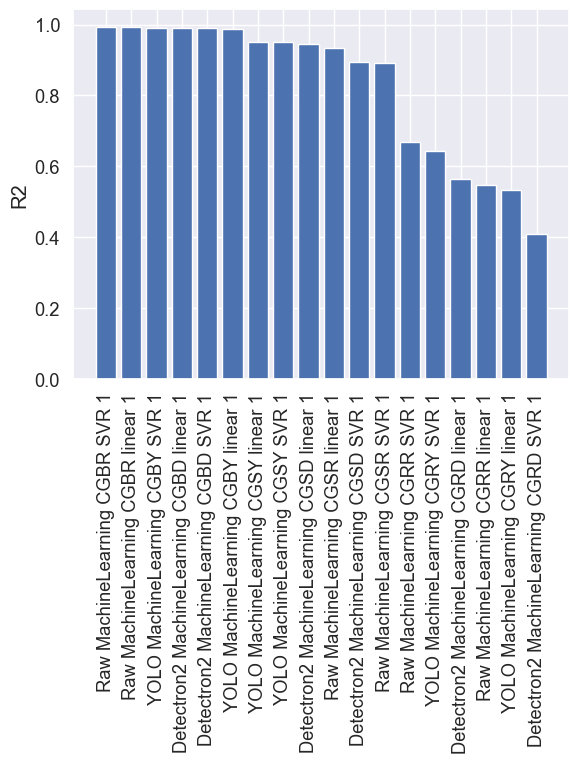

In [83]:
plot_r2_by_class(results_dict)

{'Raw': {'MachineLearning': {'CGBR': {'linear': {'1': {'r2': 0.9926325534932375, 'loss': None, 'mse': 0.005669554638679706, 'mae': 0.06383686784301647, 'rmse': 0.07529644506004056}}, 'SVR': {'1': {'r2': 0.9936267878097819, 'loss': None, 'mse': 0.0028177872244099485, 'mae': 0.04370378287578352, 'rmse': 0.05308283361323083}}}, 'CGRR': {'linear': {'1': {'r2': 0.5462296359722968, 'loss': None, 'mse': 0.32610239106723915, 'mae': 0.454938274379616, 'rmse': 0.5710537549716657}}, 'SVR': {'1': {'r2': 0.6673846762151838, 'loss': None, 'mse': 0.25129168542990515, 'mae': 0.37054386713507825, 'rmse': 0.5012900212750152}}}, 'CGSR': {'linear': {'1': {'r2': 0.933181881064319, 'loss': None, 'mse': 5.476421376541122, 'mae': 1.5478713766231647, 'rmse': 2.34017550122659}}, 'SVR': {'1': {'r2': 0.8927075813379255, 'loss': None, 'mse': 8.07189017089406, 'mae': 1.8058281307706863, 'rmse': 2.8411072086237894}}}}}, 'YOLO': {'MachineLearning': {'CGBY': {'linear': {'1': {'r2': 0.9861800709911626, 'loss': None, 'm

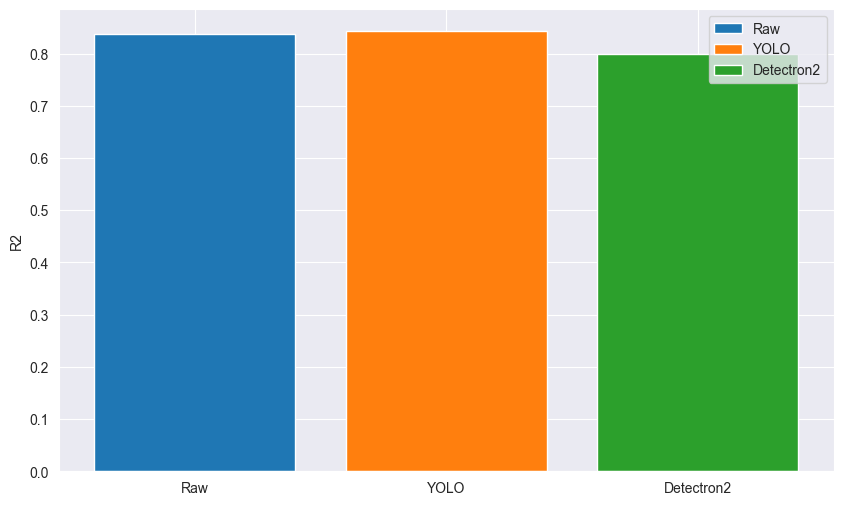

In [73]:
import matplotlib.pyplot as plt

print(results_dict)

def plot_r2(results_dict):
    # Create a dictionary to store the R2 values for each experiment
    r2_dict = {}

    
    # Loop through the results_dict and extract the R2 values
    for experiment_name, experiment in results_dict.items():
        for test_name, test in experiment.items():
            for dataset_name, dataset in test.items():
                for model_name, model in dataset.items():
                    for epoch, results in model.items():
                        r2 = results['r2']
                        # If the experiment name is not in the r2_dict, add it
                        if experiment_name not in r2_dict:
                            r2_dict[experiment_name] = []
                        if(r2 == None):
                            r2 = 0
                        r2_dict[experiment_name].append(r2)
    print("R2DICT",r2_dict)
    
    # Create a bar chart of the R2 values for each experiment
    fig, ax = plt.subplots(figsize=(10,6))
    for i, (experiment_name, r2_values) in enumerate(r2_dict.items()):
        ax.bar(i, sum(r2_values)/len(r2_values), label=experiment_name)
    ax.set_xticks(range(len(r2_dict)))
    ax.set_xticklabels(list(r2_dict.keys()))
    ax.set_ylabel('R2')
    ax.legend()
    plt.show()

plot_r2(results_dict)


dict_items([('Raw', {'MachineLearning': {'CGBR': {'linear': {'1': {'r2': 0.9926325534932375, 'loss': None, 'mse': 0.005669554638679706, 'mae': 0.06383686784301647, 'rmse': 0.07529644506004056}}, 'SVR': {'1': {'r2': 0.9936267878097819, 'loss': None, 'mse': 0.0028177872244099485, 'mae': 0.04370378287578352, 'rmse': 0.05308283361323083}}}, 'CGRR': {'linear': {'1': {'r2': 0.5462296359722968, 'loss': None, 'mse': 0.32610239106723915, 'mae': 0.454938274379616, 'rmse': 0.5710537549716657}}, 'SVR': {'1': {'r2': 0.6673846762151838, 'loss': None, 'mse': 0.25129168542990515, 'mae': 0.37054386713507825, 'rmse': 0.5012900212750152}}}, 'CGSR': {'linear': {'1': {'r2': 0.933181881064319, 'loss': None, 'mse': 5.476421376541122, 'mae': 1.5478713766231647, 'rmse': 2.34017550122659}}, 'SVR': {'1': {'r2': 0.8927075813379255, 'loss': None, 'mse': 8.07189017089406, 'mae': 1.8058281307706863, 'rmse': 2.8411072086237894}}}}}), ('YOLO', {'MachineLearning': {'CGBY': {'linear': {'1': {'r2': 0.9861800709911626, 'l

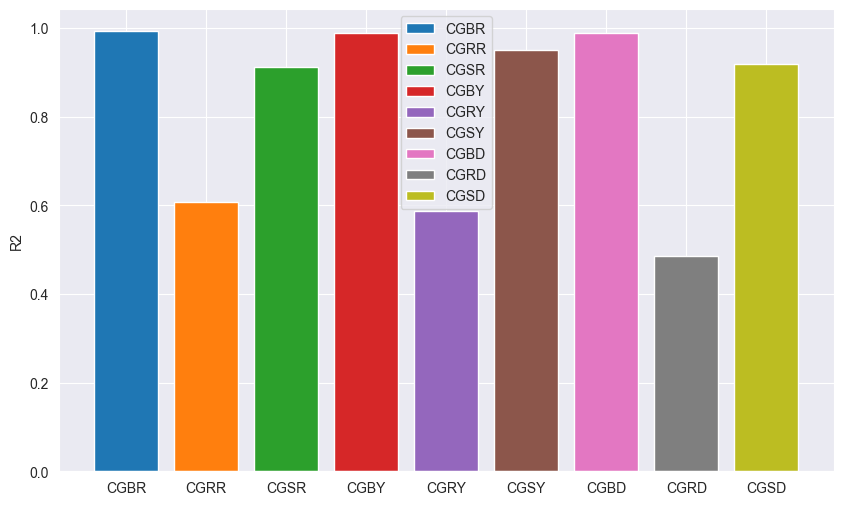

In [74]:
import matplotlib.pyplot as plt

def plot_r2_by_dataset(results_dict):
    # Create a dictionary to store the R2 values for each dataset
    r2_dict = {}
    
    # Loop through the results_dict and extract the R2 values
    for experiment_name, experiment in results_dict.items():
        print(results_dict.items())
        
        for test_name, test in experiment.items():
            print(test_name)
            for dataset_name, dataset in test.items():
                for model_name, model in dataset.items():
                    for epoch, results in model.items():
                        r2 = results['r2']
                        # If the dataset name is not in the r2_dict, add it
                        if dataset_name not in r2_dict:
                            r2_dict[dataset_name] = []
                        if(r2 == None):
                            r2 = 0
                        r2_dict[dataset_name].append(r2)
    
    # Create a bar chart of the R2 values for each dataset
    fig, ax = plt.subplots(figsize=(10,6))
    for i, (dataset_name, r2_values) in enumerate(r2_dict.items()):
        ax.bar(i, sum(r2_values)/len(r2_values), label=dataset_name)
    ax.set_xticks(range(len(r2_dict)))
    ax.set_xticklabels(list(r2_dict.keys()))
    ax.set_ylabel('R2')
    ax.legend()
    plt.show()
plot_r2_by_dataset(results_dict)


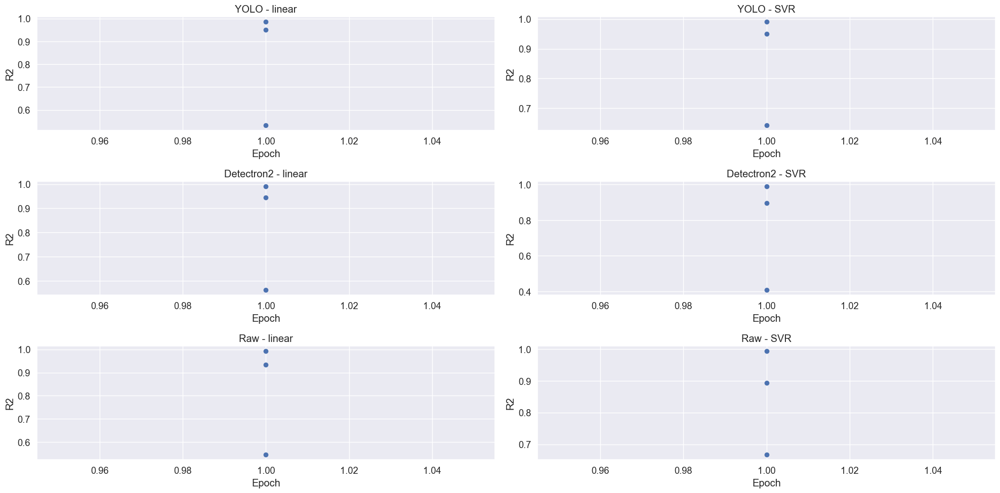

In [85]:
import matplotlib.pyplot as plt
import numpy as np

def plot_r2_by_model(results_dict):
    models = set()
    experiments = set()
    for experiment_name, experiment in results_dict.items():
        experiments.add(experiment_name)
        for test_name, test in experiment.items():
            for dataset_name, dataset in test.items():
                for model_name, model in dataset.items():
                    models.add(model_name)

    fig, axes = plt.subplots(len(experiments), len(models), figsize=(20, 10))
    if len(experiments) == 1 and len(models) == 1:
        axes = np.array([[axes]])
    elif len(experiments) == 1 or len(models) == 1:
        axes = axes.reshape((1, -1))

    for i, experiment_name in enumerate(experiments):
        for j, model_name in enumerate(models):
            r2_values = []
            epochs = []
            for test_name, test in results_dict[experiment_name].items():
                for dataset_name, dataset in test.items():
                    if model_name in dataset:
                        model_results = dataset[model_name]
                        for epoch, epoch_results in model_results.items():
                            if epoch_results is not None:
                                r2_values.append(epoch_results['r2'])
                                epochs.append(int(epoch))
            if len(r2_values) > 0:
                axes[i, j].scatter(epochs, r2_values)
                axes[i, j].set_title(f"{experiment_name} - {model_name}")
                axes[i, j].set_xlabel("Epoch")
                axes[i, j].set_ylabel("R2")
    
    plt.tight_layout()
    plt.show()


plot_r2_by_model(results_dict)

In [ ]:

testcnn = AutomaticLearning(pd.read_pickle("croppedimagesRaspberriesRaw.pkl"), "CIRR-ResNet", "ResNet")
testcnn.buildData()
testcnn.buildModel()
testcnn.train(40)
testcnn.plot()

   ID  AverageMass  AreaInSquaredPixels  Roundness
0  21       6.9924              17784.0     0.7531
1  22       6.9847              17844.0     0.7737
plotting linear


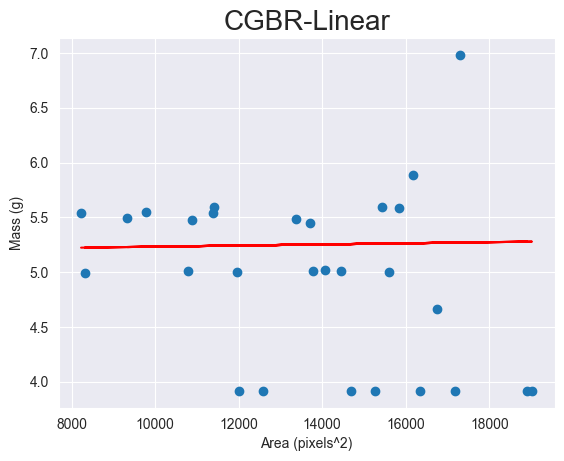

R-squared value: -0.1392


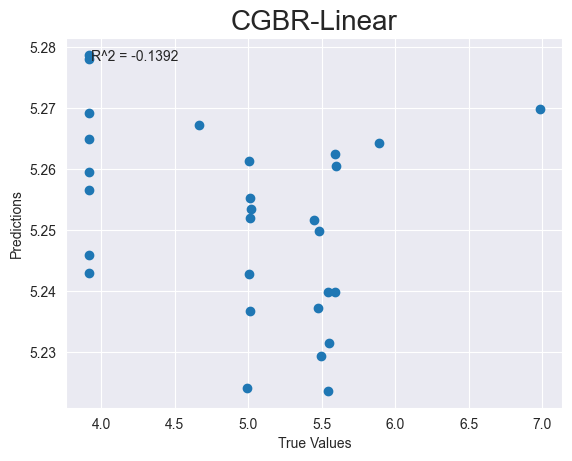

In [53]:
testcnn = AutomaticLearning(pd.read_csv("CGBR.csv"), "CGBR-Linear", "linear")
testcnn.buildData()
testcnn.buildModel()
testcnn.train(400)
testcnn.plot()


plotting linear


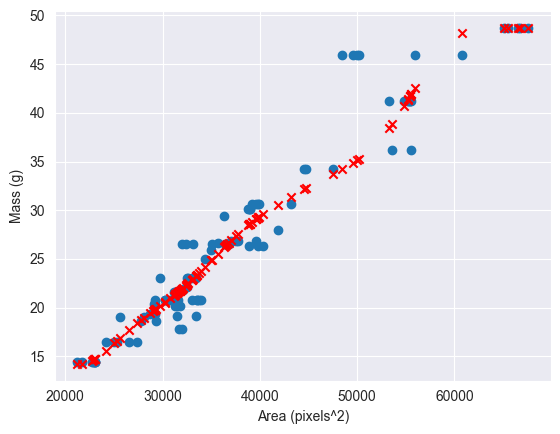

R-squared value: 0.9178


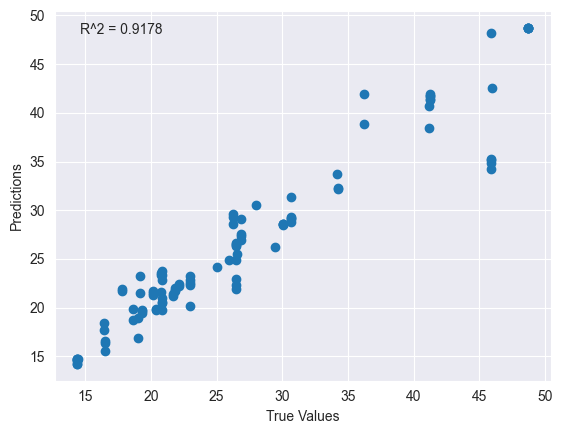

In [8]:

testsvr = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaSVR")
testsvr.buildData()
testsvr.buildModel("SVR")
testsvr.train(2200)
testsvr.plot()


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 64)                832       
                                                                 
 dense_9 (Dense)             (None, 32)                2080      
                                                                 
 dense_10 (Dense)            (None, 16)                528       
                                                                 
 dense_11 (Dense)            (None, 1)                 17        
                                                                 
Total params: 3,457
Trainable params: 3,457
Non-trainable params: 0
_________________________________________________________________
None


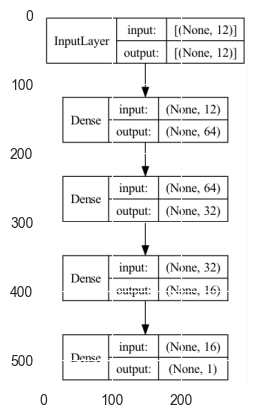

Epoch 1/10
 1/11 [=>............................] - ETA: 5s - loss: 377022.3750 - mse: 377022.3750 - mae: 587.8816 - root_mean_squared_error: 614.0215

2023-04-29 04:02:14.868265: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 31ms/step - loss: 15895854.0000 - mse: 15895854.0000 - mae: 2913.8459 - root_mean_squared_error: 3986.9604 - val_loss: 101860.9062 - val_mse: 101860.9062 - val_mae: 307.9383 - val_root_mean_squared_error: 319.1566
Epoch 2/10
 8/11 [====================>.........] - ETA: 0s - loss: 976481.5000 - mse: 976481.5000 - mae: 914.2033 - root_mean_squared_error: 988.1708

2023-04-29 04:02:15.240663: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 0s 11ms/step - loss: 946390.3125 - mse: 946390.3125 - mae: 904.1191 - root_mean_squared_error: 972.8259 - val_loss: 377234.4062 - val_mse: 377234.4062 - val_mae: 592.2183 - val_root_mean_squared_error: 614.1941
Epoch 3/10
11/11 [==============================] - 0s 11ms/step - loss: 122046.0703 - mse: 122046.0703 - mae: 296.6097 - root_mean_squared_error: 349.3509 - val_loss: 3624.8376 - val_mse: 3624.8376 - val_mae: 57.6960 - val_root_mean_squared_error: 60.2066
Epoch 4/10
11/11 [==============================] - 0s 11ms/step - loss: 737.0602 - mse: 737.0602 - mae: 19.2511 - root_mean_squared_error: 27.1489 - val_loss: 249.6129 - val_mse: 249.6129 - val_mae: 15.3938 - val_root_mean_squared_error: 15.7991
Epoch 5/10
11/11 [==============================] - 0s 10ms/step - loss: 384.6152 - mse: 384.6152 - mae: 18.9756 - root_mean_squared_error: 19.6116 - val_loss: 388.4864 - val_mse: 388.4864 - val_mae: 19.1997 - val_root_mean_squared_error: 19.71

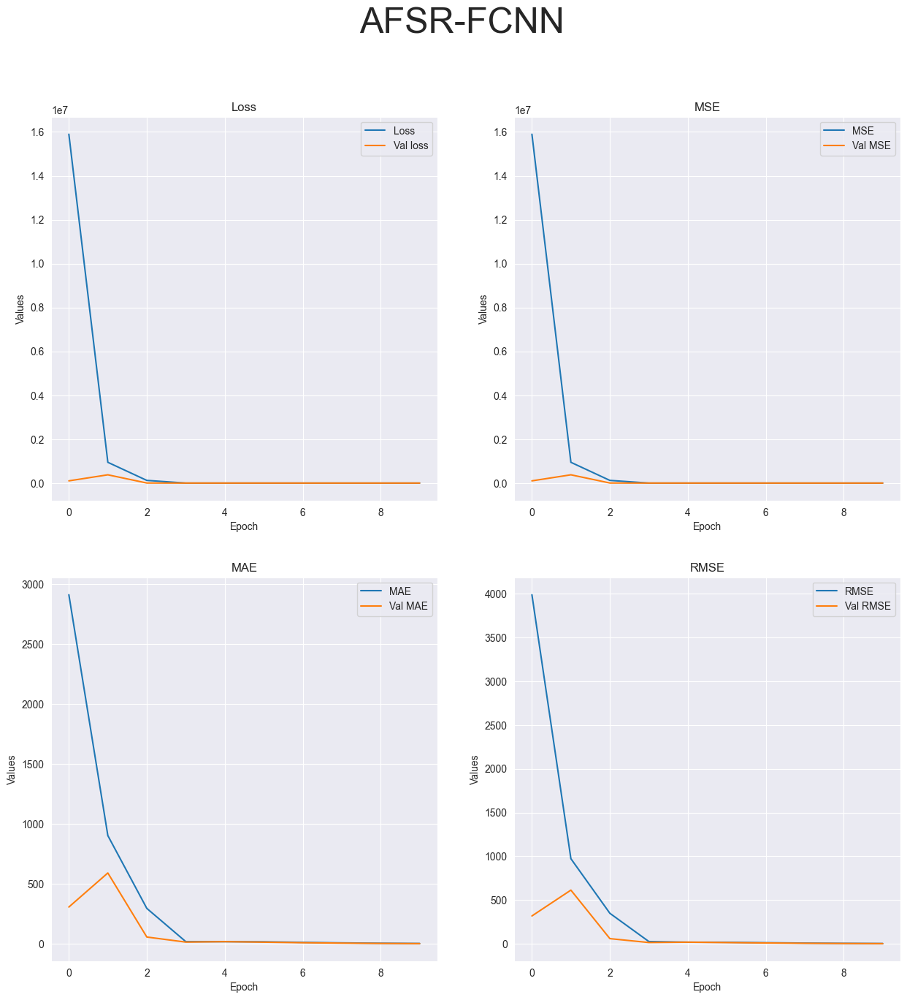

R-squared value: 0.8525


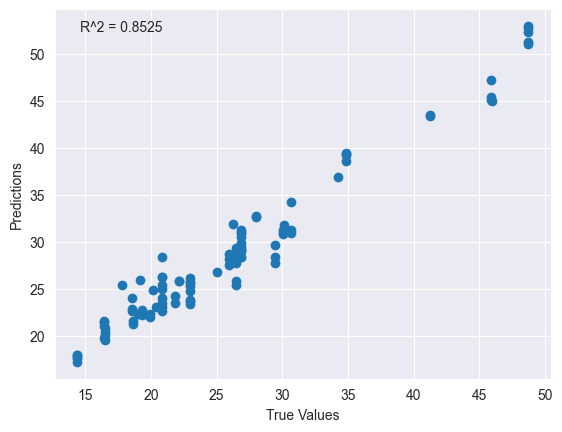

In [13]:

muchas = AutomaticLearning(pd.read_csv("allfeaturesStrawberriesRaw.csv"), "AFSR-FCNN")
muchas.buildData()
muchas.buildModel("FCNN")
muchas.train(10)
muchas.plot()

plotting linear


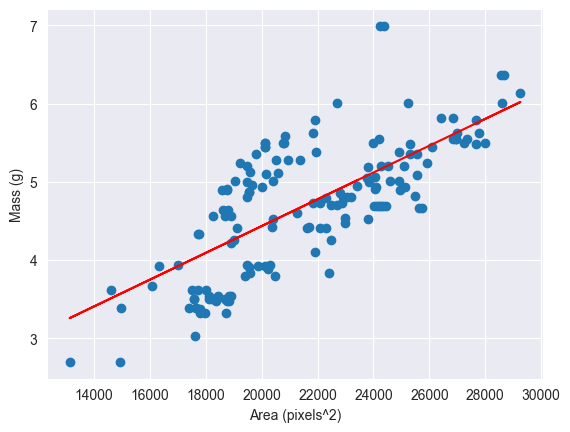

R-squared value: 0.5422


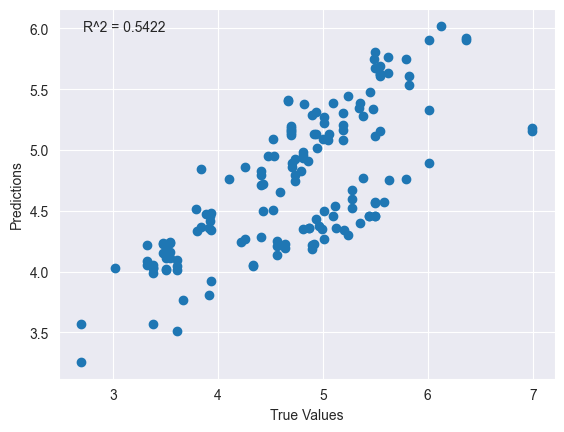

plotting linear


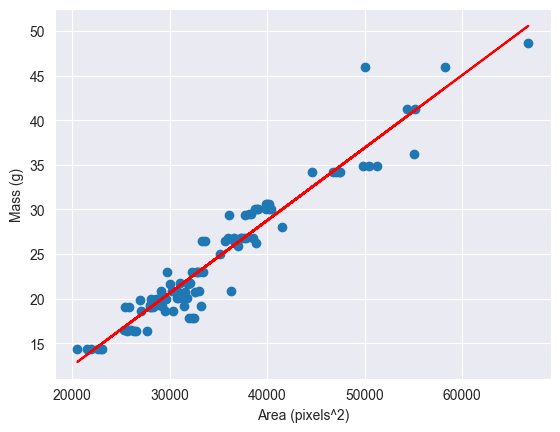

R-squared value: 0.9251


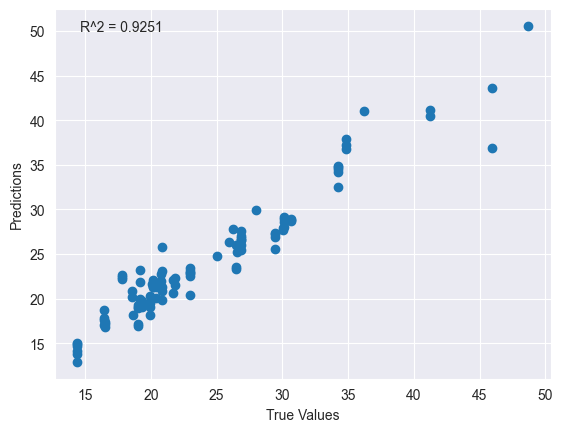

plotting linear


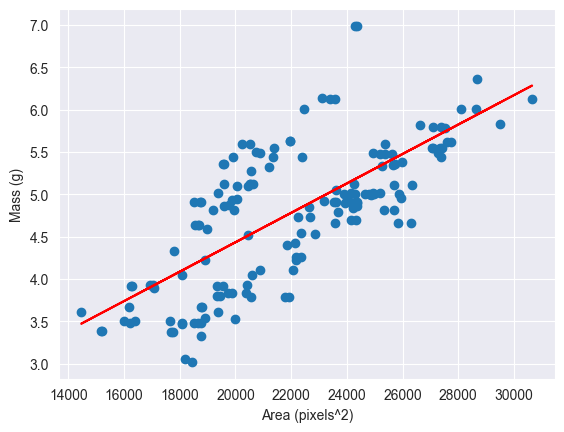

R-squared value: 0.5080


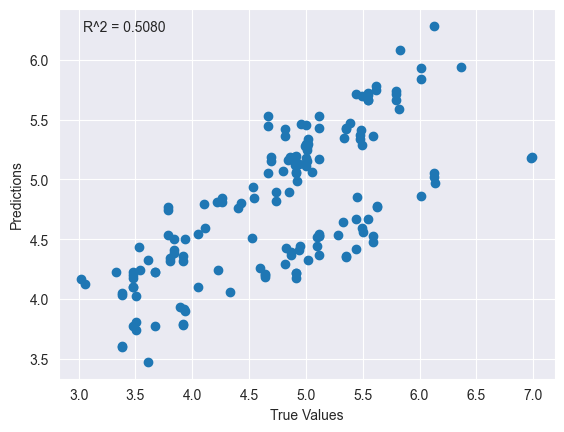

plotting linear


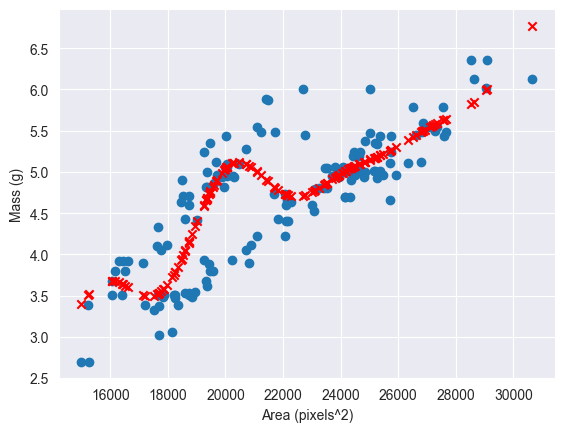

R-squared value: 0.6757


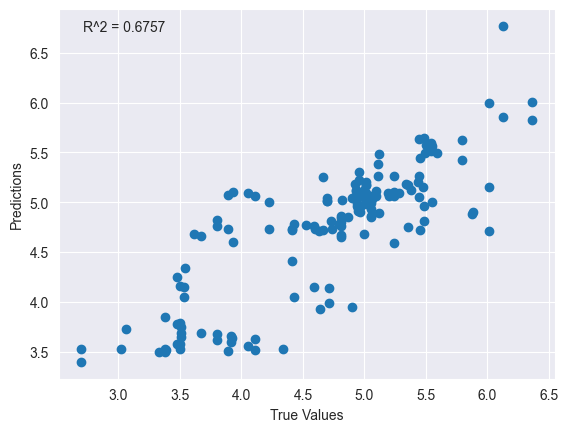

Model: "sequential_107"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_369 (Dense)           (None, 64)                192       
                                                                 
 dropout_112 (Dropout)       (None, 64)                0         
                                                                 
 dense_370 (Dense)           (None, 32)                2080      
                                                                 
 dropout_113 (Dropout)       (None, 32)                0         
                                                                 
 dense_371 (Dense)           (None, 1)                 33        
                                                                 
Total params: 2,305
Trainable params: 2,305
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:10.454677: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 1663239.3750 - mse: 1663239.3750 - mae: 836.0511 - root_mean_squared_error: 1289.6664

2023-04-29 03:39:11.773911: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 2s 64ms/step - loss: 1663239.3750 - mse: 1663239.3750 - mae: 836.0511 - root_mean_squared_error: 1289.6664 - val_loss: 57952.4336 - val_mse: 57952.4336 - val_mae: 237.5029 - val_root_mean_squared_error: 240.7331
Epoch 2/5
16/16 [==============================] - 0s 16ms/step - loss: 50696.3398 - mse: 50696.3398 - mae: 166.3529 - root_mean_squared_error: 225.1585 - val_loss: 920.8993 - val_mse: 920.8993 - val_mae: 29.9157 - val_root_mean_squared_error: 30.3463
Epoch 3/5
16/16 [==============================] - 0s 18ms/step - loss: 4578.2466 - mse: 4578.2466 - mae: 48.7814 - root_mean_squared_error: 67.6627 - val_loss: 107.3159 - val_mse: 107.3159 - val_mae: 10.2257 - val_root_mean_squared_error: 10.3593
Epoch 4/5
16/16 [==============================] - 0s 14ms/step - loss: 2107.4727 - mse: 2107.4727 - mae: 35.8980 - root_mean_squared_error: 45.9072 - val_loss: 133.2910 - val_mse: 133.2910 - val_mae: 11.3972 - val_root_mean_squared_error: 11.5452

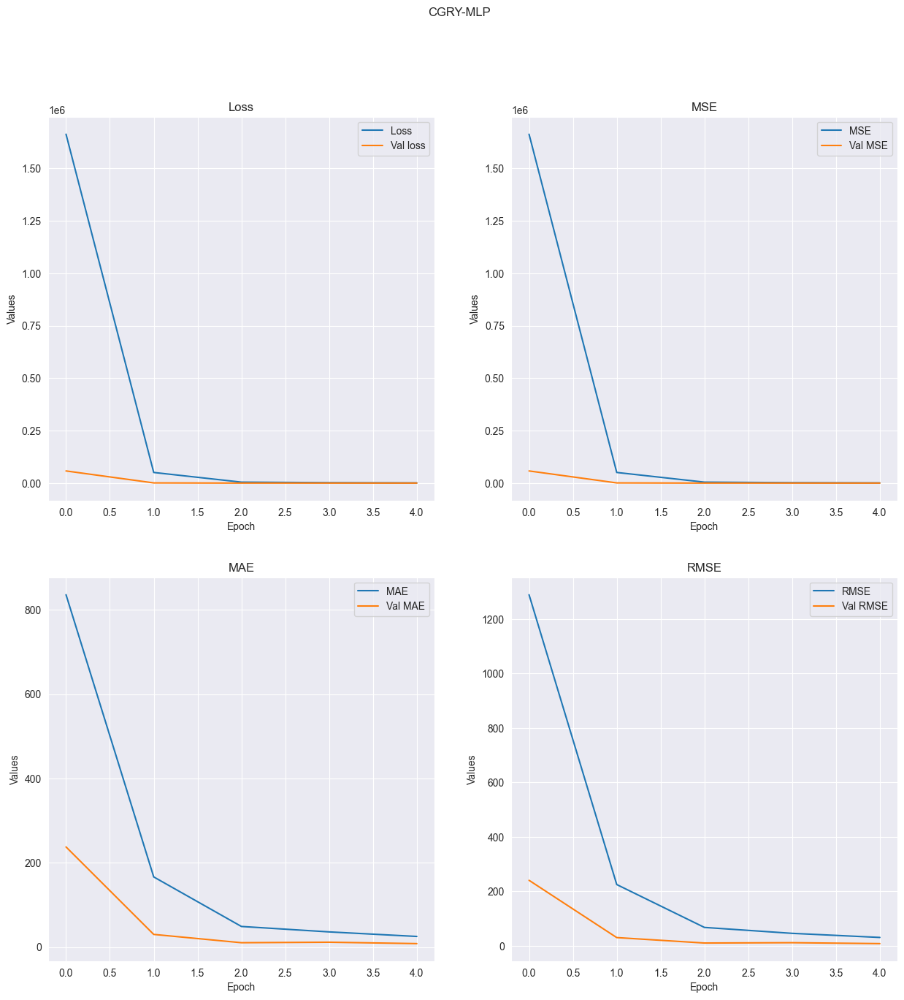

R-squared value: -122.9209


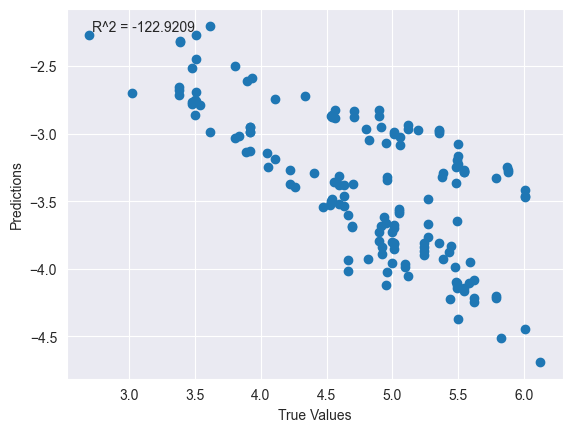

Model: "sequential_108"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_372 (Dense)           (None, 64)                192       
                                                                 
 dropout_114 (Dropout)       (None, 64)                0         
                                                                 
 dense_373 (Dense)           (None, 32)                2080      
                                                                 
 dropout_115 (Dropout)       (None, 32)                0         
                                                                 
 dense_374 (Dense)           (None, 1)                 33        
                                                                 
Total params: 2,305
Trainable params: 2,305
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:20.399078: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 7864849.5000 - mse: 7864849.5000 - mae: 1876.0809 - root_mean_squared_error: 2804.4338 

2023-04-29 03:39:21.810632: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 91ms/step - loss: 7864849.5000 - mse: 7864849.5000 - mae: 1876.0809 - root_mean_squared_error: 2804.4338 - val_loss: 166090.0469 - val_mse: 166090.0469 - val_mae: 389.9341 - val_root_mean_squared_error: 407.5415
Epoch 2/5
11/11 [==============================] - 0s 24ms/step - loss: 511054.8125 - mse: 511054.8125 - mae: 509.3962 - root_mean_squared_error: 714.8810 - val_loss: 57024.1289 - val_mse: 57024.1289 - val_mae: 228.5861 - val_root_mean_squared_error: 238.7973
Epoch 3/5
11/11 [==============================] - 0s 17ms/step - loss: 108829.0156 - mse: 108829.0156 - mae: 242.5318 - root_mean_squared_error: 329.8924 - val_loss: 6094.3706 - val_mse: 6094.3701 - val_mae: 74.8816 - val_root_mean_squared_error: 78.0664
Epoch 4/5
11/11 [==============================] - 0s 18ms/step - loss: 35150.0625 - mse: 35150.0625 - mae: 128.3465 - root_mean_squared_error: 187.4835 - val_loss: 115.6760 - val_mse: 115.6760 - val_mae: 10.3060 - val_root_mean

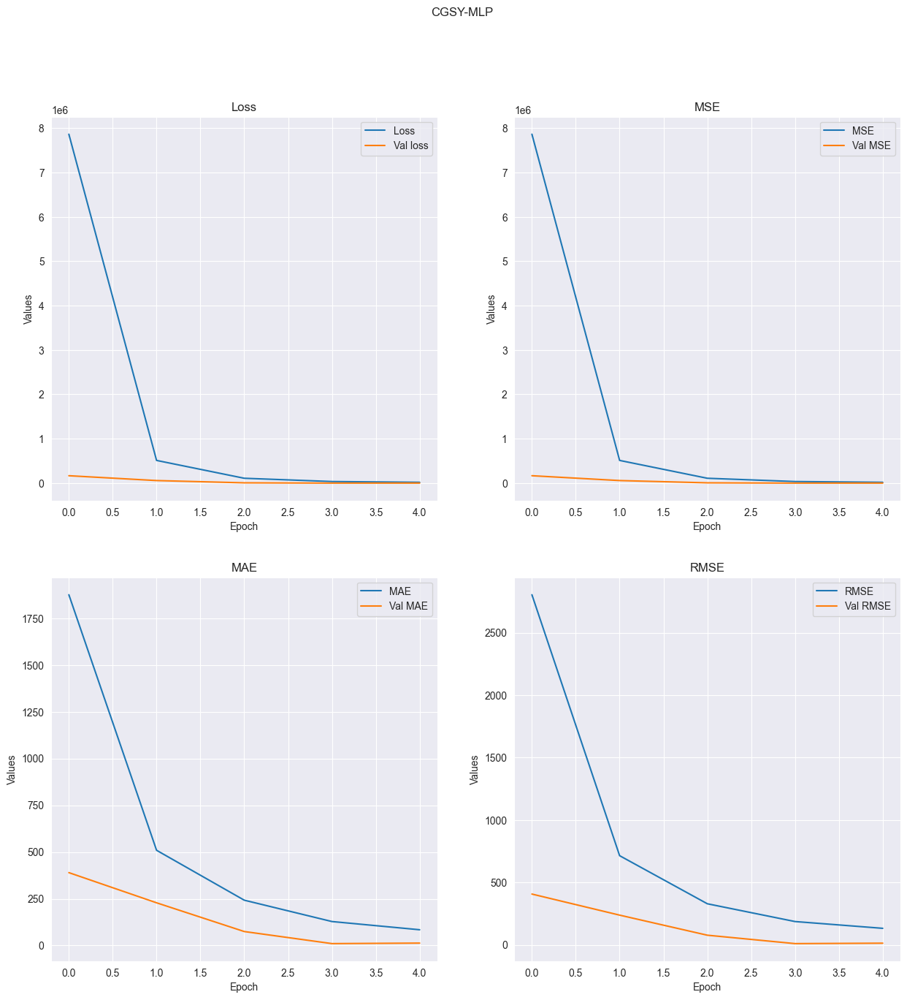

R-squared value: -0.7915


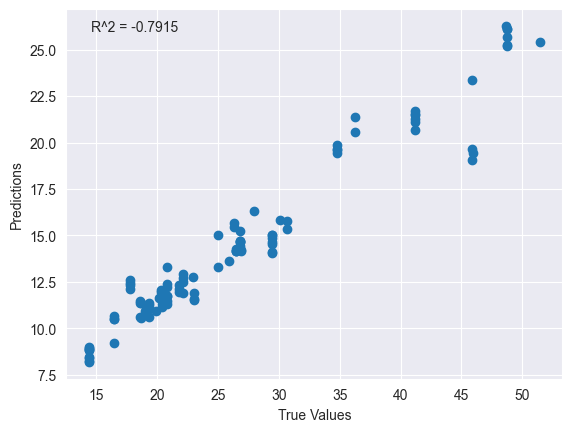

Model: "sequential_109"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_375 (Dense)           (None, 64)                192       
                                                                 
 dense_376 (Dense)           (None, 32)                2080      
                                                                 
 dense_377 (Dense)           (None, 16)                528       
                                                                 
 dense_378 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:23.873785: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - ETA: 0s - loss: 4046931.2500 - mse: 4046931.2500 - mae: 1404.9456 - root_mean_squared_error: 2011.6986

2023-04-29 03:39:24.804380: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


16/16 [==============================] - 1s 56ms/step - loss: 4046931.2500 - mse: 4046931.2500 - mae: 1404.9456 - root_mean_squared_error: 2011.6986 - val_loss: 555599.4375 - val_mse: 555599.4375 - val_mae: 735.9260 - val_root_mean_squared_error: 745.3854
Epoch 2/5
16/16 [==============================] - 0s 13ms/step - loss: 168030.3438 - mse: 168030.3438 - mae: 328.9428 - root_mean_squared_error: 409.9150 - val_loss: 46.6384 - val_mse: 46.6384 - val_mae: 6.6897 - val_root_mean_squared_error: 6.8292
Epoch 3/5
16/16 [==============================] - 0s 15ms/step - loss: 4408.6826 - mse: 4408.6826 - mae: 61.4353 - root_mean_squared_error: 66.3979 - val_loss: 6530.2080 - val_mse: 6530.2080 - val_mae: 79.7497 - val_root_mean_squared_error: 80.8097
Epoch 4/5
16/16 [==============================] - 0s 10ms/step - loss: 4162.0752 - mse: 4162.0752 - mae: 62.9008 - root_mean_squared_error: 64.5141 - val_loss: 1974.3805 - val_mse: 1974.3805 - val_mae: 43.8345 - val_root_mean_squared_error: 44

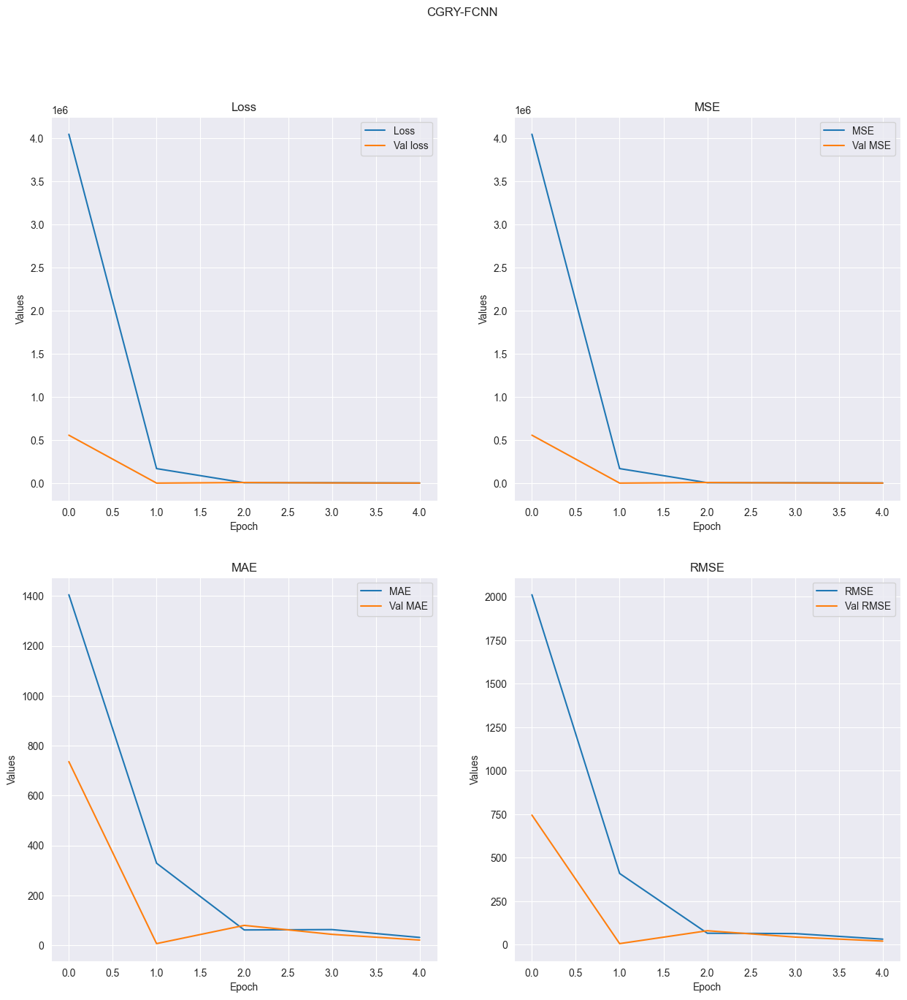

R-squared value: -738.7749


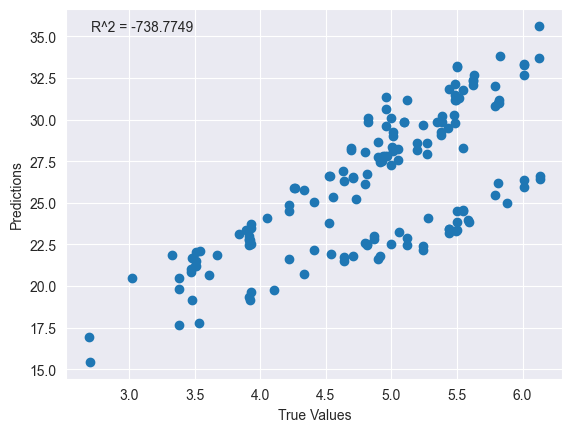

Model: "sequential_110"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_379 (Dense)           (None, 64)                192       
                                                                 
 dense_380 (Dense)           (None, 32)                2080      
                                                                 
 dense_381 (Dense)           (None, 16)                528       
                                                                 
 dense_382 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,817
Trainable params: 2,817
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5


2023-04-29 03:39:26.990116: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 23710192.0000 - mse: 23710192.0000 - mae: 3670.8171 - root_mean_squared_error: 4869.3110

2023-04-29 03:39:28.050524: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 93ms/step - loss: 23710192.0000 - mse: 23710192.0000 - mae: 3670.8171 - root_mean_squared_error: 4869.3110 - val_loss: 729364.1250 - val_mse: 729364.1250 - val_mae: 819.8881 - val_root_mean_squared_error: 854.0282
Epoch 2/5
11/11 [==============================] - 0s 25ms/step - loss: 168845.9531 - mse: 168845.9531 - mae: 339.4226 - root_mean_squared_error: 410.9087 - val_loss: 94275.0938 - val_mse: 94275.0938 - val_mae: 294.4102 - val_root_mean_squared_error: 307.0425
Epoch 3/5
11/11 [==============================] - 0s 15ms/step - loss: 64092.6992 - mse: 64092.6992 - mae: 240.5644 - root_mean_squared_error: 253.1654 - val_loss: 26051.3789 - val_mse: 26051.3789 - val_mae: 154.6329 - val_root_mean_squared_error: 161.4044
Epoch 4/5
11/11 [==============================] - 0s 13ms/step - loss: 11585.3242 - mse: 11585.3242 - mae: 96.6171 - root_mean_squared_error: 107.6351 - val_loss: 786.8887 - val_mse: 786.8887 - val_mae: 26.5961 - val_root_m

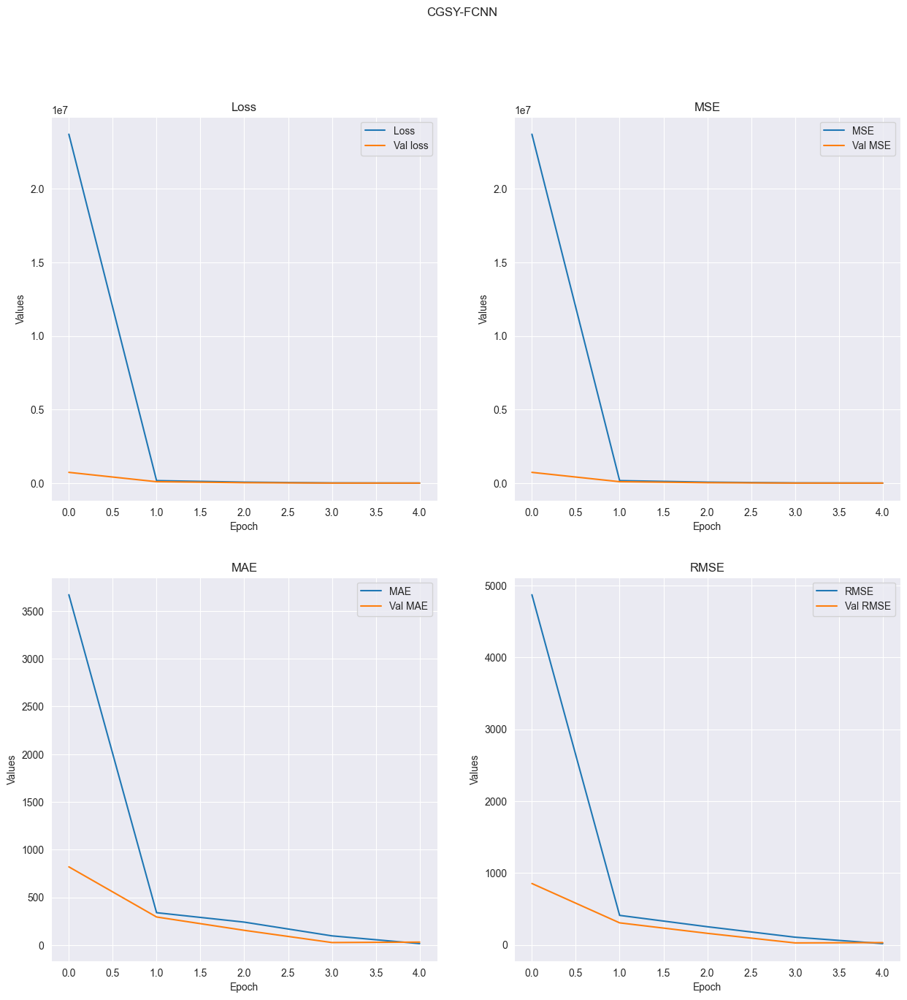

R-squared value: -14.0293


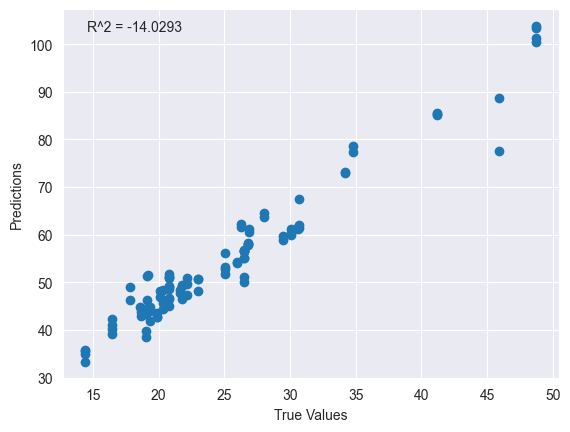

Model: "sequential_111"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_383 (Dense)           (None, 64)                128       
                                                                 
 dense_384 (Dense)           (None, 32)                2080      
                                                                 
 dense_385 (Dense)           (None, 16)                528       
                                                                 
 dense_386 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/50


2023-04-29 03:39:30.141956: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 19372782.0000 - mse: 19372782.0000 - mae: 3406.9805 - root_mean_squared_error: 4401.4521

2023-04-29 03:39:31.058009: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 75ms/step - loss: 19372782.0000 - mse: 19372782.0000 - mae: 3406.9805 - root_mean_squared_error: 4401.4521 - val_loss: 17714.7266 - val_mse: 17714.7266 - val_mae: 127.6721 - val_root_mean_squared_error: 133.0967
Epoch 2/50
11/11 [==============================] - 0s 17ms/step - loss: 932430.1250 - mse: 932430.1250 - mae: 873.2705 - root_mean_squared_error: 965.6242 - val_loss: 421392.2500 - val_mse: 421392.2500 - val_mae: 623.6829 - val_root_mean_squared_error: 649.1473
Epoch 3/50
11/11 [==============================] - 0s 18ms/step - loss: 122324.6250 - mse: 122324.6250 - mae: 275.8206 - root_mean_squared_error: 349.7494 - val_loss: 1564.3717 - val_mse: 1564.3717 - val_mae: 38.2025 - val_root_mean_squared_error: 39.5521
Epoch 4/50
11/11 [==============================] - 0s 16ms/step - loss: 17010.9688 - mse: 17010.9688 - mae: 118.5225 - root_mean_squared_error: 130.4261 - val_loss: 30145.5234 - val_mse: 30145.5234 - val_mae: 167.1085 - val

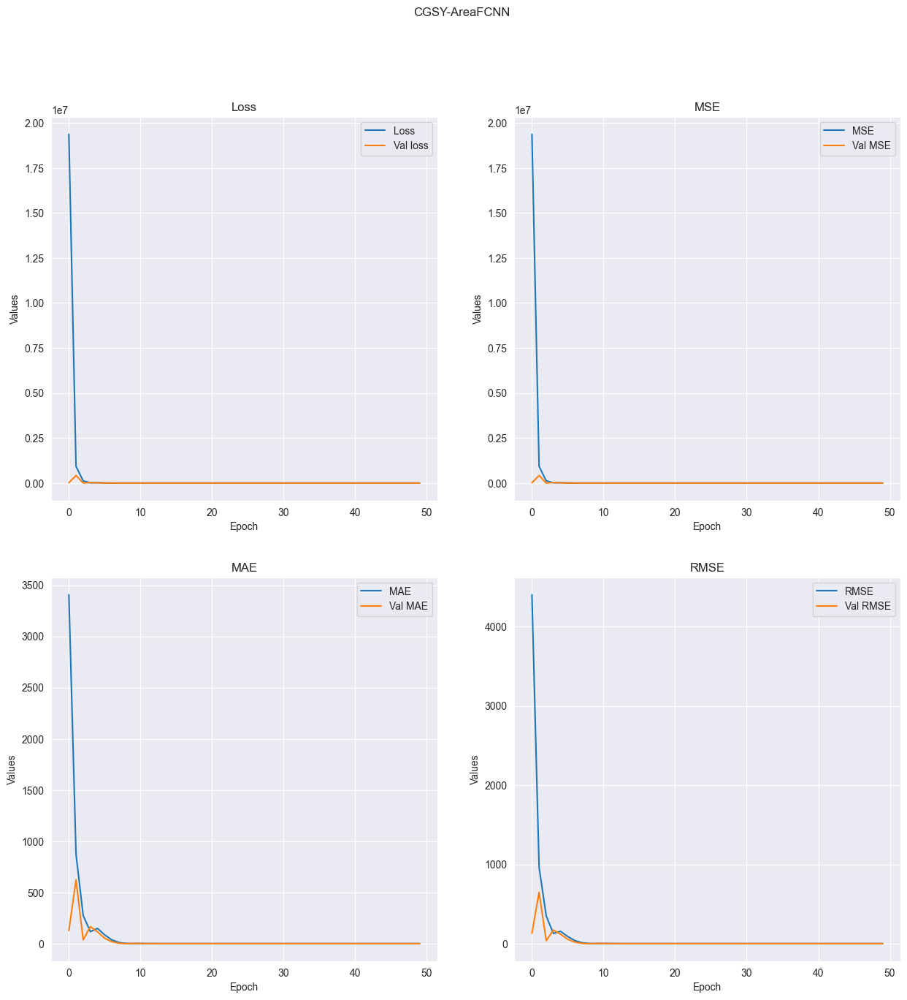

R-squared value: 0.9177


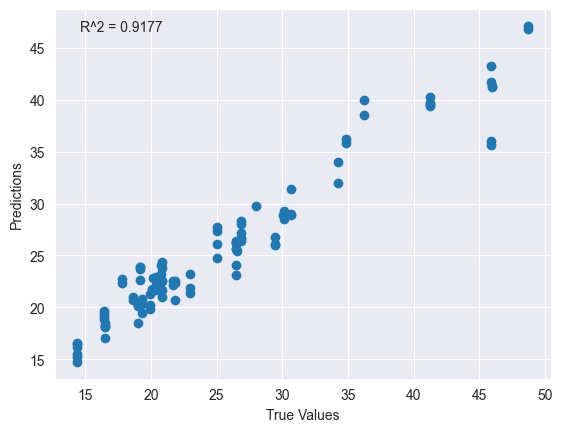

Model: "sequential_112"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_387 (Dense)           (None, 64)                128       
                                                                 
 dense_388 (Dense)           (None, 32)                2080      
                                                                 
 dense_389 (Dense)           (None, 16)                528       
                                                                 
 dense_390 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/500


2023-04-29 03:39:38.776629: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 18706208.0000 - mse: 18706208.0000 - mae: 3244.1116 - root_mean_squared_error: 4325.0674

2023-04-29 03:39:39.795213: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 1s 77ms/step - loss: 18706208.0000 - mse: 18706208.0000 - mae: 3244.1116 - root_mean_squared_error: 4325.0674 - val_loss: 210354.5625 - val_mse: 210354.5625 - val_mae: 439.0882 - val_root_mean_squared_error: 458.6443
Epoch 2/500
11/11 [==============================] - 0s 19ms/step - loss: 1217078.6250 - mse: 1217078.6250 - mae: 1023.1184 - root_mean_squared_error: 1103.2129 - val_loss: 458335.7188 - val_mse: 458335.7188 - val_mae: 648.2742 - val_root_mean_squared_error: 677.0049
Epoch 3/500
11/11 [==============================] - 0s 11ms/step - loss: 112703.7422 - mse: 112703.7422 - mae: 262.1600 - root_mean_squared_error: 335.7138 - val_loss: 812.6620 - val_mse: 812.6620 - val_mae: 27.4941 - val_root_mean_squared_error: 28.5072
Epoch 4/500
11/11 [==============================] - 0s 28ms/step - loss: 9231.3857 - mse: 9231.3857 - mae: 87.2979 - root_mean_squared_error: 96.0801 - val_loss: 18772.8359 - val_mse: 18772.8359 - val_mae: 131.5238 - 

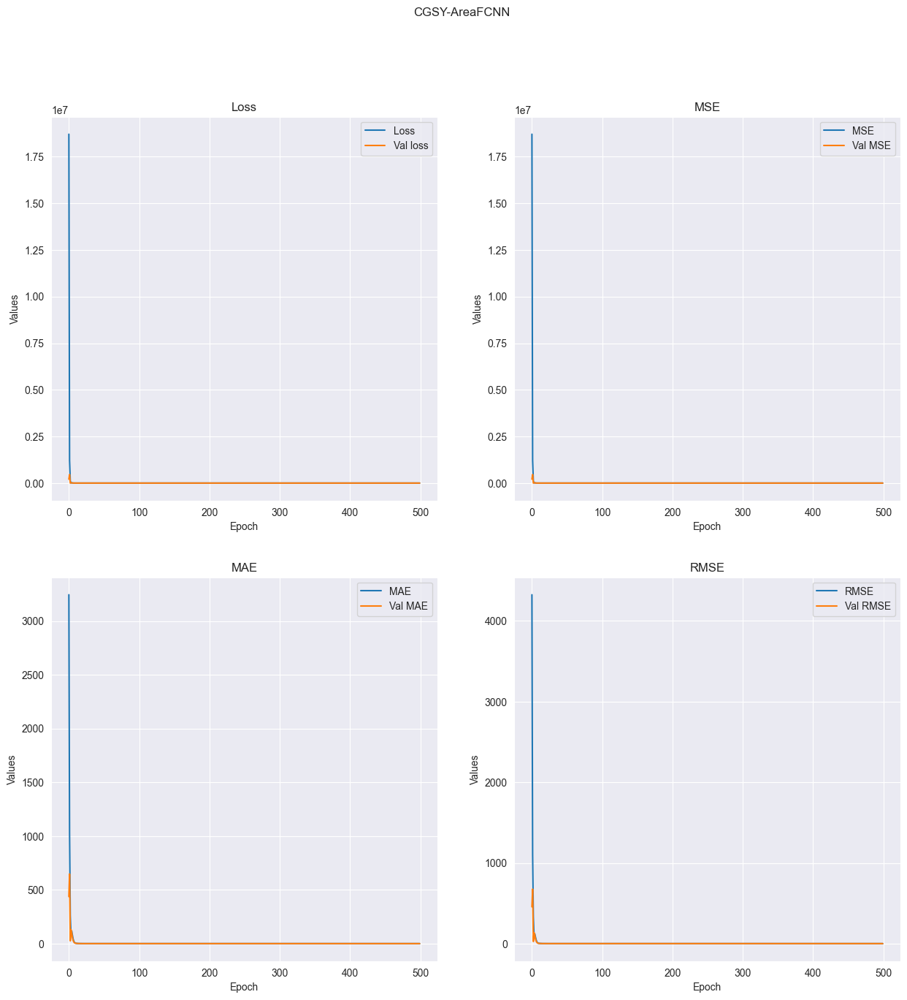

R-squared value: 0.8874


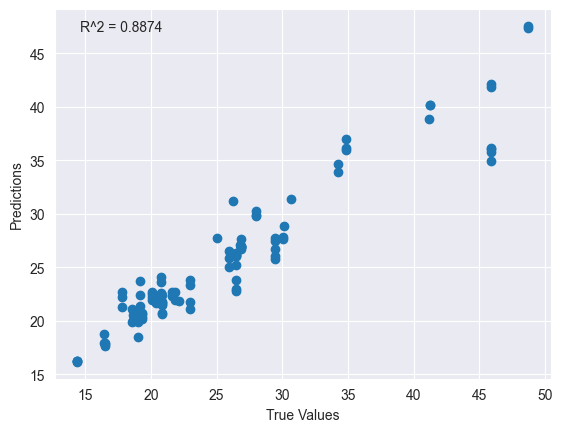

Model: "sequential_113"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_391 (Dense)           (None, 64)                128       
                                                                 
 dense_392 (Dense)           (None, 32)                2080      
                                                                 
 dense_393 (Dense)           (None, 16)                528       
                                                                 
 dense_394 (Dense)           (None, 1)                 17        
                                                                 
Total params: 2,753
Trainable params: 2,753
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/2200


2023-04-29 03:40:37.817394: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - ETA: 0s - loss: 23307728.0000 - mse: 23307728.0000 - mae: 3674.7097 - root_mean_squared_error: 4827.8076

2023-04-29 03:40:38.868347: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


11/11 [==============================] - 2s 81ms/step - loss: 23307728.0000 - mse: 23307728.0000 - mae: 3674.7097 - root_mean_squared_error: 4827.8076 - val_loss: 664391.3125 - val_mse: 664391.3125 - val_mae: 789.2724 - val_root_mean_squared_error: 815.1021
Epoch 2/2200
11/11 [==============================] - 0s 15ms/step - loss: 147479.4062 - mse: 147479.4062 - mae: 324.7747 - root_mean_squared_error: 384.0305 - val_loss: 90890.5234 - val_mse: 90890.5234 - val_mae: 291.6838 - val_root_mean_squared_error: 301.4806
Epoch 3/2200
11/11 [==============================] - 0s 15ms/step - loss: 62459.0117 - mse: 62459.0117 - mae: 238.3114 - root_mean_squared_error: 249.9180 - val_loss: 26080.6699 - val_mse: 26080.6699 - val_mae: 156.1575 - val_root_mean_squared_error: 161.4951
Epoch 4/2200
11/11 [==============================] - 0s 12ms/step - loss: 11361.0537 - mse: 11361.0537 - mae: 94.6271 - root_mean_squared_error: 106.5882 - val_loss: 620.5366 - val_mse: 620.5366 - val_mae: 23.8500 - v

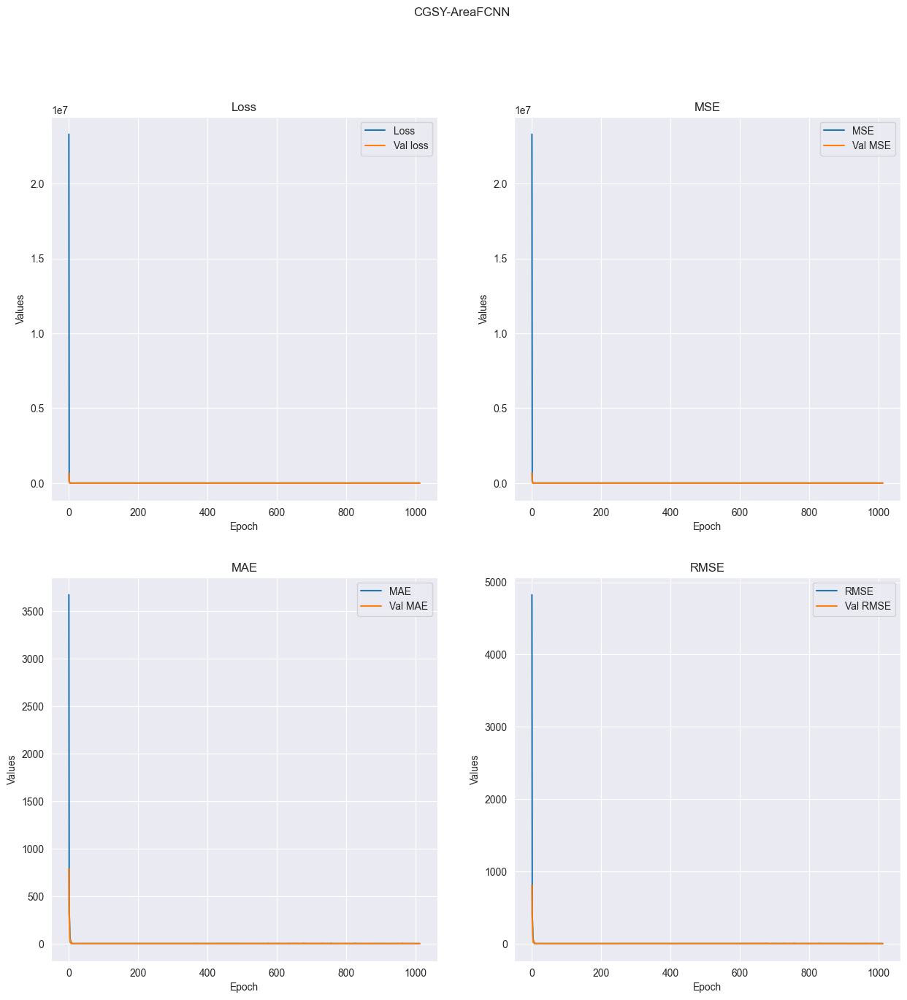

R-squared value: 0.9428


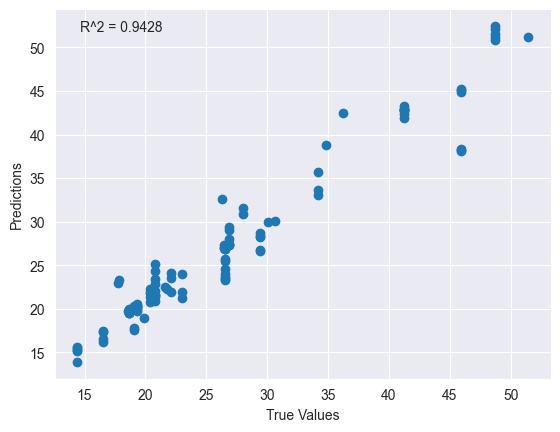

In [123]:

p3 = AutomaticLearning(pd.read_csv("classicgeometryRaspberriesRaw.csv").drop(["Roundness"], axis = 1), "CGRR-AreaLinear")
p3.buildData()
p3.buildModel("linear")
p3.train(2200)
p3.plot()

p1 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaLinear")
p1.buildData()
p1.buildModel("linear")
p1.train(2200)
p1.plot()

p2 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv").drop(["Roundness"], axis = 1), "CGRY-AreaLinear")
p2.buildData()
p2.buildModel("linear")
p2.train(2200)
p2.plot()


p4 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv").drop(["Roundness"], axis = 1), "CGRY-AreaSVR")
p4.buildData()
p4.buildModel("SVR")
p4.train(2200)
p4.plot()


p5 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv"), "CGRY-MLP")
p5.buildData()
p5.buildModel("MLP")
p5.train(5)
p5.plot()

p6 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv"), "CGSY-MLP")
p6.buildData()
p6.buildModel("MLP")
p6.train(5)
p6.plot()


p7 = AutomaticLearning(pd.read_csv("classicgeometryYOLORasp.csv"), "CGRY-FCNN")
p7.buildData()
p7.buildModel("FCNN")
p7.train(5)
p7.plot()

p8 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv"), "CGSY-FCNN")
p8.buildData()
p8.buildModel("FCNN")
p8.train(5)
p8.plot()



p9 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p9.buildData()
p9.buildModel("FCNN")
p9.train(50)
p9.plot()


p10 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p10.buildData()
p10.buildModel("FCNN")
p10.train(500)
p10.plot()

p11 = AutomaticLearning(pd.read_csv("classicgeometryStrawberriesYOLO.csv").drop(["Roundness"], axis = 1), "CGSY-AreaFCNN")
p11.buildData()
p11.buildModel("FCNN")
p11.train(2200)
p11.plot()


